# ROI 3100

In [1]:
import numpy as np
import os
#import ipdb

def connect_dataset(file_list, icond_file_list, outputdir,
                    topodx=15, roi=2500, offset=5000,gclass_num=6,test_data_num=500):
    """
    複数のデータセットを連結する
    """
    #ipdb.set_trace()
    
    #Reading and combining files Decide start and end points of the learning area and convert them to grid numbers
    H = np.loadtxt(file_list[0], delimiter = ',')
    icond = np.loadtxt(icond_file_list[0], delimiter = ',')
    
    #Reading and combining files
    if len(file_list) > 1:
        for i in range(1, len(file_list)):
            H_temp = np.loadtxt(file_list[i], delimiter = ',')
            icond_temp = np.loadtxt(icond_file_list[i], delimiter = ',')
            H = np.concatenate((H,H_temp),axis=0)
            icond = np.concatenate((icond,icond_temp),axis = 0)
    
    roi_grids = int(roi / topodx)
    num_grids = int(H.shape[1] / gclass_num)
    H_subset = np.zeros([H.shape[0], roi_grids * gclass_num])
    for i in range(gclass_num):
        H_subset[:, i*roi_grids:(i+1)*roi_grids] = H[:, i*num_grids:(i*num_grids+roi_grids)]
    
    #Obtain the maximum and minimum values of data
    max_x = np.max(H_subset)
    min_x = np.min(H_subset)
    icond_max = np.max(icond, axis=0)
    icond_min = np.min(icond, axis=0)
    
    #Split the data into tests and training
    H_train = H_subset[0:-test_data_num,:]
    H_test = H_subset[H_subset.shape[0] - test_data_num:,:]
    icond_train = icond[0:-test_data_num,:]
    icond_test = icond[H.shape[0] - test_data_num:,:]
    
    #Save the data
    if not os.path.exists(outputdir):
        os.mkdir(outputdir)
    np.savetxt(outputdir + '/x_train.txt',H_train,delimiter = ',')
    np.savetxt(outputdir + '/x_test.txt',H_test,delimiter = ',')
    np.savetxt(outputdir + '/icond_train.txt',icond_train,delimiter = ',')
    np.savetxt(outputdir + '/icond_test.txt',icond_test,delimiter = ',')
    np.savetxt(outputdir + '/icond_min.txt',icond_min,delimiter = ',')
    np.savetxt(outputdir + '/icond_max.txt',icond_max,delimiter = ',')
    np.savetxt(outputdir + '/x_minmax.txt',[min_x, max_x],delimiter = ',')
    
    
if __name__=="__main__":
    original_data_dir = "/home/rimali2009/FITTNUSS-forward_training_DNN"
    parent_dir = "/home/rimali2009/FITTNUSS-forward_training_DNN"
    if not os.path.exists(parent_dir):
        os.mkdir(parent_dir)
    outputdir = parent_dir + "/data_g6_300grid_H_5000_20_11_roi3100"
    file_list = ['/home/rimali2009/FITTNUSS-forward_training_DNN/eta_5000_g6_300grid_19_11.csv']
    initial_conditions = ['/home/rimali2009/FITTNUSS-forward_training_DNN/start_param_random_5000_g6_300grid_19_11.csv']
connect_dataset(file_list, initial_conditions, outputdir, test_data_num=500, gclass_num=6, topodx=15., roi=3100)
        
        
    

In [2]:
# -*- coding: utf-8 -*-
"""
Created on Tue Mar  7 15:43:18 2017

@author: hanar
"""
import time
import numpy as np
import os
from keras.utils import np_utils
from keras.models import Sequential
from keras.layers import Dense, Activation, Dropout
from keras.optimizers import SGD
from keras.optimizers import RMSprop
from keras.optimizers import Adagrad
from keras.optimizers import Adadelta
from keras.optimizers import Adam
from keras.optimizers import Adamax
from keras.optimizers import Nadam
from keras.callbacks import ModelCheckpoint
from keras.callbacks import EarlyStopping
from keras.callbacks import TensorBoard
from keras.models import load_model
#from keras.utils.visualize_util import plot
import matplotlib.pyplot as plt
import keras.callbacks
import keras.backend.tensorflow_backend as KTF
import tensorflow as tf

#Global variables for normalizing parameters
max_x = 1.0
min_x = 0.0
max_y = 1.0
min_y = 0.0


def deep_learning_tsunami(resdir, X_train_raw, y_train_raw, X_test_raw, y_test_raw,
                            _lr=0.02, _decay=0,
                            _validation_split=0.2, _batch_size=32,
                            _momentum=0.9, _nesterov=True,
                            num_layers=4, dropout=0.5,
                            node_num = 2500,
                            _epochs=2000):
    """
    Creating the inversion model of turbidity currents by deep learning
    """
    #Normalizing dataset
    X_train = get_normalized_data(X_train_raw, min_x, max_x)
    X_test = get_normalized_data(X_test_raw, min_x, max_x)
    y_train = get_normalized_data(y_train_raw, min_y, max_y)
    y_test = get_normalized_data(y_test_raw, min_y, max_y)
    
    #Generation of neural network model
    model = Sequential()
    model.add(Dense(node_num, input_dim=X_train.shape[1], activation='relu', kernel_initializer ='glorot_uniform'))#1st layer
    model.add(Dropout(dropout))
    for i in range(num_layers - 2):
        model.add(Dense(node_num, activation='relu', kernel_initializer ='glorot_uniform'))#2nd layer
        model.add(Dropout(dropout))
    model.add(Dense(y_train.shape[1], activation = 'relu', kernel_initializer ='glorot_uniform')) #last layer
    
    #Compiling the model
    model.compile(loss="mean_squared_error", 
              optimizer=SGD(lr=_lr, decay=_decay, momentum=_momentum, nesterov=_nesterov),
              #optimizer=Adadelta(),
              metrics=["mean_squared_error"])    
    
    #Perform learning
    t = time.time()
    check = ModelCheckpoint("model3.hdf5")
    #es_cb = EarlyStopping(monitor='val_loss', patience=5, verbose=0, mode='auto')
    #tb_cb = TensorBoard(log_dir=resdir, histogram_freq=2, write_graph=True, write_images=True)
    history = model.fit(X_train, y_train, epochs=_epochs, 
                    validation_split=_validation_split, batch_size=_batch_size,
                    callbacks=[check])
    
    #Evaluate learning result
    loss_and_metrics = model.evaluate(X_test,y_test)
    print("\nloss:{} mse:{}".format(loss_and_metrics[0],loss_and_metrics[1]))
    
    print("Elapsed time: {:.1f} sec.".format(time.time()-t))
    
    #Visualize learning result   
    #plot(model, to_file="model.png", show_shapes=True, show_layer_names=True)

    # model The state of change when letting you learnplot
    plot_history(history)
    
    return model, history

def apply_model(model, X, min_x, max_x, min_y, max_y):
    """
    Apply model
    Maximum and minimum values ​​of X and Y are required to normalize
    """
    X_norm =  (X - min_x) / (max_x - min_x)
    Y_norm = model.predict(X_norm)
    Y = Y_norm*(max_y - min_y)+min_y
    return Y

def plot_history(history):
    # Plot accuracy history
    plt.plot(history.history['mean_squared_error'],"o-",label="mse")
    plt.plot(history.history['val_mean_squared_error'],"o-",label="val mse")
    plt.title('model mse')
    plt.xlabel('epoch')
    plt.ylabel('mse')
    plt.legend(loc="upper right")
    plt.show()

#    # 損失の履歴をプロット
#    plt.plot(history.history['loss'],"o-",label="loss",)
#    plt.plot(history.history['val_loss'],"o-",label="val_loss")
#    plt.title('model loss')
#    plt.xlabel('epoch')
#    plt.ylabel('loss')
#    plt.legend(loc='upper right')
#    plt.show()

def test_model(model, x_test):
    #Test the results
    
    x_test_norm = get_normalized_data(x_test, min_x, max_x)
    test_result_norm = model.predict(x_test_norm)
    test_result = get_raw_data(test_result_norm, min_y, max_y)
    
    return test_result


def save_result(savedir, model, history, test_result):
    
    
    np.savetxt(savedir + 'test_result.txt',test_result,delimiter=',')
    np.savetxt(savedir+'loss.txt',history.history.get('loss'),delimiter=',')
    np.savetxt(savedir+'val_loss.txt',history.history.get('val_loss'),delimiter=',')
    
    #Serialize model and save
    print('save the model')
    model.save(savedir + 'model3.hdf5')

def load_data(datadir):
    """
    This function load training and test data sets, and returns variables
    """
    global min_x, max_x, min_y, max_y
    
    x_train = np.loadtxt(datadir + 'x_train.txt',delimiter=',')
    x_test = np.loadtxt(datadir + 'x_test.txt',delimiter=',')
    y_train = np.loadtxt(datadir + 'icond_train.txt',delimiter=',')
    y_test = np.loadtxt(datadir + 'icond_test.txt',delimiter=',')
    min_y = np.loadtxt(datadir + 'icond_min.txt',delimiter=',')
    max_y = np.loadtxt(datadir + 'icond_max.txt',delimiter=',')
    [min_x, max_x] = np.loadtxt(datadir + 'x_minmax.txt',delimiter=',')
    
    return x_train, y_train, x_test, y_test

def set_minmax_data(_min_x, _max_x, _min_y, _max_y):
    global min_x, max_x, min_y, max_y
    
    min_x, max_x, min_y, max_y = _min_x, _max_x, _min_y, _max_y
    return
    


def get_normalized_data(x, min_val, max_val):
    """
    Normalizing the training and test dataset
    """
    x_norm = (x - min_val) / (max_val - min_val)
    
    return x_norm

def get_raw_data(x_norm, min_val, max_val):
    """
    Get raw data from the normalized dataset
    """
    x = x_norm * (max_val - min_val) + min_val
    
    return x

if __name__ == "__main__":
    
    #Reading data  
    datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi3100/'
    resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi3100/'
    if not os.path.exists(resdir):
        os.mkdir(resdir)
    
    x_train, y_train, x_test, y_test = load_data(datadir)
    
     
    #Execution of learning
    testcases = [4500]
    for i in range(len(testcases)):
        resdir_case = resdir + '{}/'.format(testcases[i])        
        if not os.path.exists(resdir_case):
            os.mkdir(resdir_case)
        x_train_sub = x_train[0:testcases[i],:]
        y_train_sub = y_train[0:testcases[i],:]
        model, history = deep_learning_tsunami(resdir_case, x_train_sub, y_train_sub, x_test, y_test, num_layers=5)
        #Verify and save results
        result = test_model(model, x_test)
        save_result(resdir_case,model,history,result)




Using TensorFlow backend.


Train on 3600 samples, validate on 900 samples
Epoch 1/2000
3600/3600 [==============================] - 11s 3ms/step - loss: 0.0933 - mean_squared_error: 0.0933 - val_loss: 0.0697 - val_mean_squared_error: 0.0697
Epoch 2/2000
3600/3600 [==============================] - 1s 367us/step - loss: 0.0645 - mean_squared_error: 0.0645 - val_loss: 0.0558 - val_mean_squared_error: 0.0558
Epoch 3/2000
3600/3600 [==============================] - 1s 370us/step - loss: 0.0549 - mean_squared_error: 0.0549 - val_loss: 0.0475 - val_mean_squared_error: 0.0475
Epoch 4/2000
3600/3600 [==============================] - 1s 375us/step - loss: 0.0481 - mean_squared_error: 0.0481 - val_loss: 0.0409 - val_mean_squared_error: 0.0409
Epoch 5/2000
3600/3600 [==============================] - 1s 371us/step - loss: 0.0425 - mean_squared_error: 0.0425 - val_loss: 0.0345 - val_mean_squared_error: 0.0345
Epoch 6/2000
3600/3600 [==============================] - 1s 371us/step - loss: 0.0374 - mean_squared_error: 0.037

3600/3600 [==============================] - 1s 374us/step - loss: 0.0091 - mean_squared_error: 0.0091 - val_loss: 0.0063 - val_mean_squared_error: 0.0063
Epoch 98/2000
3600/3600 [==============================] - 1s 384us/step - loss: 0.0092 - mean_squared_error: 0.0092 - val_loss: 0.0062 - val_mean_squared_error: 0.0062
Epoch 99/2000
3600/3600 [==============================] - 1s 389us/step - loss: 0.0089 - mean_squared_error: 0.0089 - val_loss: 0.0066 - val_mean_squared_error: 0.0066
Epoch 100/2000
3600/3600 [==============================] - 1s 370us/step - loss: 0.0091 - mean_squared_error: 0.0091 - val_loss: 0.0068 - val_mean_squared_error: 0.0068
Epoch 101/2000
3600/3600 [==============================] - 1s 386us/step - loss: 0.0090 - mean_squared_error: 0.0090 - val_loss: 0.0068 - val_mean_squared_error: 0.0068
Epoch 102/2000
3600/3600 [==============================] - 1s 361us/step - loss: 0.0090 - mean_squared_error: 0.0090 - val_loss: 0.0058 - val_mean_squared_error: 0.00

3600/3600 [==============================] - 1s 379us/step - loss: 0.0070 - mean_squared_error: 0.0070 - val_loss: 0.0039 - val_mean_squared_error: 0.0039
Epoch 194/2000
3600/3600 [==============================] - 1s 375us/step - loss: 0.0069 - mean_squared_error: 0.0069 - val_loss: 0.0041 - val_mean_squared_error: 0.0041
Epoch 195/2000
3600/3600 [==============================] - 1s 380us/step - loss: 0.0069 - mean_squared_error: 0.0069 - val_loss: 0.0042 - val_mean_squared_error: 0.0042
Epoch 196/2000
3600/3600 [==============================] - 1s 389us/step - loss: 0.0070 - mean_squared_error: 0.0070 - val_loss: 0.0042 - val_mean_squared_error: 0.0042
Epoch 197/2000
3600/3600 [==============================] - 1s 383us/step - loss: 0.0069 - mean_squared_error: 0.0069 - val_loss: 0.0038 - val_mean_squared_error: 0.0038
Epoch 198/2000
3600/3600 [==============================] - 1s 400us/step - loss: 0.0069 - mean_squared_error: 0.0069 - val_loss: 0.0040 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 365us/step - loss: 0.0060 - mean_squared_error: 0.0060 - val_loss: 0.0034 - val_mean_squared_error: 0.0034
Epoch 290/2000
3600/3600 [==============================] - 1s 387us/step - loss: 0.0060 - mean_squared_error: 0.0060 - val_loss: 0.0027 - val_mean_squared_error: 0.0027
Epoch 291/2000
3600/3600 [==============================] - 1s 391us/step - loss: 0.0061 - mean_squared_error: 0.0061 - val_loss: 0.0028 - val_mean_squared_error: 0.0028
Epoch 292/2000
3600/3600 [==============================] - 1s 412us/step - loss: 0.0059 - mean_squared_error: 0.0059 - val_loss: 0.0032 - val_mean_squared_error: 0.0032
Epoch 293/2000
3600/3600 [==============================] - 1s 367us/step - loss: 0.0060 - mean_squared_error: 0.0060 - val_loss: 0.0031 - val_mean_squared_error: 0.0031
Epoch 294/2000
3600/3600 [==============================] - 1s 399us/step - loss: 0.0060 - mean_squared_error: 0.0060 - val_loss: 0.0030 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 399us/step - loss: 0.0056 - mean_squared_error: 0.0056 - val_loss: 0.0027 - val_mean_squared_error: 0.0027
Epoch 386/2000
3600/3600 [==============================] - 1s 374us/step - loss: 0.0055 - mean_squared_error: 0.0055 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 387/2000
3600/3600 [==============================] - 1s 407us/step - loss: 0.0055 - mean_squared_error: 0.0055 - val_loss: 0.0029 - val_mean_squared_error: 0.0029
Epoch 388/2000
3600/3600 [==============================] - 1s 397us/step - loss: 0.0056 - mean_squared_error: 0.0056 - val_loss: 0.0028 - val_mean_squared_error: 0.0028
Epoch 389/2000
3600/3600 [==============================] - 1s 400us/step - loss: 0.0055 - mean_squared_error: 0.0055 - val_loss: 0.0030 - val_mean_squared_error: 0.0030
Epoch 390/2000
3600/3600 [==============================] - 1s 403us/step - loss: 0.0056 - mean_squared_error: 0.0056 - val_loss: 0.0023 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 410us/step - loss: 0.0052 - mean_squared_error: 0.0052 - val_loss: 0.0022 - val_mean_squared_error: 0.0022
Epoch 482/2000
3600/3600 [==============================] - 1s 368us/step - loss: 0.0053 - mean_squared_error: 0.0053 - val_loss: 0.0024 - val_mean_squared_error: 0.0024
Epoch 483/2000
3600/3600 [==============================] - 1s 385us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0024 - val_mean_squared_error: 0.0024
Epoch 484/2000
3600/3600 [==============================] - 1s 372us/step - loss: 0.0052 - mean_squared_error: 0.0052 - val_loss: 0.0024 - val_mean_squared_error: 0.0024
Epoch 485/2000
3600/3600 [==============================] - 1s 369us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0031 - val_mean_squared_error: 0.0031
Epoch 486/2000
3600/3600 [==============================] - 1s 364us/step - loss: 0.0052 - mean_squared_error: 0.0052 - val_loss: 0.0024 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 363us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0029 - val_mean_squared_error: 0.0029
Epoch 578/2000
3600/3600 [==============================] - 1s 393us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 579/2000
3600/3600 [==============================] - 1s 415us/step - loss: 0.0049 - mean_squared_error: 0.0049 - val_loss: 0.0027 - val_mean_squared_error: 0.0027
Epoch 580/2000
3600/3600 [==============================] - 1s 396us/step - loss: 0.0049 - mean_squared_error: 0.0049 - val_loss: 0.0024 - val_mean_squared_error: 0.0024
Epoch 581/2000
3600/3600 [==============================] - 1s 382us/step - loss: 0.0049 - mean_squared_error: 0.0049 - val_loss: 0.0023 - val_mean_squared_error: 0.0023
Epoch 582/2000
3600/3600 [==============================] - 1s 399us/step - loss: 0.0049 - mean_squared_error: 0.0049 - val_loss: 0.0025 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 383us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0020 - val_mean_squared_error: 0.0020
Epoch 674/2000
3600/3600 [==============================] - 1s 395us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0024 - val_mean_squared_error: 0.0024
Epoch 675/2000
3600/3600 [==============================] - 1s 407us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0024 - val_mean_squared_error: 0.0024
Epoch 676/2000
3600/3600 [==============================] - 1s 362us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0024 - val_mean_squared_error: 0.0024
Epoch 677/2000
3600/3600 [==============================] - 1s 409us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0021 - val_mean_squared_error: 0.0021
Epoch 678/2000
3600/3600 [==============================] - 1s 394us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0019 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 395us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0020 - val_mean_squared_error: 0.0020
Epoch 770/2000
3600/3600 [==============================] - 1s 404us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0018 - val_mean_squared_error: 0.0018
Epoch 771/2000
3600/3600 [==============================] - 1s 392us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0021 - val_mean_squared_error: 0.0021
Epoch 772/2000
3600/3600 [==============================] - 1s 384us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0018 - val_mean_squared_error: 0.0018
Epoch 773/2000
3600/3600 [==============================] - 1s 376us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0021 - val_mean_squared_error: 0.0021
Epoch 774/2000
3600/3600 [==============================] - 1s 379us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0020 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 393us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0017 - val_mean_squared_error: 0.0017
Epoch 866/2000
3600/3600 [==============================] - 1s 403us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0018 - val_mean_squared_error: 0.0018
Epoch 867/2000
3600/3600 [==============================] - 1s 399us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0017 - val_mean_squared_error: 0.0017
Epoch 868/2000
3600/3600 [==============================] - 1s 394us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0019 - val_mean_squared_error: 0.0019
Epoch 869/2000
3600/3600 [==============================] - 1s 384us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0020 - val_mean_squared_error: 0.0020
Epoch 870/2000
3600/3600 [==============================] - 1s 393us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0018 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 399us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0020 - val_mean_squared_error: 0.0020
Epoch 962/2000
3600/3600 [==============================] - 1s 392us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0019 - val_mean_squared_error: 0.0019
Epoch 963/2000
3600/3600 [==============================] - 1s 405us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0019 - val_mean_squared_error: 0.0019
Epoch 964/2000
3600/3600 [==============================] - 1s 395us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0017 - val_mean_squared_error: 0.0017
Epoch 965/2000
3600/3600 [==============================] - 1s 366us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0018 - val_mean_squared_error: 0.0018
Epoch 966/2000
3600/3600 [==============================] - 1s 390us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0017 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 368us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0018 - val_mean_squared_error: 0.0018
Epoch 1058/2000
3600/3600 [==============================] - 1s 377us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0018 - val_mean_squared_error: 0.0018
Epoch 1059/2000
3600/3600 [==============================] - 1s 389us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1060/2000
3600/3600 [==============================] - 1s 391us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0018 - val_mean_squared_error: 0.0018
Epoch 1061/2000
3600/3600 [==============================] - 1s 375us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0020 - val_mean_squared_error: 0.0020
Epoch 1062/2000
3600/3600 [==============================] - 1s 406us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0017 - val_mean_squared_erro

3600/3600 [==============================] - 1s 378us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1106/2000
3600/3600 [==============================] - 1s 394us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0019 - val_mean_squared_error: 0.0019
Epoch 1107/2000
3600/3600 [==============================] - 1s 410us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1108/2000
3600/3600 [==============================] - 1s 395us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1109/2000
3600/3600 [==============================] - 1s 369us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0017 - val_mean_squared_error: 0.0017
Epoch 1110/2000
3600/3600 [==============================] - 1s 413us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0017 - val_mean_squared_erro

3600/3600 [==============================] - 1s 389us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1154/2000
3600/3600 [==============================] - 1s 394us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1155/2000
3600/3600 [==============================] - 1s 380us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1156/2000
3600/3600 [==============================] - 1s 388us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0018 - val_mean_squared_error: 0.0018
Epoch 1157/2000
3600/3600 [==============================] - 1s 405us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1158/2000
3600/3600 [==============================] - 1s 395us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0015 - val_mean_squared_erro

3600/3600 [==============================] - 1s 386us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0017 - val_mean_squared_error: 0.0017
Epoch 1202/2000
3600/3600 [==============================] - 1s 412us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1203/2000
3600/3600 [==============================] - 1s 371us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1204/2000
3600/3600 [==============================] - 1s 389us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1205/2000
3600/3600 [==============================] - 1s 377us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0017 - val_mean_squared_error: 0.0017
Epoch 1206/2000
3600/3600 [==============================] - 1s 395us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0016 - val_mean_squared_erro

3600/3600 [==============================] - 1s 366us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1250/2000
3600/3600 [==============================] - 1s 391us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1251/2000
3600/3600 [==============================] - 1s 383us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0017 - val_mean_squared_error: 0.0017
Epoch 1252/2000
3600/3600 [==============================] - 1s 375us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0018 - val_mean_squared_error: 0.0018
Epoch 1253/2000
3600/3600 [==============================] - 1s 362us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1254/2000
3600/3600 [==============================] - 1s 382us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0016 - val_mean_squared_erro

3600/3600 [==============================] - 1s 406us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1298/2000
3600/3600 [==============================] - 1s 393us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1299/2000
3600/3600 [==============================] - 1s 375us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1300/2000
3600/3600 [==============================] - 1s 376us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1301/2000
3600/3600 [==============================] - 1s 397us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1302/2000
3600/3600 [==============================] - 1s 403us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0016 - val_mean_squared_erro

3600/3600 [==============================] - 1s 384us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1346/2000
3600/3600 [==============================] - 1s 370us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1347/2000
3600/3600 [==============================] - 1s 379us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1348/2000
3600/3600 [==============================] - 1s 409us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1349/2000
3600/3600 [==============================] - 1s 381us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1350/2000
3600/3600 [==============================] - 1s 397us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0016 - val_mean_squared_erro

3600/3600 [==============================] - 1s 378us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1394/2000
3600/3600 [==============================] - 1s 376us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1395/2000
3600/3600 [==============================] - 1s 395us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1396/2000
3600/3600 [==============================] - 1s 374us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1397/2000
3600/3600 [==============================] - 1s 409us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1398/2000
3600/3600 [==============================] - 1s 374us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0014 - val_mean_squared_erro

3600/3600 [==============================] - 1s 384us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0017 - val_mean_squared_error: 0.0017
Epoch 1442/2000
3600/3600 [==============================] - 1s 390us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1443/2000
3600/3600 [==============================] - 1s 389us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1444/2000
3600/3600 [==============================] - 1s 374us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1445/2000
3600/3600 [==============================] - 1s 364us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1446/2000
3600/3600 [==============================] - 1s 406us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0016 - val_mean_squared_erro

3600/3600 [==============================] - 1s 402us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1490/2000
3600/3600 [==============================] - 1s 405us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1491/2000
3600/3600 [==============================] - 1s 382us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1492/2000
3600/3600 [==============================] - 1s 388us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1493/2000
3600/3600 [==============================] - 1s 398us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1494/2000
3600/3600 [==============================] - 1s 398us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0015 - val_mean_squared_erro

3600/3600 [==============================] - 1s 400us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1538/2000
3600/3600 [==============================] - 1s 394us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1539/2000
3600/3600 [==============================] - 1s 379us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1540/2000
3600/3600 [==============================] - 1s 404us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1541/2000
3600/3600 [==============================] - 1s 388us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1542/2000
3600/3600 [==============================] - 1s 387us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0011 - val_mean_squared_erro

3600/3600 [==============================] - 1s 385us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1586/2000
3600/3600 [==============================] - 1s 374us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1587/2000
3600/3600 [==============================] - 1s 384us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1588/2000
3600/3600 [==============================] - 1s 383us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1589/2000
3600/3600 [==============================] - 1s 404us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1590/2000
3600/3600 [==============================] - 1s 410us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0013 - val_mean_squared_erro

3600/3600 [==============================] - 1s 406us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1634/2000
3600/3600 [==============================] - 1s 376us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1635/2000
3600/3600 [==============================] - 1s 401us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1636/2000
3600/3600 [==============================] - 1s 393us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1637/2000
3600/3600 [==============================] - 2s 424us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1638/2000
3600/3600 [==============================] - 1s 390us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0014 - val_mean_squared_erro

3600/3600 [==============================] - 1s 410us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1682/2000
3600/3600 [==============================] - 1s 388us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1683/2000
3600/3600 [==============================] - 1s 385us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1684/2000
3600/3600 [==============================] - 1s 409us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1685/2000
3600/3600 [==============================] - 1s 415us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1686/2000
3600/3600 [==============================] - 1s 406us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0012 - val_mean_squared_erro

3600/3600 [==============================] - 1s 376us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1730/2000
3600/3600 [==============================] - 1s 387us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1731/2000
3600/3600 [==============================] - 1s 402us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1732/2000
3600/3600 [==============================] - 1s 373us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1733/2000
3600/3600 [==============================] - 1s 365us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1734/2000
3600/3600 [==============================] - 1s 379us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0013 - val_mean_squared_erro

3600/3600 [==============================] - 1s 401us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1778/2000
3600/3600 [==============================] - 1s 384us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1779/2000
3600/3600 [==============================] - 1s 373us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1780/2000
3600/3600 [==============================] - 1s 397us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1781/2000
3600/3600 [==============================] - 1s 361us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1782/2000
3600/3600 [==============================] - 1s 406us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0013 - val_mean_squared_erro

3600/3600 [==============================] - 1s 394us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1826/2000
3600/3600 [==============================] - 1s 386us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1827/2000
3600/3600 [==============================] - 1s 382us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1828/2000
3600/3600 [==============================] - 1s 411us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1829/2000
3600/3600 [==============================] - 1s 402us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1830/2000
3600/3600 [==============================] - 1s 396us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0012 - val_mean_squared_erro

3600/3600 [==============================] - 1s 403us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1874/2000
3600/3600 [==============================] - 1s 380us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1875/2000
3600/3600 [==============================] - 1s 375us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1876/2000
3600/3600 [==============================] - 1s 406us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1877/2000
3600/3600 [==============================] - 1s 394us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1878/2000
3600/3600 [==============================] - 1s 382us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0011 - val_mean_squared_erro

3600/3600 [==============================] - 1s 389us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1922/2000
3600/3600 [==============================] - 1s 386us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1923/2000
3600/3600 [==============================] - 1s 383us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1924/2000
3600/3600 [==============================] - 1s 381us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1925/2000
3600/3600 [==============================] - 1s 409us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1926/2000
3600/3600 [==============================] - 1s 359us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0012 - val_mean_squared_erro

Epoch 1969/2000
3600/3600 [==============================] - 1s 385us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1970/2000
3600/3600 [==============================] - 1s 379us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1971/2000
3600/3600 [==============================] - 1s 384us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1972/2000
3600/3600 [==============================] - 1s 413us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1973/2000
3600/3600 [==============================] - 1s 391us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1974/2000
3600/3600 [==============================] - 1s 385us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0012 - val_m

<Figure size 640x480 with 1 Axes>

save the model


(500, 9)


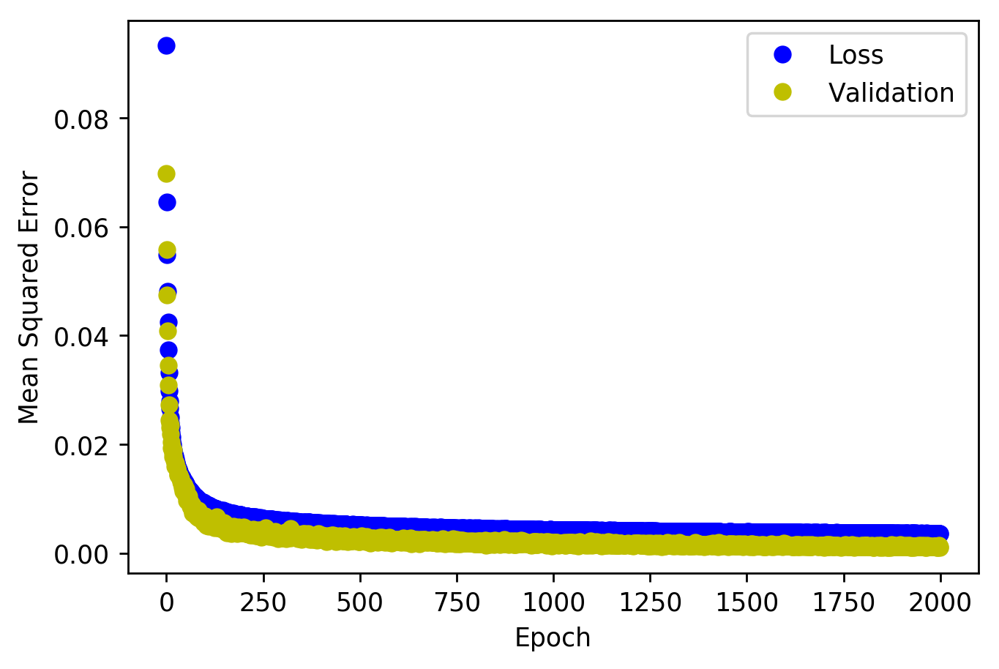

/home/rimali2009/anaconda3/envs/test3/lib/python3.6/site-packages/matplotlib/font_manager.py:1241: UserWarning: findfont: Font family ['Century Gothic'] not found. Falling back to DejaVu Sans.
  (prop.get_family(), self.defaultFamily[fontext]))


<Figure size 432x288 with 0 Axes>

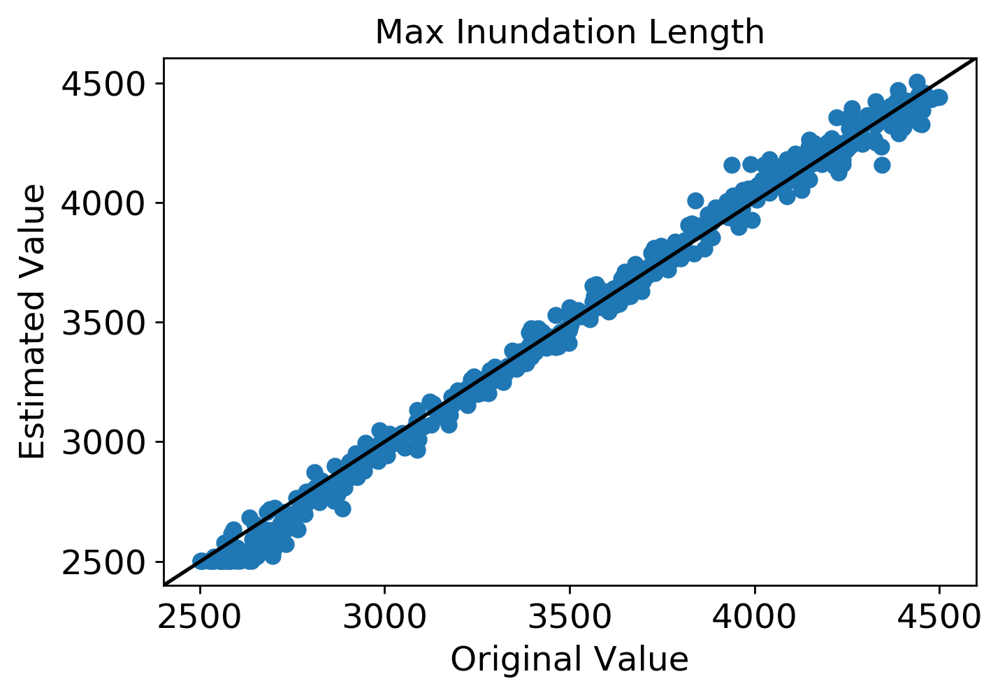

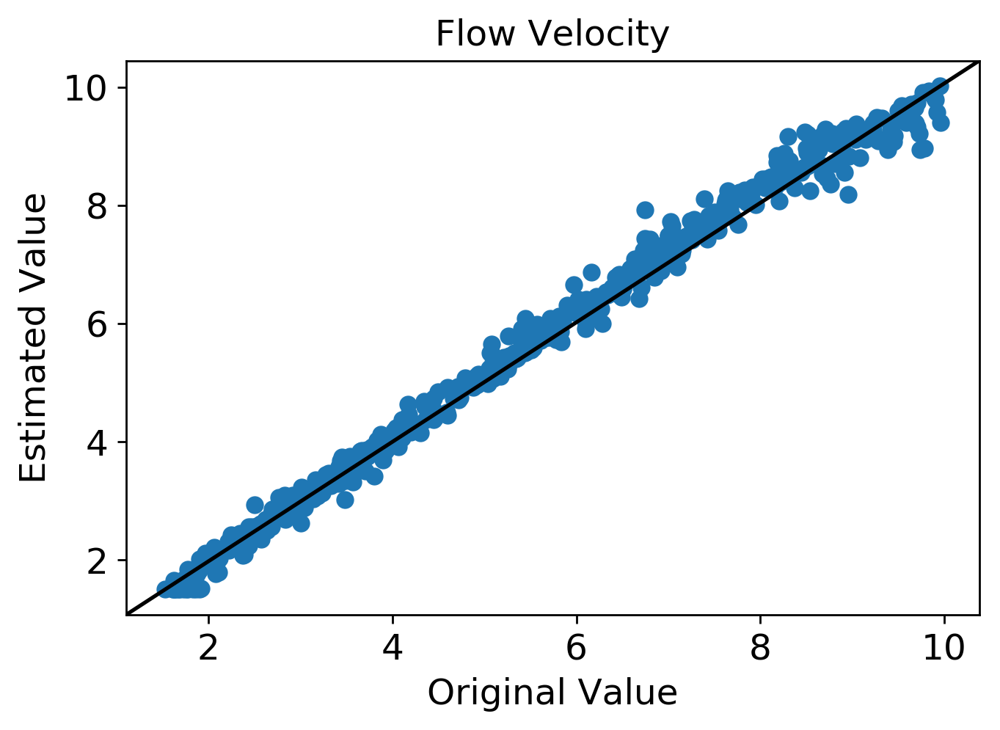

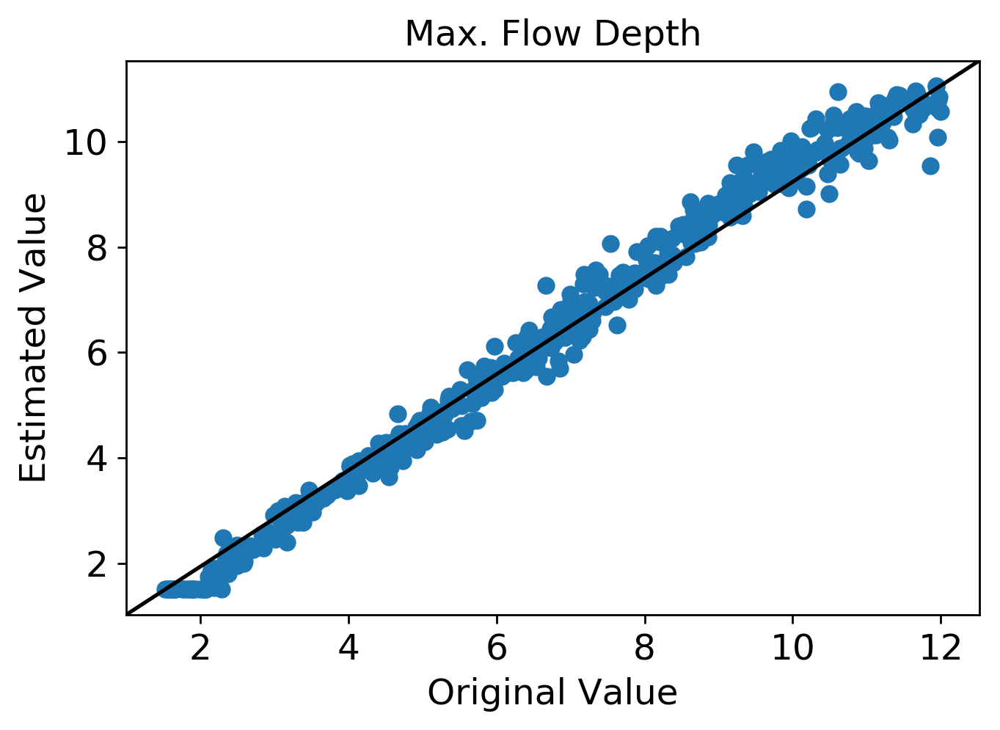

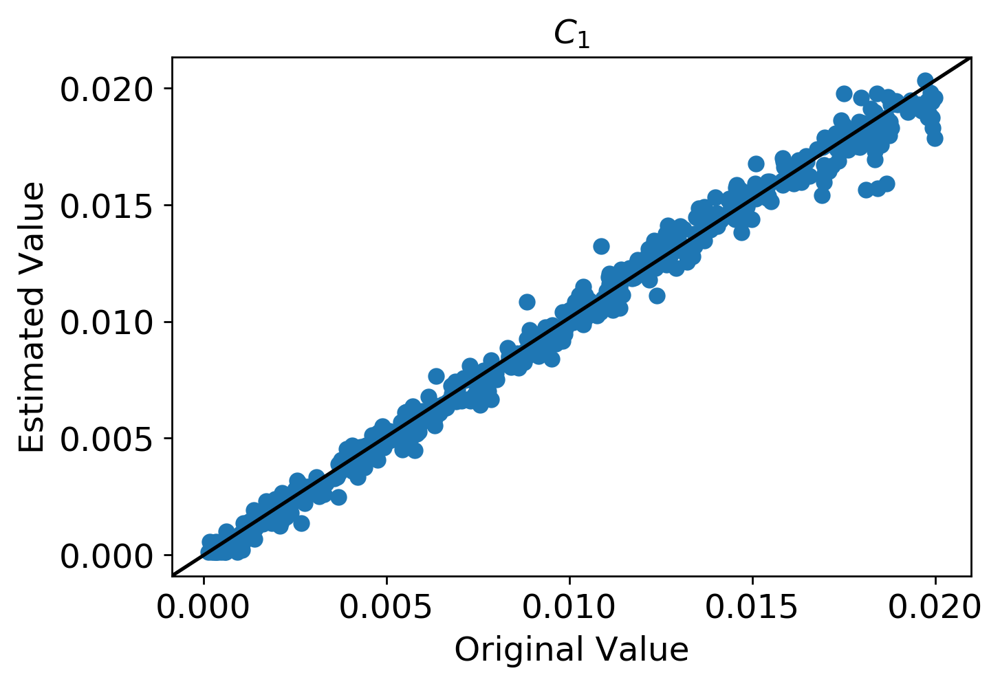

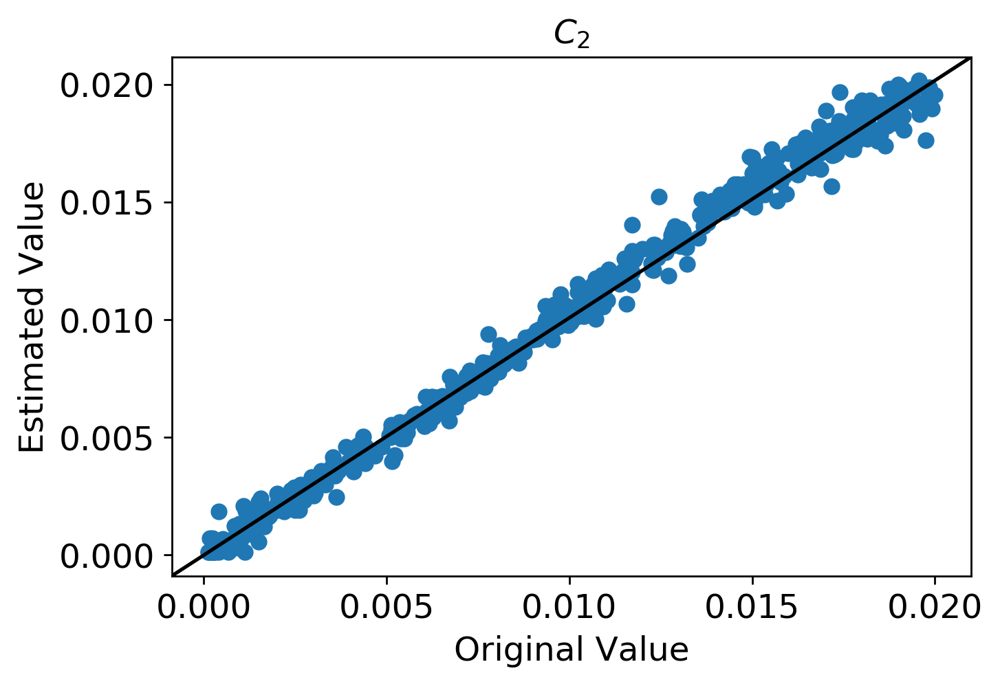

...

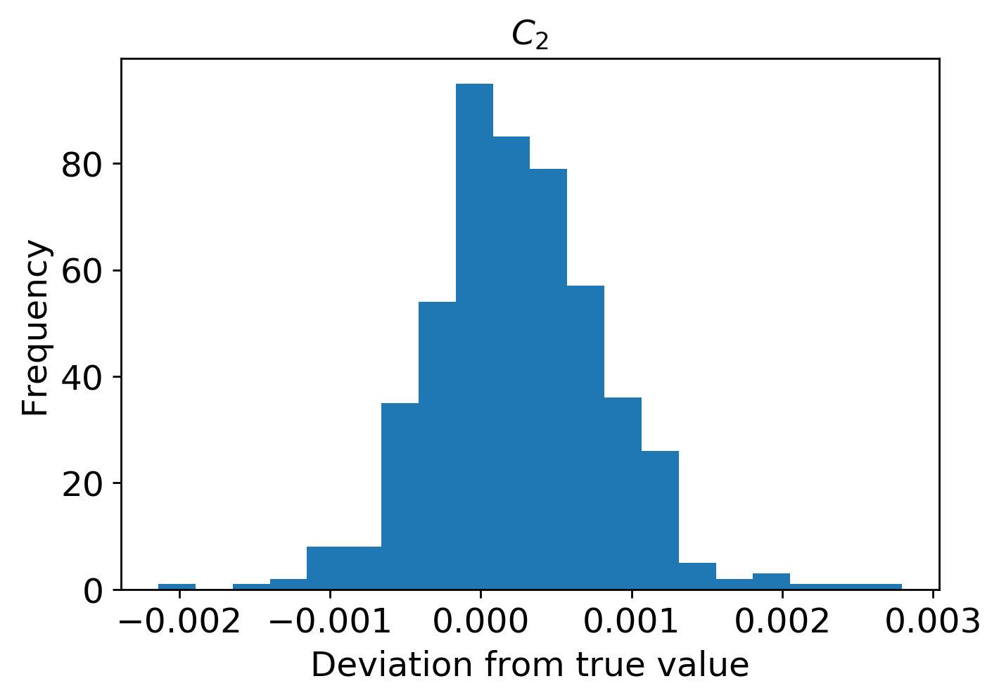

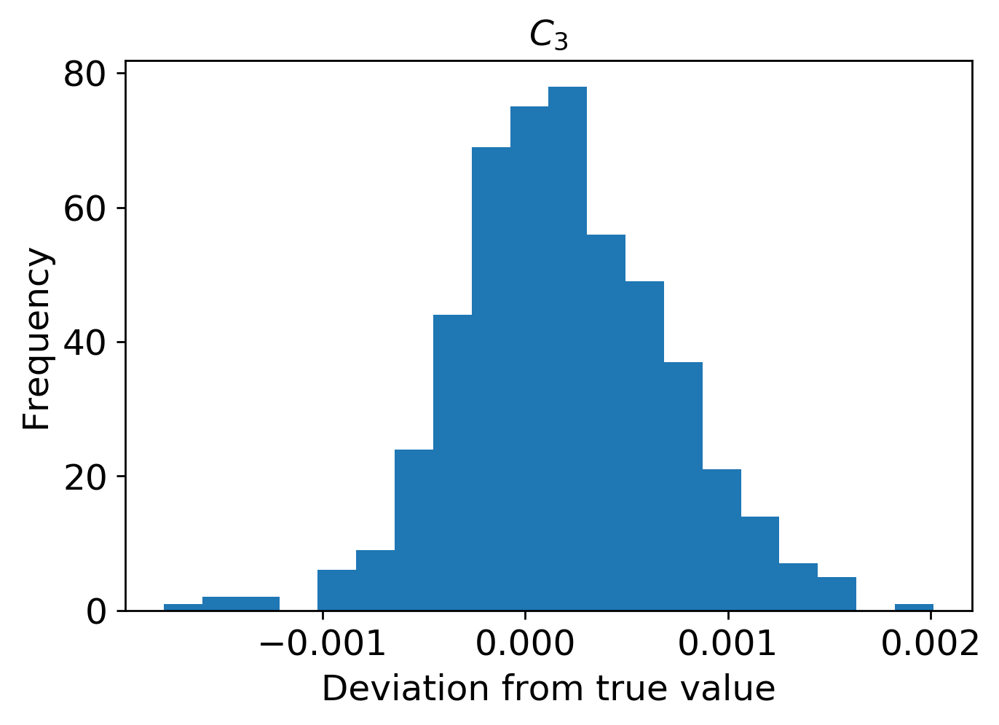

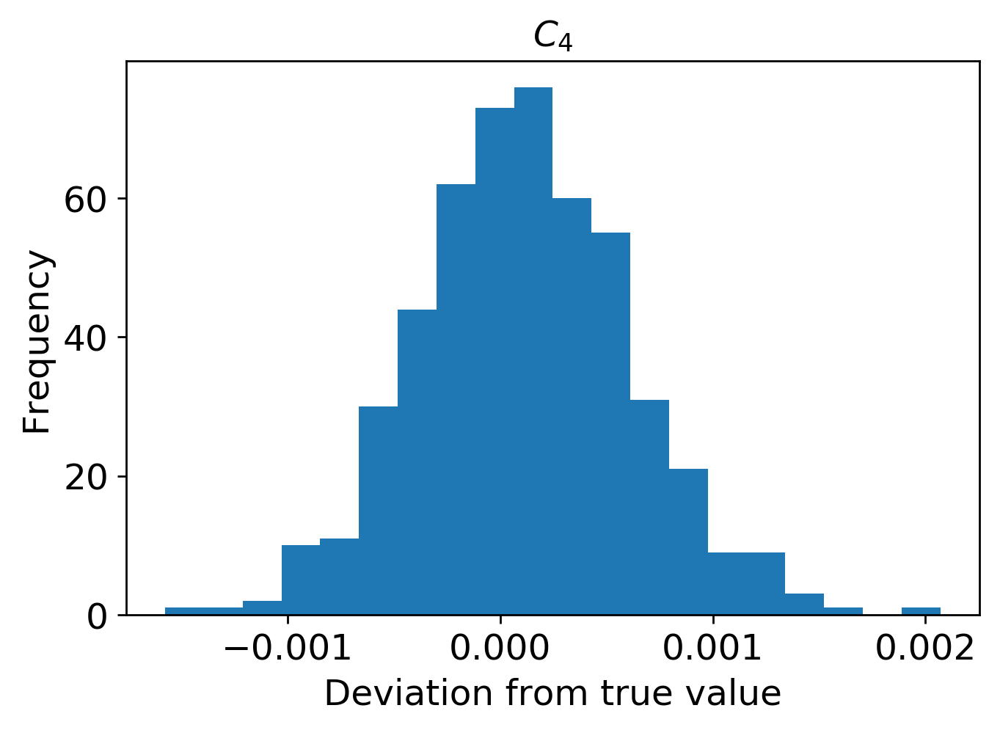

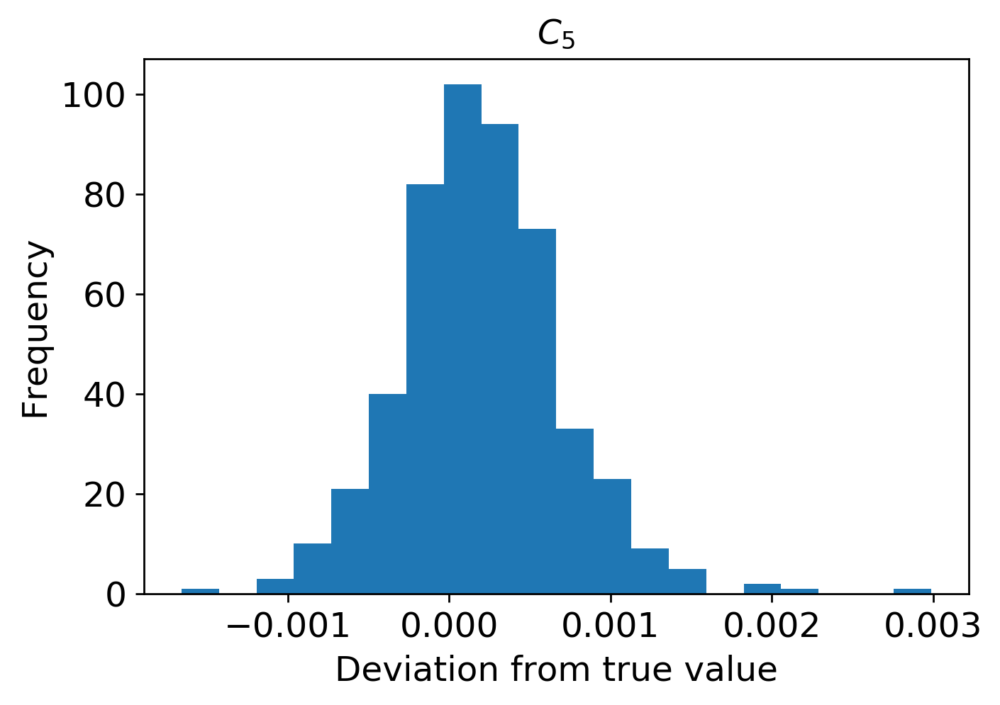

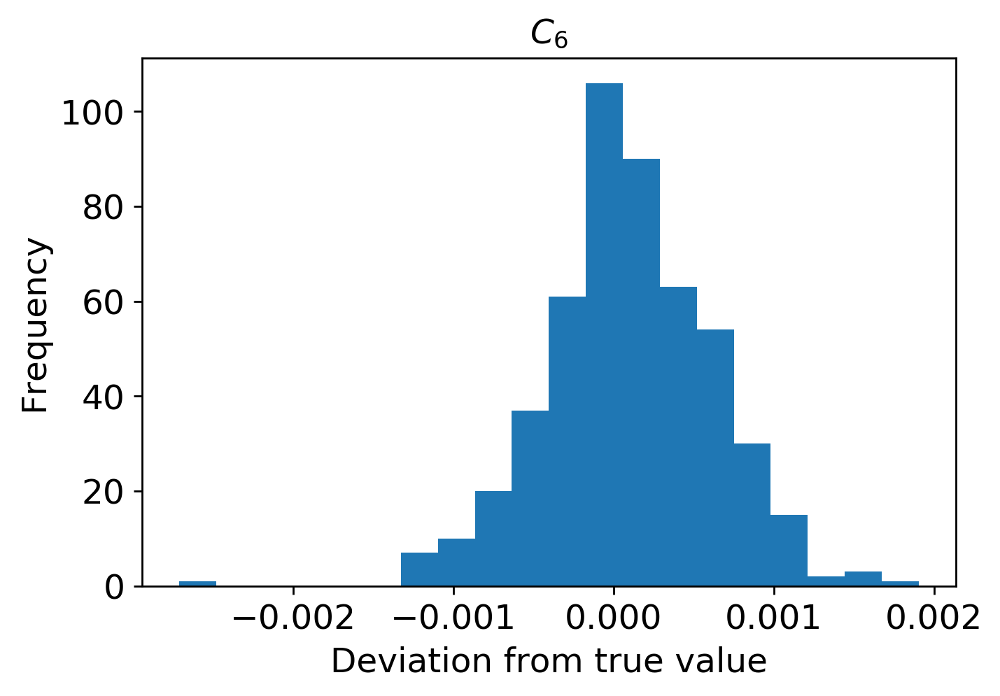

In [1]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi3100/'
resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi3100/4500/'

test_result = np.loadtxt(resdir + 'test_result.txt',delimiter=',')
icond = np.loadtxt(datadir + 'icond_test.txt',delimiter=',')
print(icond.shape)
loss = np.loadtxt(resdir+'loss.txt',delimiter=',')
epoch = range(0,2000)
vloss = np.loadtxt(resdir+'val_loss.txt',delimiter=',')
resi = test_result - icond

fig = plt.figure(num=None,dpi=250, facecolor='w', edgecolor='k')
plt.plot(epoch, loss, 'bo',label='Loss')
plt.plot(epoch, vloss, 'yo',label='Validation')
plt.xlabel('Epoch')
plt.ylabel('Mean Squared Error')
plt.legend(loc="upper right")
plt.savefig(resdir+ 'mse.eps')
plt.show()

fig2 = plt.figure()
hfont = {'fontname':'Century Gothic'}
textcol = 'k'
titlelabel = ['Max Inundation Length','Flow Velocity', 'Max. Flow Depth', '$C_1$', '$C_2$', '$C_3$', '$C_4$','$C_5$','$C_6$']


    
for i in range(len(titlelabel)):
    plt.figure(num=None,dpi=250, facecolor='w', edgecolor='k')
    plt.plot(icond[:,i],test_result[:,i],"o")
    x=icond[:,i]
    y=test_result[:,i]
    y_lim = plt.ylim()
    x_lim = plt.xlim()
    plt.plot(x_lim, y_lim, 'k-', color = 'k')
    plt.ylim(y_lim)
    plt.xlim(x_lim)
    plt.xlabel('Original Value',color=textcol,size=14,**hfont)
    plt.ylabel('Estimated Value',color=textcol,size=14,**hfont)
    plt.title(titlelabel[i],color=textcol,size=14,**hfont)
    plt.tick_params(labelsize=14,colors=textcol)
    plt.savefig(resdir+titlelabel[i] + '.eps')
    #plt.show()

for i in range(len(titlelabel)):
    plt.figure(num=None,dpi=250, facecolor='w', edgecolor='k')
    plt.hist(resi[:,i],bins=20)
    plt.title(titlelabel[i],color=textcol,size=14,**hfont)
    plt.xlabel('Deviation from true value',color=textcol,size=14,**hfont)
    plt.ylabel('Frequency',color=textcol,size=14,**hfont)
    plt.tick_params(labelsize=14,colors=textcol)
    plt.savefig(resdir+titlelabel[i] + 'hist' + '.eps')
    plt.show()

       distance        g1        g2        g3        g4        g5        g6
0      0.000000  0.036771  0.167260  0.114845  0.008449  0.002190  0.005161
1    103.794102  0.000000  0.075200  0.153283  0.013753  0.001885  0.000442
2    171.620654  0.002130  0.051171  0.084309  0.006218  0.001867  0.002843
3    397.112167  0.003115  0.016359  0.078858  0.011466  0.000597  0.000054
4    595.912969  0.000732  0.016896  0.028720  0.002661  0.000914  0.000000
5    707.625749  0.000143  0.002228  0.005502  0.000900  0.000187  0.000104
6    796.435078  0.000236  0.004337  0.021204  0.003169  0.000309  0.000080
7    895.065500  0.001688  0.016059  0.081413  0.020284  0.006824  0.004628
8    988.394177  0.004567  0.008166  0.074658  0.016913  0.002424  0.001580
9   1081.819325  0.001567  0.016305  0.060234  0.011086  0.004165  0.001994
10  1195.756993  0.001022  0.002370  0.017565  0.004194  0.000567  0.000142
11  1290.372534  0.000000  0.004121  0.057974  0.014565  0.000426  0.000213
12  1400.896

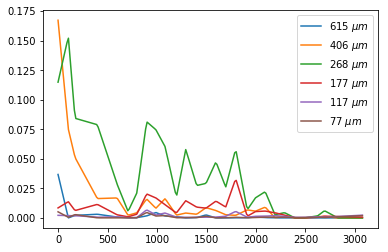

In [2]:
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.models import load_model
from scipy import stats
from scipy.interpolate import interp1d 
import pandas as pd
from pykrige import OrdinaryKriging as OK
import ipdb


datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi3100/'
resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi3100/4500/'
#Initial setting
if not "model" in locals(): 
    model = load_model(resdir+'model3.hdf5')
#gclass = 3
#gclass_label = ["500 $\mu$m","125 $\mu$m","63 $\mu$m"]
gclass = 6
gclass_label = ["615 ${\mu}m$","406 ${\mu}m$","268 ${\mu}m$","177 ${\mu}m$", "117 ${\mu}m$","77 ${\mu}m$"]
topodx = 15.0
coord_num = int(model.layers[0].input_shape[1]/gclass)

#Acquires a value for normalizing input data to [0, 1]
min_x, max_x = np.loadtxt(datadir + 'x_minmax.txt',delimiter=',')
y_min = np.loadtxt(datadir + 'icond_min.txt',delimiter=',')
y_max = np.loadtxt(datadir + 'icond_max.txt',delimiter=',')

#Read outcrop data
#dist_max = 22000. #Distance of distal end of learning data
outcrop = pd.read_csv('../FITTNUSS-forward_training_DNN/sendai_increased_class_edit.csv')
#outcrop = pd.read_csv('../DeepLearningTurbidite_Fukuda/GA_naruse_v2.csv')
#outcrop = outcrop.append(pd.DataFrame([[0,'Loc0',0,0,0],[dist_max,'LocE',0,0,0]], columns=outcrop.columns))
outcrop = outcrop.sort_values('distance')
outcrop['distance'] = outcrop['distance'] - 0
#d = pd.DataFrame(np.zeros((1, 7)),columns=['distance', 'g1','g2','g3','g4','g5','g6'])
#print(d)
#v=np.concatenate((outcrop, d))
#print(v)
#outcrop=pd.DataFrame(v,columns=['distance', 'g1','g2','g3','g4','g5','g6'])
#outcrop['distance'].iloc[-1]=4000
#outcrop = outcrop.append(pd.DataFrame([[0,'Loc0',0,0,0,0]], columns=outcrop.columns))
print(outcrop)

#Preparation under interpolation
thick_interp = np.zeros([1,coord_num*gclass])#補間されたサンプル厚さデータ
outcrop_x_id = np.round(outcrop['distance']/topodx).astype(np.int32) #逆解析システムでのサンプリング地点のindex番号
x = np.arange(0,coord_num*topodx,topodx)

#Complement data
for j in range(gclass):
    f = interp1d(outcrop['distance'],outcrop.iloc[:,j+1], kind="linear",bounds_error=False,fill_value='extrapolate')
    #f = interp1d(outcrop['distance'],outcrop.iloc[:,j+2], kind="linear",bounds_error=False,fill_value='extrapolate') 
    #Interpolation function of jth granularity level
    thick_interp[0,coord_num*j:coord_num*(j+1)] = f(x) #Supplemented data

#ipdb.set_trace()
#Kriging Interpolation by
#vparams = np.array([[0.035, 10000., 0.001],[0.006, 10000., 0.002],[0.005, 10000., 0.002],[0.035, 10000., 0.001]])
#for j in range(gclass):
    #okip = OK(outcrop['distance'],np.zeros(outcrop['distance'].shape),outcrop.iloc[:,j+1],variogram_model='linear',)
    #okip.display_variogram_model()
    #ipdata, ipstd = okip.execute('grid',x,np.array([0.]))
    #ipdata = np.squeeze(ipdata)
    #thick_interp[0,coord_num*j:coord_num*(j+1)] = ipdata #Assign complemented d

#Normalize data
thick_interp[thick_interp < 0] = 0
thick_interp_norm =  (thick_interp - min_x) / (max_x - min_x)

#Perform inverse analysis
test_result_outcrop = model.predict(thick_interp_norm)
test_result_outcrop = test_result_outcrop * (y_max - y_min) + y_min
print(test_result_outcrop)
#add=np.array(3000)
#test_result_outcrop_add=np.concatenate((add,test_result_outcrop), axis=None)
#Output results
#print(test_result_outcrop_add)
np.savetxt('outcrop_result_g6_g300_H_5000_20_11_roi3100.txt',test_result_outcrop, delimiter=',')
for i in range(len(gclass_label)):
    plt.plot(x,thick_interp[0,coord_num * i:coord_num * (i+1)],label=gclass_label[i])
plt.legend()
plt.show()



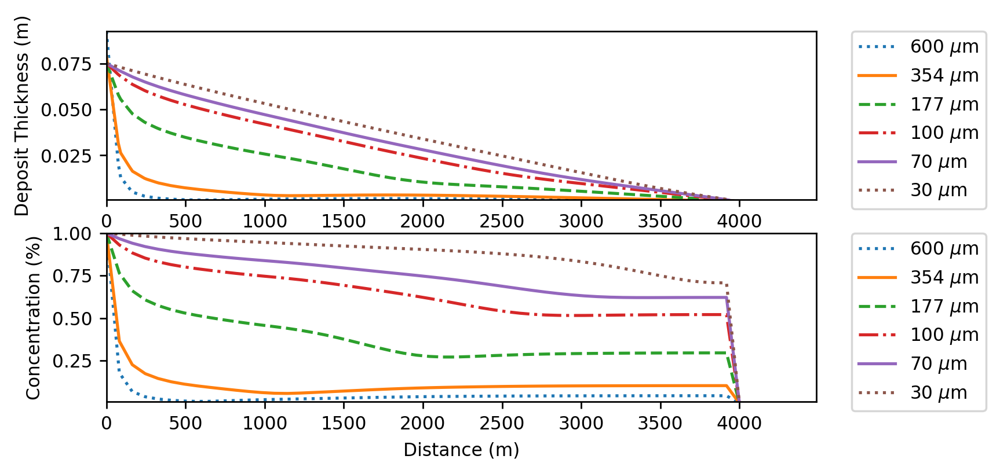

(5000, 9)
(5000, 1800)


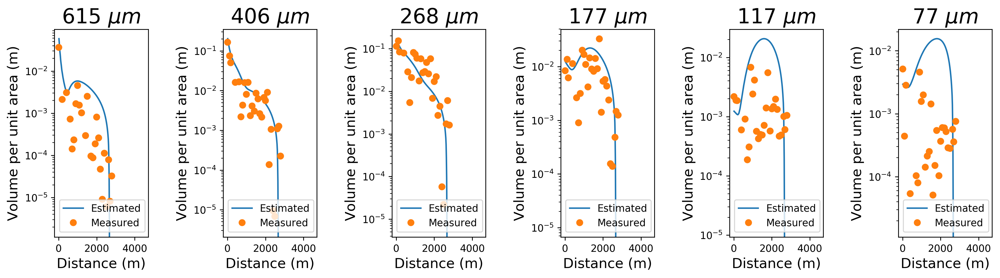

In [3]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import Forward_model_modified_FITTNUSS_5000_g6_300grid_19_11_case2 as fmodel
import time
import ipdb
%matplotlib inline

#Basic setting

#dist_max = 3000.
gclass = 6
topodx=15.0
gclass_name = ['615microm','406microm','268microm','177microm','117microm','77microm']
#gclass_name = ['500micron', '125micron', '63micron']
gname_tex = ["615 ${\mu}m$","406 ${\mu}m$","268 ${\mu}m$","177 ${\mu}m$", "117 ${\mu}m$","77 ${\mu}m$"]
#gname_tex = ['500 $\mu$m','125 $\mu$m','63 $\mu$m']
#calcdir = 'home/rimali2009/FITTNUSS-forward_training_DNN/'
#calcdir = '/home/naruse/Documents/Documents/MATLAB/TCtrainData_forML/TCModel_for_MLTEST/test_output_otadai07/'

#Load estimate
#H1 = np.loadtxt(calcdir + 'H1.txt',delimiter=',')
#H2 = np.loadtxt(calcdir + 'H2.txt',delimiter=',')
#H3 = np.loadtxt(calcdir + 'H3.txt',delimiter=',')
#H4 = np.loadtxt(calcdir + 'H4.txt',delimiter=',')
#Ht = np.loadtxt(calcdir + 'Ht.txt',delimiter=',')
#U = np.loadtxt(calcdir + 'U.txt',delimiter=',')
#xi = np.loadtxt(calcdir + 'xi.txt',delimiter=',')
#x = np.loadtxt(calcdir + 'x.txt',delimiter=',')
#x_bed = np.loadtxt(calcdir + 'x_init.txt',delimiter=',')
#eta_init = np.loadtxt(calcdir + 'eta_init.txt',delimiter=',')
#Ct = np.loadtxt(calcdir + 'Ct.txt',delimiter=',')
#time = np.loadtxt(calcdir + 'time.txt',delimiter=',')
estimated_icond=np.loadtxt('outcrop_result_g6_g300_H_5000_20_11_roi3100.txt', delimiter=',')
start = time.time()
fmodel.read_setfile("config_g6_300grid_19_11_case2.ini")
(x,C,x_dep,deposit) = fmodel.forward(estimated_icond)
np.savetxt('eta_estimated_thickness_5K_g6_TC4_Rwcnst_H_5000_20_11_roi3100.csv', deposit, delimiter=',')
np.savetxt('eta_estimated_Distance_5K_g6_TC4_Rwcnst_H_5000_20_11_roi3100.csv', x_dep,delimiter=',')
estimated_dep_thickness_5000=np.transpose(np.loadtxt('/home/rimali2009/FITTNUSS-forward_training_DNN/'+'eta_estimated_thickness_5K_g6_TC4_Rwcnst_H_5000_20_11_roi3100.csv', delimiter=','))
estimated_dep_thickness_5000=pd.DataFrame(estimated_dep_thickness_5000,columns=['615microm','406microm','268microm','177microm','117microm','77microm'])
estimated_dep_distance_5000=np.transpose(np.loadtxt('/home/rimali2009/FITTNUSS-forward_training_DNN/'+'eta_estimated_Distance_5K_g6_TC4_Rwcnst_H_5000_20_11_roi3100.csv', delimiter=','))
estimated_dep_distance_5000=pd.DataFrame(estimated_dep_distance_5000,columns=['distance'])
estimated_dep_5000=pd.concat([estimated_dep_distance_5000,estimated_dep_thickness_5000],axis=1)
np.savetxt('estimated_dep_5K_g6_TC4_Rwcnst_H_5000_20_11_roi3100.csv',estimated_dep_5000,delimiter=',')
#data_estim=pd.DataFrame(estimated_dep_5000,columns=['distance','1.5phi','2.5phi','3.5phi','4.5phi'])

#Formatting the loaded data
#estimated_dep_df = pd.DataFrame(estimated_dep,columns=['distance','1.5phi','2.5phi','3.5phi','4.5phi'])
#estimated_dep = pd.DataFrame(np.array([x_bed - dist_offset,H1[-1,:],H2[-1,:],H3[-1,:]]).T,columns=['distance','500micron','125micron','63micron'])
estimated_dep_5000= estimated_dep_5000.query('distance > 0')
#estimated_dep_5000 = estimated_dep_5000.query('distance < {}'.format(dist_max))

#Read original data
outcrop = pd.read_csv('../FITTNUSS-forward_training_DNN/sendai_increased_class.csv')
outcrop= pd.DataFrame(outcrop,columns=['distance','615microm','406microm','268microm','177microm','117microm','77microm'])
#outcrop = pd.read_csv('../DeepLearningTurbidite_Fukuda/GA_naruse_v2.csv')
#outcrop = outcrop.append(pd.DataFrame([[0,'Loc0',0,0,0],[dist_max,'LocE',0,0,0]], columns=outcrop.columns))
#outcrop = outcrop.sort_values('distance')
#outcrop['distance'] = outcrop['distance'] - 1000

#Plot
plt.figure(num=None, figsize=(17, 4), dpi=250, facecolor='w', edgecolor='g')
hfont = {'fontname':'Sans'}
plt.subplots_adjust(bottom=0.15, wspace=0.8)

for i in range(gclass):
    plt.subplot(1,gclass,i+1)
    plt.plot(estimated_dep_5000['distance'],estimated_dep_5000[gclass_name[i]],'-', label='Estimated')
    plt.plot(outcrop['distance'], outcrop[gclass_name[i]],'o', label='Measured')
    plt.yscale('log')
    plt.title(gname_tex[i], size=21,**hfont)
    plt.xlabel('Distance (m)', size = 14, **hfont)
    plt.ylabel('Volume per unit area (m)', size = 14, **hfont)
    plt.legend(fontsize=10)
    plt.savefig("thickness_distance_curve_5000_g6_300grid_H_5000_20_11_roi3100.png")
    plt.savefig("thickness_distance_curve_5000_g6_300grid_H_5000_20_11_roi3100.eps")
plt.show()



Using TensorFlow backend.


       distance        g1        g2        g3        g4        g5        g6
0      0.000000  0.036771  0.167260  0.114845  0.008449  0.002190  0.005161
1    103.794102  0.000000  0.075200  0.153283  0.013753  0.001885  0.000442
2    171.620654  0.002130  0.051171  0.084309  0.006218  0.001867  0.002843
3    397.112167  0.003115  0.016359  0.078858  0.011466  0.000597  0.000054
4    595.912969  0.000732  0.016896  0.028720  0.002661  0.000914  0.000000
5    707.625749  0.000143  0.002228  0.005502  0.000900  0.000187  0.000104
6    796.435078  0.000236  0.004337  0.021204  0.003169  0.000309  0.000080
7    895.065500  0.001688  0.016059  0.081413  0.020284  0.006824  0.004628
8    988.394177  0.004567  0.008166  0.074658  0.016913  0.002424  0.001580
9   1081.819325  0.001567  0.016305  0.060234  0.011086  0.004165  0.001994
10  1195.756993  0.001022  0.002370  0.017565  0.004194  0.000567  0.000142
11  1290.372534  0.000000  0.004121  0.057974  0.014565  0.000426  0.000213
12  1400.896

       distance        g1        g2        g3        g4        g5        g6
0      0.000000  0.036771  0.167260  0.114845  0.008449  0.002190  0.005161
1    103.794102  0.000000  0.075200  0.153283  0.013753  0.001885  0.000442
2    171.620654  0.002130  0.051171  0.084309  0.006218  0.001867  0.002843
3    397.112167  0.003115  0.016359  0.078858  0.011466  0.000597  0.000054
4    595.912969  0.000732  0.016896  0.028720  0.002661  0.000914  0.000000
5    707.625749  0.000143  0.002228  0.005502  0.000900  0.000187  0.000104
6    895.065500  0.001688  0.016059  0.081413  0.020284  0.006824  0.004628
7    988.394177  0.004567  0.008166  0.074658  0.016913  0.002424  0.001580
8   1081.819325  0.001567  0.016305  0.060234  0.011086  0.004165  0.001994
9   1195.756993  0.001022  0.002370  0.017565  0.004194  0.000567  0.000142
10  1290.372534  0.000000  0.004121  0.057974  0.014565  0.000426  0.000213
11  1400.896519  0.000295  0.003096  0.027406  0.009121  0.000502  0.000251
12  1495.352

/home/rimali2009/anaconda3/envs/test3/lib/python3.6/site-packages/matplotlib/font_manager.py:1241: UserWarning: findfont: Font family ['Century Gothic'] not found. Falling back to DejaVu Sans.
  (prop.get_family(), self.defaultFamily[fontext]))


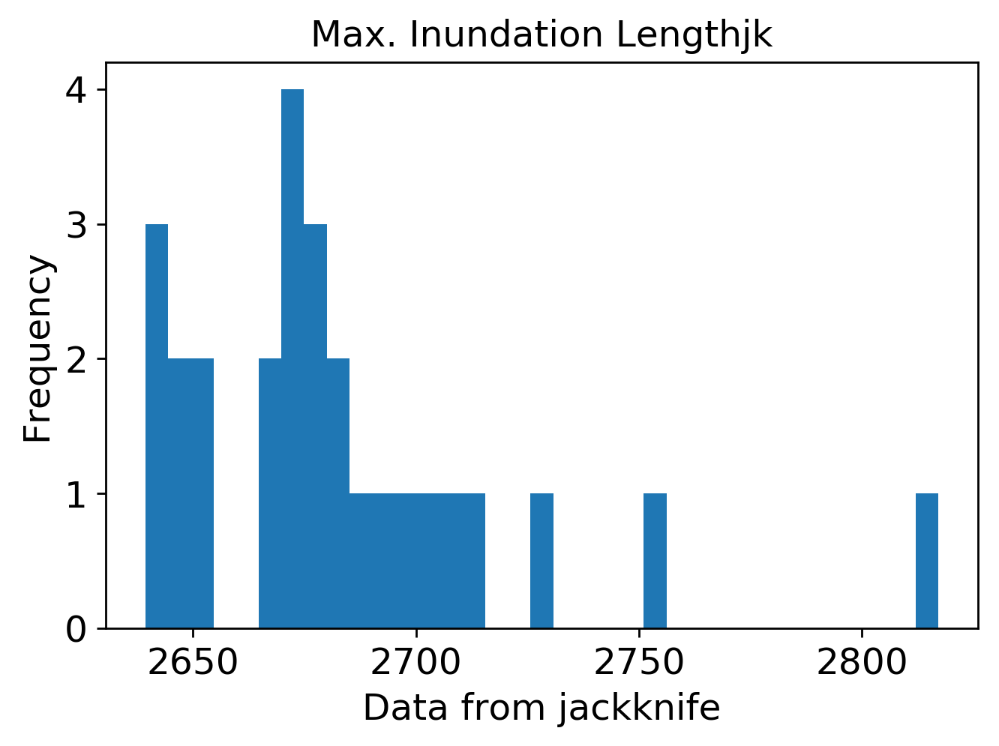

mean: 4.866138979642005
jk_e: 0.05908832215706445


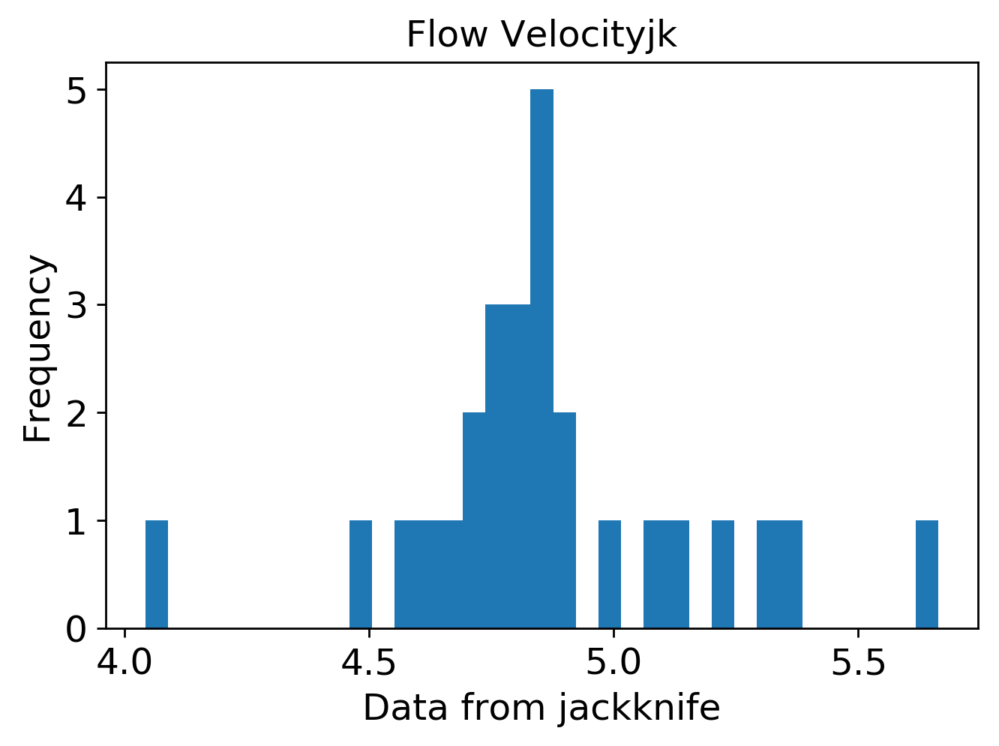

mean: 7.324044904688134
jk_e: 0.1232384358487752


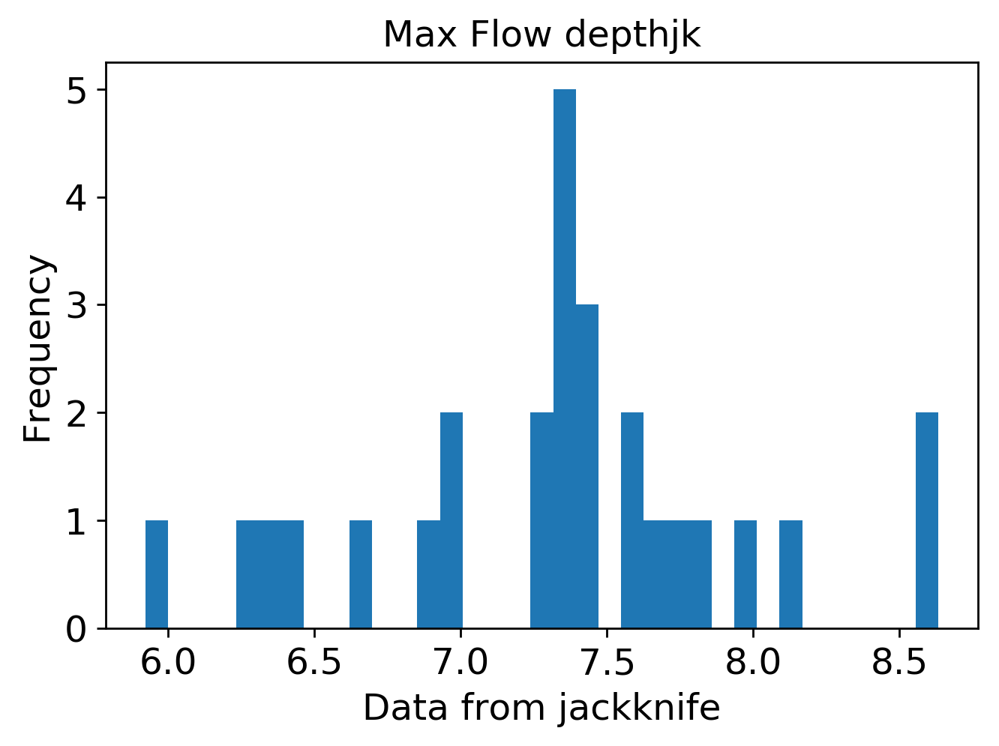

mean: 0.005370536737045635
jk_e: 0.00015124691431410298


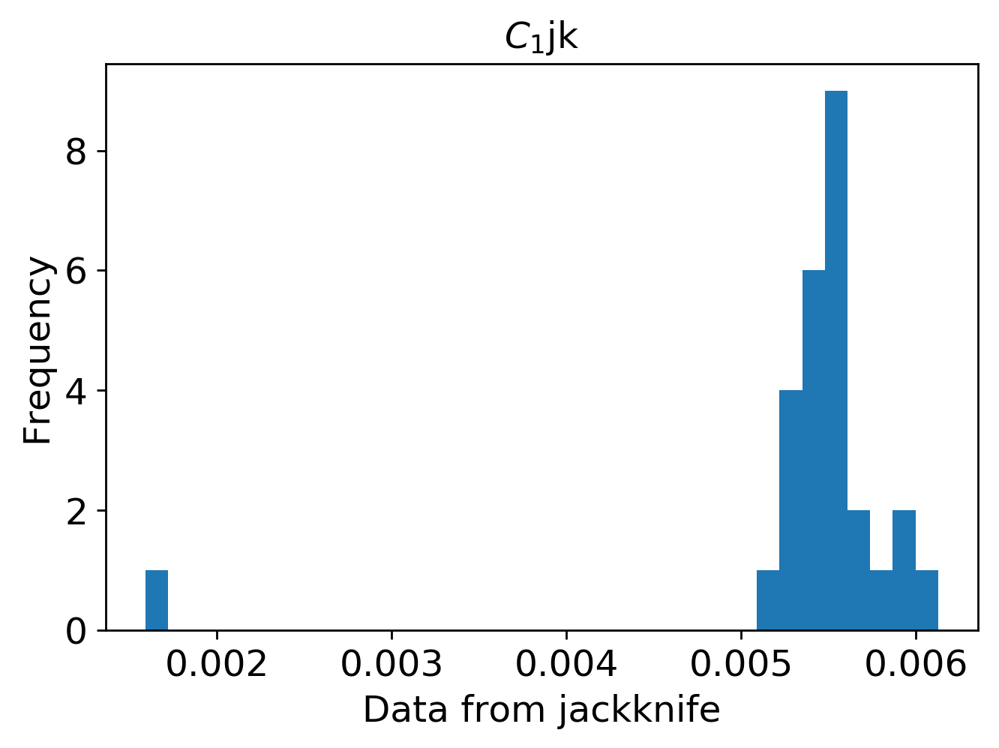

mean: 0.01802339963942069
jk_e: 0.00026164726263451017


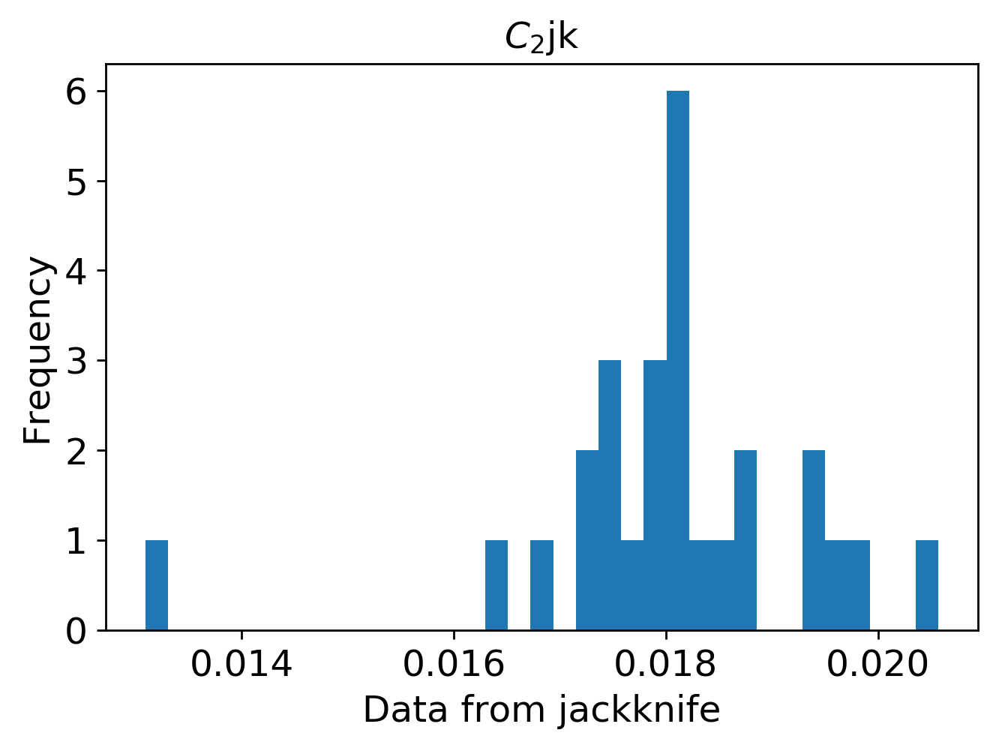

mean: 0.014850574705739103
jk_e: 0.00028344086155593026


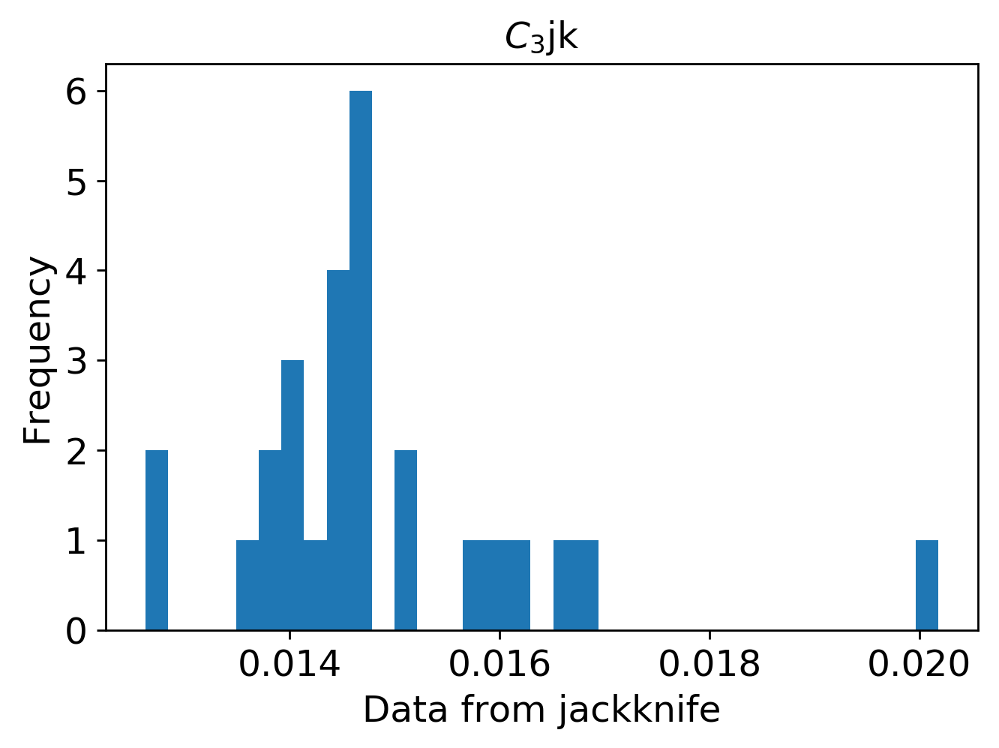

mean: 0.0011179628880806842
jk_e: 4.4140553712566874e-05


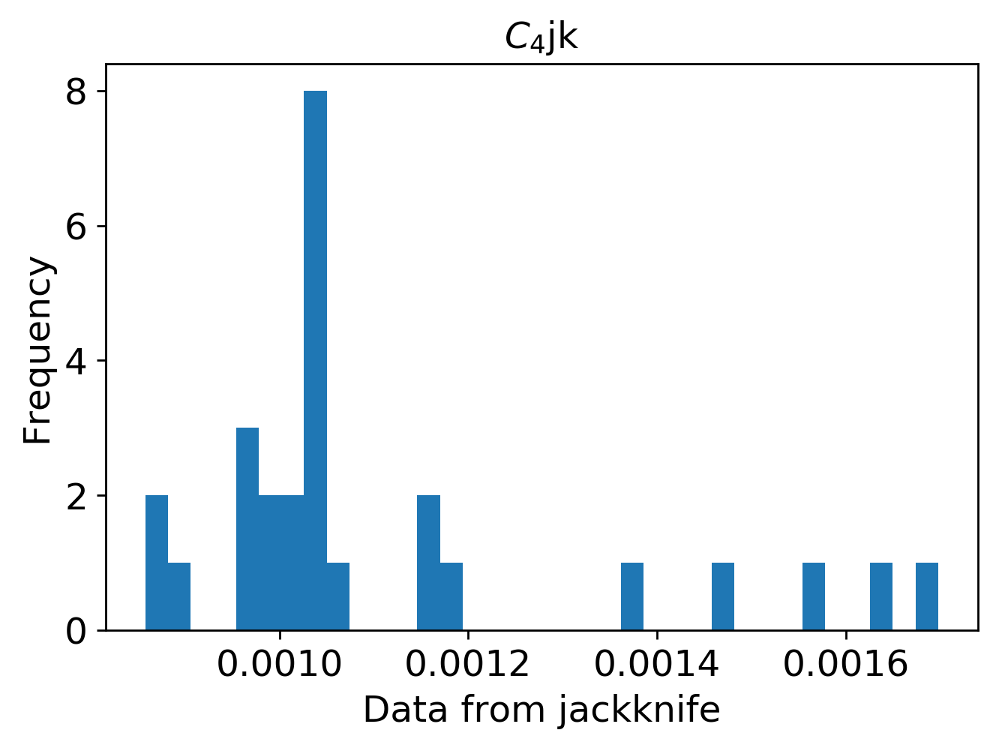

mean: 0.00010163452556796912
jk_e: 2.1541987209274835e-07


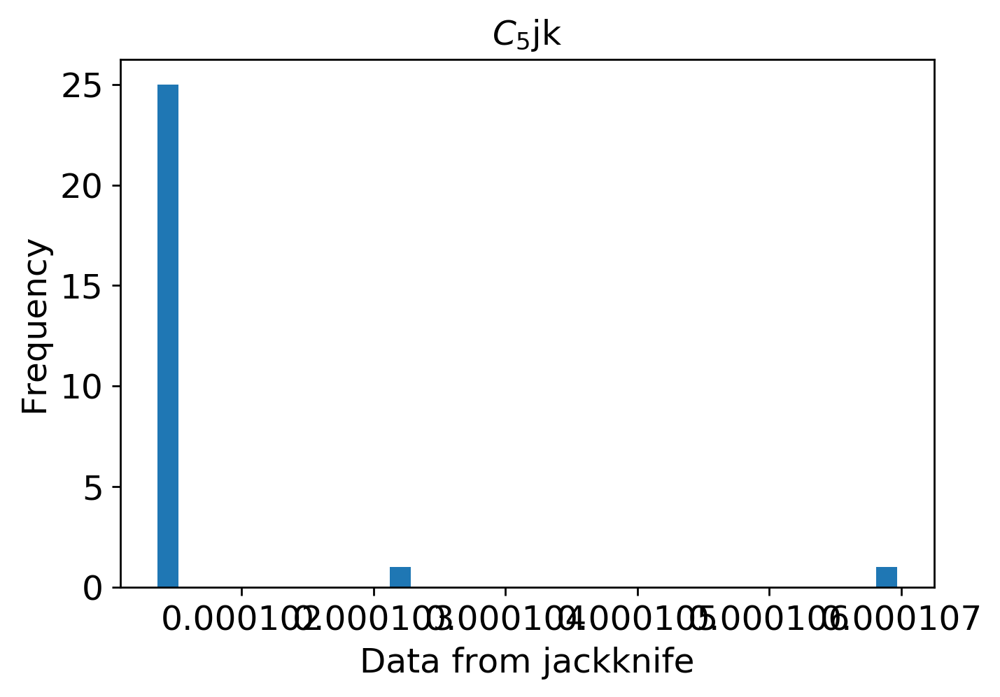

mean: 0.0002750884826412789
jk_e: 3.3773745680152584e-05


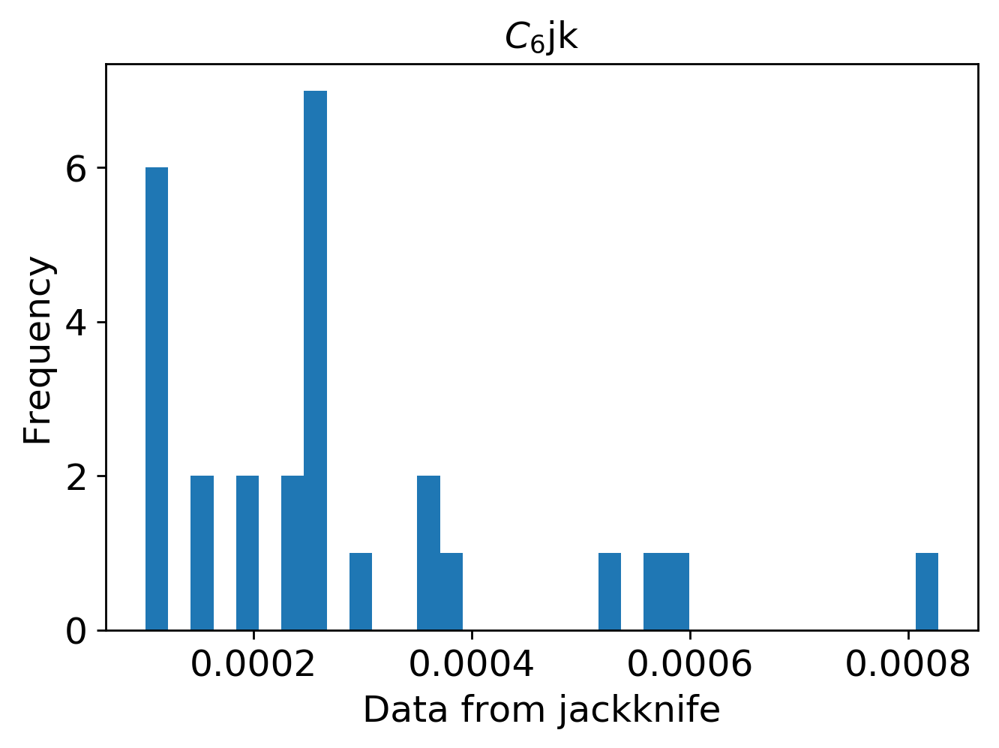

In [1]:
# Jackknife Method
import csv
import numpy as np
import pandas as pd
import math
from keras.models import load_model
from scipy.interpolate import interp1d
import matplotlib.pyplot as plt
%matplotlib inline

datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi3100/'
resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi3100/4500/'
# Initial setting
if not "model" in locals():
    model = load_model(resdir+'model3.hdf5')
gclass = 6
gclass_label = ["615 ${\mu}m$", "406 ${\mu}m$", "268 ${\mu}m$",
                "177 ${\mu}m$", "117 ${\mu}m$", "77 ${\mu}m$"]
topodx = 15.0
coord_num = int(model.layers[0].input_shape[1]/gclass)
min_x, max_x = np.loadtxt(datadir + 'x_minmax.txt', delimiter=',')
y_min = np.loadtxt(datadir + 'icond_min.txt', delimiter=',')
y_max = np.loadtxt(datadir + 'icond_max.txt', delimiter=',')


a = pd.read_csv(
    '../FITTNUSS-forward_training_DNN/sendai_increased_class_edit.csv', delimiter=',')
print(a)
y = pd.DataFrame()
output = []

with open('output_final_20_11_roi3100.csv', 'w') as outfile:

    # x=[]
    for index in range(len(a)):
        df = y.append(pd.read_csv(
            '../FITTNUSS-forward_training_DNN/sendai_increased_class_edit.csv', skiprows=[index+1]))
        print(df)
        df = df.sort_values('distance')
        thick_interp = np.zeros([1, coord_num*gclass])
        x = np.arange(0, coord_num*topodx, topodx)
        for j in range(gclass):
            # Interpolation function of jth granularity level
            f = interp1d(df['distance'], df.iloc[:, j+1],
                         kind="linear", bounds_error=False,fill_value='extrapolate')
            thick_interp[0, coord_num*j:coord_num*(j+1)] = f(x)
        thick_interp[thick_interp < 0] = 0
        thick_interp_norm = (thick_interp - min_x) / (max_x - min_x)
        test_result_outcrop = model.predict(thick_interp_norm)
        test_result_outcrop = test_result_outcrop * (y_max - y_min) + y_min
        print(test_result_outcrop.shape)
        print(test_result_outcrop)
    # output.append(test_result_outcrop)
        np.savetxt(outfile,test_result_outcrop, delimiter=',')
        # outfile.write('# New iteration\n')
hfont = {'fontname': 'Century Gothic'}
textcol = 'k'
resi = np.loadtxt('output_final_20_11_roi3100.csv', delimiter=',')
titlelabel = ['Max. Inundation Lengthjk','Flow Velocityjk', 'Max Flow depthjk',
              '$C_1$jk', '$C_2$jk', '$C_3$jk', '$C_4$jk', '$C_5$jk', '$C_6$jk']
jk_er=[]
with open('jk_e_roi3100.txt','wb') as ftext:
    for i in range(len(titlelabel)):
        plt.figure(num=None, dpi=250, facecolor='w', edgecolor='k')
        plt.hist(resi[:, i], bins=35)
        mean = sum(resi[:,i]) / len(resi[:,i])
        print("mean:",mean)
        var_jk  = sum(pow(x-mean,2) for x in resi[:,i]) / ((len(resi[:,i])-1)*(len(resi[:,i])))
        jk_e= math.sqrt(var_jk)
        print("jk_e:",jk_e)
        e=np.append(jk_e,jk_er)
        np.savetxt(ftext,e,delimiter=',')
        plt.title(titlelabel[i], color=textcol, size=14, **hfont)
        plt.xlabel('Data from jackknife', color=textcol, size=14, **hfont)
        plt.ylabel('Frequency', color=textcol, size=14, **hfont)
        plt.tick_params(labelsize=14, colors=textcol)
        plt.savefig(resdir+titlelabel[i] + 'jkhist' + '.eps')
        plt.show()


# ROI 3200

In [7]:

import numpy as np
import os
#import ipdb

def connect_dataset(file_list, icond_file_list, outputdir,
                    topodx=15, roi=2500, offset=5000,gclass_num=6,test_data_num=500):
    """
    複数のデータセットを連結する
    """
    #ipdb.set_trace()
    
    #Reading and combining files Decide start and end points of the learning area and convert them to grid numbers
    H = np.loadtxt(file_list[0], delimiter = ',')
    icond = np.loadtxt(icond_file_list[0], delimiter = ',')
    
    #Reading and combining files
    if len(file_list) > 1:
        for i in range(1, len(file_list)):
            H_temp = np.loadtxt(file_list[i], delimiter = ',')
            icond_temp = np.loadtxt(icond_file_list[i], delimiter = ',')
            H = np.concatenate((H,H_temp),axis=0)
            icond = np.concatenate((icond,icond_temp),axis = 0)
    
    roi_grids = int(roi / topodx)
    num_grids = int(H.shape[1] / gclass_num)
    H_subset = np.zeros([H.shape[0], roi_grids * gclass_num])
    for i in range(gclass_num):
        H_subset[:, i*roi_grids:(i+1)*roi_grids] = H[:, i*num_grids:(i*num_grids+roi_grids)]
    
    #Obtain the maximum and minimum values of data
    max_x = np.max(H_subset)
    min_x = np.min(H_subset)
    icond_max = np.max(icond, axis=0)
    icond_min = np.min(icond, axis=0)
    
    #Split the data into tests and training
    H_train = H_subset[0:-test_data_num,:]
    H_test = H_subset[H_subset.shape[0] - test_data_num:,:]
    icond_train = icond[0:-test_data_num,:]
    icond_test = icond[H.shape[0] - test_data_num:,:]
    
    #Save the data
    if not os.path.exists(outputdir):
        os.mkdir(outputdir)
    np.savetxt(outputdir + '/x_train.txt',H_train,delimiter = ',')
    np.savetxt(outputdir + '/x_test.txt',H_test,delimiter = ',')
    np.savetxt(outputdir + '/icond_train.txt',icond_train,delimiter = ',')
    np.savetxt(outputdir + '/icond_test.txt',icond_test,delimiter = ',')
    np.savetxt(outputdir + '/icond_min.txt',icond_min,delimiter = ',')
    np.savetxt(outputdir + '/icond_max.txt',icond_max,delimiter = ',')
    np.savetxt(outputdir + '/x_minmax.txt',[min_x, max_x],delimiter = ',')
    
    
if __name__=="__main__":
    original_data_dir = "/home/rimali2009/FITTNUSS-forward_training_DNN"
    parent_dir = "/home/rimali2009/FITTNUSS-forward_training_DNN"
    if not os.path.exists(parent_dir):
        os.mkdir(parent_dir)
    outputdir = parent_dir + "/data_g6_300grid_H_5000_20_11_roi3200"
    file_list = ['/home/rimali2009/FITTNUSS-forward_training_DNN/eta_5000_g6_300grid_19_11.csv']
    initial_conditions = ['/home/rimali2009/FITTNUSS-forward_training_DNN/start_param_random_5000_g6_300grid_19_11.csv']
connect_dataset(file_list, initial_conditions, outputdir, test_data_num=500, gclass_num=6, topodx=15., roi=3200)
        
        
    

Train on 3600 samples, validate on 900 samples
Epoch 1/2000
3600/3600 [==============================] - 2s 481us/step - loss: 0.0941 - mean_squared_error: 0.0941 - val_loss: 0.0693 - val_mean_squared_error: 0.0693
Epoch 2/2000
3600/3600 [==============================] - 1s 410us/step - loss: 0.0642 - mean_squared_error: 0.0642 - val_loss: 0.0565 - val_mean_squared_error: 0.0565
Epoch 3/2000
3600/3600 [==============================] - 1s 399us/step - loss: 0.0550 - mean_squared_error: 0.0550 - val_loss: 0.0486 - val_mean_squared_error: 0.0486
Epoch 4/2000
3600/3600 [==============================] - 1s 381us/step - loss: 0.0489 - mean_squared_error: 0.0489 - val_loss: 0.0422 - val_mean_squared_error: 0.0422
Epoch 5/2000
3600/3600 [==============================] - 1s 416us/step - loss: 0.0434 - mean_squared_error: 0.0434 - val_loss: 0.0359 - val_mean_squared_error: 0.0359
Epoch 6/2000
3600/3600 [==============================] - 1s 389us/step - loss: 0.0383 - mean_squared_error: 0.03

3600/3600 [==============================] - 1s 394us/step - loss: 0.0092 - mean_squared_error: 0.0092 - val_loss: 0.0070 - val_mean_squared_error: 0.0070
Epoch 98/2000
3600/3600 [==============================] - 1s 395us/step - loss: 0.0091 - mean_squared_error: 0.0091 - val_loss: 0.0062 - val_mean_squared_error: 0.0062
Epoch 99/2000
3600/3600 [==============================] - 1s 399us/step - loss: 0.0092 - mean_squared_error: 0.0092 - val_loss: 0.0060 - val_mean_squared_error: 0.0060
Epoch 100/2000
3600/3600 [==============================] - 1s 376us/step - loss: 0.0093 - mean_squared_error: 0.0093 - val_loss: 0.0059 - val_mean_squared_error: 0.0059
Epoch 101/2000
3600/3600 [==============================] - 1s 363us/step - loss: 0.0089 - mean_squared_error: 0.0089 - val_loss: 0.0059 - val_mean_squared_error: 0.0059
Epoch 102/2000
3600/3600 [==============================] - 1s 391us/step - loss: 0.0090 - mean_squared_error: 0.0090 - val_loss: 0.0059 - val_mean_squared_error: 0.00

3600/3600 [==============================] - 1s 390us/step - loss: 0.0070 - mean_squared_error: 0.0070 - val_loss: 0.0040 - val_mean_squared_error: 0.0040
Epoch 194/2000
3600/3600 [==============================] - 1s 411us/step - loss: 0.0069 - mean_squared_error: 0.0069 - val_loss: 0.0045 - val_mean_squared_error: 0.0045
Epoch 195/2000
3600/3600 [==============================] - 1s 410us/step - loss: 0.0070 - mean_squared_error: 0.0070 - val_loss: 0.0045 - val_mean_squared_error: 0.0045
Epoch 196/2000
3600/3600 [==============================] - 1s 375us/step - loss: 0.0069 - mean_squared_error: 0.0069 - val_loss: 0.0046 - val_mean_squared_error: 0.0046
Epoch 197/2000
3600/3600 [==============================] - 1s 385us/step - loss: 0.0069 - mean_squared_error: 0.0069 - val_loss: 0.0044 - val_mean_squared_error: 0.0044
Epoch 198/2000
3600/3600 [==============================] - 1s 361us/step - loss: 0.0069 - mean_squared_error: 0.0069 - val_loss: 0.0040 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 406us/step - loss: 0.0061 - mean_squared_error: 0.0061 - val_loss: 0.0032 - val_mean_squared_error: 0.0032
Epoch 290/2000
3600/3600 [==============================] - 1s 395us/step - loss: 0.0061 - mean_squared_error: 0.0061 - val_loss: 0.0031 - val_mean_squared_error: 0.0031
Epoch 291/2000
3600/3600 [==============================] - 1s 389us/step - loss: 0.0061 - mean_squared_error: 0.0061 - val_loss: 0.0036 - val_mean_squared_error: 0.0036
Epoch 292/2000
3600/3600 [==============================] - 1s 394us/step - loss: 0.0061 - mean_squared_error: 0.0061 - val_loss: 0.0033 - val_mean_squared_error: 0.0033
Epoch 293/2000
3600/3600 [==============================] - 1s 385us/step - loss: 0.0060 - mean_squared_error: 0.0060 - val_loss: 0.0028 - val_mean_squared_error: 0.0028
Epoch 294/2000
3600/3600 [==============================] - 1s 398us/step - loss: 0.0061 - mean_squared_error: 0.0061 - val_loss: 0.0039 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 398us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0027 - val_mean_squared_error: 0.0027
Epoch 386/2000
3600/3600 [==============================] - 1s 381us/step - loss: 0.0056 - mean_squared_error: 0.0056 - val_loss: 0.0029 - val_mean_squared_error: 0.0029
Epoch 387/2000
3600/3600 [==============================] - 1s 406us/step - loss: 0.0055 - mean_squared_error: 0.0055 - val_loss: 0.0030 - val_mean_squared_error: 0.0030
Epoch 388/2000
3600/3600 [==============================] - 1s 406us/step - loss: 0.0055 - mean_squared_error: 0.0055 - val_loss: 0.0027 - val_mean_squared_error: 0.0027
Epoch 389/2000
3600/3600 [==============================] - 1s 377us/step - loss: 0.0055 - mean_squared_error: 0.0055 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 390/2000
3600/3600 [==============================] - 1s 397us/step - loss: 0.0056 - mean_squared_error: 0.0056 - val_loss: 0.0030 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 381us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0028 - val_mean_squared_error: 0.0028
Epoch 482/2000
3600/3600 [==============================] - 1s 364us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0024 - val_mean_squared_error: 0.0024
Epoch 483/2000
3600/3600 [==============================] - 1s 373us/step - loss: 0.0052 - mean_squared_error: 0.0052 - val_loss: 0.0023 - val_mean_squared_error: 0.0023
Epoch 484/2000
3600/3600 [==============================] - 2s 418us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0031 - val_mean_squared_error: 0.0031
Epoch 485/2000
3600/3600 [==============================] - 1s 362us/step - loss: 0.0052 - mean_squared_error: 0.0052 - val_loss: 0.0027 - val_mean_squared_error: 0.0027
Epoch 486/2000
3600/3600 [==============================] - 1s 409us/step - loss: 0.0052 - mean_squared_error: 0.0052 - val_loss: 0.0028 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 415us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 578/2000
3600/3600 [==============================] - 1s 393us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0026 - val_mean_squared_error: 0.0026
Epoch 579/2000
3600/3600 [==============================] - 1s 393us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0022 - val_mean_squared_error: 0.0022
Epoch 580/2000
3600/3600 [==============================] - 1s 409us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 581/2000
3600/3600 [==============================] - 1s 371us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0021 - val_mean_squared_error: 0.0021
Epoch 582/2000
3600/3600 [==============================] - 1s 410us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0024 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 389us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0021 - val_mean_squared_error: 0.0021
Epoch 674/2000
3600/3600 [==============================] - 1s 380us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0021 - val_mean_squared_error: 0.0021
Epoch 675/2000
3600/3600 [==============================] - 1s 384us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 676/2000
3600/3600 [==============================] - 1s 379us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0018 - val_mean_squared_error: 0.0018
Epoch 677/2000
3600/3600 [==============================] - 2s 426us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0022 - val_mean_squared_error: 0.0022
Epoch 678/2000
3600/3600 [==============================] - 1s 395us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0023 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 390us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0020 - val_mean_squared_error: 0.0020
Epoch 770/2000
3600/3600 [==============================] - 1s 402us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0018 - val_mean_squared_error: 0.0018
Epoch 771/2000
3600/3600 [==============================] - 1s 385us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0021 - val_mean_squared_error: 0.0021
Epoch 772/2000
3600/3600 [==============================] - 1s 401us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0022 - val_mean_squared_error: 0.0022
Epoch 773/2000
3600/3600 [==============================] - 1s 386us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0022 - val_mean_squared_error: 0.0022
Epoch 774/2000
3600/3600 [==============================] - 1s 397us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0016 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 403us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0020 - val_mean_squared_error: 0.0020
Epoch 866/2000
3600/3600 [==============================] - 1s 402us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0020 - val_mean_squared_error: 0.0020
Epoch 867/2000
3600/3600 [==============================] - 1s 403us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0020 - val_mean_squared_error: 0.0020
Epoch 868/2000
3600/3600 [==============================] - 1s 377us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 869/2000
3600/3600 [==============================] - 1s 401us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0023 - val_mean_squared_error: 0.0023
Epoch 870/2000
3600/3600 [==============================] - 1s 394us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0018 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 371us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 962/2000
3600/3600 [==============================] - 1s 364us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0019 - val_mean_squared_error: 0.0019
Epoch 963/2000
3600/3600 [==============================] - 1s 371us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0017 - val_mean_squared_error: 0.0017
Epoch 964/2000
3600/3600 [==============================] - 1s 380us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0019 - val_mean_squared_error: 0.0019
Epoch 965/2000
3600/3600 [==============================] - 1s 385us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 966/2000
3600/3600 [==============================] - 1s 379us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0019 - val_mean_squared_error: 0.

3600/3600 [==============================] - 2s 421us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0017 - val_mean_squared_error: 0.0017
Epoch 1058/2000
3600/3600 [==============================] - 1s 387us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0022 - val_mean_squared_error: 0.0022
Epoch 1059/2000
3600/3600 [==============================] - 1s 384us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0018 - val_mean_squared_error: 0.0018
Epoch 1060/2000
3600/3600 [==============================] - 2s 417us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0018 - val_mean_squared_error: 0.0018
Epoch 1061/2000
3600/3600 [==============================] - 1s 403us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0018 - val_mean_squared_error: 0.0018
Epoch 1062/2000
3600/3600 [==============================] - 1s 409us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0016 - val_mean_squared_erro

3600/3600 [==============================] - 1s 413us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1106/2000
3600/3600 [==============================] - 1s 393us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1107/2000
3600/3600 [==============================] - 1s 393us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0017 - val_mean_squared_error: 0.0017
Epoch 1108/2000
3600/3600 [==============================] - 1s 397us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0019 - val_mean_squared_error: 0.0019
Epoch 1109/2000
3600/3600 [==============================] - 1s 389us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0018 - val_mean_squared_error: 0.0018
Epoch 1110/2000
3600/3600 [==============================] - 1s 388us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0018 - val_mean_squared_erro

3600/3600 [==============================] - 1s 385us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1154/2000
3600/3600 [==============================] - 1s 392us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1155/2000
3600/3600 [==============================] - 1s 408us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1156/2000
3600/3600 [==============================] - 1s 403us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1157/2000
3600/3600 [==============================] - 1s 368us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0017 - val_mean_squared_error: 0.0017
Epoch 1158/2000
3600/3600 [==============================] - 1s 395us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0019 - val_mean_squared_erro

3600/3600 [==============================] - 1s 397us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0017 - val_mean_squared_error: 0.0017
Epoch 1202/2000
3600/3600 [==============================] - 1s 373us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1203/2000
3600/3600 [==============================] - 1s 397us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1204/2000
3600/3600 [==============================] - 1s 395us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1205/2000
3600/3600 [==============================] - 1s 377us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0017 - val_mean_squared_error: 0.0017
Epoch 1206/2000
3600/3600 [==============================] - 1s 372us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0016 - val_mean_squared_erro

3600/3600 [==============================] - 1s 406us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1250/2000
3600/3600 [==============================] - 1s 385us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1251/2000
3600/3600 [==============================] - 1s 385us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1252/2000
3600/3600 [==============================] - 2s 421us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1253/2000
3600/3600 [==============================] - 1s 386us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1254/2000
3600/3600 [==============================] - 1s 365us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0016 - val_mean_squared_erro

3600/3600 [==============================] - 1s 392us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1298/2000
3600/3600 [==============================] - 1s 395us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1299/2000
3600/3600 [==============================] - 1s 398us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1300/2000
3600/3600 [==============================] - 1s 369us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1301/2000
3600/3600 [==============================] - 1s 393us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1302/2000
3600/3600 [==============================] - 1s 390us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0016 - val_mean_squared_erro

3600/3600 [==============================] - 1s 375us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1346/2000
3600/3600 [==============================] - 1s 389us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1347/2000
3600/3600 [==============================] - 1s 407us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1348/2000
3600/3600 [==============================] - 1s 383us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0017 - val_mean_squared_error: 0.0017
Epoch 1349/2000
3600/3600 [==============================] - 1s 385us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1350/2000
3600/3600 [==============================] - 1s 408us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0016 - val_mean_squared_erro

3600/3600 [==============================] - 1s 375us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1394/2000
3600/3600 [==============================] - 1s 371us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1395/2000
3600/3600 [==============================] - 1s 387us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1396/2000
3600/3600 [==============================] - 1s 394us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1397/2000
3600/3600 [==============================] - 1s 399us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1398/2000
3600/3600 [==============================] - 1s 392us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0018 - val_mean_squared_erro

3600/3600 [==============================] - 1s 368us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1442/2000
3600/3600 [==============================] - 1s 378us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1443/2000
3600/3600 [==============================] - 1s 410us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1444/2000
3600/3600 [==============================] - 1s 373us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1445/2000
3600/3600 [==============================] - 1s 386us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1446/2000
3600/3600 [==============================] - 1s 384us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0014 - val_mean_squared_erro

3600/3600 [==============================] - 1s 396us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1490/2000
3600/3600 [==============================] - 1s 398us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1491/2000
3600/3600 [==============================] - 2s 423us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1492/2000
3600/3600 [==============================] - 1s 399us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1493/2000
3600/3600 [==============================] - 2s 418us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1494/2000
3600/3600 [==============================] - 1s 405us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0016 - val_mean_squared_erro

3600/3600 [==============================] - 1s 371us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1538/2000
3600/3600 [==============================] - 1s 379us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1539/2000
3600/3600 [==============================] - 1s 391us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1540/2000
3600/3600 [==============================] - 1s 392us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1541/2000
3600/3600 [==============================] - 2s 425us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1542/2000
3600/3600 [==============================] - 1s 404us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0013 - val_mean_squared_erro

3600/3600 [==============================] - 1s 401us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1586/2000
3600/3600 [==============================] - 1s 367us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1587/2000
3600/3600 [==============================] - 1s 367us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1588/2000
3600/3600 [==============================] - 1s 364us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1589/2000
3600/3600 [==============================] - 1s 400us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1590/2000
3600/3600 [==============================] - 1s 389us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0014 - val_mean_squared_erro

3600/3600 [==============================] - 1s 396us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1634/2000
3600/3600 [==============================] - 1s 375us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1635/2000
3600/3600 [==============================] - 1s 416us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1636/2000
3600/3600 [==============================] - 1s 408us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1637/2000
3600/3600 [==============================] - 1s 376us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1638/2000
3600/3600 [==============================] - 1s 389us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0013 - val_mean_squared_erro

3600/3600 [==============================] - 1s 393us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1682/2000
3600/3600 [==============================] - 1s 390us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1683/2000
3600/3600 [==============================] - 1s 370us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1684/2000
3600/3600 [==============================] - 1s 401us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1685/2000
3600/3600 [==============================] - 1s 383us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1686/2000
3600/3600 [==============================] - 2s 418us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0012 - val_mean_squared_erro

3600/3600 [==============================] - 1s 412us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1730/2000
3600/3600 [==============================] - 1s 408us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1731/2000
3600/3600 [==============================] - 1s 409us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1732/2000
3600/3600 [==============================] - 1s 383us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 9.9326e-04 - val_mean_squared_error: 9.9326e-04
Epoch 1733/2000
3600/3600 [==============================] - 1s 383us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1734/2000
3600/3600 [==============================] - 1s 397us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0012 - val_mean_squa

Epoch 1777/2000
3600/3600 [==============================] - 1s 394us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1778/2000
3600/3600 [==============================] - 1s 401us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1779/2000
3600/3600 [==============================] - 1s 390us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1780/2000
3600/3600 [==============================] - 1s 364us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1781/2000
3600/3600 [==============================] - 1s 368us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1782/2000
3600/3600 [==============================] - 1s 392us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0012 - val_m

Epoch 1825/2000
3600/3600 [==============================] - 1s 392us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1826/2000
3600/3600 [==============================] - 1s 387us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1827/2000
3600/3600 [==============================] - 1s 376us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1828/2000
3600/3600 [==============================] - 1s 382us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1829/2000
3600/3600 [==============================] - 1s 386us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1830/2000
3600/3600 [==============================] - 1s 383us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0014 - val_m

Epoch 1873/2000
3600/3600 [==============================] - 1s 399us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1874/2000
3600/3600 [==============================] - 1s 379us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1875/2000
3600/3600 [==============================] - 1s 396us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1876/2000
3600/3600 [==============================] - 2s 417us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1877/2000
3600/3600 [==============================] - 1s 379us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1878/2000
3600/3600 [==============================] - 1s 388us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0013 - val_m

Epoch 1921/2000
3600/3600 [==============================] - 1s 408us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1922/2000
3600/3600 [==============================] - 1s 384us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1923/2000
3600/3600 [==============================] - 1s 373us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1924/2000
3600/3600 [==============================] - 1s 378us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1925/2000
3600/3600 [==============================] - 1s 396us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1926/2000
3600/3600 [==============================] - 1s 388us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0014 - val_m

Epoch 1969/2000
3600/3600 [==============================] - 1s 381us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1970/2000
3600/3600 [==============================] - 1s 378us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1971/2000
3600/3600 [==============================] - 1s 399us/step - loss: 0.0035 - mean_squared_error: 0.0035 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1972/2000
3600/3600 [==============================] - 1s 386us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1973/2000
3600/3600 [==============================] - 1s 390us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1974/2000
3600/3600 [==============================] - 1s 389us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0012 - val_m

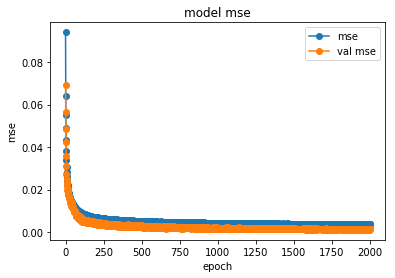

save the model


In [8]:
# -*- coding: utf-8 -*-
"""
Created on Tue Mar  7 15:43:18 2017

@author: hanar
"""
import time
import numpy as np
import os
from keras.utils import np_utils
from keras.models import Sequential
from keras.layers import Dense, Activation, Dropout
from keras.optimizers import SGD
from keras.optimizers import RMSprop
from keras.optimizers import Adagrad
from keras.optimizers import Adadelta
from keras.optimizers import Adam
from keras.optimizers import Adamax
from keras.optimizers import Nadam
from keras.callbacks import ModelCheckpoint
from keras.callbacks import EarlyStopping
from keras.callbacks import TensorBoard
from keras.models import load_model
#from keras.utils.visualize_util import plot
import matplotlib.pyplot as plt
import keras.callbacks
import keras.backend.tensorflow_backend as KTF
import tensorflow as tf

#Global variables for normalizing parameters
max_x = 1.0
min_x = 0.0
max_y = 1.0
min_y = 0.0


def deep_learning_tsunami(resdir, X_train_raw, y_train_raw, X_test_raw, y_test_raw,
                            _lr=0.02, _decay=0,
                            _validation_split=0.2, _batch_size=32,
                            _momentum=0.9, _nesterov=True,
                            num_layers=4, dropout=0.5,
                            node_num = 2500,
                            _epochs=2000):
    """
    Creating the inversion model of turbidity currents by deep learning
    """
    #Normalizing dataset
    X_train = get_normalized_data(X_train_raw, min_x, max_x)
    X_test = get_normalized_data(X_test_raw, min_x, max_x)
    y_train = get_normalized_data(y_train_raw, min_y, max_y)
    y_test = get_normalized_data(y_test_raw, min_y, max_y)
    
    #Generation of neural network model
    model = Sequential()
    model.add(Dense(node_num, input_dim=X_train.shape[1], activation='relu', kernel_initializer ='glorot_uniform'))#1st layer
    model.add(Dropout(dropout))
    for i in range(num_layers - 2):
        model.add(Dense(node_num, activation='relu', kernel_initializer ='glorot_uniform'))#2nd layer
        model.add(Dropout(dropout))
    model.add(Dense(y_train.shape[1], activation = 'relu', kernel_initializer ='glorot_uniform')) #last layer
    
    #Compiling the model
    model.compile(loss="mean_squared_error", 
              optimizer=SGD(lr=_lr, decay=_decay, momentum=_momentum, nesterov=_nesterov),
              #optimizer=Adadelta(),
              metrics=["mean_squared_error"])    
    
    #Perform learning
    t = time.time()
    check = ModelCheckpoint("model3.hdf5")
    #es_cb = EarlyStopping(monitor='val_loss', patience=5, verbose=0, mode='auto')
    #tb_cb = TensorBoard(log_dir=resdir, histogram_freq=2, write_graph=True, write_images=True)
    history = model.fit(X_train, y_train, epochs=_epochs, 
                    validation_split=_validation_split, batch_size=_batch_size,
                    callbacks=[check])
    
    #Evaluate learning result
    loss_and_metrics = model.evaluate(X_test,y_test)
    print("\nloss:{} mse:{}".format(loss_and_metrics[0],loss_and_metrics[1]))
    
    print("Elapsed time: {:.1f} sec.".format(time.time()-t))
    
    #Visualize learning result   
    #plot(model, to_file="model.png", show_shapes=True, show_layer_names=True)

    # model The state of change when letting you learnplot
    plot_history(history)
    
    return model, history

def apply_model(model, X, min_x, max_x, min_y, max_y):
    """
    Apply model
    Maximum and minimum values ​​of X and Y are required to normalize
    """
    X_norm =  (X - min_x) / (max_x - min_x)
    Y_norm = model.predict(X_norm)
    Y = Y_norm*(max_y - min_y)+min_y
    return Y

def plot_history(history):
    # Plot accuracy history
    plt.plot(history.history['mean_squared_error'],"o-",label="mse")
    plt.plot(history.history['val_mean_squared_error'],"o-",label="val mse")
    plt.title('model mse')
    plt.xlabel('epoch')
    plt.ylabel('mse')
    plt.legend(loc="upper right")
    plt.show()

#    # 損失の履歴をプロット
#    plt.plot(history.history['loss'],"o-",label="loss",)
#    plt.plot(history.history['val_loss'],"o-",label="val_loss")
#    plt.title('model loss')
#    plt.xlabel('epoch')
#    plt.ylabel('loss')
#    plt.legend(loc='upper right')
#    plt.show()

def test_model(model, x_test):
    #Test the results
    
    x_test_norm = get_normalized_data(x_test, min_x, max_x)
    test_result_norm = model.predict(x_test_norm)
    test_result = get_raw_data(test_result_norm, min_y, max_y)
    
    return test_result


def save_result(savedir, model, history, test_result):
    
    
    np.savetxt(savedir + 'test_result.txt',test_result,delimiter=',')
    np.savetxt(savedir+'loss.txt',history.history.get('loss'),delimiter=',')
    np.savetxt(savedir+'val_loss.txt',history.history.get('val_loss'),delimiter=',')
    
    #Serialize model and save
    print('save the model')
    model.save(savedir + 'model3.hdf5')

def load_data(datadir):
    """
    This function load training and test data sets, and returns variables
    """
    global min_x, max_x, min_y, max_y
    
    x_train = np.loadtxt(datadir + 'x_train.txt',delimiter=',')
    x_test = np.loadtxt(datadir + 'x_test.txt',delimiter=',')
    y_train = np.loadtxt(datadir + 'icond_train.txt',delimiter=',')
    y_test = np.loadtxt(datadir + 'icond_test.txt',delimiter=',')
    min_y = np.loadtxt(datadir + 'icond_min.txt',delimiter=',')
    max_y = np.loadtxt(datadir + 'icond_max.txt',delimiter=',')
    [min_x, max_x] = np.loadtxt(datadir + 'x_minmax.txt',delimiter=',')
    
    return x_train, y_train, x_test, y_test

def set_minmax_data(_min_x, _max_x, _min_y, _max_y):
    global min_x, max_x, min_y, max_y
    
    min_x, max_x, min_y, max_y = _min_x, _max_x, _min_y, _max_y
    return
    


def get_normalized_data(x, min_val, max_val):
    """
    Normalizing the training and test dataset
    """
    x_norm = (x - min_val) / (max_val - min_val)
    
    return x_norm

def get_raw_data(x_norm, min_val, max_val):
    """
    Get raw data from the normalized dataset
    """
    x = x_norm * (max_val - min_val) + min_val
    
    return x

if __name__ == "__main__":
    
    #Reading data  
    datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi3200/'
    resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi3200/'
    if not os.path.exists(resdir):
        os.mkdir(resdir)
    
    x_train, y_train, x_test, y_test = load_data(datadir)
    
     
    #Execution of learning
    testcases = [4500]
    for i in range(len(testcases)):
        resdir_case = resdir + '{}/'.format(testcases[i])        
        if not os.path.exists(resdir_case):
            os.mkdir(resdir_case)
        x_train_sub = x_train[0:testcases[i],:]
        y_train_sub = y_train[0:testcases[i],:]
        model, history = deep_learning_tsunami(resdir_case, x_train_sub, y_train_sub, x_test, y_test, num_layers=5)
        #Verify and save results
        result = test_model(model, x_test)
        save_result(resdir_case,model,history,result)




(500, 9)


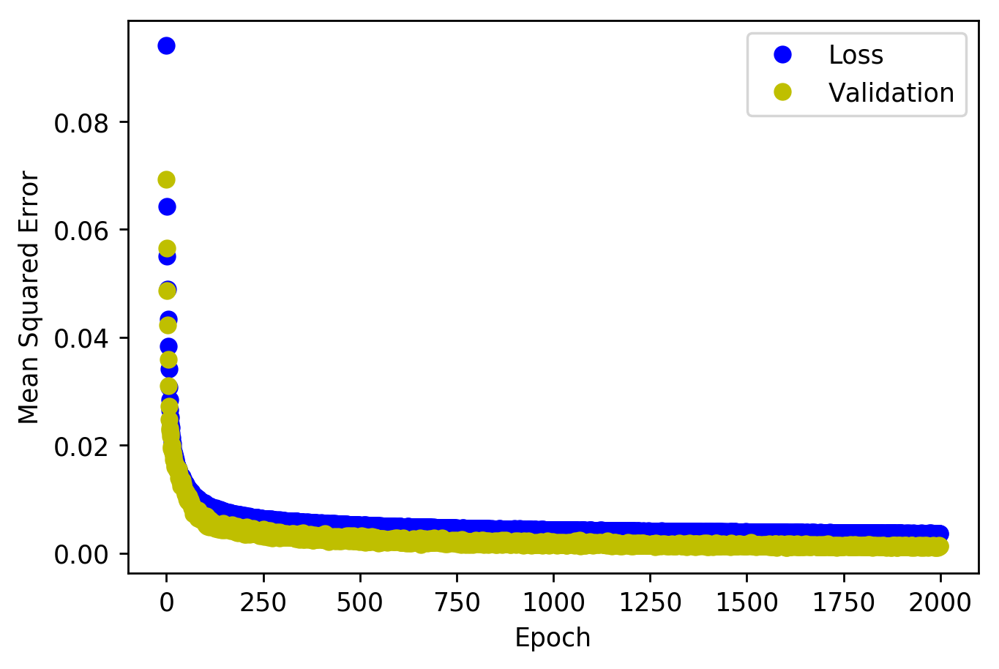

<Figure size 432x288 with 0 Axes>

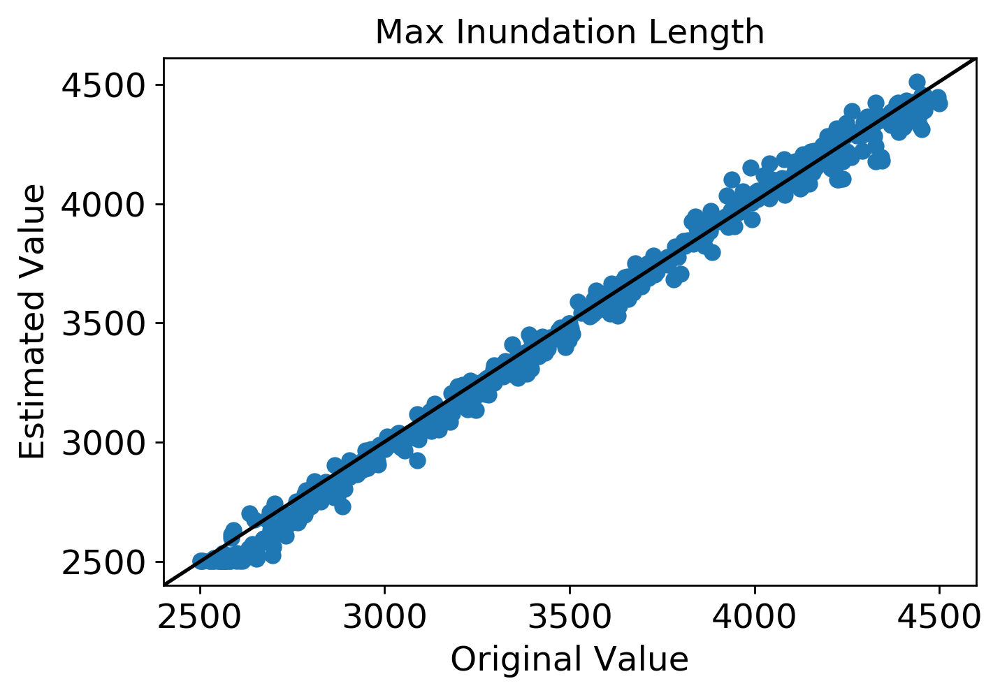

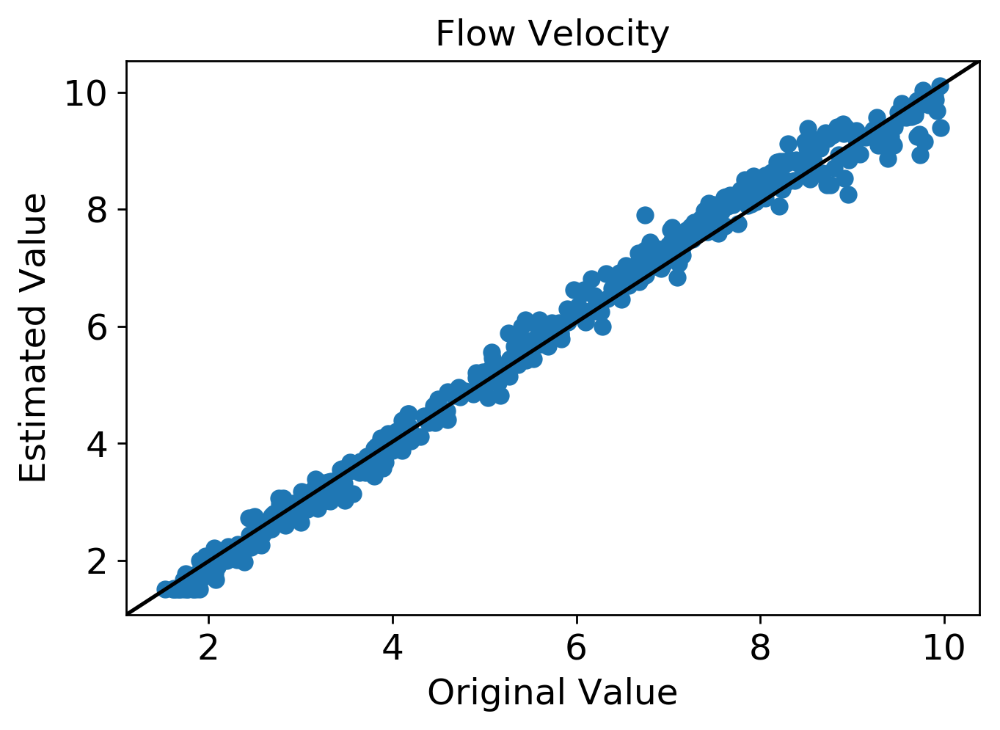

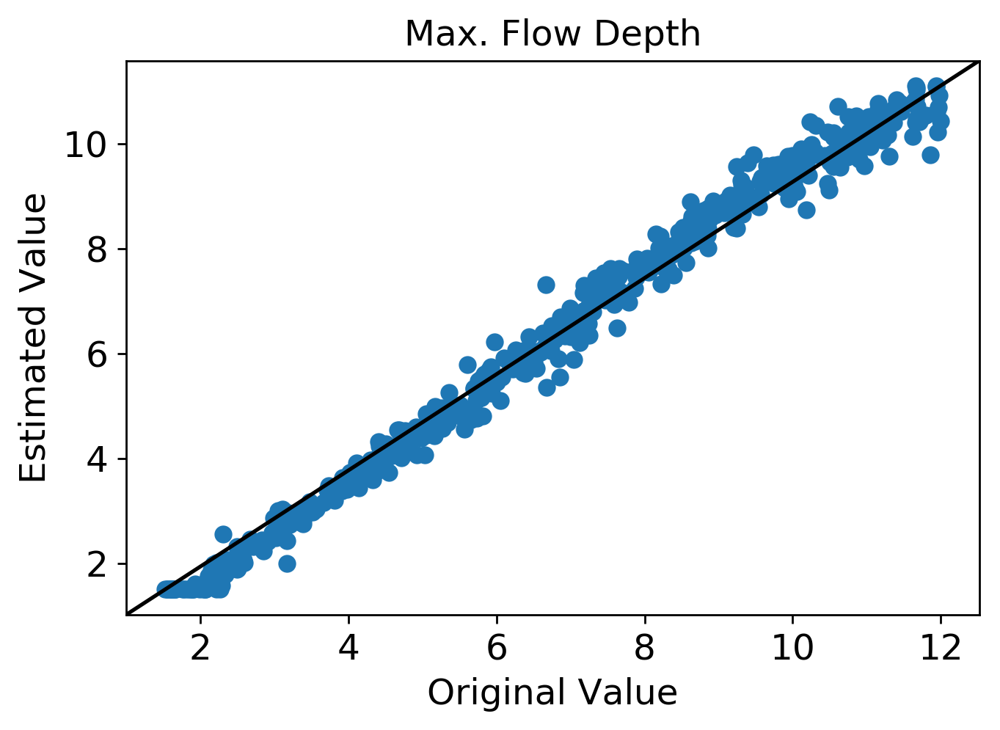

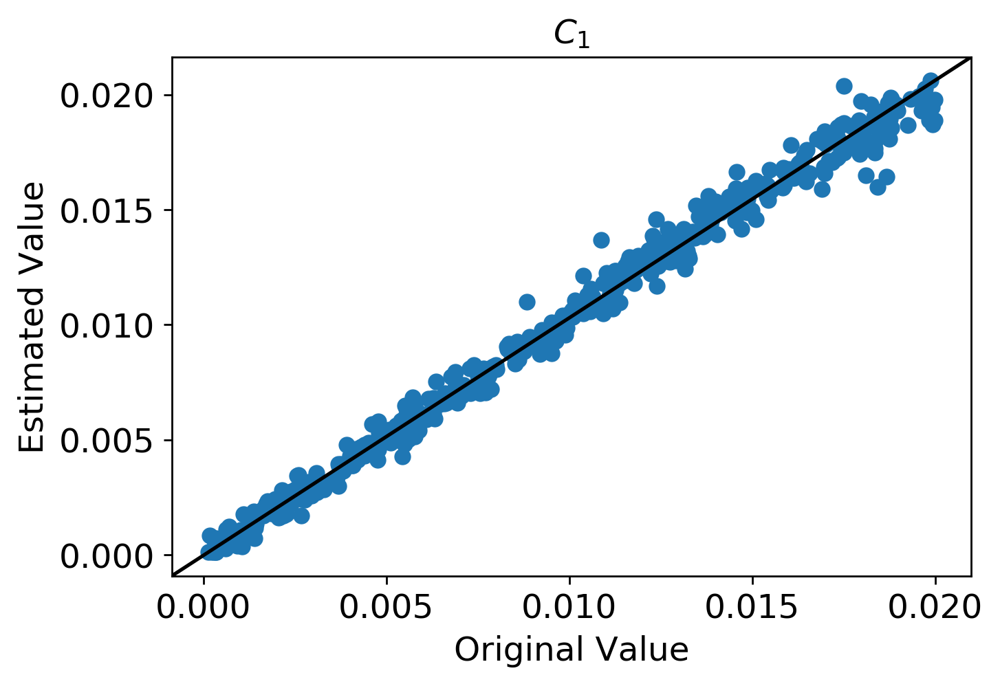

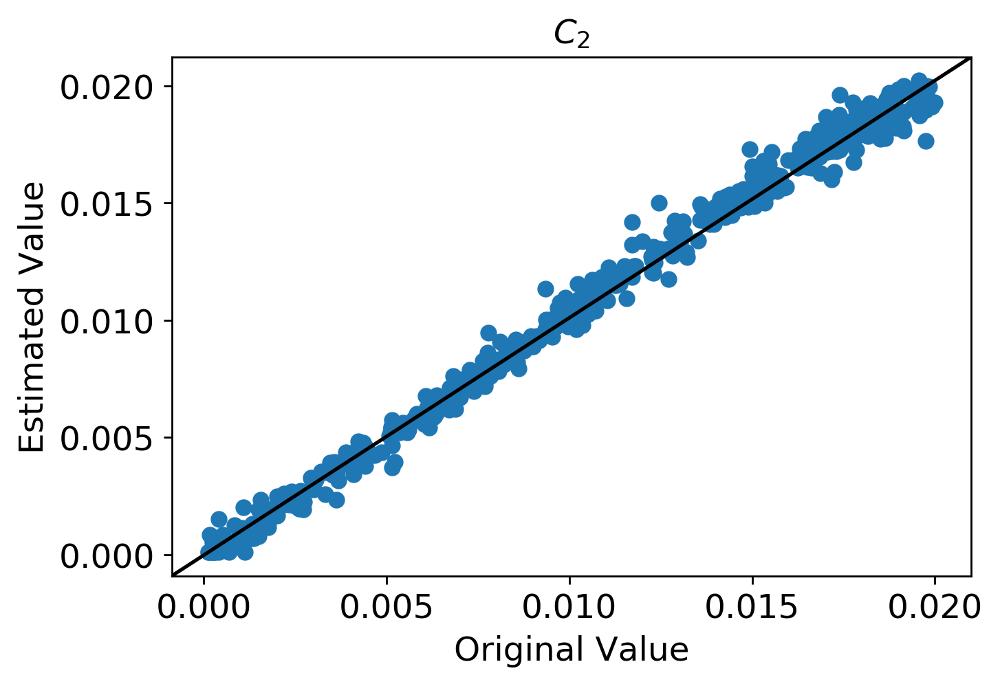

...

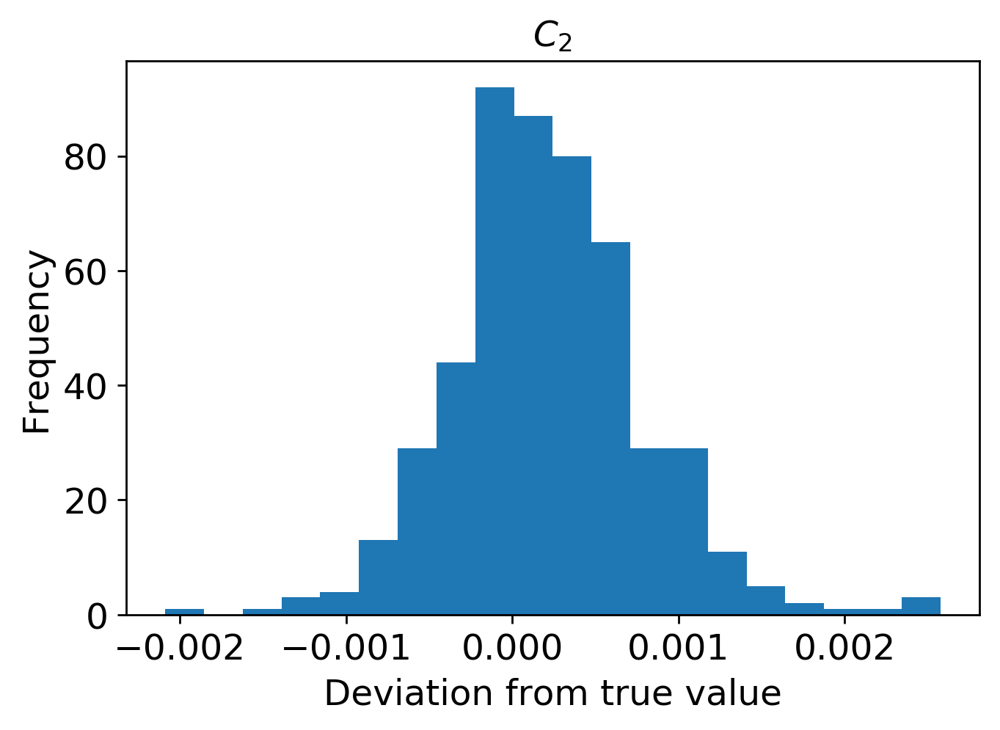

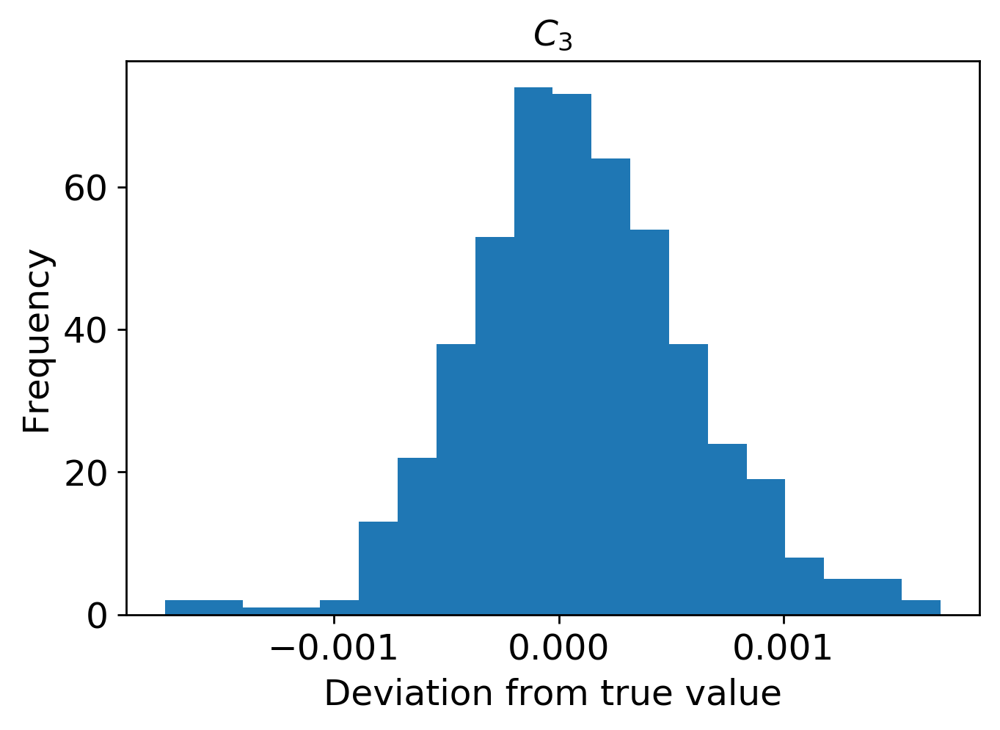

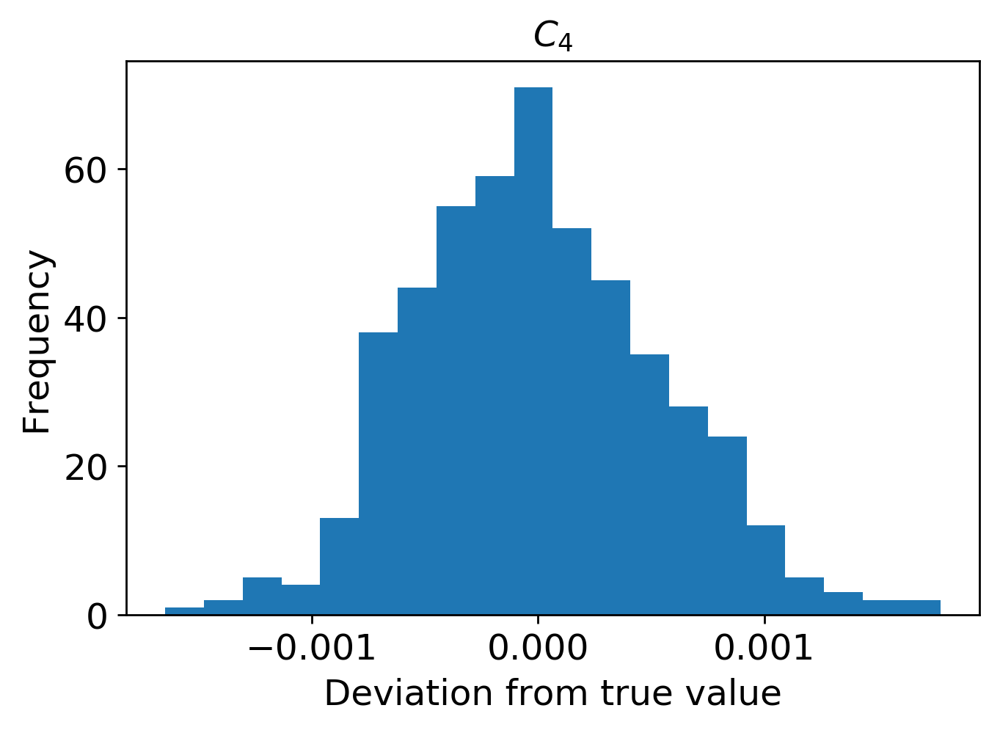

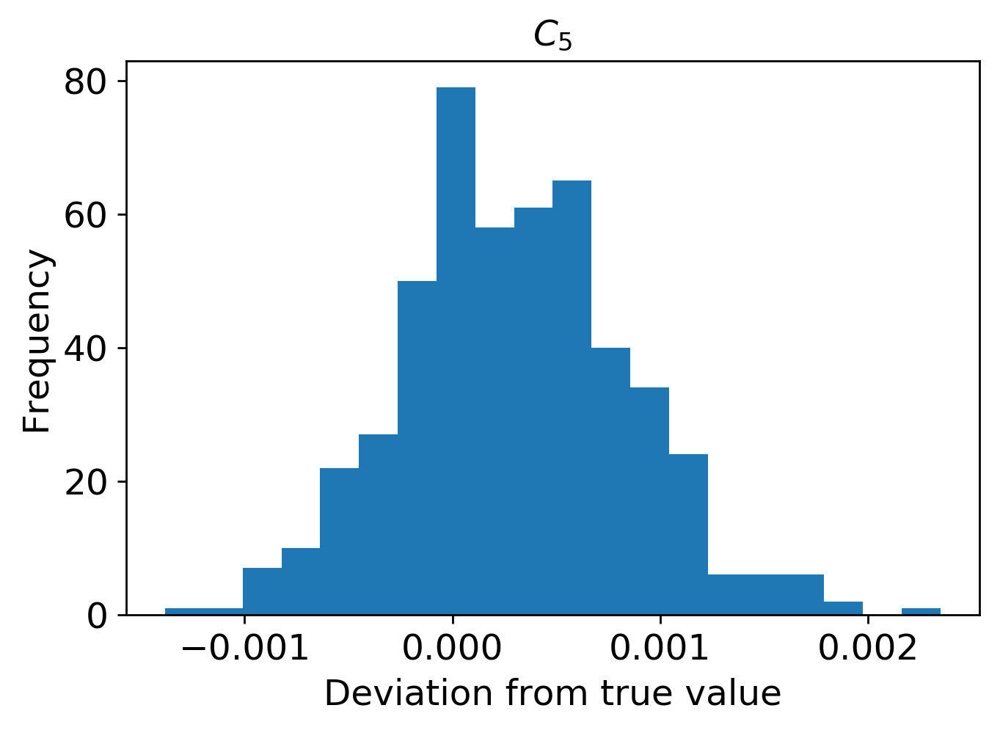

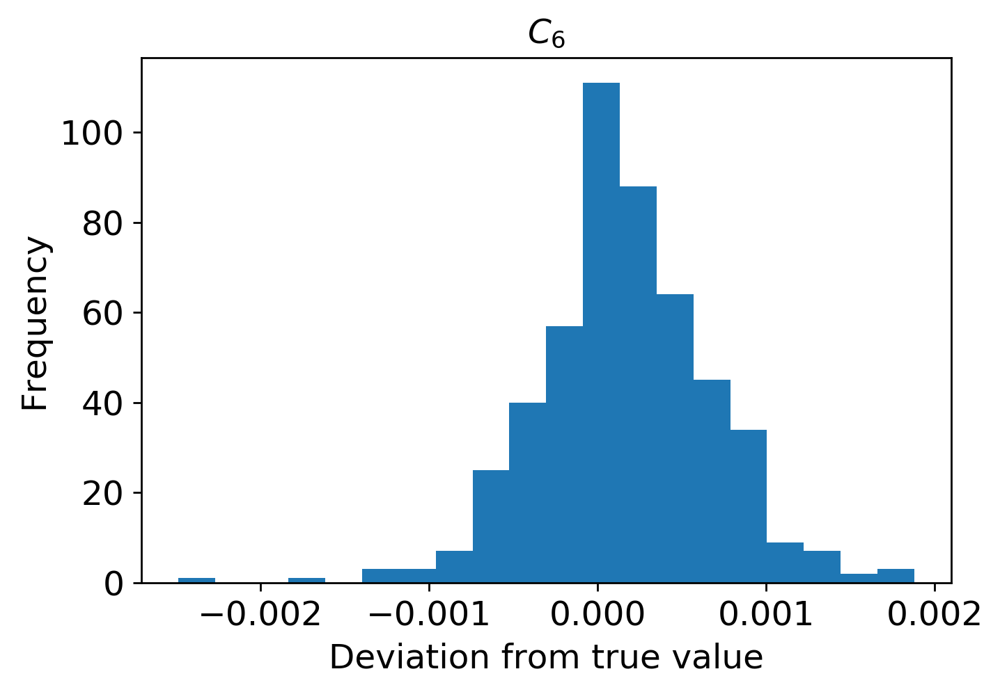

In [9]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi3200/'
resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi3200/4500/'

test_result = np.loadtxt(resdir + 'test_result.txt',delimiter=',')
icond = np.loadtxt(datadir + 'icond_test.txt',delimiter=',')
print(icond.shape)
loss = np.loadtxt(resdir+'loss.txt',delimiter=',')
epoch = range(0,2000)
vloss = np.loadtxt(resdir+'val_loss.txt',delimiter=',')
resi = test_result - icond

fig = plt.figure(num=None,dpi=250, facecolor='w', edgecolor='k')
plt.plot(epoch, loss, 'bo',label='Loss')
plt.plot(epoch, vloss, 'yo',label='Validation')
plt.xlabel('Epoch')
plt.ylabel('Mean Squared Error')
plt.legend(loc="upper right")
plt.savefig(resdir+ 'mse.eps')
plt.show()

fig2 = plt.figure()
hfont = {'fontname':'Century Gothic'}
textcol = 'k'
titlelabel = ['Max Inundation Length','Flow Velocity', 'Max. Flow Depth', '$C_1$', '$C_2$', '$C_3$', '$C_4$','$C_5$','$C_6$']


    
for i in range(len(titlelabel)):
    plt.figure(num=None,dpi=250, facecolor='w', edgecolor='k')
    plt.plot(icond[:,i],test_result[:,i],"o")
    x=icond[:,i]
    y=test_result[:,i]
    y_lim = plt.ylim()
    x_lim = plt.xlim()
    plt.plot(x_lim, y_lim, 'k-', color = 'k')
    plt.ylim(y_lim)
    plt.xlim(x_lim)
    plt.xlabel('Original Value',color=textcol,size=14,**hfont)
    plt.ylabel('Estimated Value',color=textcol,size=14,**hfont)
    plt.title(titlelabel[i],color=textcol,size=14,**hfont)
    plt.tick_params(labelsize=14,colors=textcol)
    plt.savefig(resdir+titlelabel[i] + '.eps')
    #plt.show()

for i in range(len(titlelabel)):
    plt.figure(num=None,dpi=250, facecolor='w', edgecolor='k')
    plt.hist(resi[:,i],bins=20)
    plt.title(titlelabel[i],color=textcol,size=14,**hfont)
    plt.xlabel('Deviation from true value',color=textcol,size=14,**hfont)
    plt.ylabel('Frequency',color=textcol,size=14,**hfont)
    plt.tick_params(labelsize=14,colors=textcol)
    plt.savefig(resdir+titlelabel[i] + 'hist' + '.eps')
    plt.show()

       distance        g1        g2        g3        g4        g5        g6
0      0.000000  0.036771  0.167260  0.114845  0.008449  0.002190  0.005161
1    103.794102  0.000000  0.075200  0.153283  0.013753  0.001885  0.000442
2    171.620654  0.002130  0.051171  0.084309  0.006218  0.001867  0.002843
3    397.112167  0.003115  0.016359  0.078858  0.011466  0.000597  0.000054
4    595.912969  0.000732  0.016896  0.028720  0.002661  0.000914  0.000000
5    707.625749  0.000143  0.002228  0.005502  0.000900  0.000187  0.000104
6    796.435078  0.000236  0.004337  0.021204  0.003169  0.000309  0.000080
7    895.065500  0.001688  0.016059  0.081413  0.020284  0.006824  0.004628
8    988.394177  0.004567  0.008166  0.074658  0.016913  0.002424  0.001580
9   1081.819325  0.001567  0.016305  0.060234  0.011086  0.004165  0.001994
10  1195.756993  0.001022  0.002370  0.017565  0.004194  0.000567  0.000142
11  1290.372534  0.000000  0.004121  0.057974  0.014565  0.000426  0.000213
12  1400.896

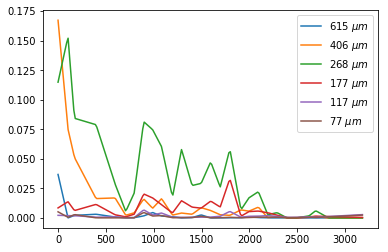

In [10]:
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.models import load_model
from scipy import stats
from scipy.interpolate import interp1d 
import pandas as pd
from pykrige import OrdinaryKriging as OK
import ipdb


datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi3200/'
resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi3200/4500/'
#Initial setting
if not "model" in locals(): 
    model = load_model(resdir+'model3.hdf5')
#gclass = 3
#gclass_label = ["500 $\mu$m","125 $\mu$m","63 $\mu$m"]
gclass = 6
gclass_label = ["615 ${\mu}m$","406 ${\mu}m$","268 ${\mu}m$","177 ${\mu}m$", "117 ${\mu}m$","77 ${\mu}m$"]
topodx = 15.0
coord_num = int(model.layers[0].input_shape[1]/gclass)

#Acquires a value for normalizing input data to [0, 1]
min_x, max_x = np.loadtxt(datadir + 'x_minmax.txt',delimiter=',')
y_min = np.loadtxt(datadir + 'icond_min.txt',delimiter=',')
y_max = np.loadtxt(datadir + 'icond_max.txt',delimiter=',')

#Read outcrop data
#dist_max = 22000. #Distance of distal end of learning data
outcrop = pd.read_csv('../FITTNUSS-forward_training_DNN/sendai_increased_class_edit.csv')
#outcrop = pd.read_csv('../DeepLearningTurbidite_Fukuda/GA_naruse_v2.csv')
#outcrop = outcrop.append(pd.DataFrame([[0,'Loc0',0,0,0],[dist_max,'LocE',0,0,0]], columns=outcrop.columns))
outcrop = outcrop.sort_values('distance')
outcrop['distance'] = outcrop['distance'] - 0
#d = pd.DataFrame(np.zeros((1, 7)),columns=['distance', 'g1','g2','g3','g4','g5','g6'])
#print(d)
#v=np.concatenate((outcrop, d))
#print(v)
#outcrop=pd.DataFrame(v,columns=['distance', 'g1','g2','g3','g4','g5','g6'])
#outcrop['distance'].iloc[-1]=4000
#outcrop = outcrop.append(pd.DataFrame([[0,'Loc0',0,0,0,0]], columns=outcrop.columns))
print(outcrop)

#Preparation under interpolation
thick_interp = np.zeros([1,coord_num*gclass])#補間されたサンプル厚さデータ
outcrop_x_id = np.round(outcrop['distance']/topodx).astype(np.int32) #逆解析システムでのサンプリング地点のindex番号
x = np.arange(0,coord_num*topodx,topodx)

#Complement data
for j in range(gclass):
    f = interp1d(outcrop['distance'],outcrop.iloc[:,j+1], kind="linear",bounds_error=False,fill_value='extrapolate')
    #f = interp1d(outcrop['distance'],outcrop.iloc[:,j+2], kind="linear",bounds_error=False,fill_value='extrapolate') 
    #Interpolation function of jth granularity level
    thick_interp[0,coord_num*j:coord_num*(j+1)] = f(x) #Supplemented data

#ipdb.set_trace()
#Kriging Interpolation by
#vparams = np.array([[0.035, 10000., 0.001],[0.006, 10000., 0.002],[0.005, 10000., 0.002],[0.035, 10000., 0.001]])
#for j in range(gclass):
    #okip = OK(outcrop['distance'],np.zeros(outcrop['distance'].shape),outcrop.iloc[:,j+1],variogram_model='linear',)
    #okip.display_variogram_model()
    #ipdata, ipstd = okip.execute('grid',x,np.array([0.]))
    #ipdata = np.squeeze(ipdata)
    #thick_interp[0,coord_num*j:coord_num*(j+1)] = ipdata #Assign complemented d

#Normalize data
thick_interp[thick_interp < 0] = 0
thick_interp_norm =  (thick_interp - min_x) / (max_x - min_x)

#Perform inverse analysis
test_result_outcrop = model.predict(thick_interp_norm)
test_result_outcrop = test_result_outcrop * (y_max - y_min) + y_min
print(test_result_outcrop)
#add=np.array(3000)
#test_result_outcrop_add=np.concatenate((add,test_result_outcrop), axis=None)
#Output results
#print(test_result_outcrop_add)
np.savetxt('outcrop_result_g6_g300_H_5000_20_11_roi3200.txt',test_result_outcrop, delimiter=',')
for i in range(len(gclass_label)):
    plt.plot(x,thick_interp[0,coord_num * i:coord_num * (i+1)],label=gclass_label[i])
plt.legend()
plt.show()



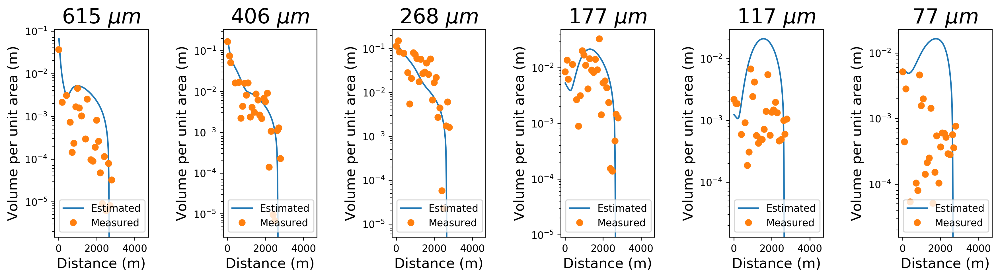

In [11]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import Forward_model_modified_FITTNUSS_5000_g6_300grid_19_11_case2 as fmodel
import time
import ipdb
%matplotlib inline

#Basic setting

#dist_max = 3000.
gclass = 6
topodx=15.0
gclass_name = ['615microm','406microm','268microm','177microm','117microm','77microm']
#gclass_name = ['500micron', '125micron', '63micron']
gname_tex = ["615 ${\mu}m$","406 ${\mu}m$","268 ${\mu}m$","177 ${\mu}m$", "117 ${\mu}m$","77 ${\mu}m$"]
#gname_tex = ['500 $\mu$m','125 $\mu$m','63 $\mu$m']
#calcdir = 'home/rimali2009/FITTNUSS-forward_training_DNN/'
#calcdir = '/home/naruse/Documents/Documents/MATLAB/TCtrainData_forML/TCModel_for_MLTEST/test_output_otadai07/'

#Load estimate
#H1 = np.loadtxt(calcdir + 'H1.txt',delimiter=',')
#H2 = np.loadtxt(calcdir + 'H2.txt',delimiter=',')
#H3 = np.loadtxt(calcdir + 'H3.txt',delimiter=',')
#H4 = np.loadtxt(calcdir + 'H4.txt',delimiter=',')
#Ht = np.loadtxt(calcdir + 'Ht.txt',delimiter=',')
#U = np.loadtxt(calcdir + 'U.txt',delimiter=',')
#xi = np.loadtxt(calcdir + 'xi.txt',delimiter=',')
#x = np.loadtxt(calcdir + 'x.txt',delimiter=',')
#x_bed = np.loadtxt(calcdir + 'x_init.txt',delimiter=',')
#eta_init = np.loadtxt(calcdir + 'eta_init.txt',delimiter=',')
#Ct = np.loadtxt(calcdir + 'Ct.txt',delimiter=',')
#time = np.loadtxt(calcdir + 'time.txt',delimiter=',')
estimated_icond=np.loadtxt('outcrop_result_g6_g300_H_5000_20_11_roi3200.txt', delimiter=',')
start = time.time()
fmodel.read_setfile("config_g6_300grid_19_11_case2.ini")
(x,C,x_dep,deposit) = fmodel.forward(estimated_icond)
np.savetxt('eta_estimated_thickness_5K_g6_TC4_Rwcnst_H_5000_20_11_roi3200.csv', deposit, delimiter=',')
np.savetxt('eta_estimated_Distance_5K_g6_TC4_Rwcnst_H_5000_20_11_roi3200.csv', x_dep,delimiter=',')
estimated_dep_thickness_5000=np.transpose(np.loadtxt('/home/rimali2009/FITTNUSS-forward_training_DNN/'+'eta_estimated_thickness_5K_g6_TC4_Rwcnst_H_5000_20_11_roi3200.csv', delimiter=','))
estimated_dep_thickness_5000=pd.DataFrame(estimated_dep_thickness_5000,columns=['615microm','406microm','268microm','177microm','117microm','77microm'])
estimated_dep_distance_5000=np.transpose(np.loadtxt('/home/rimali2009/FITTNUSS-forward_training_DNN/'+'eta_estimated_Distance_5K_g6_TC4_Rwcnst_H_5000_20_11_roi3200.csv', delimiter=','))
estimated_dep_distance_5000=pd.DataFrame(estimated_dep_distance_5000,columns=['distance'])
estimated_dep_5000=pd.concat([estimated_dep_distance_5000,estimated_dep_thickness_5000],axis=1)
np.savetxt('estimated_dep_5K_g6_TC4_Rwcnst_H_5000_20_11_roi3200.csv',estimated_dep_5000,delimiter=',')
#data_estim=pd.DataFrame(estimated_dep_5000,columns=['distance','1.5phi','2.5phi','3.5phi','4.5phi'])

#Formatting the loaded data
#estimated_dep_df = pd.DataFrame(estimated_dep,columns=['distance','1.5phi','2.5phi','3.5phi','4.5phi'])
#estimated_dep = pd.DataFrame(np.array([x_bed - dist_offset,H1[-1,:],H2[-1,:],H3[-1,:]]).T,columns=['distance','500micron','125micron','63micron'])
estimated_dep_5000= estimated_dep_5000.query('distance > 0')
#estimated_dep_5000 = estimated_dep_5000.query('distance < {}'.format(dist_max))

#Read original data
outcrop = pd.read_csv('../FITTNUSS-forward_training_DNN/sendai_increased_class.csv')
outcrop= pd.DataFrame(outcrop,columns=['distance','615microm','406microm','268microm','177microm','117microm','77microm'])
#outcrop = pd.read_csv('../DeepLearningTurbidite_Fukuda/GA_naruse_v2.csv')
#outcrop = outcrop.append(pd.DataFrame([[0,'Loc0',0,0,0],[dist_max,'LocE',0,0,0]], columns=outcrop.columns))
#outcrop = outcrop.sort_values('distance')
#outcrop['distance'] = outcrop['distance'] - 1000

#Plot
plt.figure(num=None, figsize=(17, 4), dpi=250, facecolor='w', edgecolor='g')
hfont = {'fontname':'Sans'}
plt.subplots_adjust(bottom=0.15, wspace=0.8)

for i in range(gclass):
    plt.subplot(1,gclass,i+1)
    plt.plot(estimated_dep_5000['distance'],estimated_dep_5000[gclass_name[i]],'-', label='Estimated')
    plt.plot(outcrop['distance'], outcrop[gclass_name[i]],'o', label='Measured')
    plt.yscale('log')
    plt.title(gname_tex[i], size=21,**hfont)
    plt.xlabel('Distance (m)', size = 14, **hfont)
    plt.ylabel('Volume per unit area (m)', size = 14, **hfont)
    plt.legend(fontsize=10)
    plt.savefig("thickness_distance_curve_5000_g6_300grid_H_5000_20_11_roi3200.png")
    plt.savefig("thickness_distance_curve_5000_g6_300grid_H_5000_20_11_roi3200.eps")
plt.show()



Using TensorFlow backend.


       distance        g1        g2        g3        g4        g5        g6
0      0.000000  0.036771  0.167260  0.114845  0.008449  0.002190  0.005161
1    103.794102  0.000000  0.075200  0.153283  0.013753  0.001885  0.000442
2    171.620654  0.002130  0.051171  0.084309  0.006218  0.001867  0.002843
3    397.112167  0.003115  0.016359  0.078858  0.011466  0.000597  0.000054
4    595.912969  0.000732  0.016896  0.028720  0.002661  0.000914  0.000000
5    707.625749  0.000143  0.002228  0.005502  0.000900  0.000187  0.000104
6    796.435078  0.000236  0.004337  0.021204  0.003169  0.000309  0.000080
7    895.065500  0.001688  0.016059  0.081413  0.020284  0.006824  0.004628
8    988.394177  0.004567  0.008166  0.074658  0.016913  0.002424  0.001580
9   1081.819325  0.001567  0.016305  0.060234  0.011086  0.004165  0.001994
10  1195.756993  0.001022  0.002370  0.017565  0.004194  0.000567  0.000142
11  1290.372534  0.000000  0.004121  0.057974  0.014565  0.000426  0.000213
12  1400.896

(1, 9)
[[2.62946842e+03 4.42751057e+00 7.64830741e+00 5.86504653e-03
  1.71486245e-02 1.37589474e-02 3.51864435e-04 1.01360960e-04
  4.22933419e-04]]
       distance        g1        g2        g3        g4        g5        g6
0      0.000000  0.036771  0.167260  0.114845  0.008449  0.002190  0.005161
1    103.794102  0.000000  0.075200  0.153283  0.013753  0.001885  0.000442
2    171.620654  0.002130  0.051171  0.084309  0.006218  0.001867  0.002843
3    397.112167  0.003115  0.016359  0.078858  0.011466  0.000597  0.000054
4    595.912969  0.000732  0.016896  0.028720  0.002661  0.000914  0.000000
5    707.625749  0.000143  0.002228  0.005502  0.000900  0.000187  0.000104
6    796.435078  0.000236  0.004337  0.021204  0.003169  0.000309  0.000080
7    988.394177  0.004567  0.008166  0.074658  0.016913  0.002424  0.001580
8   1081.819325  0.001567  0.016305  0.060234  0.011086  0.004165  0.001994
9   1195.756993  0.001022  0.002370  0.017565  0.004194  0.000567  0.000142
10  1290.37253

/home/rimali2009/anaconda3/envs/test3/lib/python3.6/site-packages/matplotlib/font_manager.py:1241: UserWarning: findfont: Font family ['Century Gothic'] not found. Falling back to DejaVu Sans.
  (prop.get_family(), self.defaultFamily[fontext]))


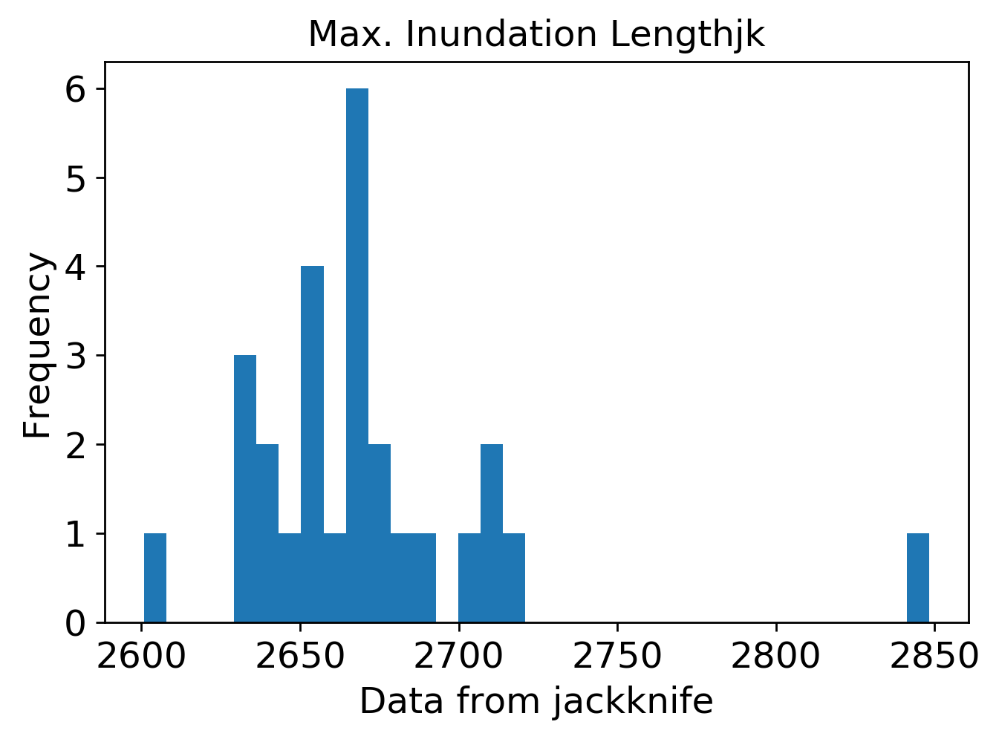

mean: 4.527245754703348
jk_e: 0.06643431070880741


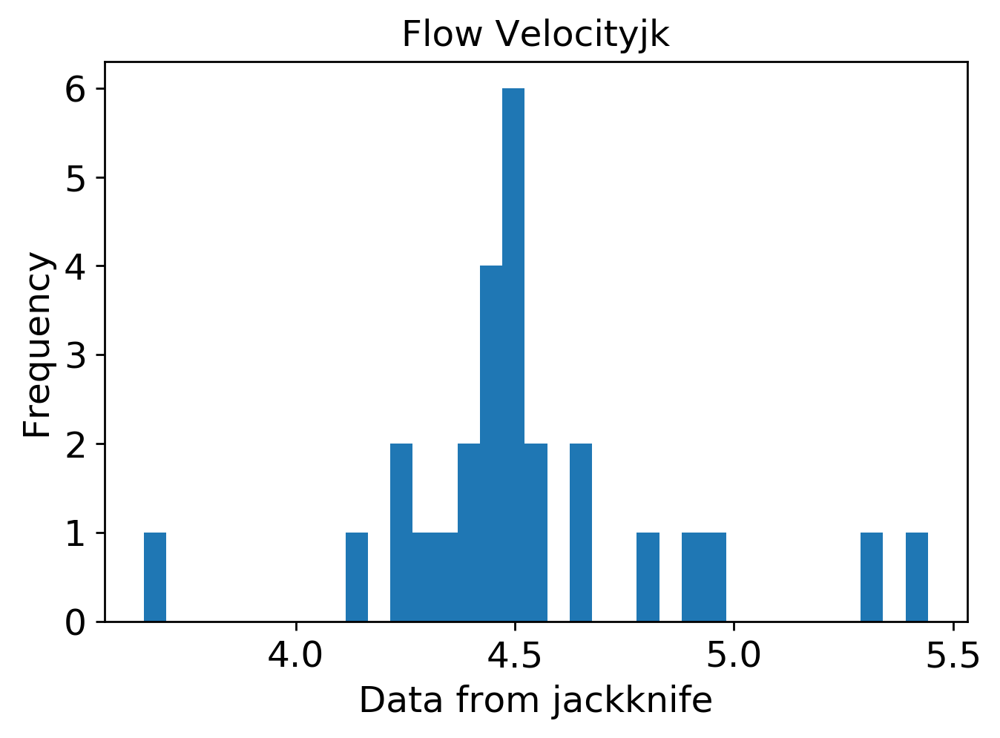

mean: 7.335011358204181
jk_e: 0.1338437708345267


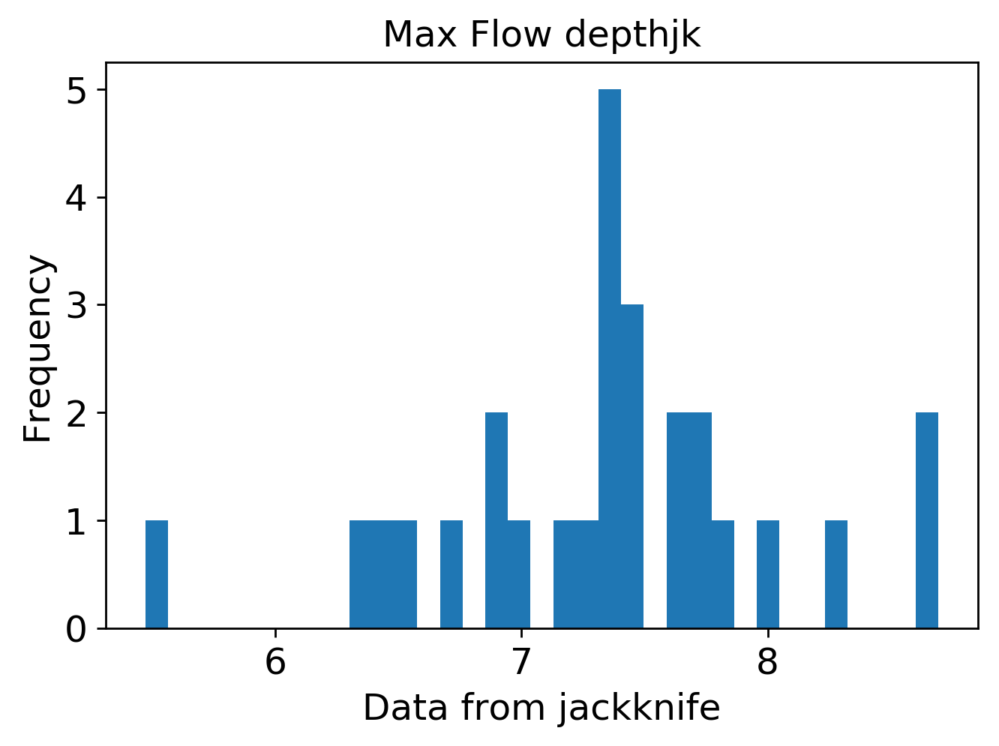

mean: 0.006122277288355667
jk_e: 0.00015093147119308928


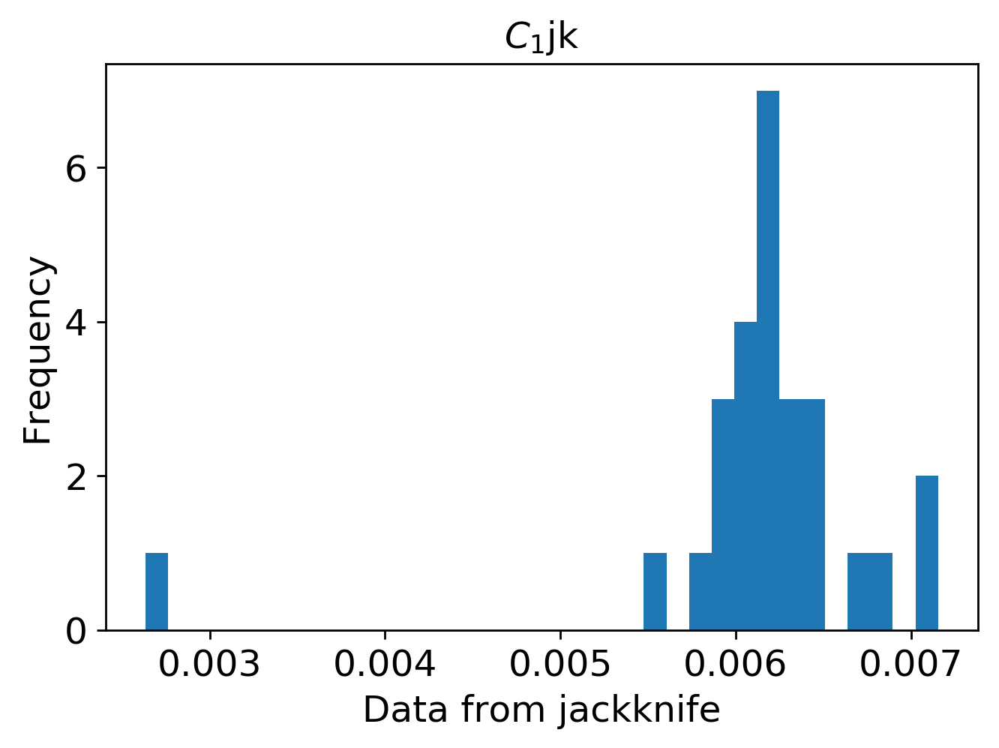

mean: 0.017625210229918906
jk_e: 0.0002648187062931823


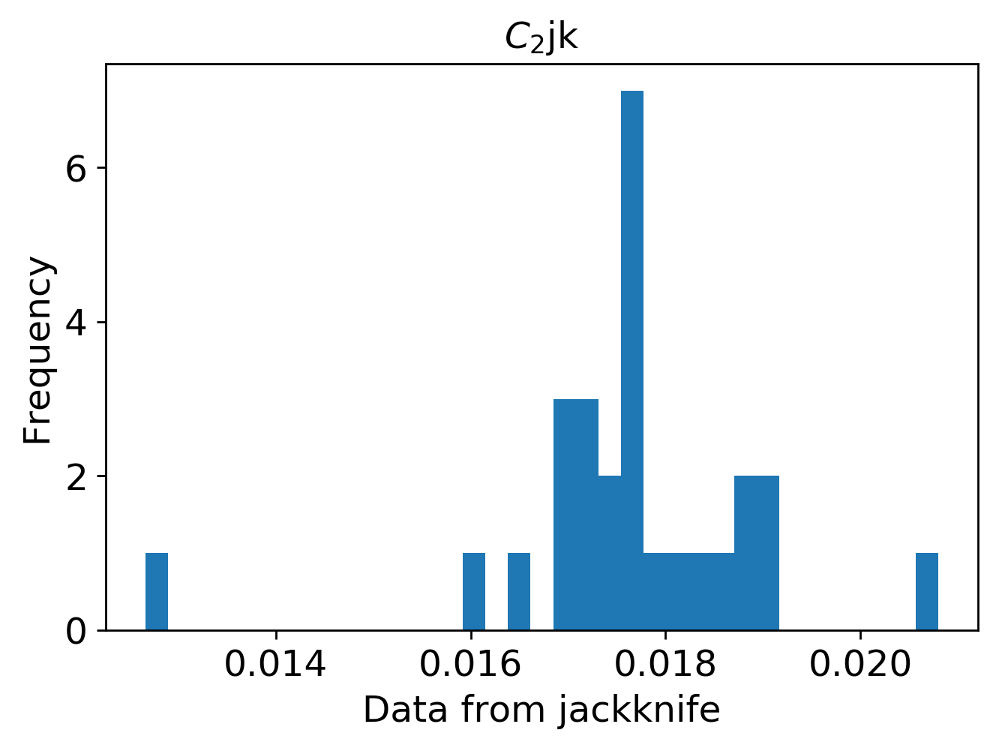

mean: 0.014738645220405733
jk_e: 0.0002998062829897705


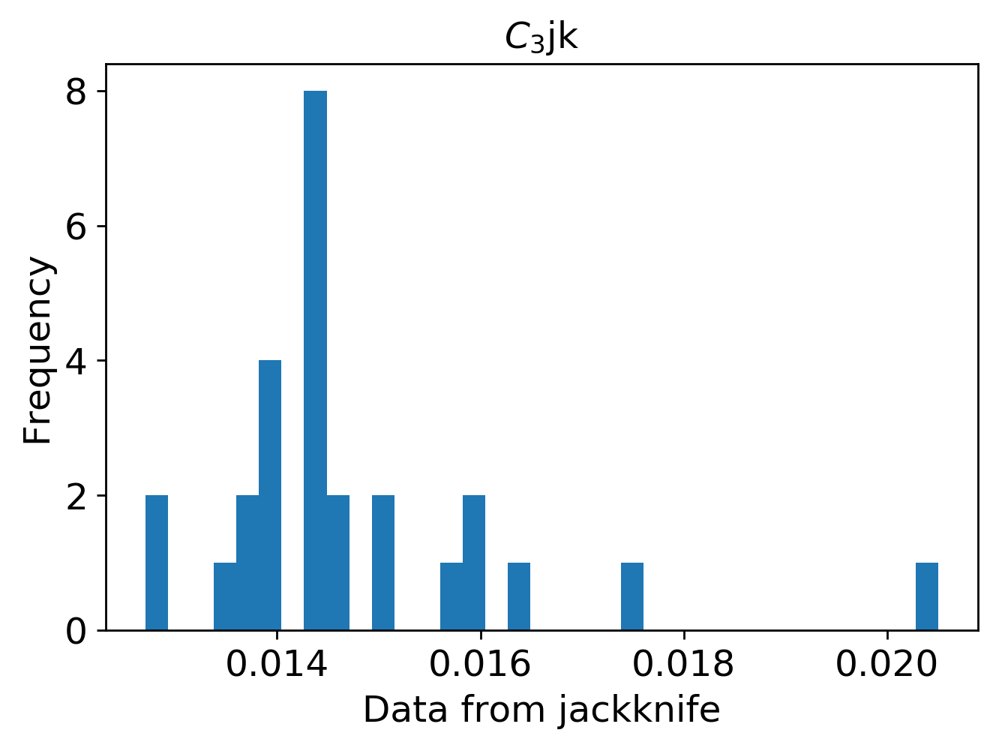

mean: 0.0004745903258628191
jk_e: 3.7626706163375417e-05


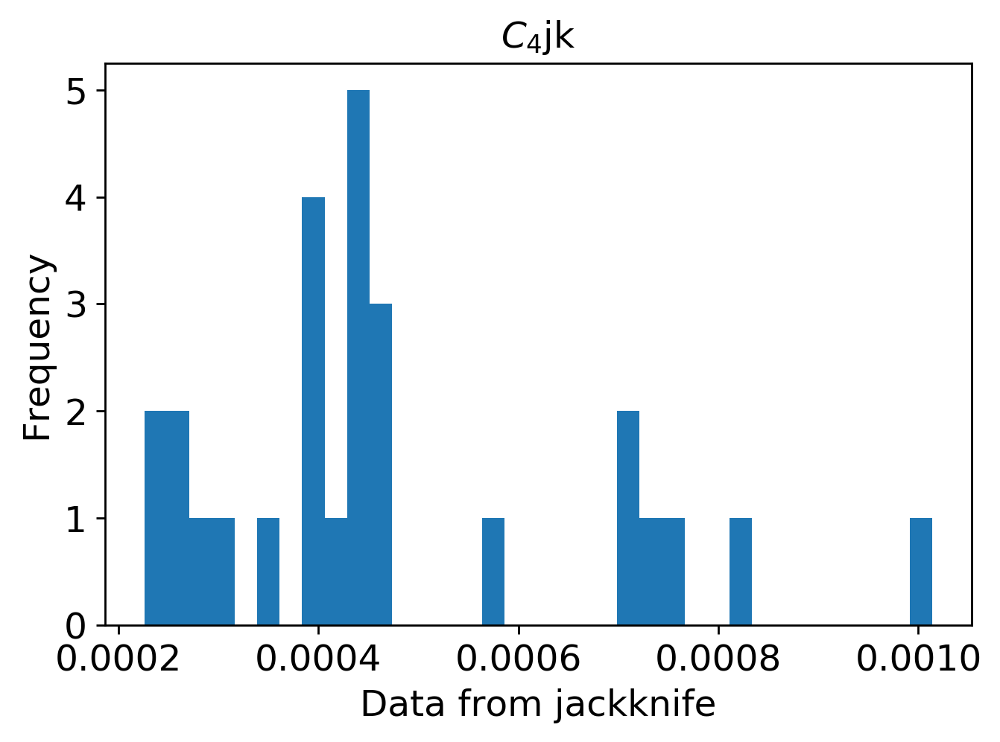

mean: 0.00010136096021857652
jk_e: 0.0


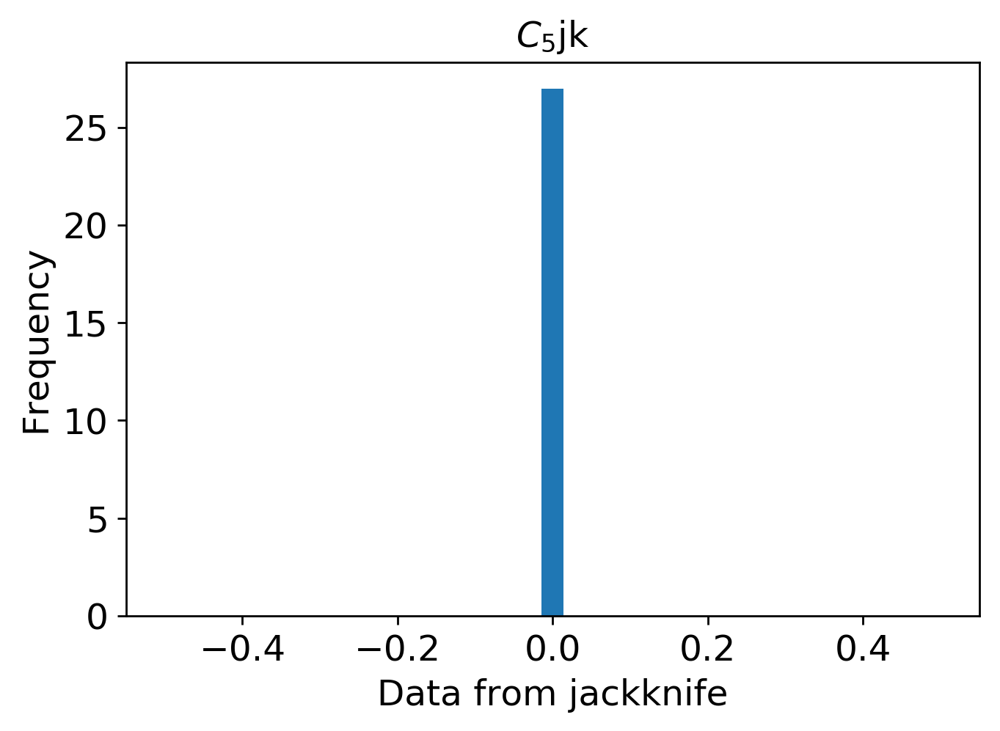

mean: 0.0004779937730042515
jk_e: 2.1740872688549417e-05


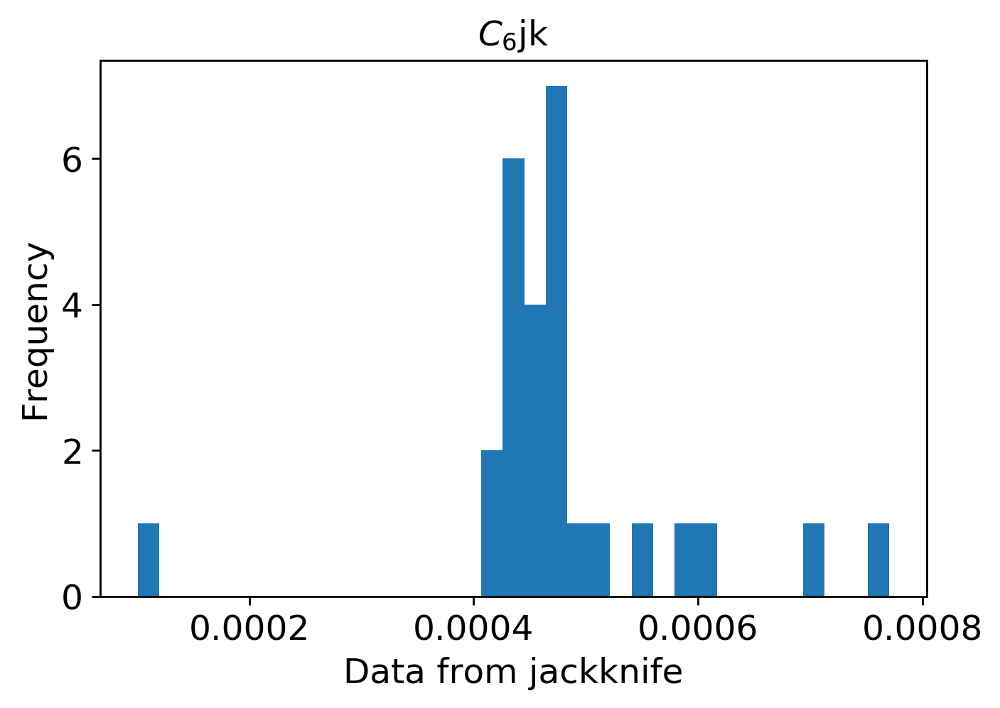

In [1]:
# Jackknife Method
import csv
import numpy as np
import pandas as pd
import math
from keras.models import load_model
from scipy.interpolate import interp1d
import matplotlib.pyplot as plt
%matplotlib inline

datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi3200/'
resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi3200/4500/'
# Initial setting
if not "model" in locals():
    model = load_model(resdir+'model3.hdf5')
gclass = 6
gclass_label = ["615 ${\mu}m$", "406 ${\mu}m$", "268 ${\mu}m$",
                "177 ${\mu}m$", "117 ${\mu}m$", "77 ${\mu}m$"]
topodx = 15.0
coord_num = int(model.layers[0].input_shape[1]/gclass)
min_x, max_x = np.loadtxt(datadir + 'x_minmax.txt', delimiter=',')
y_min = np.loadtxt(datadir + 'icond_min.txt', delimiter=',')
y_max = np.loadtxt(datadir + 'icond_max.txt', delimiter=',')


a = pd.read_csv(
    '../FITTNUSS-forward_training_DNN/sendai_increased_class_edit.csv', delimiter=',')
print(a)
y = pd.DataFrame()
output = []

with open('output_final_20_11_roi3200.csv', 'w') as outfile:

    # x=[]
    for index in range(len(a)):
        df = y.append(pd.read_csv(
            '../FITTNUSS-forward_training_DNN/sendai_increased_class_edit.csv', skiprows=[index+1]))
        print(df)
        df = df.sort_values('distance')
        thick_interp = np.zeros([1, coord_num*gclass])
        x = np.arange(0, coord_num*topodx, topodx)
        for j in range(gclass):
            # Interpolation function of jth granularity level
            f = interp1d(df['distance'], df.iloc[:, j+1],
                         kind="linear", bounds_error=False,fill_value='extrapolate')
            thick_interp[0, coord_num*j:coord_num*(j+1)] = f(x)
        thick_interp[thick_interp < 0] = 0
        thick_interp_norm = (thick_interp - min_x) / (max_x - min_x)
        test_result_outcrop = model.predict(thick_interp_norm)
        test_result_outcrop = test_result_outcrop * (y_max - y_min) + y_min
        print(test_result_outcrop.shape)
        print(test_result_outcrop)
    # output.append(test_result_outcrop)
        np.savetxt(outfile,test_result_outcrop, delimiter=',')
        # outfile.write('# New iteration\n')
hfont = {'fontname': 'Century Gothic'}
textcol = 'k'
resi = np.loadtxt('output_final_20_11_roi3200.csv', delimiter=',')
titlelabel = ['Max. Inundation Lengthjk','Flow Velocityjk', 'Max Flow depthjk',
              '$C_1$jk', '$C_2$jk', '$C_3$jk', '$C_4$jk', '$C_5$jk', '$C_6$jk']
jk_er=[]
with open('jk_e_roi3200.txt','wb') as ftext:
    for i in range(len(titlelabel)):
        plt.figure(num=None, dpi=250, facecolor='w', edgecolor='k')
        plt.hist(resi[:, i], bins=35)
        mean = sum(resi[:,i]) / len(resi[:,i])
        print("mean:",mean)
        var_jk  = sum(pow(x-mean,2) for x in resi[:,i]) / ((len(resi[:,i])-1)*(len(resi[:,i])))
        jk_e= math.sqrt(var_jk)
        print("jk_e:",jk_e)
        e=np.append(jk_e,jk_er)
        np.savetxt(ftext,e,delimiter=',')
        plt.title(titlelabel[i], color=textcol, size=14, **hfont)
        plt.xlabel('Data from jackknife', color=textcol, size=14, **hfont)
        plt.ylabel('Frequency', color=textcol, size=14, **hfont)
        plt.tick_params(labelsize=14, colors=textcol)
        plt.savefig(resdir+titlelabel[i] + 'jkhist' + '.eps')
        plt.show()


# ROI 3300

In [13]:
import numpy as np
import os
#import ipdb

def connect_dataset(file_list, icond_file_list, outputdir,
                    topodx=15, roi=2500, offset=5000,gclass_num=6,test_data_num=500):
    """
    複数のデータセットを連結する
    """
    #ipdb.set_trace()
    
    #Reading and combining files Decide start and end points of the learning area and convert them to grid numbers
    H = np.loadtxt(file_list[0], delimiter = ',')
    icond = np.loadtxt(icond_file_list[0], delimiter = ',')
    
    #Reading and combining files
    if len(file_list) > 1:
        for i in range(1, len(file_list)):
            H_temp = np.loadtxt(file_list[i], delimiter = ',')
            icond_temp = np.loadtxt(icond_file_list[i], delimiter = ',')
            H = np.concatenate((H,H_temp),axis=0)
            icond = np.concatenate((icond,icond_temp),axis = 0)
    
    roi_grids = int(roi / topodx)
    num_grids = int(H.shape[1] / gclass_num)
    H_subset = np.zeros([H.shape[0], roi_grids * gclass_num])
    for i in range(gclass_num):
        H_subset[:, i*roi_grids:(i+1)*roi_grids] = H[:, i*num_grids:(i*num_grids+roi_grids)]
    
    #Obtain the maximum and minimum values of data
    max_x = np.max(H_subset)
    min_x = np.min(H_subset)
    icond_max = np.max(icond, axis=0)
    icond_min = np.min(icond, axis=0)
    
    #Split the data into tests and training
    H_train = H_subset[0:-test_data_num,:]
    H_test = H_subset[H_subset.shape[0] - test_data_num:,:]
    icond_train = icond[0:-test_data_num,:]
    icond_test = icond[H.shape[0] - test_data_num:,:]
    
    #Save the data
    if not os.path.exists(outputdir):
        os.mkdir(outputdir)
    np.savetxt(outputdir + '/x_train.txt',H_train,delimiter = ',')
    np.savetxt(outputdir + '/x_test.txt',H_test,delimiter = ',')
    np.savetxt(outputdir + '/icond_train.txt',icond_train,delimiter = ',')
    np.savetxt(outputdir + '/icond_test.txt',icond_test,delimiter = ',')
    np.savetxt(outputdir + '/icond_min.txt',icond_min,delimiter = ',')
    np.savetxt(outputdir + '/icond_max.txt',icond_max,delimiter = ',')
    np.savetxt(outputdir + '/x_minmax.txt',[min_x, max_x],delimiter = ',')
    
    
if __name__=="__main__":
    original_data_dir = "/home/rimali2009/FITTNUSS-forward_training_DNN"
    parent_dir = "/home/rimali2009/FITTNUSS-forward_training_DNN"
    if not os.path.exists(parent_dir):
        os.mkdir(parent_dir)
    outputdir = parent_dir + "/data_g6_300grid_H_5000_20_11_roi3300"
    file_list = ['/home/rimali2009/FITTNUSS-forward_training_DNN/eta_5000_g6_300grid_19_11.csv']
    initial_conditions = ['/home/rimali2009/FITTNUSS-forward_training_DNN/start_param_random_5000_g6_300grid_19_11.csv']
connect_dataset(file_list, initial_conditions, outputdir, test_data_num=500, gclass_num=6, topodx=15., roi=3300)
        
        
    

Train on 3600 samples, validate on 900 samples
Epoch 1/2000
3600/3600 [==============================] - 2s 496us/step - loss: 0.0945 - mean_squared_error: 0.0945 - val_loss: 0.0704 - val_mean_squared_error: 0.0704
Epoch 2/2000
3600/3600 [==============================] - 1s 399us/step - loss: 0.0645 - mean_squared_error: 0.0645 - val_loss: 0.0574 - val_mean_squared_error: 0.0574
Epoch 3/2000
3600/3600 [==============================] - 1s 406us/step - loss: 0.0556 - mean_squared_error: 0.0556 - val_loss: 0.0488 - val_mean_squared_error: 0.0488
Epoch 4/2000
3600/3600 [==============================] - 1s 392us/step - loss: 0.0486 - mean_squared_error: 0.0486 - val_loss: 0.0418 - val_mean_squared_error: 0.0418
Epoch 5/2000
3600/3600 [==============================] - 1s 402us/step - loss: 0.0430 - mean_squared_error: 0.0430 - val_loss: 0.0353 - val_mean_squared_error: 0.0353
Epoch 6/2000
3600/3600 [==============================] - 2s 417us/step - loss: 0.0381 - mean_squared_error: 0.03

3600/3600 [==============================] - 1s 381us/step - loss: 0.0092 - mean_squared_error: 0.0092 - val_loss: 0.0060 - val_mean_squared_error: 0.0060
Epoch 98/2000
3600/3600 [==============================] - 1s 379us/step - loss: 0.0090 - mean_squared_error: 0.0090 - val_loss: 0.0057 - val_mean_squared_error: 0.0057
Epoch 99/2000
3600/3600 [==============================] - 1s 380us/step - loss: 0.0090 - mean_squared_error: 0.0090 - val_loss: 0.0061 - val_mean_squared_error: 0.0061
Epoch 100/2000
3600/3600 [==============================] - 1s 397us/step - loss: 0.0089 - mean_squared_error: 0.0089 - val_loss: 0.0057 - val_mean_squared_error: 0.0057
Epoch 101/2000
3600/3600 [==============================] - 1s 391us/step - loss: 0.0089 - mean_squared_error: 0.0089 - val_loss: 0.0058 - val_mean_squared_error: 0.0058
Epoch 102/2000
3600/3600 [==============================] - 1s 408us/step - loss: 0.0088 - mean_squared_error: 0.0088 - val_loss: 0.0061 - val_mean_squared_error: 0.00

3600/3600 [==============================] - 1s 388us/step - loss: 0.0069 - mean_squared_error: 0.0069 - val_loss: 0.0044 - val_mean_squared_error: 0.0044
Epoch 194/2000
3600/3600 [==============================] - 1s 376us/step - loss: 0.0068 - mean_squared_error: 0.0068 - val_loss: 0.0034 - val_mean_squared_error: 0.0034
Epoch 195/2000
3600/3600 [==============================] - 1s 396us/step - loss: 0.0069 - mean_squared_error: 0.0069 - val_loss: 0.0039 - val_mean_squared_error: 0.0039
Epoch 196/2000
3600/3600 [==============================] - 1s 405us/step - loss: 0.0068 - mean_squared_error: 0.0068 - val_loss: 0.0035 - val_mean_squared_error: 0.0035
Epoch 197/2000
3600/3600 [==============================] - 1s 393us/step - loss: 0.0068 - mean_squared_error: 0.0068 - val_loss: 0.0037 - val_mean_squared_error: 0.0037
Epoch 198/2000
3600/3600 [==============================] - 1s 412us/step - loss: 0.0068 - mean_squared_error: 0.0068 - val_loss: 0.0037 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 360us/step - loss: 0.0061 - mean_squared_error: 0.0061 - val_loss: 0.0035 - val_mean_squared_error: 0.0035
Epoch 290/2000
3600/3600 [==============================] - 1s 415us/step - loss: 0.0059 - mean_squared_error: 0.0059 - val_loss: 0.0030 - val_mean_squared_error: 0.0030
Epoch 291/2000
3600/3600 [==============================] - 1s 383us/step - loss: 0.0059 - mean_squared_error: 0.0059 - val_loss: 0.0034 - val_mean_squared_error: 0.0034
Epoch 292/2000
3600/3600 [==============================] - 1s 407us/step - loss: 0.0060 - mean_squared_error: 0.0060 - val_loss: 0.0029 - val_mean_squared_error: 0.0029
Epoch 293/2000
3600/3600 [==============================] - 1s 392us/step - loss: 0.0060 - mean_squared_error: 0.0060 - val_loss: 0.0026 - val_mean_squared_error: 0.0026
Epoch 294/2000
3600/3600 [==============================] - 1s 407us/step - loss: 0.0060 - mean_squared_error: 0.0060 - val_loss: 0.0035 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 397us/step - loss: 0.0055 - mean_squared_error: 0.0055 - val_loss: 0.0030 - val_mean_squared_error: 0.0030
Epoch 386/2000
3600/3600 [==============================] - 1s 370us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0029 - val_mean_squared_error: 0.0029
Epoch 387/2000
3600/3600 [==============================] - 2s 419us/step - loss: 0.0055 - mean_squared_error: 0.0055 - val_loss: 0.0023 - val_mean_squared_error: 0.0023
Epoch 388/2000
3600/3600 [==============================] - 1s 395us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0033 - val_mean_squared_error: 0.0033
Epoch 389/2000
3600/3600 [==============================] - 1s 400us/step - loss: 0.0055 - mean_squared_error: 0.0055 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 390/2000
3600/3600 [==============================] - 1s 393us/step - loss: 0.0055 - mean_squared_error: 0.0055 - val_loss: 0.0024 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 369us/step - loss: 0.0053 - mean_squared_error: 0.0053 - val_loss: 0.0023 - val_mean_squared_error: 0.0023
Epoch 482/2000
3600/3600 [==============================] - 1s 399us/step - loss: 0.0052 - mean_squared_error: 0.0052 - val_loss: 0.0024 - val_mean_squared_error: 0.0024
Epoch 483/2000
3600/3600 [==============================] - 1s 364us/step - loss: 0.0052 - mean_squared_error: 0.0052 - val_loss: 0.0027 - val_mean_squared_error: 0.0027
Epoch 484/2000
3600/3600 [==============================] - 1s 393us/step - loss: 0.0052 - mean_squared_error: 0.0052 - val_loss: 0.0029 - val_mean_squared_error: 0.0029
Epoch 485/2000
3600/3600 [==============================] - 1s 373us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0022 - val_mean_squared_error: 0.0022
Epoch 486/2000
3600/3600 [==============================] - 1s 391us/step - loss: 0.0052 - mean_squared_error: 0.0052 - val_loss: 0.0030 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 401us/step - loss: 0.0049 - mean_squared_error: 0.0049 - val_loss: 0.0021 - val_mean_squared_error: 0.0021
Epoch 578/2000
3600/3600 [==============================] - 1s 376us/step - loss: 0.0049 - mean_squared_error: 0.0049 - val_loss: 0.0024 - val_mean_squared_error: 0.0024
Epoch 579/2000
3600/3600 [==============================] - 1s 376us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0023 - val_mean_squared_error: 0.0023
Epoch 580/2000
3600/3600 [==============================] - 1s 359us/step - loss: 0.0049 - mean_squared_error: 0.0049 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 581/2000
3600/3600 [==============================] - 1s 386us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0021 - val_mean_squared_error: 0.0021
Epoch 582/2000
3600/3600 [==============================] - 1s 410us/step - loss: 0.0049 - mean_squared_error: 0.0049 - val_loss: 0.0023 - val_mean_squared_error: 0.

3600/3600 [==============================] - 2s 432us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0022 - val_mean_squared_error: 0.0022
Epoch 674/2000
3600/3600 [==============================] - 1s 415us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0018 - val_mean_squared_error: 0.0018
Epoch 675/2000
3600/3600 [==============================] - 1s 379us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0021 - val_mean_squared_error: 0.0021
Epoch 676/2000
3600/3600 [==============================] - 1s 408us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0019 - val_mean_squared_error: 0.0019
Epoch 677/2000
3600/3600 [==============================] - 1s 358us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0019 - val_mean_squared_error: 0.0019
Epoch 678/2000
3600/3600 [==============================] - 1s 362us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0020 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 391us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 770/2000
3600/3600 [==============================] - 1s 395us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0023 - val_mean_squared_error: 0.0023
Epoch 771/2000
3600/3600 [==============================] - 1s 375us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0021 - val_mean_squared_error: 0.0021
Epoch 772/2000
3600/3600 [==============================] - 1s 402us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0019 - val_mean_squared_error: 0.0019
Epoch 773/2000
3600/3600 [==============================] - 1s 406us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 774/2000
3600/3600 [==============================] - 1s 375us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0020 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 405us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0019 - val_mean_squared_error: 0.0019
Epoch 866/2000
3600/3600 [==============================] - 1s 374us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0017 - val_mean_squared_error: 0.0017
Epoch 867/2000
3600/3600 [==============================] - 1s 400us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0018 - val_mean_squared_error: 0.0018
Epoch 868/2000
3600/3600 [==============================] - 1s 409us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0019 - val_mean_squared_error: 0.0019
Epoch 869/2000
3600/3600 [==============================] - 1s 367us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0017 - val_mean_squared_error: 0.0017
Epoch 870/2000
3600/3600 [==============================] - 1s 401us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0022 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 409us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 962/2000
3600/3600 [==============================] - 1s 411us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 963/2000
3600/3600 [==============================] - 1s 412us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 964/2000
3600/3600 [==============================] - 1s 402us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0019 - val_mean_squared_error: 0.0019
Epoch 965/2000
3600/3600 [==============================] - 1s 402us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0017 - val_mean_squared_error: 0.0017
Epoch 966/2000
3600/3600 [==============================] - 1s 391us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0019 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 411us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0018 - val_mean_squared_error: 0.0018
Epoch 1058/2000
3600/3600 [==============================] - 1s 398us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0018 - val_mean_squared_error: 0.0018
Epoch 1059/2000
3600/3600 [==============================] - 1s 403us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1060/2000
3600/3600 [==============================] - 1s 397us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1061/2000
3600/3600 [==============================] - 1s 395us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1062/2000
3600/3600 [==============================] - 1s 394us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0016 - val_mean_squared_erro

3600/3600 [==============================] - 1s 403us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1106/2000
3600/3600 [==============================] - 1s 391us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1107/2000
3600/3600 [==============================] - 1s 395us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1108/2000
3600/3600 [==============================] - 1s 416us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1109/2000
3600/3600 [==============================] - 1s 395us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0017 - val_mean_squared_error: 0.0017
Epoch 1110/2000
3600/3600 [==============================] - 1s 397us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0016 - val_mean_squared_erro

3600/3600 [==============================] - 1s 408us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0017 - val_mean_squared_error: 0.0017
Epoch 1154/2000
3600/3600 [==============================] - 1s 371us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0017 - val_mean_squared_error: 0.0017
Epoch 1155/2000
3600/3600 [==============================] - 1s 405us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1156/2000
3600/3600 [==============================] - 1s 377us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1157/2000
3600/3600 [==============================] - 1s 398us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1158/2000
3600/3600 [==============================] - 1s 372us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0015 - val_mean_squared_erro

3600/3600 [==============================] - 1s 363us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0018 - val_mean_squared_error: 0.0018
Epoch 1202/2000
3600/3600 [==============================] - 1s 390us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0018 - val_mean_squared_error: 0.0018
Epoch 1203/2000
3600/3600 [==============================] - 1s 373us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1204/2000
3600/3600 [==============================] - 1s 395us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1205/2000
3600/3600 [==============================] - 1s 389us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1206/2000
3600/3600 [==============================] - 1s 380us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0016 - val_mean_squared_erro

3600/3600 [==============================] - 1s 383us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1250/2000
3600/3600 [==============================] - 1s 414us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1251/2000
3600/3600 [==============================] - 1s 393us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1252/2000
3600/3600 [==============================] - 2s 421us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0017 - val_mean_squared_error: 0.0017
Epoch 1253/2000
3600/3600 [==============================] - 1s 374us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1254/2000
3600/3600 [==============================] - 1s 392us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0015 - val_mean_squared_erro

3600/3600 [==============================] - 2s 421us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1298/2000
3600/3600 [==============================] - 2s 417us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1299/2000
3600/3600 [==============================] - 1s 380us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1300/2000
3600/3600 [==============================] - 1s 385us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1301/2000
3600/3600 [==============================] - 1s 377us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1302/2000
3600/3600 [==============================] - 1s 389us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0015 - val_mean_squared_erro

3600/3600 [==============================] - 1s 375us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1346/2000
3600/3600 [==============================] - 1s 380us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1347/2000
3600/3600 [==============================] - 1s 399us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1348/2000
3600/3600 [==============================] - 1s 386us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1349/2000
3600/3600 [==============================] - 1s 401us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1350/2000
3600/3600 [==============================] - 1s 391us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0014 - val_mean_squared_erro

3600/3600 [==============================] - 1s 395us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1394/2000
3600/3600 [==============================] - 1s 401us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1395/2000
3600/3600 [==============================] - 1s 412us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1396/2000
3600/3600 [==============================] - 1s 388us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1397/2000
3600/3600 [==============================] - 1s 397us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1398/2000
3600/3600 [==============================] - 1s 397us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0014 - val_mean_squared_erro

3600/3600 [==============================] - 2s 422us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1442/2000
3600/3600 [==============================] - 1s 401us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1443/2000
3600/3600 [==============================] - 1s 407us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1444/2000
3600/3600 [==============================] - 1s 388us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1445/2000
3600/3600 [==============================] - 1s 379us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1446/2000
3600/3600 [==============================] - 1s 409us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0013 - val_mean_squared_erro

3600/3600 [==============================] - 1s 383us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1490/2000
3600/3600 [==============================] - 1s 409us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1491/2000
3600/3600 [==============================] - 1s 407us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1492/2000
3600/3600 [==============================] - 1s 386us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1493/2000
3600/3600 [==============================] - 1s 415us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1494/2000
3600/3600 [==============================] - 1s 390us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0015 - val_mean_squared_erro

3600/3600 [==============================] - 1s 410us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1538/2000
3600/3600 [==============================] - 1s 383us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1539/2000
3600/3600 [==============================] - 1s 403us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1540/2000
3600/3600 [==============================] - 1s 372us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1541/2000
3600/3600 [==============================] - 1s 394us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1542/2000
3600/3600 [==============================] - 1s 389us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0012 - val_mean_squared_erro

3600/3600 [==============================] - 1s 380us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1586/2000
3600/3600 [==============================] - 1s 413us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1587/2000
3600/3600 [==============================] - 1s 396us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1588/2000
3600/3600 [==============================] - 1s 376us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1589/2000
3600/3600 [==============================] - 1s 372us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1590/2000
3600/3600 [==============================] - 1s 398us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0013 - val_mean_squared_erro

3600/3600 [==============================] - 1s 407us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1634/2000
3600/3600 [==============================] - 1s 385us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1635/2000
3600/3600 [==============================] - 1s 359us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1636/2000
3600/3600 [==============================] - 1s 389us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1637/2000
3600/3600 [==============================] - 1s 390us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1638/2000
3600/3600 [==============================] - 2s 418us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0016 - val_mean_squared_erro

3600/3600 [==============================] - 1s 380us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1682/2000
3600/3600 [==============================] - 1s 396us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1683/2000
3600/3600 [==============================] - 1s 374us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1684/2000
3600/3600 [==============================] - 1s 409us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1685/2000
3600/3600 [==============================] - 1s 376us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1686/2000
3600/3600 [==============================] - 1s 406us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0013 - val_mean_squared_erro

3600/3600 [==============================] - 1s 396us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1730/2000
3600/3600 [==============================] - 1s 409us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1731/2000
3600/3600 [==============================] - 1s 391us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1732/2000
3600/3600 [==============================] - 1s 412us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1733/2000
3600/3600 [==============================] - 1s 391us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1734/2000
3600/3600 [==============================] - 2s 423us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0011 - val_mean_squared_erro

3600/3600 [==============================] - 1s 394us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1778/2000
3600/3600 [==============================] - 1s 394us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1779/2000
3600/3600 [==============================] - 1s 363us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1780/2000
3600/3600 [==============================] - 1s 395us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1781/2000
3600/3600 [==============================] - 1s 376us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1782/2000
3600/3600 [==============================] - 1s 385us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0013 - val_mean_squared_erro

3600/3600 [==============================] - 1s 386us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1826/2000
3600/3600 [==============================] - 1s 368us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1827/2000
3600/3600 [==============================] - 1s 383us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1828/2000
3600/3600 [==============================] - 1s 370us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1829/2000
3600/3600 [==============================] - 1s 384us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1830/2000
3600/3600 [==============================] - 1s 361us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0012 - val_mean_squared_erro

Epoch 1873/2000
3600/3600 [==============================] - 1s 404us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1874/2000
3600/3600 [==============================] - 1s 384us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1875/2000
3600/3600 [==============================] - 2s 423us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1876/2000
3600/3600 [==============================] - 1s 367us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1877/2000
3600/3600 [==============================] - 1s 388us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1878/2000
3600/3600 [==============================] - 1s 390us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0014 - val_m

Epoch 1921/2000
3600/3600 [==============================] - 1s 416us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1922/2000
3600/3600 [==============================] - 1s 399us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1923/2000
3600/3600 [==============================] - 1s 395us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1924/2000
3600/3600 [==============================] - 2s 420us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1925/2000
3600/3600 [==============================] - 1s 376us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1926/2000
3600/3600 [==============================] - 1s 393us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0011 - val_m

Epoch 1969/2000
3600/3600 [==============================] - 1s 388us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1970/2000
3600/3600 [==============================] - 1s 385us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1971/2000
3600/3600 [==============================] - 1s 405us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1972/2000
3600/3600 [==============================] - 1s 402us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1973/2000
3600/3600 [==============================] - 1s 409us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1974/2000
3600/3600 [==============================] - 1s 391us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0011 - val_m

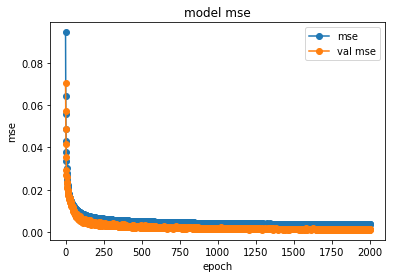

save the model


In [14]:
# -*- coding: utf-8 -*-
"""
Created on Tue Mar  7 15:43:18 2017

@author: hanar
"""
import time
import numpy as np
import os
from keras.utils import np_utils
from keras.models import Sequential
from keras.layers import Dense, Activation, Dropout
from keras.optimizers import SGD
from keras.optimizers import RMSprop
from keras.optimizers import Adagrad
from keras.optimizers import Adadelta
from keras.optimizers import Adam
from keras.optimizers import Adamax
from keras.optimizers import Nadam
from keras.callbacks import ModelCheckpoint
from keras.callbacks import EarlyStopping
from keras.callbacks import TensorBoard
from keras.models import load_model
#from keras.utils.visualize_util import plot
import matplotlib.pyplot as plt
import keras.callbacks
import keras.backend.tensorflow_backend as KTF
import tensorflow as tf

#Global variables for normalizing parameters
max_x = 1.0
min_x = 0.0
max_y = 1.0
min_y = 0.0


def deep_learning_tsunami(resdir, X_train_raw, y_train_raw, X_test_raw, y_test_raw,
                            _lr=0.02, _decay=0,
                            _validation_split=0.2, _batch_size=32,
                            _momentum=0.9, _nesterov=True,
                            num_layers=4, dropout=0.5,
                            node_num = 2500,
                            _epochs=2000):
    """
    Creating the inversion model of turbidity currents by deep learning
    """
    #Normalizing dataset
    X_train = get_normalized_data(X_train_raw, min_x, max_x)
    X_test = get_normalized_data(X_test_raw, min_x, max_x)
    y_train = get_normalized_data(y_train_raw, min_y, max_y)
    y_test = get_normalized_data(y_test_raw, min_y, max_y)
    
    #Generation of neural network model
    model = Sequential()
    model.add(Dense(node_num, input_dim=X_train.shape[1], activation='relu', kernel_initializer ='glorot_uniform'))#1st layer
    model.add(Dropout(dropout))
    for i in range(num_layers - 2):
        model.add(Dense(node_num, activation='relu', kernel_initializer ='glorot_uniform'))#2nd layer
        model.add(Dropout(dropout))
    model.add(Dense(y_train.shape[1], activation = 'relu', kernel_initializer ='glorot_uniform')) #last layer
    
    #Compiling the model
    model.compile(loss="mean_squared_error", 
              optimizer=SGD(lr=_lr, decay=_decay, momentum=_momentum, nesterov=_nesterov),
              #optimizer=Adadelta(),
              metrics=["mean_squared_error"])    
    
    #Perform learning
    t = time.time()
    check = ModelCheckpoint("model3.hdf5")
    #es_cb = EarlyStopping(monitor='val_loss', patience=5, verbose=0, mode='auto')
    #tb_cb = TensorBoard(log_dir=resdir, histogram_freq=2, write_graph=True, write_images=True)
    history = model.fit(X_train, y_train, epochs=_epochs, 
                    validation_split=_validation_split, batch_size=_batch_size,
                    callbacks=[check])
    
    #Evaluate learning result
    loss_and_metrics = model.evaluate(X_test,y_test)
    print("\nloss:{} mse:{}".format(loss_and_metrics[0],loss_and_metrics[1]))
    
    print("Elapsed time: {:.1f} sec.".format(time.time()-t))
    
    #Visualize learning result   
    #plot(model, to_file="model.png", show_shapes=True, show_layer_names=True)

    # model The state of change when letting you learnplot
    plot_history(history)
    
    return model, history

def apply_model(model, X, min_x, max_x, min_y, max_y):
    """
    Apply model
    Maximum and minimum values ​​of X and Y are required to normalize
    """
    X_norm =  (X - min_x) / (max_x - min_x)
    Y_norm = model.predict(X_norm)
    Y = Y_norm*(max_y - min_y)+min_y
    return Y

def plot_history(history):
    # Plot accuracy history
    plt.plot(history.history['mean_squared_error'],"o-",label="mse")
    plt.plot(history.history['val_mean_squared_error'],"o-",label="val mse")
    plt.title('model mse')
    plt.xlabel('epoch')
    plt.ylabel('mse')
    plt.legend(loc="upper right")
    plt.show()

#    # 損失の履歴をプロット
#    plt.plot(history.history['loss'],"o-",label="loss",)
#    plt.plot(history.history['val_loss'],"o-",label="val_loss")
#    plt.title('model loss')
#    plt.xlabel('epoch')
#    plt.ylabel('loss')
#    plt.legend(loc='upper right')
#    plt.show()

def test_model(model, x_test):
    #Test the results
    
    x_test_norm = get_normalized_data(x_test, min_x, max_x)
    test_result_norm = model.predict(x_test_norm)
    test_result = get_raw_data(test_result_norm, min_y, max_y)
    
    return test_result


def save_result(savedir, model, history, test_result):
    
    
    np.savetxt(savedir + 'test_result.txt',test_result,delimiter=',')
    np.savetxt(savedir+'loss.txt',history.history.get('loss'),delimiter=',')
    np.savetxt(savedir+'val_loss.txt',history.history.get('val_loss'),delimiter=',')
    
    #Serialize model and save
    print('save the model')
    model.save(savedir + 'model3.hdf5')

def load_data(datadir):
    """
    This function load training and test data sets, and returns variables
    """
    global min_x, max_x, min_y, max_y
    
    x_train = np.loadtxt(datadir + 'x_train.txt',delimiter=',')
    x_test = np.loadtxt(datadir + 'x_test.txt',delimiter=',')
    y_train = np.loadtxt(datadir + 'icond_train.txt',delimiter=',')
    y_test = np.loadtxt(datadir + 'icond_test.txt',delimiter=',')
    min_y = np.loadtxt(datadir + 'icond_min.txt',delimiter=',')
    max_y = np.loadtxt(datadir + 'icond_max.txt',delimiter=',')
    [min_x, max_x] = np.loadtxt(datadir + 'x_minmax.txt',delimiter=',')
    
    return x_train, y_train, x_test, y_test

def set_minmax_data(_min_x, _max_x, _min_y, _max_y):
    global min_x, max_x, min_y, max_y
    
    min_x, max_x, min_y, max_y = _min_x, _max_x, _min_y, _max_y
    return
    


def get_normalized_data(x, min_val, max_val):
    """
    Normalizing the training and test dataset
    """
    x_norm = (x - min_val) / (max_val - min_val)
    
    return x_norm

def get_raw_data(x_norm, min_val, max_val):
    """
    Get raw data from the normalized dataset
    """
    x = x_norm * (max_val - min_val) + min_val
    
    return x

if __name__ == "__main__":
    
    #Reading data  
    datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi3300/'
    resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi3300/'
    if not os.path.exists(resdir):
        os.mkdir(resdir)
    
    x_train, y_train, x_test, y_test = load_data(datadir)
    
     
    #Execution of learning
    testcases = [4500]
    for i in range(len(testcases)):
        resdir_case = resdir + '{}/'.format(testcases[i])        
        if not os.path.exists(resdir_case):
            os.mkdir(resdir_case)
        x_train_sub = x_train[0:testcases[i],:]
        y_train_sub = y_train[0:testcases[i],:]
        model, history = deep_learning_tsunami(resdir_case, x_train_sub, y_train_sub, x_test, y_test, num_layers=5)
        #Verify and save results
        result = test_model(model, x_test)
        save_result(resdir_case,model,history,result)




(500, 9)


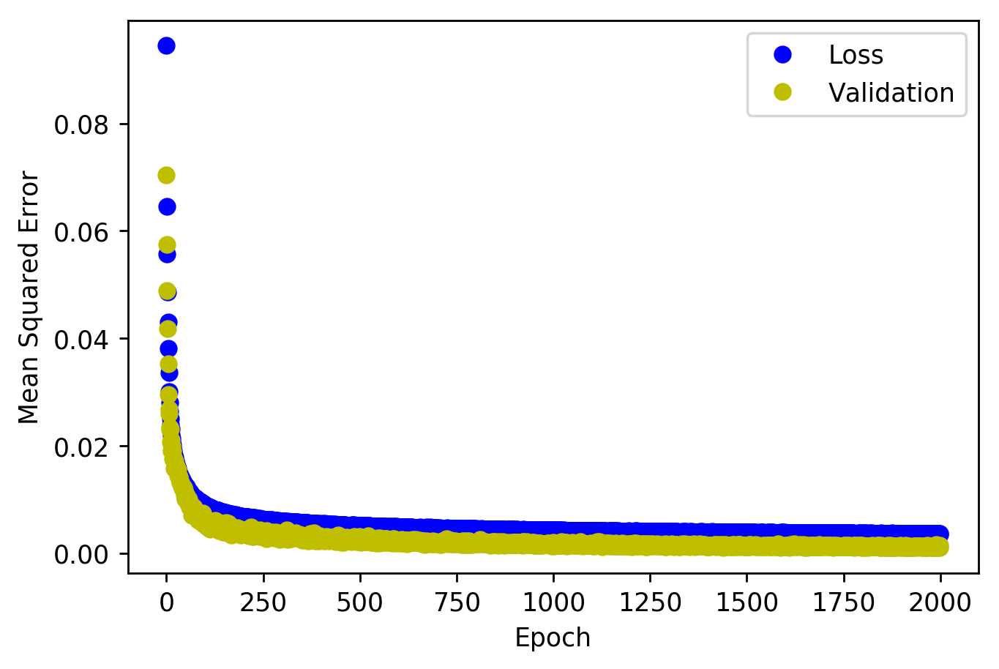

<Figure size 432x288 with 0 Axes>

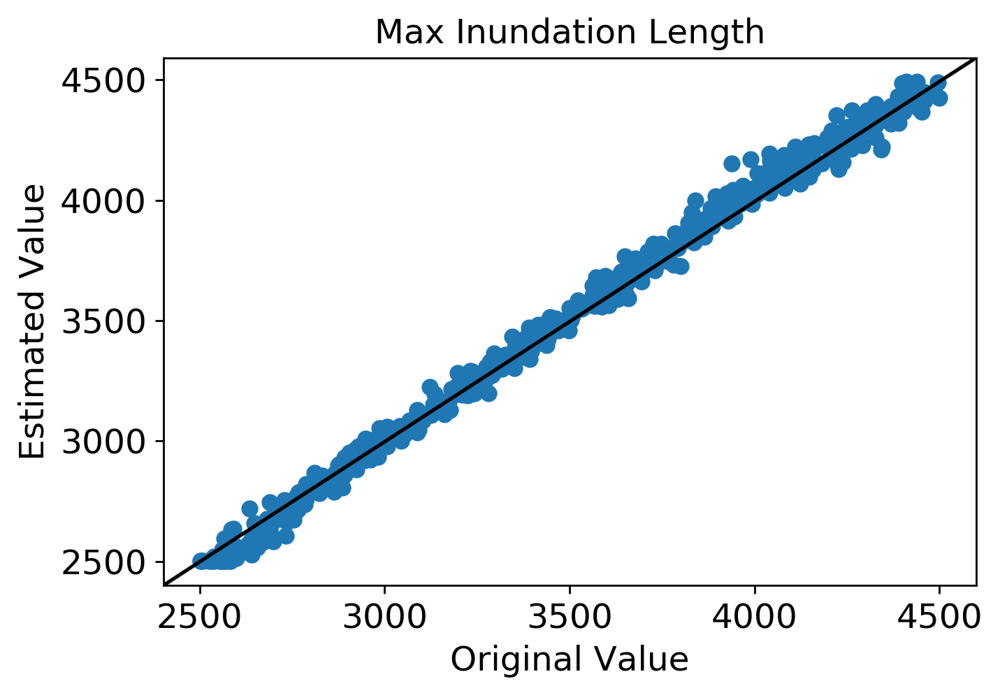

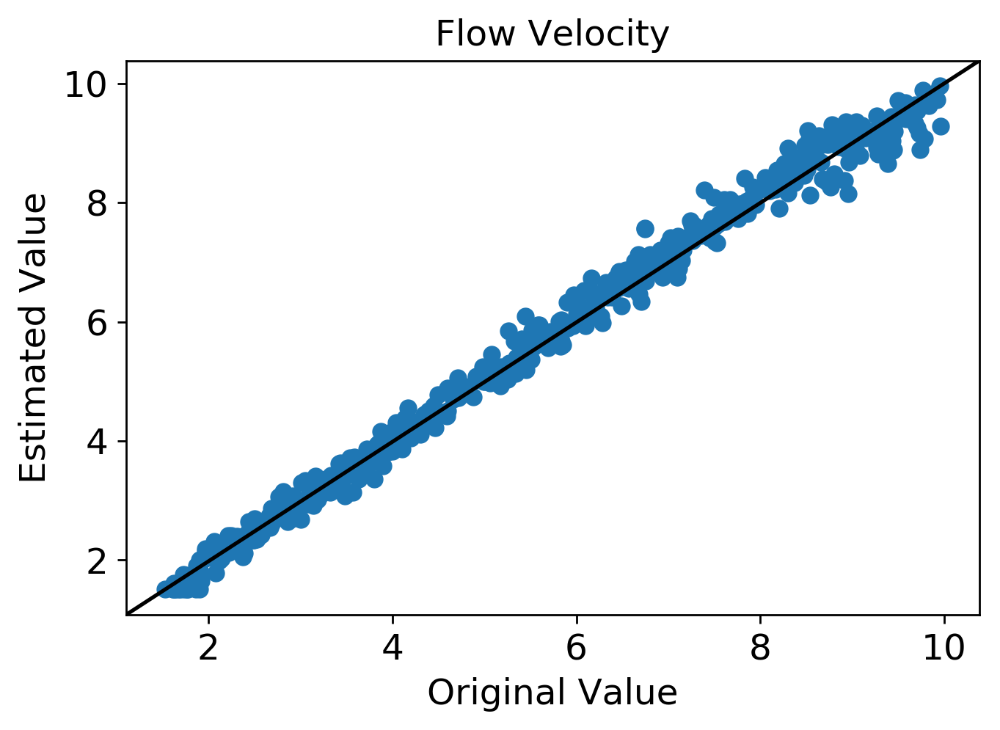

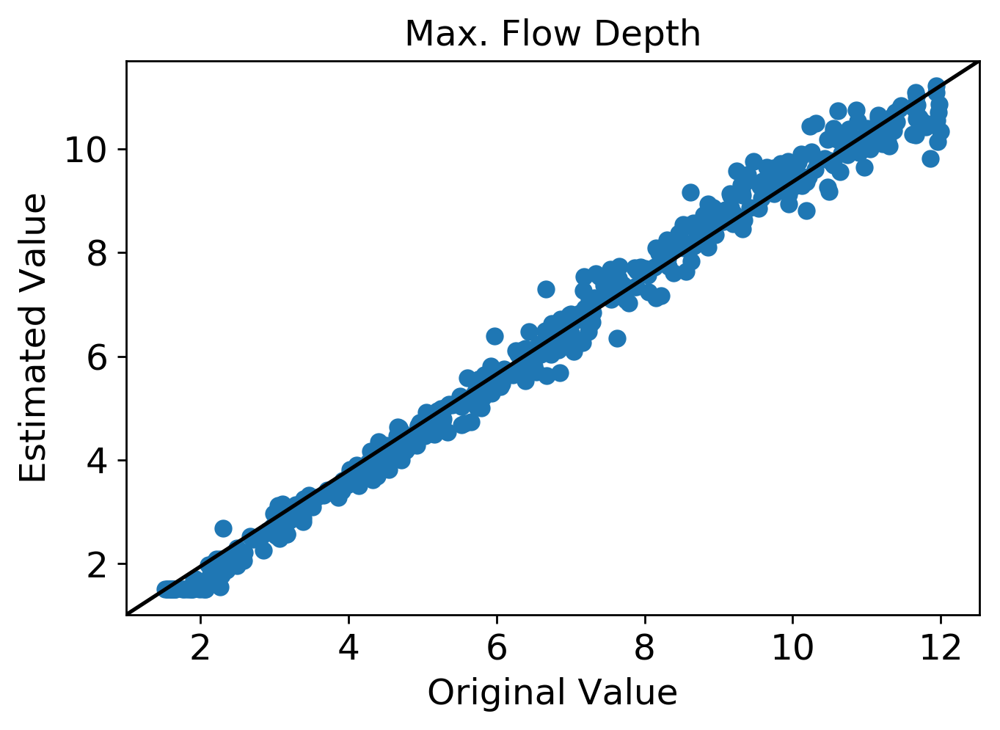

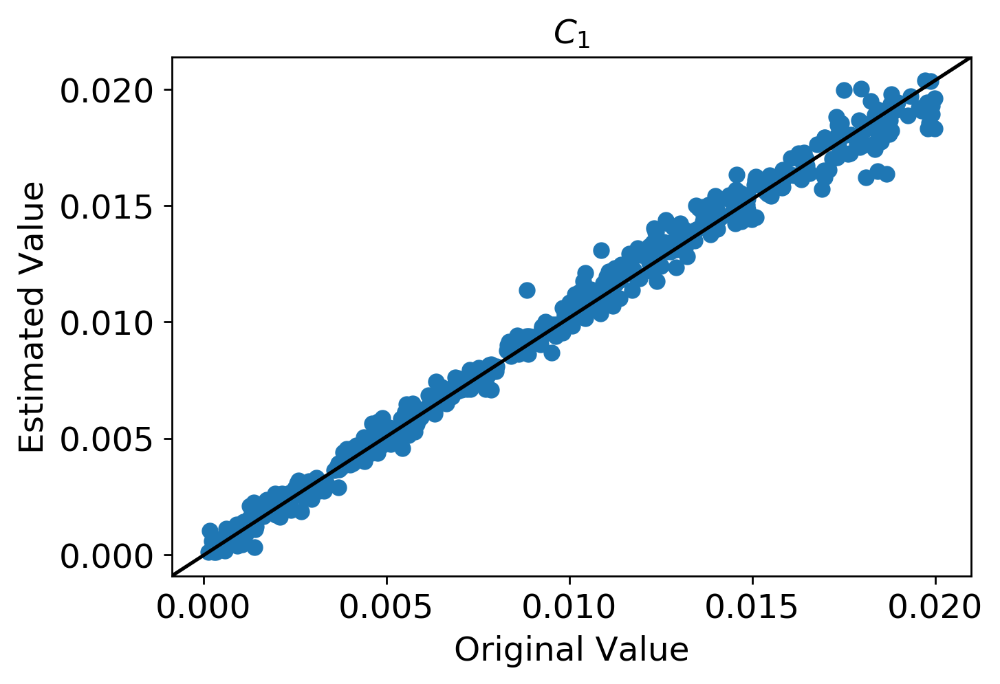

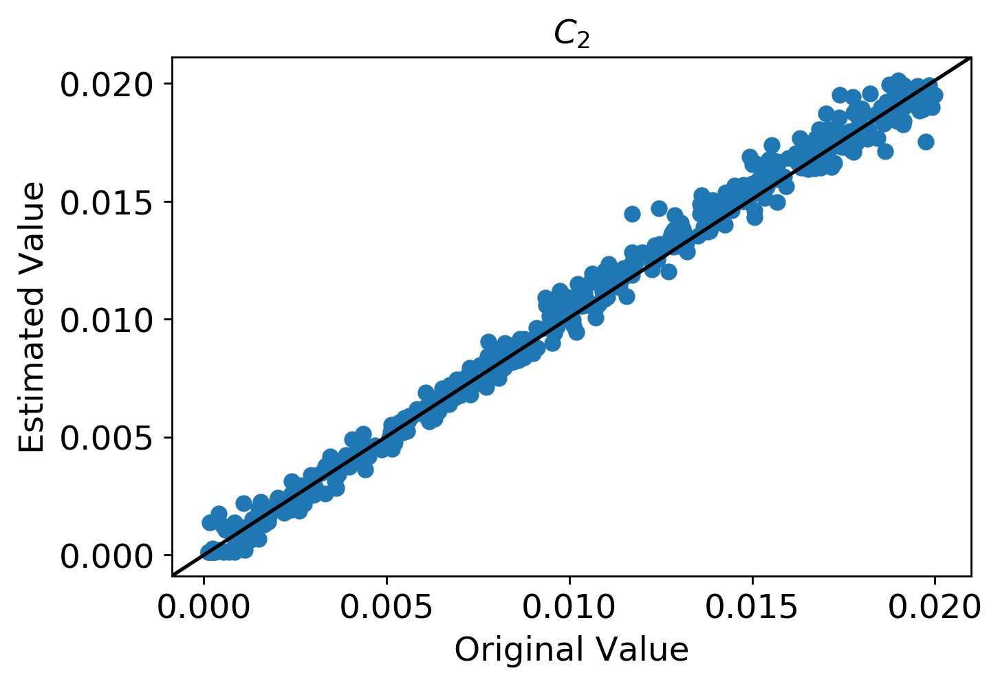

...

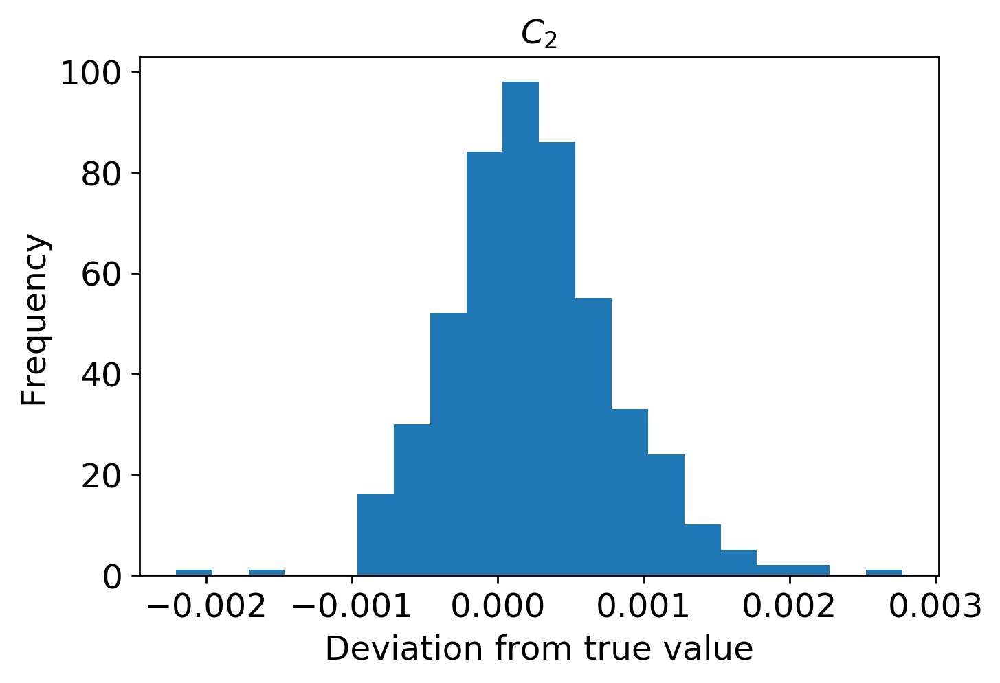

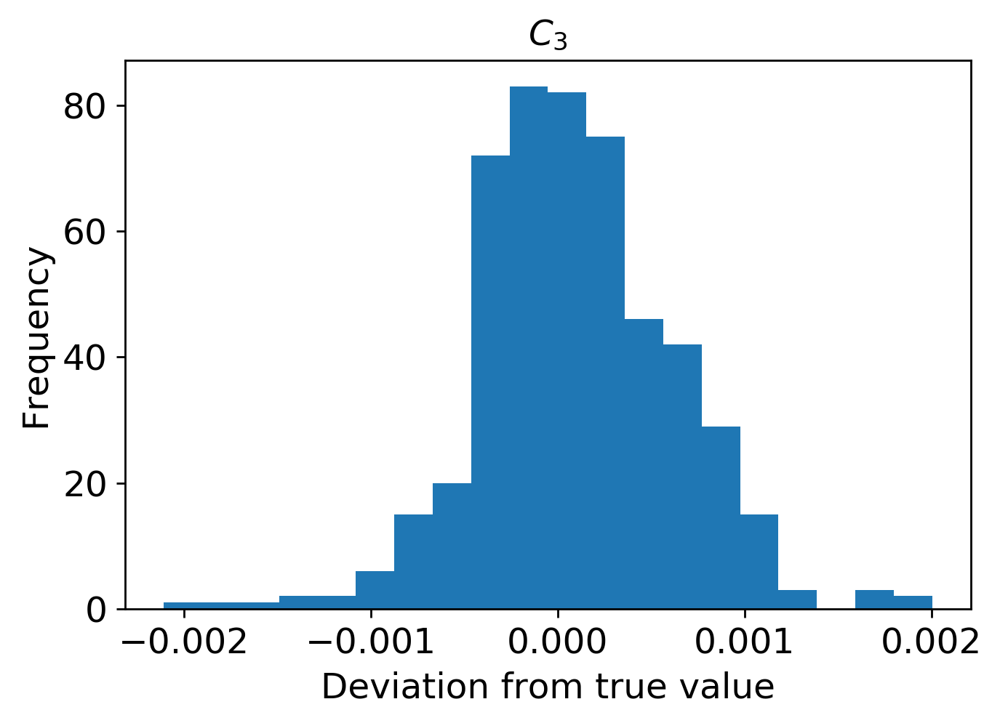

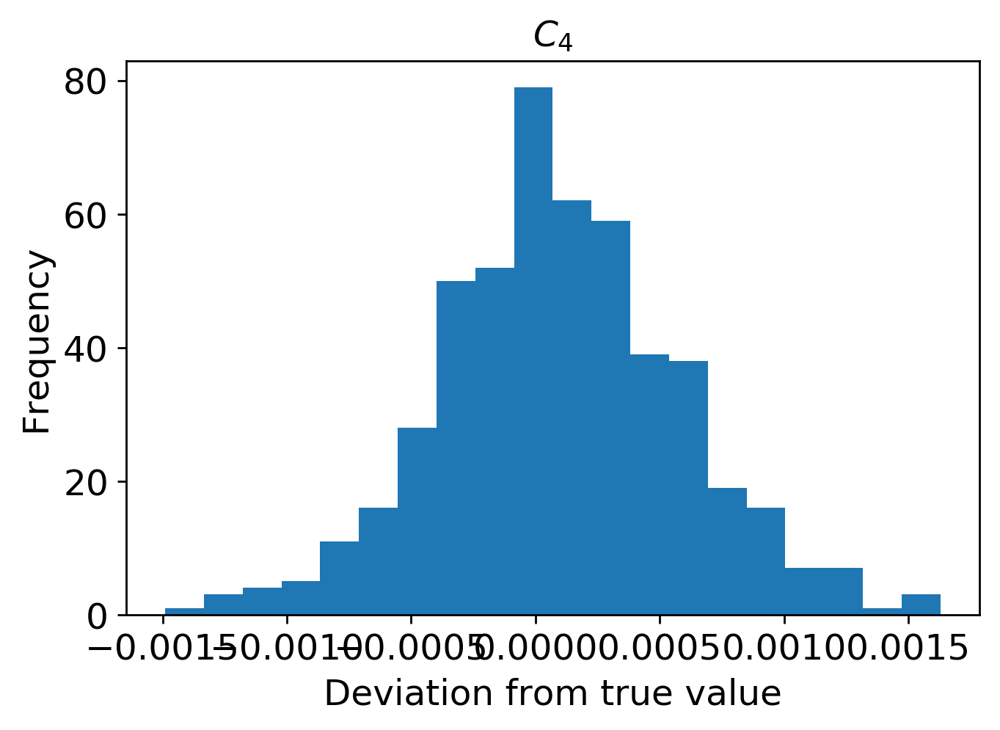

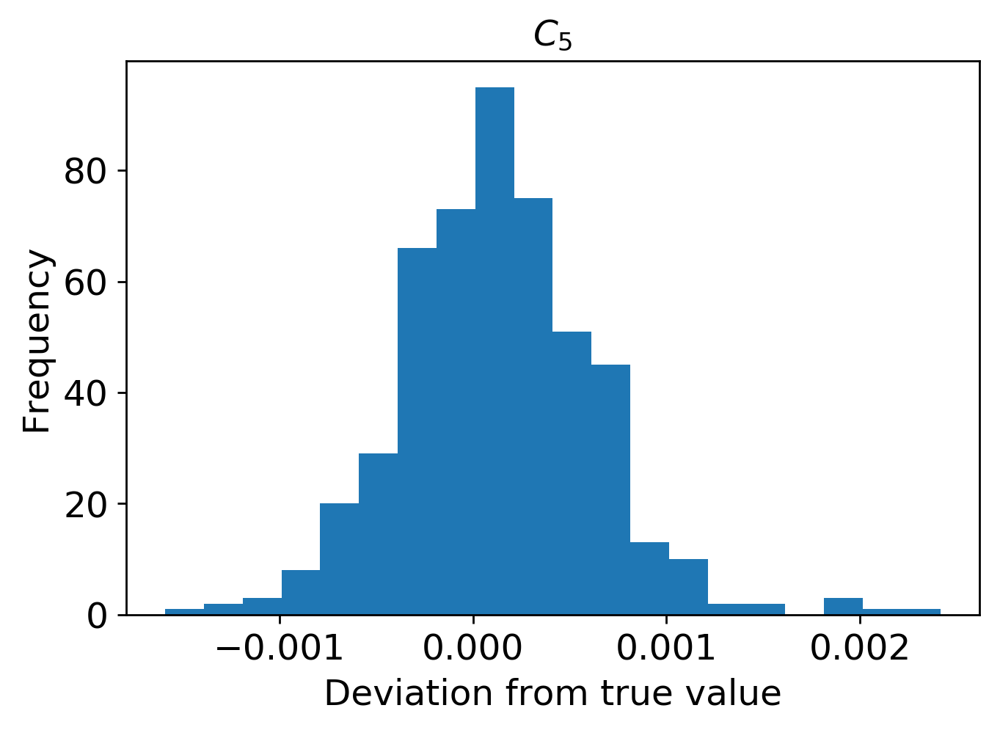

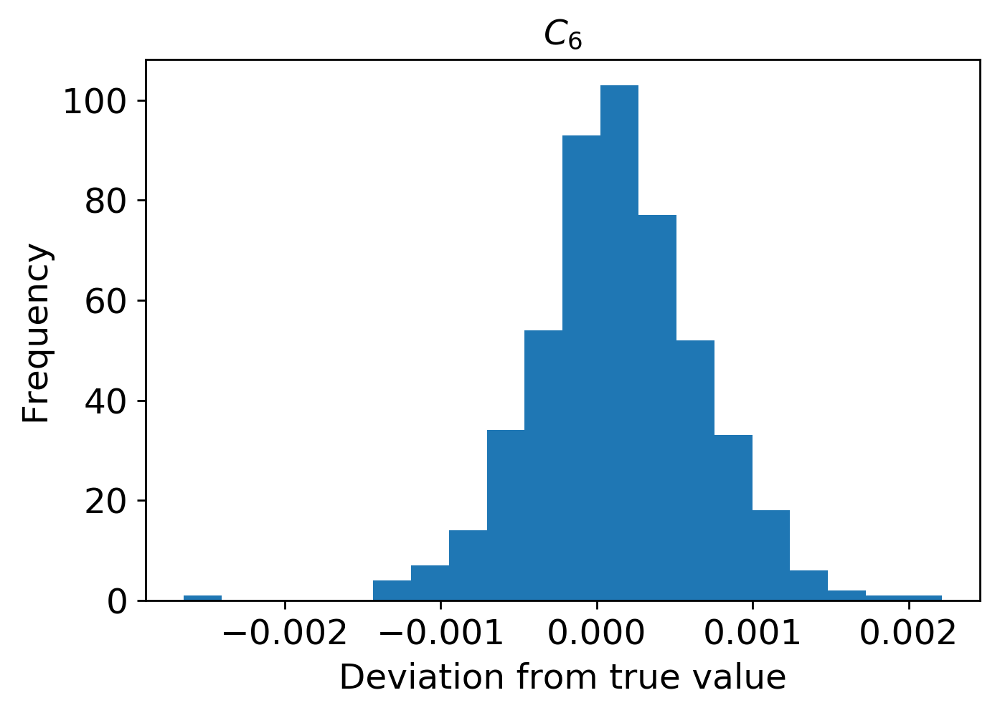

In [15]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi3300/'
resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi3300/4500/'

test_result = np.loadtxt(resdir + 'test_result.txt',delimiter=',')
icond = np.loadtxt(datadir + 'icond_test.txt',delimiter=',')
print(icond.shape)
loss = np.loadtxt(resdir+'loss.txt',delimiter=',')
epoch = range(0,2000)
vloss = np.loadtxt(resdir+'val_loss.txt',delimiter=',')
resi = test_result - icond

fig = plt.figure(num=None,dpi=250, facecolor='w', edgecolor='k')
plt.plot(epoch, loss, 'bo',label='Loss')
plt.plot(epoch, vloss, 'yo',label='Validation')
plt.xlabel('Epoch')
plt.ylabel('Mean Squared Error')
plt.legend(loc="upper right")
plt.savefig(resdir+ 'mse.eps')
plt.show()

fig2 = plt.figure()
hfont = {'fontname':'Century Gothic'}
textcol = 'k'
titlelabel = ['Max Inundation Length','Flow Velocity', 'Max. Flow Depth', '$C_1$', '$C_2$', '$C_3$', '$C_4$','$C_5$','$C_6$']


    
for i in range(len(titlelabel)):
    plt.figure(num=None,dpi=250, facecolor='w', edgecolor='k')
    plt.plot(icond[:,i],test_result[:,i],"o")
    x=icond[:,i]
    y=test_result[:,i]
    y_lim = plt.ylim()
    x_lim = plt.xlim()
    plt.plot(x_lim, y_lim, 'k-', color = 'k')
    plt.ylim(y_lim)
    plt.xlim(x_lim)
    plt.xlabel('Original Value',color=textcol,size=14,**hfont)
    plt.ylabel('Estimated Value',color=textcol,size=14,**hfont)
    plt.title(titlelabel[i],color=textcol,size=14,**hfont)
    plt.tick_params(labelsize=14,colors=textcol)
    plt.savefig(resdir+titlelabel[i] + '.eps')
    #plt.show()

for i in range(len(titlelabel)):
    plt.figure(num=None,dpi=250, facecolor='w', edgecolor='k')
    plt.hist(resi[:,i],bins=20)
    plt.title(titlelabel[i],color=textcol,size=14,**hfont)
    plt.xlabel('Deviation from true value',color=textcol,size=14,**hfont)
    plt.ylabel('Frequency',color=textcol,size=14,**hfont)
    plt.tick_params(labelsize=14,colors=textcol)
    plt.savefig(resdir+titlelabel[i] + 'hist' + '.eps')
    plt.show()

       distance        g1        g2        g3        g4        g5        g6
0      0.000000  0.036771  0.167260  0.114845  0.008449  0.002190  0.005161
1    103.794102  0.000000  0.075200  0.153283  0.013753  0.001885  0.000442
2    171.620654  0.002130  0.051171  0.084309  0.006218  0.001867  0.002843
3    397.112167  0.003115  0.016359  0.078858  0.011466  0.000597  0.000054
4    595.912969  0.000732  0.016896  0.028720  0.002661  0.000914  0.000000
5    707.625749  0.000143  0.002228  0.005502  0.000900  0.000187  0.000104
6    796.435078  0.000236  0.004337  0.021204  0.003169  0.000309  0.000080
7    895.065500  0.001688  0.016059  0.081413  0.020284  0.006824  0.004628
8    988.394177  0.004567  0.008166  0.074658  0.016913  0.002424  0.001580
9   1081.819325  0.001567  0.016305  0.060234  0.011086  0.004165  0.001994
10  1195.756993  0.001022  0.002370  0.017565  0.004194  0.000567  0.000142
11  1290.372534  0.000000  0.004121  0.057974  0.014565  0.000426  0.000213
12  1400.896

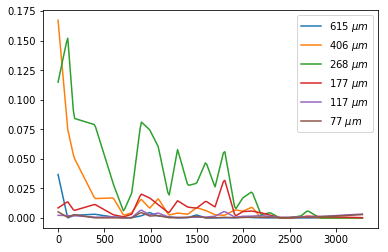

In [16]:
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.models import load_model
from scipy import stats
from scipy.interpolate import interp1d 
import pandas as pd
from pykrige import OrdinaryKriging as OK
import ipdb


datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi3300/'
resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi3300/4500/'
#Initial setting
if not "model" in locals(): 
    model = load_model(resdir+'model3.hdf5')
#gclass = 3
#gclass_label = ["500 $\mu$m","125 $\mu$m","63 $\mu$m"]
gclass = 6
gclass_label = ["615 ${\mu}m$","406 ${\mu}m$","268 ${\mu}m$","177 ${\mu}m$", "117 ${\mu}m$","77 ${\mu}m$"]
topodx = 15.0
coord_num = int(model.layers[0].input_shape[1]/gclass)

#Acquires a value for normalizing input data to [0, 1]
min_x, max_x = np.loadtxt(datadir + 'x_minmax.txt',delimiter=',')
y_min = np.loadtxt(datadir + 'icond_min.txt',delimiter=',')
y_max = np.loadtxt(datadir + 'icond_max.txt',delimiter=',')

#Read outcrop data
#dist_max = 22000. #Distance of distal end of learning data
outcrop = pd.read_csv('../FITTNUSS-forward_training_DNN/sendai_increased_class_edit.csv')
#outcrop = pd.read_csv('../DeepLearningTurbidite_Fukuda/GA_naruse_v2.csv')
#outcrop = outcrop.append(pd.DataFrame([[0,'Loc0',0,0,0],[dist_max,'LocE',0,0,0]], columns=outcrop.columns))
outcrop = outcrop.sort_values('distance')
outcrop['distance'] = outcrop['distance'] - 0
#d = pd.DataFrame(np.zeros((1, 7)),columns=['distance', 'g1','g2','g3','g4','g5','g6'])
#print(d)
#v=np.concatenate((outcrop, d))
#print(v)
#outcrop=pd.DataFrame(v,columns=['distance', 'g1','g2','g3','g4','g5','g6'])
#outcrop['distance'].iloc[-1]=4000
#outcrop = outcrop.append(pd.DataFrame([[0,'Loc0',0,0,0,0]], columns=outcrop.columns))
print(outcrop)

#Preparation under interpolation
thick_interp = np.zeros([1,coord_num*gclass])#補間されたサンプル厚さデータ
outcrop_x_id = np.round(outcrop['distance']/topodx).astype(np.int32) #逆解析システムでのサンプリング地点のindex番号
x = np.arange(0,coord_num*topodx,topodx)

#Complement data
for j in range(gclass):
    f = interp1d(outcrop['distance'],outcrop.iloc[:,j+1], kind="linear",bounds_error=False,fill_value='extrapolate')
    #f = interp1d(outcrop['distance'],outcrop.iloc[:,j+2], kind="linear",bounds_error=False,fill_value='extrapolate') 
    #Interpolation function of jth granularity level
    thick_interp[0,coord_num*j:coord_num*(j+1)] = f(x) #Supplemented data

#ipdb.set_trace()
#Kriging Interpolation by
#vparams = np.array([[0.035, 10000., 0.001],[0.006, 10000., 0.002],[0.005, 10000., 0.002],[0.035, 10000., 0.001]])
#for j in range(gclass):
    #okip = OK(outcrop['distance'],np.zeros(outcrop['distance'].shape),outcrop.iloc[:,j+1],variogram_model='linear',)
    #okip.display_variogram_model()
    #ipdata, ipstd = okip.execute('grid',x,np.array([0.]))
    #ipdata = np.squeeze(ipdata)
    #thick_interp[0,coord_num*j:coord_num*(j+1)] = ipdata #Assign complemented d

#Normalize data
thick_interp[thick_interp < 0] = 0
thick_interp_norm =  (thick_interp - min_x) / (max_x - min_x)

#Perform inverse analysis
test_result_outcrop = model.predict(thick_interp_norm)
test_result_outcrop = test_result_outcrop * (y_max - y_min) + y_min
print(test_result_outcrop)
#add=np.array(3000)
#test_result_outcrop_add=np.concatenate((add,test_result_outcrop), axis=None)
#Output results
#print(test_result_outcrop_add)
np.savetxt('outcrop_result_g6_g300_H_5000_20_11_roi3300.txt',test_result_outcrop, delimiter=',')
for i in range(len(gclass_label)):
    plt.plot(x,thick_interp[0,coord_num * i:coord_num * (i+1)],label=gclass_label[i])
plt.legend()
plt.show()



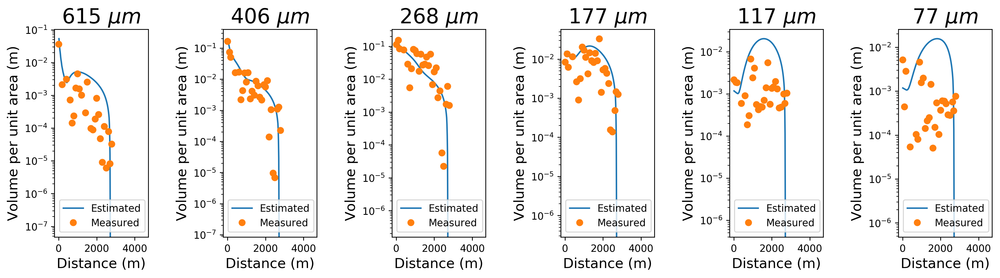

In [17]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import Forward_model_modified_FITTNUSS_5000_g6_300grid_19_11_case2 as fmodel
import time
import ipdb
%matplotlib inline

#Basic setting

#dist_max = 3000.
gclass = 6
topodx=15.0
gclass_name = ['615microm','406microm','268microm','177microm','117microm','77microm']
#gclass_name = ['500micron', '125micron', '63micron']
gname_tex = ["615 ${\mu}m$","406 ${\mu}m$","268 ${\mu}m$","177 ${\mu}m$", "117 ${\mu}m$","77 ${\mu}m$"]
#gname_tex = ['500 $\mu$m','125 $\mu$m','63 $\mu$m']
#calcdir = 'home/rimali2009/FITTNUSS-forward_training_DNN/'
#calcdir = '/home/naruse/Documents/Documents/MATLAB/TCtrainData_forML/TCModel_for_MLTEST/test_output_otadai07/'

#Load estimate
#H1 = np.loadtxt(calcdir + 'H1.txt',delimiter=',')
#H2 = np.loadtxt(calcdir + 'H2.txt',delimiter=',')
#H3 = np.loadtxt(calcdir + 'H3.txt',delimiter=',')
#H4 = np.loadtxt(calcdir + 'H4.txt',delimiter=',')
#Ht = np.loadtxt(calcdir + 'Ht.txt',delimiter=',')
#U = np.loadtxt(calcdir + 'U.txt',delimiter=',')
#xi = np.loadtxt(calcdir + 'xi.txt',delimiter=',')
#x = np.loadtxt(calcdir + 'x.txt',delimiter=',')
#x_bed = np.loadtxt(calcdir + 'x_init.txt',delimiter=',')
#eta_init = np.loadtxt(calcdir + 'eta_init.txt',delimiter=',')
#Ct = np.loadtxt(calcdir + 'Ct.txt',delimiter=',')
#time = np.loadtxt(calcdir + 'time.txt',delimiter=',')
estimated_icond=np.loadtxt('outcrop_result_g6_g300_H_5000_20_11_roi3300.txt', delimiter=',')
start = time.time()
fmodel.read_setfile("config_g6_300grid_19_11_case2.ini")
(x,C,x_dep,deposit) = fmodel.forward(estimated_icond)
np.savetxt('eta_estimated_thickness_5K_g6_TC4_Rwcnst_H_5000_20_11_roi3300.csv', deposit, delimiter=',')
np.savetxt('eta_estimated_Distance_5K_g6_TC4_Rwcnst_H_5000_20_11_roi3300.csv', x_dep,delimiter=',')
estimated_dep_thickness_5000=np.transpose(np.loadtxt('/home/rimali2009/FITTNUSS-forward_training_DNN/'+'eta_estimated_thickness_5K_g6_TC4_Rwcnst_H_5000_20_11_roi3300.csv', delimiter=','))
estimated_dep_thickness_5000=pd.DataFrame(estimated_dep_thickness_5000,columns=['615microm','406microm','268microm','177microm','117microm','77microm'])
estimated_dep_distance_5000=np.transpose(np.loadtxt('/home/rimali2009/FITTNUSS-forward_training_DNN/'+'eta_estimated_Distance_5K_g6_TC4_Rwcnst_H_5000_20_11_roi3300.csv', delimiter=','))
estimated_dep_distance_5000=pd.DataFrame(estimated_dep_distance_5000,columns=['distance'])
estimated_dep_5000=pd.concat([estimated_dep_distance_5000,estimated_dep_thickness_5000],axis=1)
np.savetxt('estimated_dep_5K_g6_TC4_Rwcnst_H_5000_20_11_roi3300.csv',estimated_dep_5000,delimiter=',')
#data_estim=pd.DataFrame(estimated_dep_5000,columns=['distance','1.5phi','2.5phi','3.5phi','4.5phi'])

#Formatting the loaded data
#estimated_dep_df = pd.DataFrame(estimated_dep,columns=['distance','1.5phi','2.5phi','3.5phi','4.5phi'])
#estimated_dep = pd.DataFrame(np.array([x_bed - dist_offset,H1[-1,:],H2[-1,:],H3[-1,:]]).T,columns=['distance','500micron','125micron','63micron'])
estimated_dep_5000= estimated_dep_5000.query('distance > 0')
#estimated_dep_5000 = estimated_dep_5000.query('distance < {}'.format(dist_max))

#Read original data
outcrop = pd.read_csv('../FITTNUSS-forward_training_DNN/sendai_increased_class.csv')
outcrop= pd.DataFrame(outcrop,columns=['distance','615microm','406microm','268microm','177microm','117microm','77microm'])
#outcrop = pd.read_csv('../DeepLearningTurbidite_Fukuda/GA_naruse_v2.csv')
#outcrop = outcrop.append(pd.DataFrame([[0,'Loc0',0,0,0],[dist_max,'LocE',0,0,0]], columns=outcrop.columns))
#outcrop = outcrop.sort_values('distance')
#outcrop['distance'] = outcrop['distance'] - 1000

#Plot
plt.figure(num=None, figsize=(17, 4), dpi=250, facecolor='w', edgecolor='g')
hfont = {'fontname':'Sans'}
plt.subplots_adjust(bottom=0.15, wspace=0.8)

for i in range(gclass):
    plt.subplot(1,gclass,i+1)
    plt.plot(estimated_dep_5000['distance'],estimated_dep_5000[gclass_name[i]],'-', label='Estimated')
    plt.plot(outcrop['distance'], outcrop[gclass_name[i]],'o', label='Measured')
    plt.yscale('log')
    plt.title(gname_tex[i], size=21,**hfont)
    plt.xlabel('Distance (m)', size = 14, **hfont)
    plt.ylabel('Volume per unit area (m)', size = 14, **hfont)
    plt.legend(fontsize=10)
    plt.savefig("thickness_distance_curve_5000_g6_300grid_H_5000_20_11_roi3300.png")
    plt.savefig("thickness_distance_curve_5000_g6_300grid_H_5000_20_11_roi3300.eps")
plt.show()



Using TensorFlow backend.


       distance        g1        g2        g3        g4        g5        g6
0      0.000000  0.036771  0.167260  0.114845  0.008449  0.002190  0.005161
1    103.794102  0.000000  0.075200  0.153283  0.013753  0.001885  0.000442
2    171.620654  0.002130  0.051171  0.084309  0.006218  0.001867  0.002843
3    397.112167  0.003115  0.016359  0.078858  0.011466  0.000597  0.000054
4    595.912969  0.000732  0.016896  0.028720  0.002661  0.000914  0.000000
5    707.625749  0.000143  0.002228  0.005502  0.000900  0.000187  0.000104
6    796.435078  0.000236  0.004337  0.021204  0.003169  0.000309  0.000080
7    895.065500  0.001688  0.016059  0.081413  0.020284  0.006824  0.004628
8    988.394177  0.004567  0.008166  0.074658  0.016913  0.002424  0.001580
9   1081.819325  0.001567  0.016305  0.060234  0.011086  0.004165  0.001994
10  1195.756993  0.001022  0.002370  0.017565  0.004194  0.000567  0.000142
11  1290.372534  0.000000  0.004121  0.057974  0.014565  0.000426  0.000213
12  1400.896

       distance        g1        g2        g3        g4        g5        g6
0      0.000000  0.036771  0.167260  0.114845  0.008449  0.002190  0.005161
1    103.794102  0.000000  0.075200  0.153283  0.013753  0.001885  0.000442
2    171.620654  0.002130  0.051171  0.084309  0.006218  0.001867  0.002843
3    397.112167  0.003115  0.016359  0.078858  0.011466  0.000597  0.000054
4    595.912969  0.000732  0.016896  0.028720  0.002661  0.000914  0.000000
5    707.625749  0.000143  0.002228  0.005502  0.000900  0.000187  0.000104
6    895.065500  0.001688  0.016059  0.081413  0.020284  0.006824  0.004628
7    988.394177  0.004567  0.008166  0.074658  0.016913  0.002424  0.001580
8   1081.819325  0.001567  0.016305  0.060234  0.011086  0.004165  0.001994
9   1195.756993  0.001022  0.002370  0.017565  0.004194  0.000567  0.000142
10  1290.372534  0.000000  0.004121  0.057974  0.014565  0.000426  0.000213
11  1400.896519  0.000295  0.003096  0.027406  0.009121  0.000502  0.000251
12  1495.352

/home/rimali2009/anaconda3/envs/test3/lib/python3.6/site-packages/matplotlib/font_manager.py:1241: UserWarning: findfont: Font family ['Century Gothic'] not found. Falling back to DejaVu Sans.
  (prop.get_family(), self.defaultFamily[fontext]))


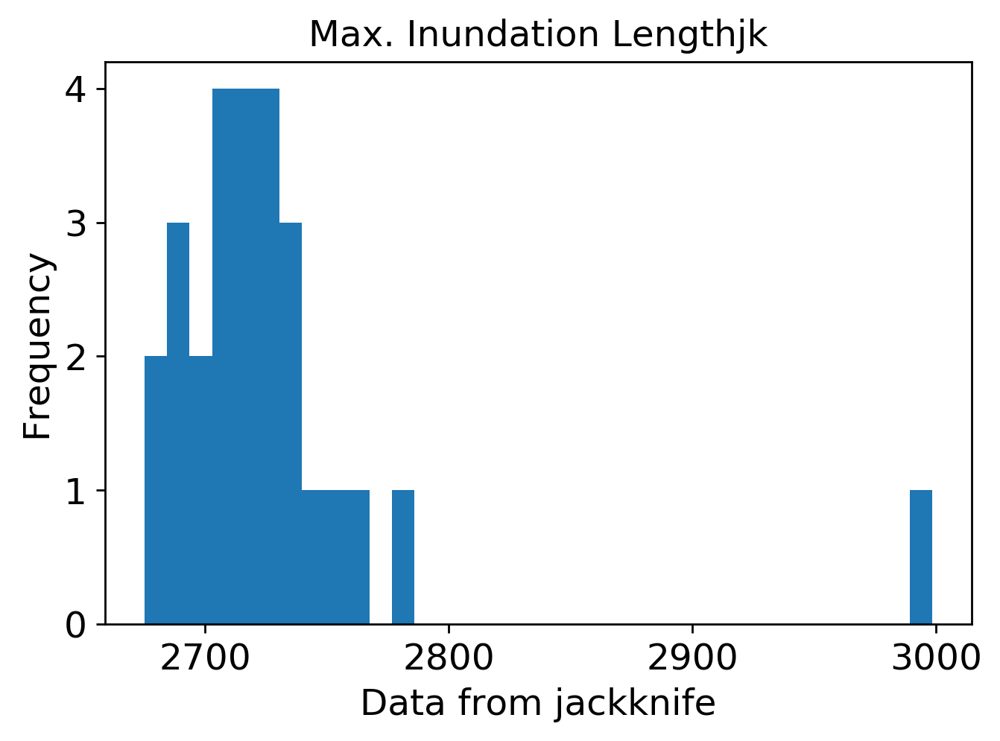

mean: 4.652787519972009
jk_e: 0.06797936876192419


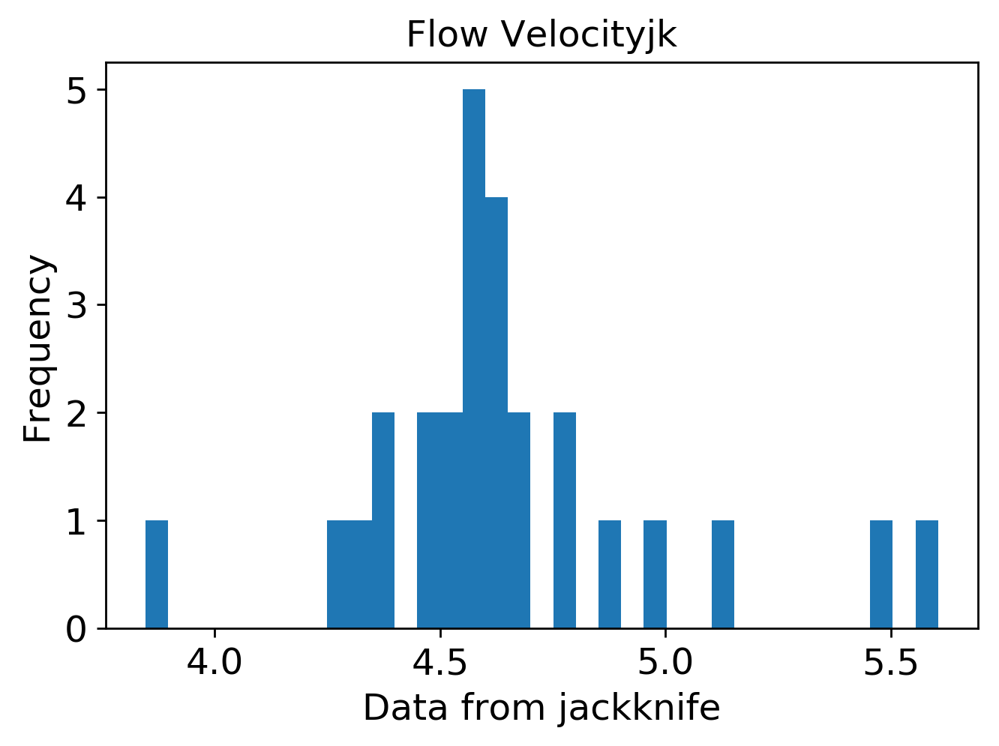

mean: 7.00936271288734
jk_e: 0.1457252318622622


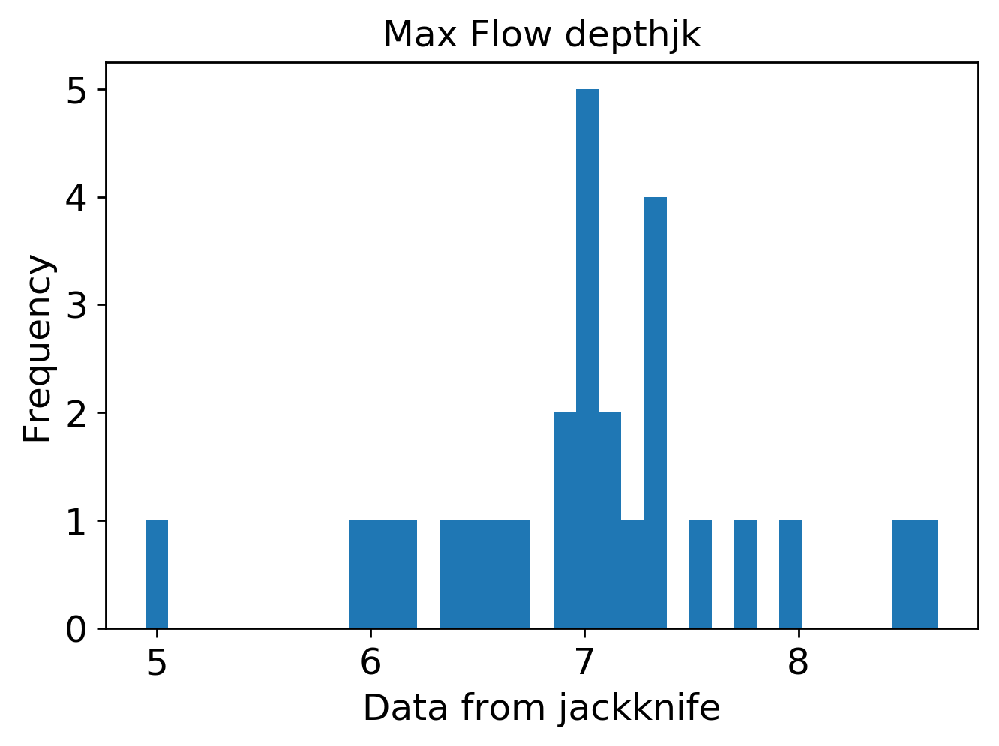

mean: 0.005145792038993973
jk_e: 0.0001493811926373214


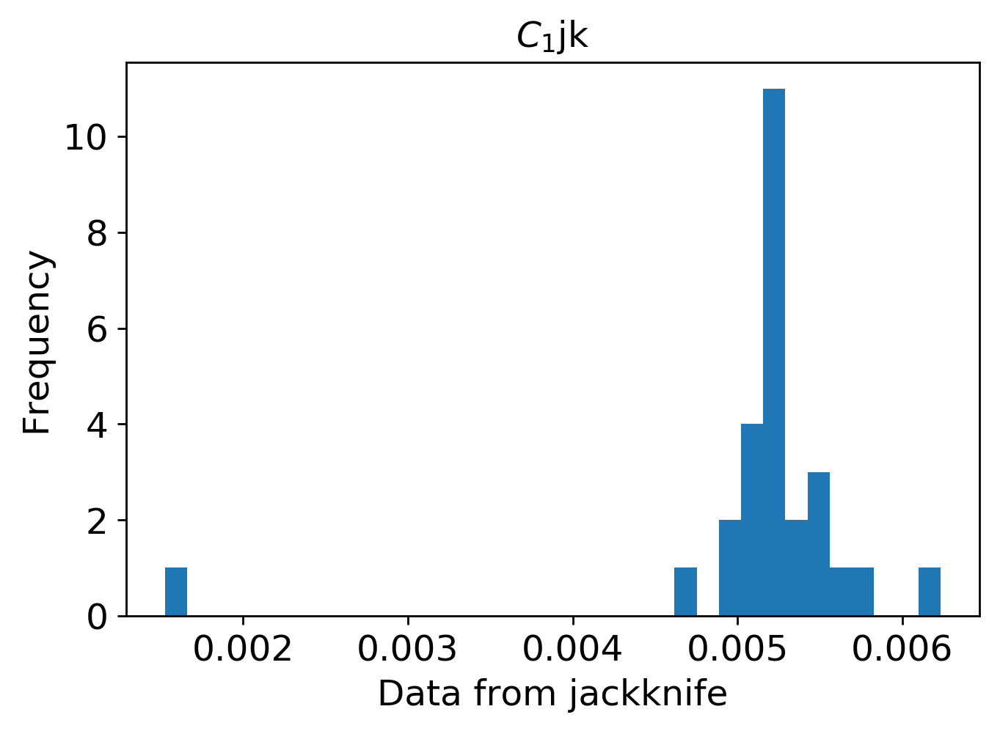

mean: 0.01868180641313212
jk_e: 0.00029737834383284875


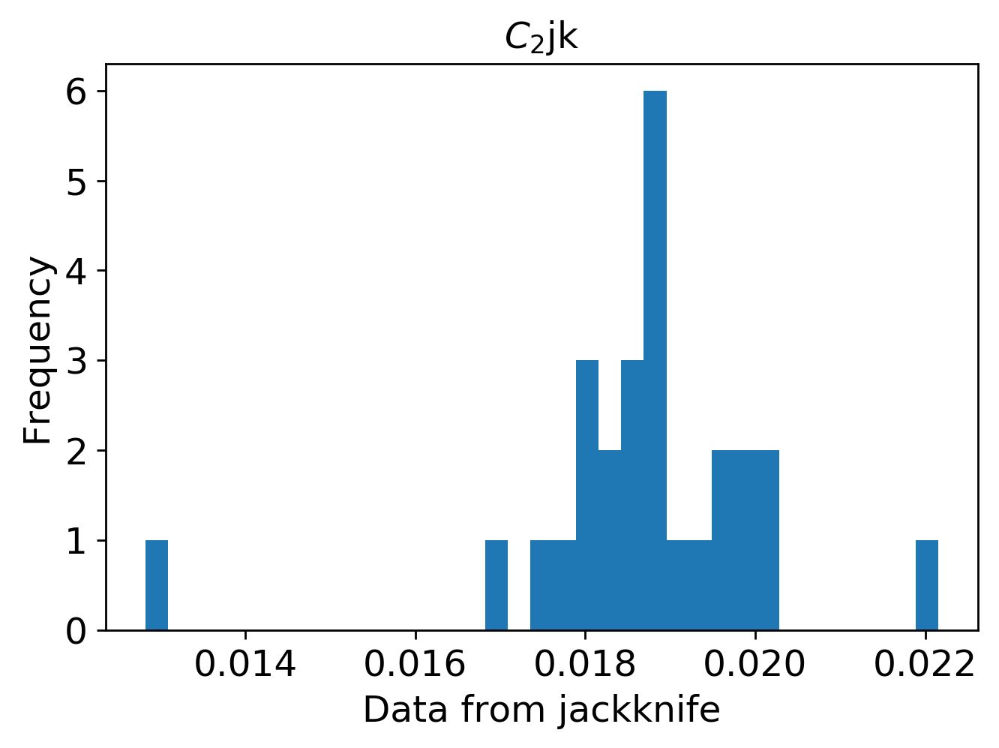

mean: 0.015544316491866286
jk_e: 0.00030778515320564043


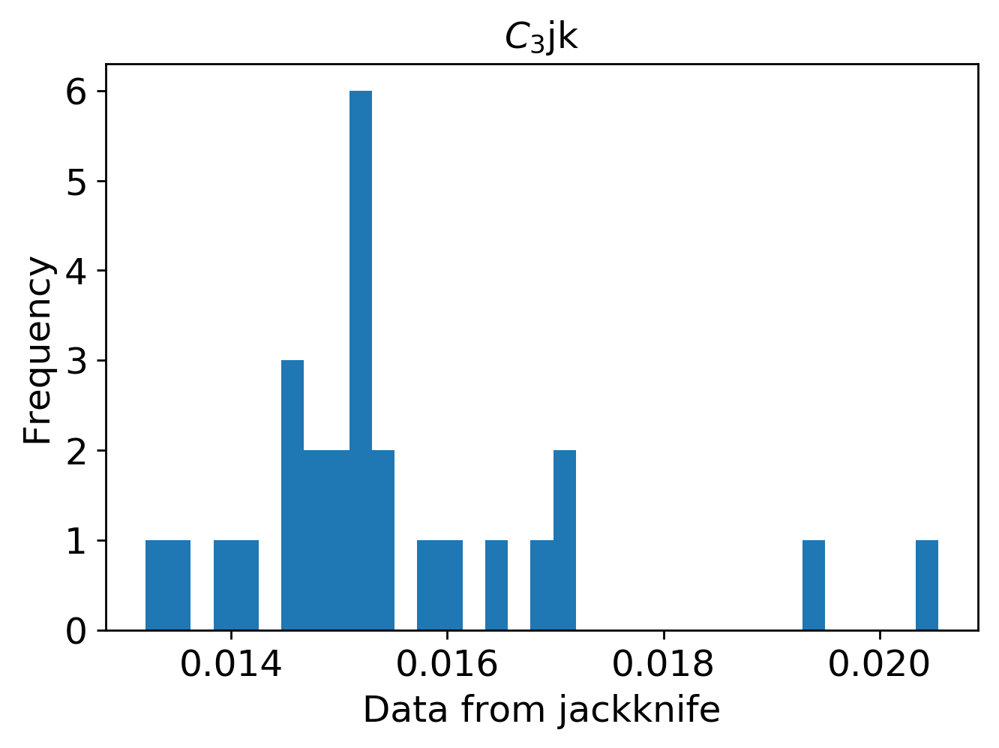

mean: 0.0013839118073193557
jk_e: 4.6023054445308094e-05


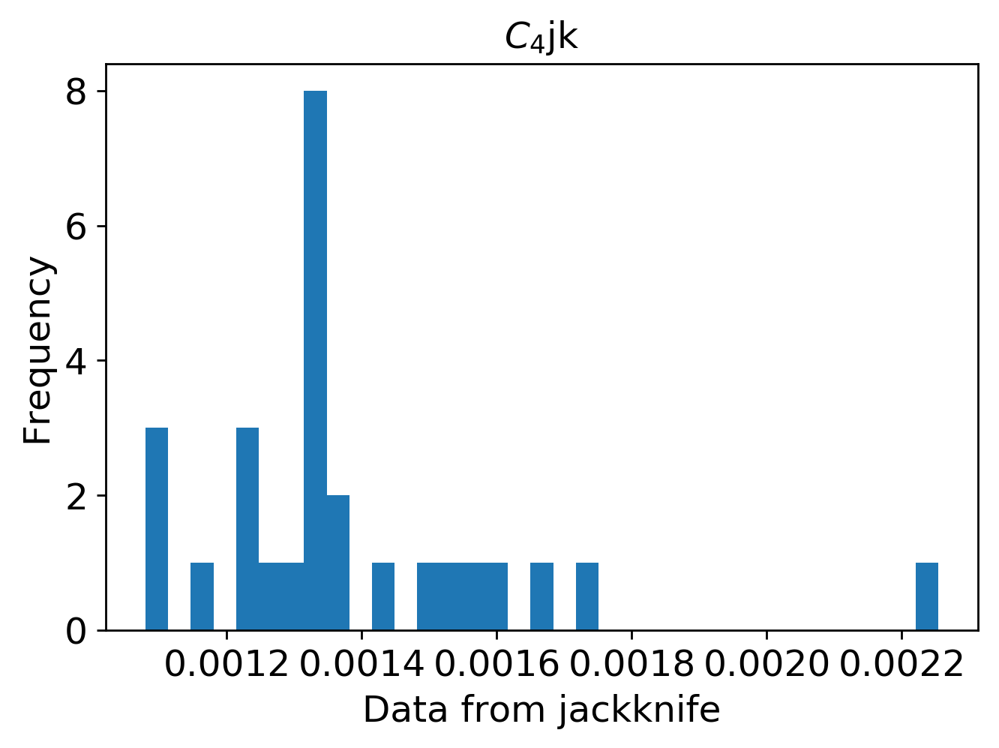

mean: 0.00012597549449098382
jk_e: 1.9318270917609263e-05


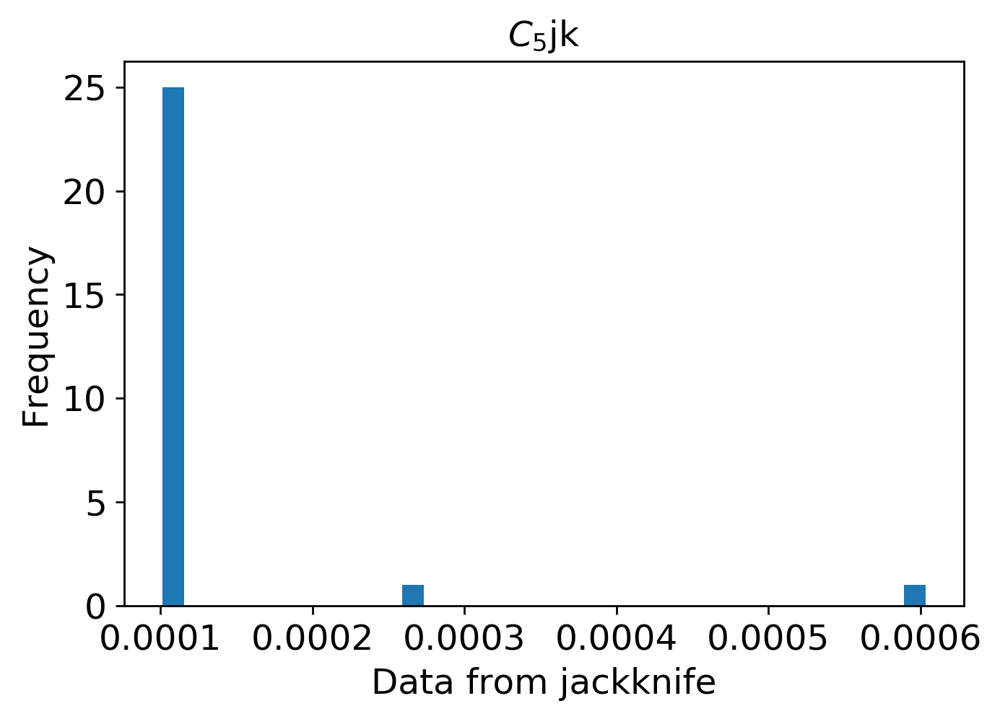

mean: 0.0001346246791368566
jk_e: 2.2421471070849847e-05


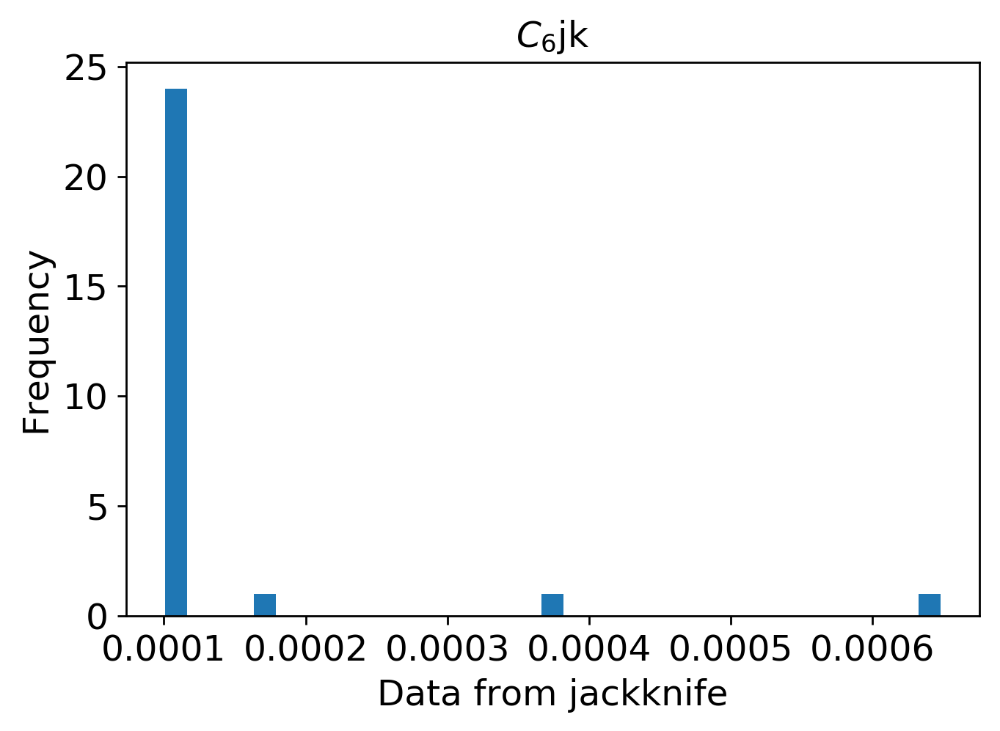

In [1]:
# Jackknife Method
import csv
import numpy as np
import pandas as pd
import math
from keras.models import load_model
from scipy.interpolate import interp1d
import matplotlib.pyplot as plt
%matplotlib inline

datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi3300/'
resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi3300/4500/'
# Initial setting
if not "model" in locals():
    model = load_model(resdir+'model3.hdf5')
gclass = 6
gclass_label = ["615 ${\mu}m$", "406 ${\mu}m$", "268 ${\mu}m$",
                "177 ${\mu}m$", "117 ${\mu}m$", "77 ${\mu}m$"]
topodx = 15.0
coord_num = int(model.layers[0].input_shape[1]/gclass)
min_x, max_x = np.loadtxt(datadir + 'x_minmax.txt', delimiter=',')
y_min = np.loadtxt(datadir + 'icond_min.txt', delimiter=',')
y_max = np.loadtxt(datadir + 'icond_max.txt', delimiter=',')


a = pd.read_csv(
    '../FITTNUSS-forward_training_DNN/sendai_increased_class_edit.csv', delimiter=',')
print(a)
y = pd.DataFrame()
output = []

with open('output_final_20_11_roi3300.csv', 'w') as outfile:

    # x=[]
    for index in range(len(a)):
        df = y.append(pd.read_csv(
            '../FITTNUSS-forward_training_DNN/sendai_increased_class_edit.csv', skiprows=[index+1]))
        print(df)
        df = df.sort_values('distance')
        thick_interp = np.zeros([1, coord_num*gclass])
        x = np.arange(0, coord_num*topodx, topodx)
        for j in range(gclass):
            # Interpolation function of jth granularity level
            f = interp1d(df['distance'], df.iloc[:, j+1],
                         kind="linear", bounds_error=False,fill_value='extrapolate')
            thick_interp[0, coord_num*j:coord_num*(j+1)] = f(x)
        thick_interp[thick_interp < 0] = 0
        thick_interp_norm = (thick_interp - min_x) / (max_x - min_x)
        test_result_outcrop = model.predict(thick_interp_norm)
        test_result_outcrop = test_result_outcrop * (y_max - y_min) + y_min
        print(test_result_outcrop.shape)
        print(test_result_outcrop)
    # output.append(test_result_outcrop)
        np.savetxt(outfile,test_result_outcrop, delimiter=',')
        # outfile.write('# New iteration\n')
hfont = {'fontname': 'Century Gothic'}
textcol = 'k'
resi = np.loadtxt('output_final_20_11_roi3300.csv', delimiter=',')
titlelabel = ['Max. Inundation Lengthjk','Flow Velocityjk', 'Max Flow depthjk',
              '$C_1$jk', '$C_2$jk', '$C_3$jk', '$C_4$jk', '$C_5$jk', '$C_6$jk']
jk_er=[]
with open('jk_e_roi3300.txt','wb') as ftext:
    for i in range(len(titlelabel)):
        plt.figure(num=None, dpi=250, facecolor='w', edgecolor='k')
        plt.hist(resi[:, i], bins=35)
        mean = sum(resi[:,i]) / len(resi[:,i])
        print("mean:",mean)
        var_jk  = sum(pow(x-mean,2) for x in resi[:,i]) / ((len(resi[:,i])-1)*(len(resi[:,i])))
        jk_e= math.sqrt(var_jk)
        print("jk_e:",jk_e)
        e=np.append(jk_e,jk_er)
        np.savetxt(ftext,e,delimiter=',')
        plt.title(titlelabel[i], color=textcol, size=14, **hfont)
        plt.xlabel('Data from jackknife', color=textcol, size=14, **hfont)
        plt.ylabel('Frequency', color=textcol, size=14, **hfont)
        plt.tick_params(labelsize=14, colors=textcol)
        plt.savefig(resdir+titlelabel[i] + 'jkhist' + '.eps')
        plt.show()

# ROI 3400

In [19]:
import numpy as np
import os
#import ipdb

def connect_dataset(file_list, icond_file_list, outputdir,
                    topodx=15, roi=2500, offset=5000,gclass_num=6,test_data_num=500):
    """
    複数のデータセットを連結する
    """
    #ipdb.set_trace()
    
    #Reading and combining files Decide start and end points of the learning area and convert them to grid numbers
    H = np.loadtxt(file_list[0], delimiter = ',')
    icond = np.loadtxt(icond_file_list[0], delimiter = ',')
    
    #Reading and combining files
    if len(file_list) > 1:
        for i in range(1, len(file_list)):
            H_temp = np.loadtxt(file_list[i], delimiter = ',')
            icond_temp = np.loadtxt(icond_file_list[i], delimiter = ',')
            H = np.concatenate((H,H_temp),axis=0)
            icond = np.concatenate((icond,icond_temp),axis = 0)
    
    roi_grids = int(roi / topodx)
    num_grids = int(H.shape[1] / gclass_num)
    H_subset = np.zeros([H.shape[0], roi_grids * gclass_num])
    for i in range(gclass_num):
        H_subset[:, i*roi_grids:(i+1)*roi_grids] = H[:, i*num_grids:(i*num_grids+roi_grids)]
    
    #Obtain the maximum and minimum values of data
    max_x = np.max(H_subset)
    min_x = np.min(H_subset)
    icond_max = np.max(icond, axis=0)
    icond_min = np.min(icond, axis=0)
    
    #Split the data into tests and training
    H_train = H_subset[0:-test_data_num,:]
    H_test = H_subset[H_subset.shape[0] - test_data_num:,:]
    icond_train = icond[0:-test_data_num,:]
    icond_test = icond[H.shape[0] - test_data_num:,:]
    
    #Save the data
    if not os.path.exists(outputdir):
        os.mkdir(outputdir)
    np.savetxt(outputdir + '/x_train.txt',H_train,delimiter = ',')
    np.savetxt(outputdir + '/x_test.txt',H_test,delimiter = ',')
    np.savetxt(outputdir + '/icond_train.txt',icond_train,delimiter = ',')
    np.savetxt(outputdir + '/icond_test.txt',icond_test,delimiter = ',')
    np.savetxt(outputdir + '/icond_min.txt',icond_min,delimiter = ',')
    np.savetxt(outputdir + '/icond_max.txt',icond_max,delimiter = ',')
    np.savetxt(outputdir + '/x_minmax.txt',[min_x, max_x],delimiter = ',')
    
    
if __name__=="__main__":
    original_data_dir = "/home/rimali2009/FITTNUSS-forward_training_DNN"
    parent_dir = "/home/rimali2009/FITTNUSS-forward_training_DNN"
    if not os.path.exists(parent_dir):
        os.mkdir(parent_dir)
    outputdir = parent_dir + "/data_g6_300grid_H_5000_20_11_roi3400"
    file_list = ['/home/rimali2009/FITTNUSS-forward_training_DNN/eta_5000_g6_300grid_19_11.csv']
    initial_conditions = ['/home/rimali2009/FITTNUSS-forward_training_DNN/start_param_random_5000_g6_300grid_19_11.csv']
connect_dataset(file_list, initial_conditions, outputdir, test_data_num=500, gclass_num=6, topodx=15., roi=3400)
        
        
    

Train on 3600 samples, validate on 900 samples
Epoch 1/2000
3600/3600 [==============================] - 2s 490us/step - loss: 0.0964 - mean_squared_error: 0.0964 - val_loss: 0.0697 - val_mean_squared_error: 0.0697
Epoch 2/2000
3600/3600 [==============================] - 1s 396us/step - loss: 0.0648 - mean_squared_error: 0.0648 - val_loss: 0.0558 - val_mean_squared_error: 0.0558
Epoch 3/2000
3600/3600 [==============================] - 1s 393us/step - loss: 0.0556 - mean_squared_error: 0.0556 - val_loss: 0.0476 - val_mean_squared_error: 0.0476
Epoch 4/2000
3600/3600 [==============================] - 1s 406us/step - loss: 0.0483 - mean_squared_error: 0.0483 - val_loss: 0.0410 - val_mean_squared_error: 0.0410
Epoch 5/2000
3600/3600 [==============================] - 1s 392us/step - loss: 0.0424 - mean_squared_error: 0.0424 - val_loss: 0.0344 - val_mean_squared_error: 0.0344
Epoch 6/2000
3600/3600 [==============================] - 1s 388us/step - loss: 0.0377 - mean_squared_error: 0.03

3600/3600 [==============================] - 1s 399us/step - loss: 0.0089 - mean_squared_error: 0.0089 - val_loss: 0.0059 - val_mean_squared_error: 0.0059
Epoch 98/2000
3600/3600 [==============================] - 1s 406us/step - loss: 0.0091 - mean_squared_error: 0.0091 - val_loss: 0.0061 - val_mean_squared_error: 0.0061
Epoch 99/2000
3600/3600 [==============================] - 1s 385us/step - loss: 0.0090 - mean_squared_error: 0.0090 - val_loss: 0.0058 - val_mean_squared_error: 0.0058
Epoch 100/2000
3600/3600 [==============================] - 1s 404us/step - loss: 0.0089 - mean_squared_error: 0.0089 - val_loss: 0.0062 - val_mean_squared_error: 0.0062
Epoch 101/2000
3600/3600 [==============================] - 2s 418us/step - loss: 0.0089 - mean_squared_error: 0.0089 - val_loss: 0.0063 - val_mean_squared_error: 0.0063
Epoch 102/2000
3600/3600 [==============================] - 1s 393us/step - loss: 0.0089 - mean_squared_error: 0.0089 - val_loss: 0.0058 - val_mean_squared_error: 0.00

3600/3600 [==============================] - 1s 395us/step - loss: 0.0068 - mean_squared_error: 0.0068 - val_loss: 0.0043 - val_mean_squared_error: 0.0043
Epoch 194/2000
3600/3600 [==============================] - 1s 402us/step - loss: 0.0069 - mean_squared_error: 0.0069 - val_loss: 0.0042 - val_mean_squared_error: 0.0042
Epoch 195/2000
3600/3600 [==============================] - 1s 378us/step - loss: 0.0068 - mean_squared_error: 0.0068 - val_loss: 0.0035 - val_mean_squared_error: 0.0035
Epoch 196/2000
3600/3600 [==============================] - 2s 436us/step - loss: 0.0068 - mean_squared_error: 0.0068 - val_loss: 0.0048 - val_mean_squared_error: 0.0048
Epoch 197/2000
3600/3600 [==============================] - 1s 407us/step - loss: 0.0069 - mean_squared_error: 0.0069 - val_loss: 0.0043 - val_mean_squared_error: 0.0043
Epoch 198/2000
3600/3600 [==============================] - 1s 404us/step - loss: 0.0067 - mean_squared_error: 0.0067 - val_loss: 0.0038 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 379us/step - loss: 0.0061 - mean_squared_error: 0.0061 - val_loss: 0.0037 - val_mean_squared_error: 0.0037
Epoch 290/2000
3600/3600 [==============================] - 1s 392us/step - loss: 0.0060 - mean_squared_error: 0.0060 - val_loss: 0.0036 - val_mean_squared_error: 0.0036
Epoch 291/2000
3600/3600 [==============================] - 2s 450us/step - loss: 0.0060 - mean_squared_error: 0.0060 - val_loss: 0.0040 - val_mean_squared_error: 0.0040
Epoch 292/2000
3600/3600 [==============================] - 1s 367us/step - loss: 0.0060 - mean_squared_error: 0.0060 - val_loss: 0.0031 - val_mean_squared_error: 0.0031
Epoch 293/2000
3600/3600 [==============================] - 1s 379us/step - loss: 0.0059 - mean_squared_error: 0.0059 - val_loss: 0.0031 - val_mean_squared_error: 0.0031
Epoch 294/2000
3600/3600 [==============================] - 1s 392us/step - loss: 0.0059 - mean_squared_error: 0.0059 - val_loss: 0.0030 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 375us/step - loss: 0.0055 - mean_squared_error: 0.0055 - val_loss: 0.0029 - val_mean_squared_error: 0.0029
Epoch 386/2000
3600/3600 [==============================] - 1s 381us/step - loss: 0.0055 - mean_squared_error: 0.0055 - val_loss: 0.0030 - val_mean_squared_error: 0.0030
Epoch 387/2000
3600/3600 [==============================] - 1s 390us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0028 - val_mean_squared_error: 0.0028
Epoch 388/2000
3600/3600 [==============================] - 1s 411us/step - loss: 0.0055 - mean_squared_error: 0.0055 - val_loss: 0.0030 - val_mean_squared_error: 0.0030
Epoch 389/2000
3600/3600 [==============================] - 1s 393us/step - loss: 0.0055 - mean_squared_error: 0.0055 - val_loss: 0.0027 - val_mean_squared_error: 0.0027
Epoch 390/2000
3600/3600 [==============================] - 1s 393us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0025 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 403us/step - loss: 0.0052 - mean_squared_error: 0.0052 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 482/2000
3600/3600 [==============================] - 1s 416us/step - loss: 0.0052 - mean_squared_error: 0.0052 - val_loss: 0.0026 - val_mean_squared_error: 0.0026
Epoch 483/2000
3600/3600 [==============================] - 1s 388us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0022 - val_mean_squared_error: 0.0022
Epoch 484/2000
3600/3600 [==============================] - 1s 365us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0024 - val_mean_squared_error: 0.0024
Epoch 485/2000
3600/3600 [==============================] - 1s 383us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0027 - val_mean_squared_error: 0.0027
Epoch 486/2000
3600/3600 [==============================] - 1s 388us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0023 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 389us/step - loss: 0.0049 - mean_squared_error: 0.0049 - val_loss: 0.0029 - val_mean_squared_error: 0.0029
Epoch 578/2000
3600/3600 [==============================] - 1s 404us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0021 - val_mean_squared_error: 0.0021
Epoch 579/2000
3600/3600 [==============================] - 2s 439us/step - loss: 0.0049 - mean_squared_error: 0.0049 - val_loss: 0.0020 - val_mean_squared_error: 0.0020
Epoch 580/2000
3600/3600 [==============================] - 1s 382us/step - loss: 0.0049 - mean_squared_error: 0.0049 - val_loss: 0.0022 - val_mean_squared_error: 0.0022
Epoch 581/2000
3600/3600 [==============================] - 1s 382us/step - loss: 0.0049 - mean_squared_error: 0.0049 - val_loss: 0.0022 - val_mean_squared_error: 0.0022
Epoch 582/2000
3600/3600 [==============================] - 1s 375us/step - loss: 0.0049 - mean_squared_error: 0.0049 - val_loss: 0.0025 - val_mean_squared_error: 0.

3600/3600 [==============================] - 2s 429us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0021 - val_mean_squared_error: 0.0021
Epoch 674/2000
3600/3600 [==============================] - 1s 393us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0021 - val_mean_squared_error: 0.0021
Epoch 675/2000
3600/3600 [==============================] - 1s 374us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0018 - val_mean_squared_error: 0.0018
Epoch 676/2000
3600/3600 [==============================] - 1s 364us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0019 - val_mean_squared_error: 0.0019
Epoch 677/2000
3600/3600 [==============================] - 1s 393us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0019 - val_mean_squared_error: 0.0019
Epoch 678/2000
3600/3600 [==============================] - 1s 404us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0019 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 374us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0018 - val_mean_squared_error: 0.0018
Epoch 770/2000
3600/3600 [==============================] - 1s 414us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0020 - val_mean_squared_error: 0.0020
Epoch 771/2000
3600/3600 [==============================] - 1s 400us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0019 - val_mean_squared_error: 0.0019
Epoch 772/2000
3600/3600 [==============================] - 1s 406us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0019 - val_mean_squared_error: 0.0019
Epoch 773/2000
3600/3600 [==============================] - 1s 388us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0017 - val_mean_squared_error: 0.0017
Epoch 774/2000
3600/3600 [==============================] - 1s 393us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0022 - val_mean_squared_error: 0.

3600/3600 [==============================] - 2s 417us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0019 - val_mean_squared_error: 0.0019
Epoch 866/2000
3600/3600 [==============================] - 1s 376us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0020 - val_mean_squared_error: 0.0020
Epoch 867/2000
3600/3600 [==============================] - 1s 384us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 868/2000
3600/3600 [==============================] - 1s 388us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0018 - val_mean_squared_error: 0.0018
Epoch 869/2000
3600/3600 [==============================] - 1s 395us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0019 - val_mean_squared_error: 0.0019
Epoch 870/2000
3600/3600 [==============================] - 1s 393us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0018 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 393us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0018 - val_mean_squared_error: 0.0018
Epoch 962/2000
3600/3600 [==============================] - 1s 390us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 963/2000
3600/3600 [==============================] - 1s 398us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0017 - val_mean_squared_error: 0.0017
Epoch 964/2000
3600/3600 [==============================] - 1s 406us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 965/2000
3600/3600 [==============================] - 1s 382us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0017 - val_mean_squared_error: 0.0017
Epoch 966/2000
3600/3600 [==============================] - 1s 408us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0016 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 390us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1058/2000
3600/3600 [==============================] - 1s 367us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0018 - val_mean_squared_error: 0.0018
Epoch 1059/2000
3600/3600 [==============================] - 1s 394us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1060/2000
3600/3600 [==============================] - 1s 374us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0017 - val_mean_squared_error: 0.0017
Epoch 1061/2000
3600/3600 [==============================] - 1s 377us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1062/2000
3600/3600 [==============================] - 2s 418us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0013 - val_mean_squared_erro

3600/3600 [==============================] - 1s 410us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1106/2000
3600/3600 [==============================] - 1s 396us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1107/2000
3600/3600 [==============================] - 1s 360us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1108/2000
3600/3600 [==============================] - 1s 402us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1109/2000
3600/3600 [==============================] - 1s 376us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0017 - val_mean_squared_error: 0.0017
Epoch 1110/2000
3600/3600 [==============================] - 1s 370us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0016 - val_mean_squared_erro

3600/3600 [==============================] - 1s 406us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1154/2000
3600/3600 [==============================] - 1s 390us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1155/2000
3600/3600 [==============================] - 1s 370us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1156/2000
3600/3600 [==============================] - 1s 403us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1157/2000
3600/3600 [==============================] - 2s 441us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0020 - val_mean_squared_error: 0.0020
Epoch 1158/2000
3600/3600 [==============================] - 1s 402us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0017 - val_mean_squared_erro

3600/3600 [==============================] - 1s 371us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1202/2000
3600/3600 [==============================] - 1s 386us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1203/2000
3600/3600 [==============================] - 2s 422us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1204/2000
3600/3600 [==============================] - 1s 401us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0018 - val_mean_squared_error: 0.0018
Epoch 1205/2000
3600/3600 [==============================] - 1s 409us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1206/2000
3600/3600 [==============================] - 1s 407us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0018 - val_mean_squared_erro

3600/3600 [==============================] - 1s 378us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1250/2000
3600/3600 [==============================] - 1s 374us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0018 - val_mean_squared_error: 0.0018
Epoch 1251/2000
3600/3600 [==============================] - 1s 385us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1252/2000
3600/3600 [==============================] - 1s 413us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1253/2000
3600/3600 [==============================] - 2s 428us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1254/2000
3600/3600 [==============================] - 1s 395us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0013 - val_mean_squared_erro

3600/3600 [==============================] - 1s 403us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1298/2000
3600/3600 [==============================] - 1s 407us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1299/2000
3600/3600 [==============================] - 1s 379us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1300/2000
3600/3600 [==============================] - 1s 400us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1301/2000
3600/3600 [==============================] - 1s 376us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1302/2000
3600/3600 [==============================] - 1s 371us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0016 - val_mean_squared_erro

3600/3600 [==============================] - 1s 370us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1346/2000
3600/3600 [==============================] - 1s 373us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1347/2000
3600/3600 [==============================] - 1s 416us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1348/2000
3600/3600 [==============================] - 1s 368us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1349/2000
3600/3600 [==============================] - 1s 390us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1350/2000
3600/3600 [==============================] - 1s 399us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0014 - val_mean_squared_erro

3600/3600 [==============================] - 1s 401us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1394/2000
3600/3600 [==============================] - 1s 371us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1395/2000
3600/3600 [==============================] - 1s 396us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1396/2000
3600/3600 [==============================] - 1s 387us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1397/2000
3600/3600 [==============================] - 1s 397us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1398/2000
3600/3600 [==============================] - 1s 391us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0014 - val_mean_squared_erro

3600/3600 [==============================] - 2s 443us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1442/2000
3600/3600 [==============================] - 1s 375us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1443/2000
3600/3600 [==============================] - 1s 372us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1444/2000
3600/3600 [==============================] - 2s 422us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1445/2000
3600/3600 [==============================] - 1s 393us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1446/2000
3600/3600 [==============================] - 1s 412us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0014 - val_mean_squared_erro

3600/3600 [==============================] - 1s 402us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1490/2000
3600/3600 [==============================] - 1s 381us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1491/2000
3600/3600 [==============================] - 1s 393us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1492/2000
3600/3600 [==============================] - 1s 392us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1493/2000
3600/3600 [==============================] - 1s 395us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1494/2000
3600/3600 [==============================] - 1s 401us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0013 - val_mean_squared_erro

3600/3600 [==============================] - 1s 378us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1538/2000
3600/3600 [==============================] - 1s 401us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1539/2000
3600/3600 [==============================] - 1s 398us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1540/2000
3600/3600 [==============================] - 1s 397us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1541/2000
3600/3600 [==============================] - 1s 394us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1542/2000
3600/3600 [==============================] - 1s 391us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0013 - val_mean_squared_erro

3600/3600 [==============================] - 1s 359us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1586/2000
3600/3600 [==============================] - 1s 400us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1587/2000
3600/3600 [==============================] - 1s 412us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1588/2000
3600/3600 [==============================] - 2s 424us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1589/2000
3600/3600 [==============================] - 1s 396us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1590/2000
3600/3600 [==============================] - 1s 397us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0014 - val_mean_squared_erro

3600/3600 [==============================] - 1s 394us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1634/2000
3600/3600 [==============================] - 1s 395us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1635/2000
3600/3600 [==============================] - 1s 379us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1636/2000
3600/3600 [==============================] - 1s 380us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1637/2000
3600/3600 [==============================] - 1s 381us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1638/2000
3600/3600 [==============================] - 1s 371us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0011 - val_mean_squared_erro

3600/3600 [==============================] - 1s 386us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1682/2000
3600/3600 [==============================] - 1s 385us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1683/2000
3600/3600 [==============================] - 1s 394us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1684/2000
3600/3600 [==============================] - 1s 413us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1685/2000
3600/3600 [==============================] - 1s 376us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1686/2000
3600/3600 [==============================] - 1s 378us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0012 - val_mean_squared_erro

3600/3600 [==============================] - 1s 387us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1730/2000
3600/3600 [==============================] - 1s 388us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1731/2000
3600/3600 [==============================] - 2s 419us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1732/2000
3600/3600 [==============================] - 1s 408us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1733/2000
3600/3600 [==============================] - 1s 388us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1734/2000
3600/3600 [==============================] - 1s 411us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0013 - val_mean_squared_erro

3600/3600 [==============================] - 1s 386us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1778/2000
3600/3600 [==============================] - 1s 404us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1779/2000
3600/3600 [==============================] - 1s 384us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1780/2000
3600/3600 [==============================] - 1s 402us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1781/2000
3600/3600 [==============================] - 1s 387us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1782/2000
3600/3600 [==============================] - 1s 374us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0013 - val_mean_squared_erro

3600/3600 [==============================] - 1s 404us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1826/2000
3600/3600 [==============================] - 1s 382us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1827/2000
3600/3600 [==============================] - 1s 385us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1828/2000
3600/3600 [==============================] - 1s 400us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1829/2000
3600/3600 [==============================] - 1s 368us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1830/2000
3600/3600 [==============================] - 1s 401us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0014 - val_mean_squared_erro

3600/3600 [==============================] - 1s 408us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1874/2000
3600/3600 [==============================] - 1s 390us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1875/2000
3600/3600 [==============================] - 1s 409us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1876/2000
3600/3600 [==============================] - 1s 399us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1877/2000
3600/3600 [==============================] - 2s 417us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1878/2000
3600/3600 [==============================] - 1s 393us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0011 - val_mean_squared_erro

Epoch 1921/2000
3600/3600 [==============================] - 1s 394us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1922/2000
3600/3600 [==============================] - 1s 391us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1923/2000
3600/3600 [==============================] - 1s 391us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1924/2000
3600/3600 [==============================] - 1s 383us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1925/2000
3600/3600 [==============================] - 1s 378us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1926/2000
3600/3600 [==============================] - 1s 389us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0012 - val_m

Epoch 1969/2000
3600/3600 [==============================] - 1s 403us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1970/2000
3600/3600 [==============================] - 1s 397us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0010 - val_mean_squared_error: 0.0010
Epoch 1971/2000
3600/3600 [==============================] - 1s 401us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0010 - val_mean_squared_error: 0.0010
Epoch 1972/2000
3600/3600 [==============================] - 1s 395us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1973/2000
3600/3600 [==============================] - 2s 426us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1974/2000
3600/3600 [==============================] - 1s 379us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0011 - val_m

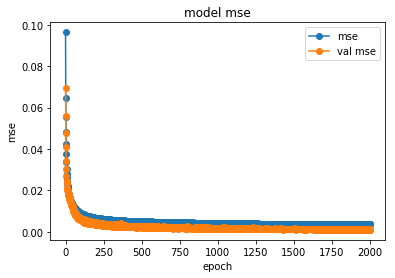

save the model


In [20]:
# -*- coding: utf-8 -*-
"""
Created on Tue Mar  7 15:43:18 2017

@author: hanar
"""
import time
import numpy as np
import os
from keras.utils import np_utils
from keras.models import Sequential
from keras.layers import Dense, Activation, Dropout
from keras.optimizers import SGD
from keras.optimizers import RMSprop
from keras.optimizers import Adagrad
from keras.optimizers import Adadelta
from keras.optimizers import Adam
from keras.optimizers import Adamax
from keras.optimizers import Nadam
from keras.callbacks import ModelCheckpoint
from keras.callbacks import EarlyStopping
from keras.callbacks import TensorBoard
from keras.models import load_model
#from keras.utils.visualize_util import plot
import matplotlib.pyplot as plt
import keras.callbacks
import keras.backend.tensorflow_backend as KTF
import tensorflow as tf

#Global variables for normalizing parameters
max_x = 1.0
min_x = 0.0
max_y = 1.0
min_y = 0.0


def deep_learning_tsunami(resdir, X_train_raw, y_train_raw, X_test_raw, y_test_raw,
                            _lr=0.02, _decay=0,
                            _validation_split=0.2, _batch_size=32,
                            _momentum=0.9, _nesterov=True,
                            num_layers=4, dropout=0.5,
                            node_num = 2500,
                            _epochs=2000):
    """
    Creating the inversion model of turbidity currents by deep learning
    """
    #Normalizing dataset
    X_train = get_normalized_data(X_train_raw, min_x, max_x)
    X_test = get_normalized_data(X_test_raw, min_x, max_x)
    y_train = get_normalized_data(y_train_raw, min_y, max_y)
    y_test = get_normalized_data(y_test_raw, min_y, max_y)
    
    #Generation of neural network model
    model = Sequential()
    model.add(Dense(node_num, input_dim=X_train.shape[1], activation='relu', kernel_initializer ='glorot_uniform'))#1st layer
    model.add(Dropout(dropout))
    for i in range(num_layers - 2):
        model.add(Dense(node_num, activation='relu', kernel_initializer ='glorot_uniform'))#2nd layer
        model.add(Dropout(dropout))
    model.add(Dense(y_train.shape[1], activation = 'relu', kernel_initializer ='glorot_uniform')) #last layer
    
    #Compiling the model
    model.compile(loss="mean_squared_error", 
              optimizer=SGD(lr=_lr, decay=_decay, momentum=_momentum, nesterov=_nesterov),
              #optimizer=Adadelta(),
              metrics=["mean_squared_error"])    
    
    #Perform learning
    t = time.time()
    check = ModelCheckpoint("model3.hdf5")
    #es_cb = EarlyStopping(monitor='val_loss', patience=5, verbose=0, mode='auto')
    #tb_cb = TensorBoard(log_dir=resdir, histogram_freq=2, write_graph=True, write_images=True)
    history = model.fit(X_train, y_train, epochs=_epochs, 
                    validation_split=_validation_split, batch_size=_batch_size,
                    callbacks=[check])
    
    #Evaluate learning result
    loss_and_metrics = model.evaluate(X_test,y_test)
    print("\nloss:{} mse:{}".format(loss_and_metrics[0],loss_and_metrics[1]))
    
    print("Elapsed time: {:.1f} sec.".format(time.time()-t))
    
    #Visualize learning result   
    #plot(model, to_file="model.png", show_shapes=True, show_layer_names=True)

    # model The state of change when letting you learnplot
    plot_history(history)
    
    return model, history

def apply_model(model, X, min_x, max_x, min_y, max_y):
    """
    Apply model
    Maximum and minimum values ​​of X and Y are required to normalize
    """
    X_norm =  (X - min_x) / (max_x - min_x)
    Y_norm = model.predict(X_norm)
    Y = Y_norm*(max_y - min_y)+min_y
    return Y

def plot_history(history):
    # Plot accuracy history
    plt.plot(history.history['mean_squared_error'],"o-",label="mse")
    plt.plot(history.history['val_mean_squared_error'],"o-",label="val mse")
    plt.title('model mse')
    plt.xlabel('epoch')
    plt.ylabel('mse')
    plt.legend(loc="upper right")
    plt.show()

#    # 損失の履歴をプロット
#    plt.plot(history.history['loss'],"o-",label="loss",)
#    plt.plot(history.history['val_loss'],"o-",label="val_loss")
#    plt.title('model loss')
#    plt.xlabel('epoch')
#    plt.ylabel('loss')
#    plt.legend(loc='upper right')
#    plt.show()

def test_model(model, x_test):
    #Test the results
    
    x_test_norm = get_normalized_data(x_test, min_x, max_x)
    test_result_norm = model.predict(x_test_norm)
    test_result = get_raw_data(test_result_norm, min_y, max_y)
    
    return test_result


def save_result(savedir, model, history, test_result):
    
    
    np.savetxt(savedir + 'test_result.txt',test_result,delimiter=',')
    np.savetxt(savedir+'loss.txt',history.history.get('loss'),delimiter=',')
    np.savetxt(savedir+'val_loss.txt',history.history.get('val_loss'),delimiter=',')
    
    #Serialize model and save
    print('save the model')
    model.save(savedir + 'model3.hdf5')

def load_data(datadir):
    """
    This function load training and test data sets, and returns variables
    """
    global min_x, max_x, min_y, max_y
    
    x_train = np.loadtxt(datadir + 'x_train.txt',delimiter=',')
    x_test = np.loadtxt(datadir + 'x_test.txt',delimiter=',')
    y_train = np.loadtxt(datadir + 'icond_train.txt',delimiter=',')
    y_test = np.loadtxt(datadir + 'icond_test.txt',delimiter=',')
    min_y = np.loadtxt(datadir + 'icond_min.txt',delimiter=',')
    max_y = np.loadtxt(datadir + 'icond_max.txt',delimiter=',')
    [min_x, max_x] = np.loadtxt(datadir + 'x_minmax.txt',delimiter=',')
    
    return x_train, y_train, x_test, y_test

def set_minmax_data(_min_x, _max_x, _min_y, _max_y):
    global min_x, max_x, min_y, max_y
    
    min_x, max_x, min_y, max_y = _min_x, _max_x, _min_y, _max_y
    return
    


def get_normalized_data(x, min_val, max_val):
    """
    Normalizing the training and test dataset
    """
    x_norm = (x - min_val) / (max_val - min_val)
    
    return x_norm

def get_raw_data(x_norm, min_val, max_val):
    """
    Get raw data from the normalized dataset
    """
    x = x_norm * (max_val - min_val) + min_val
    
    return x

if __name__ == "__main__":
    
    #Reading data  
    datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi3400/'
    resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi3400/'
    if not os.path.exists(resdir):
        os.mkdir(resdir)
    
    x_train, y_train, x_test, y_test = load_data(datadir)
    
     
    #Execution of learning
    testcases = [4500]
    for i in range(len(testcases)):
        resdir_case = resdir + '{}/'.format(testcases[i])        
        if not os.path.exists(resdir_case):
            os.mkdir(resdir_case)
        x_train_sub = x_train[0:testcases[i],:]
        y_train_sub = y_train[0:testcases[i],:]
        model, history = deep_learning_tsunami(resdir_case, x_train_sub, y_train_sub, x_test, y_test, num_layers=5)
        #Verify and save results
        result = test_model(model, x_test)
        save_result(resdir_case,model,history,result)




(500, 9)


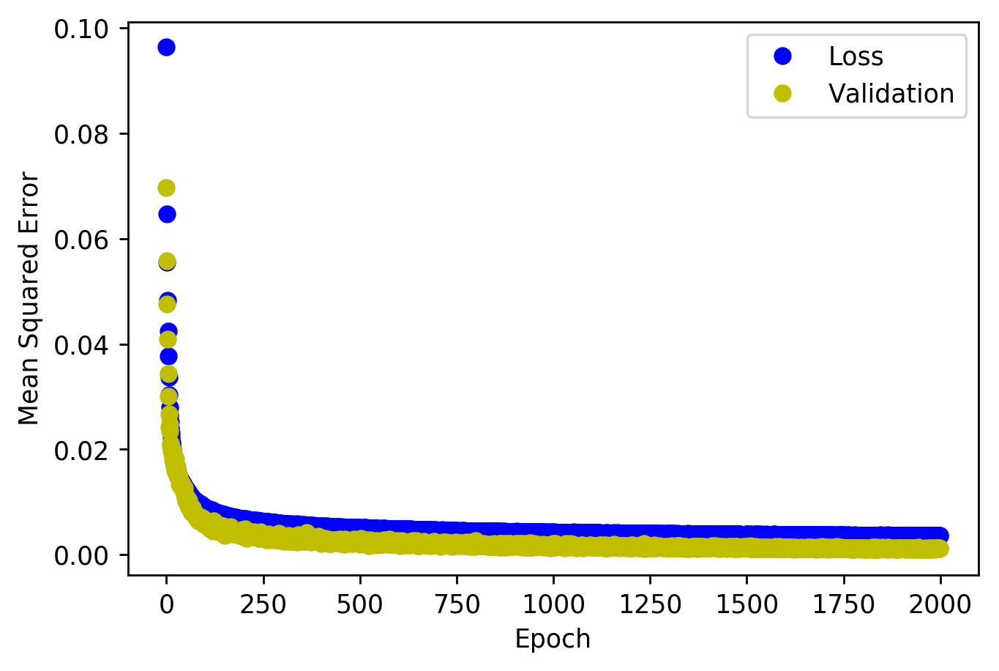

<Figure size 432x288 with 0 Axes>

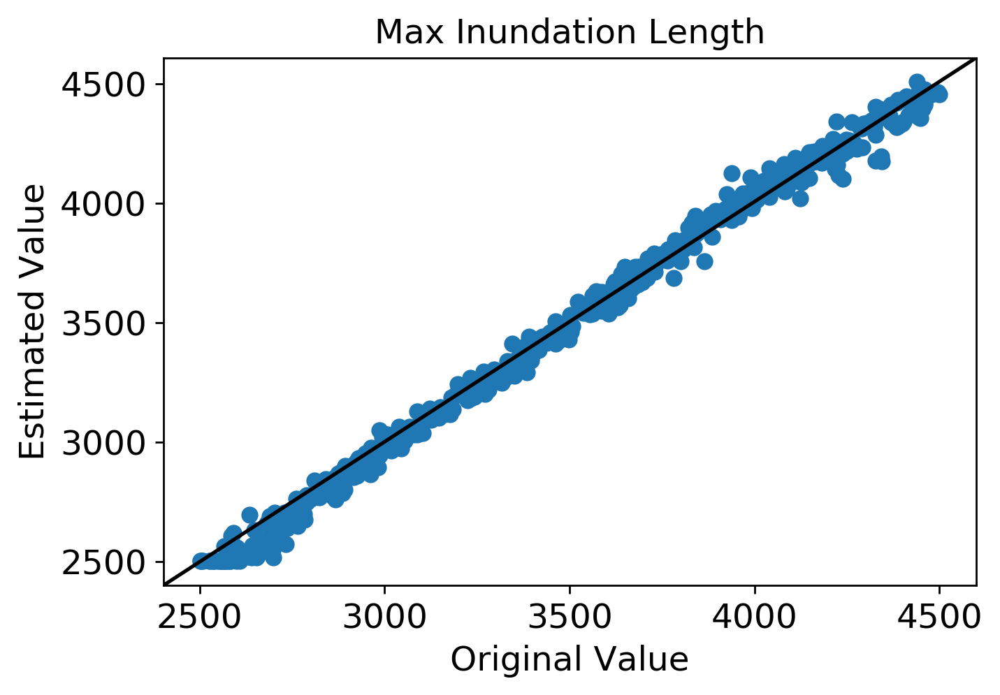

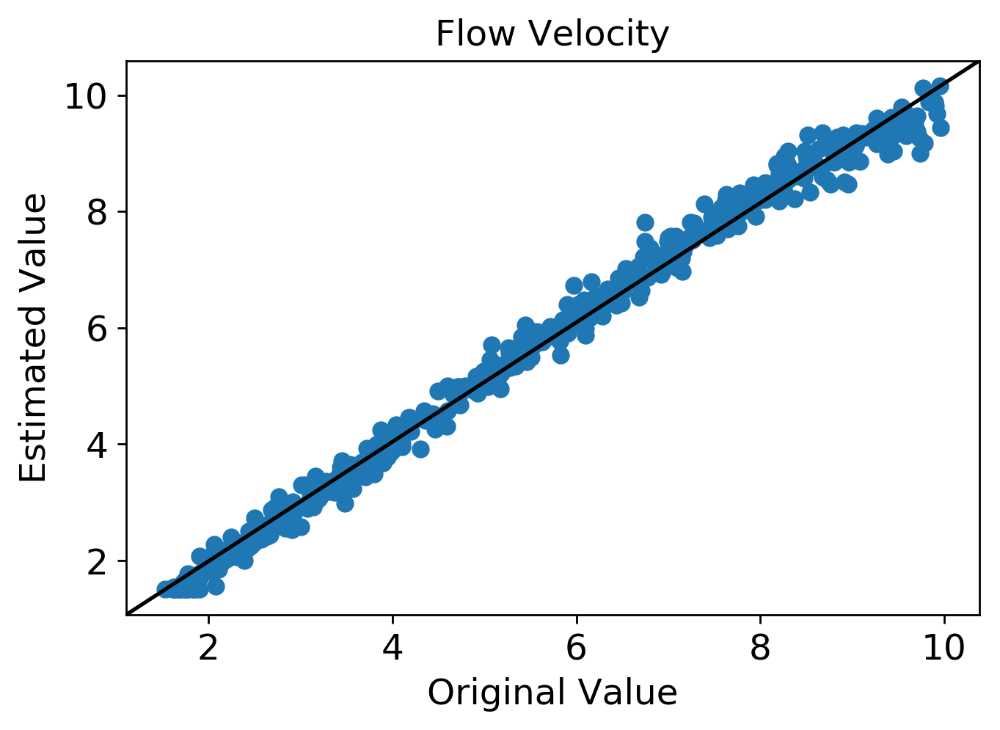

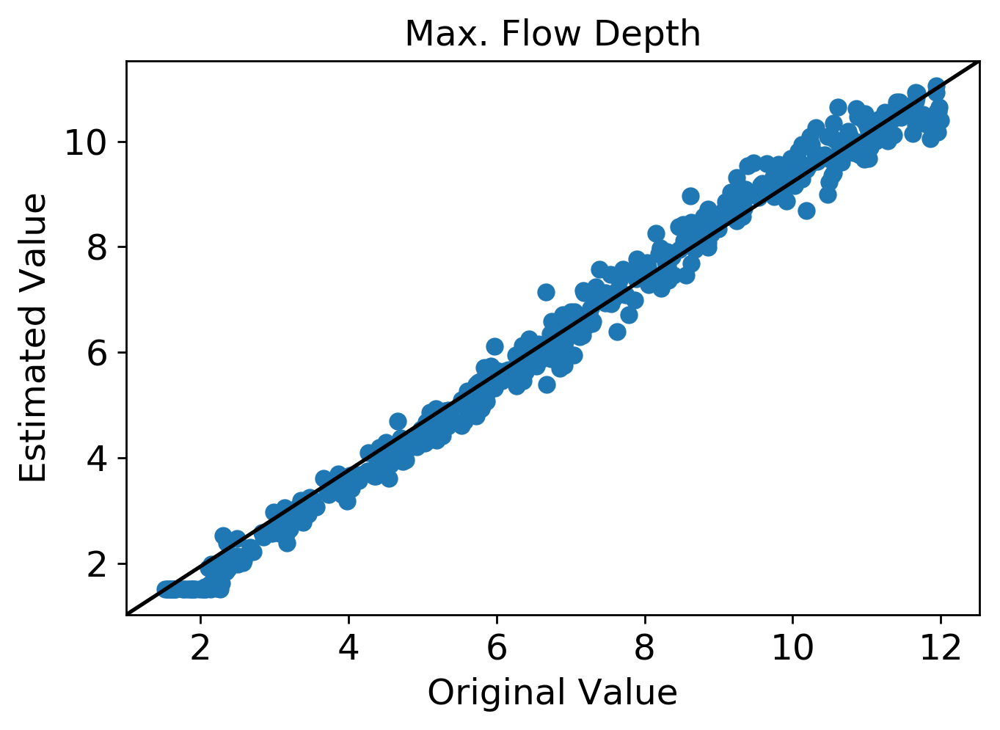

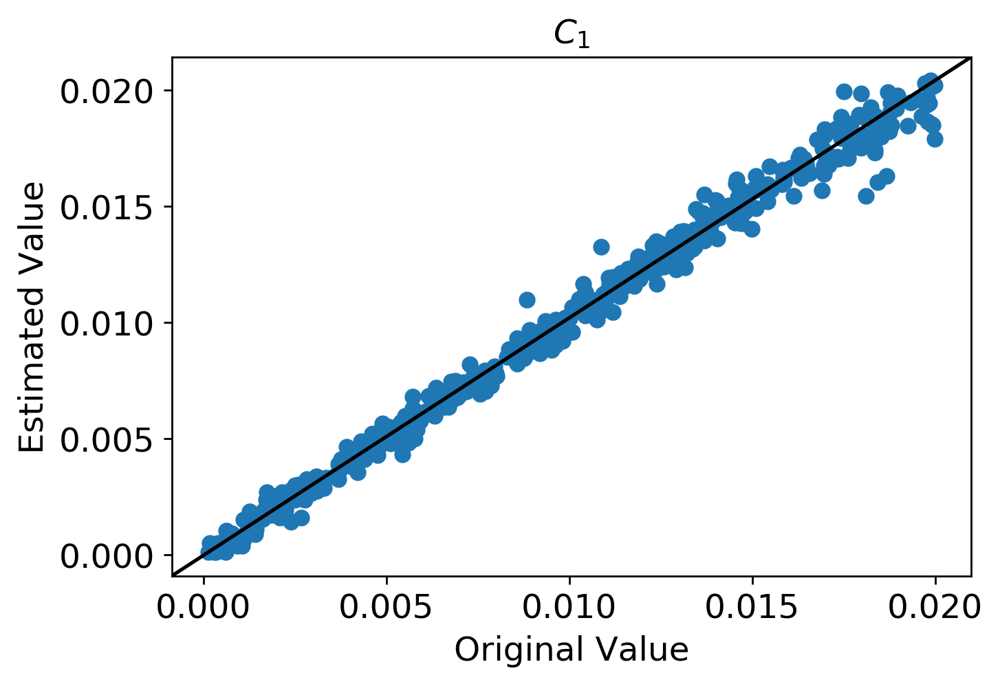

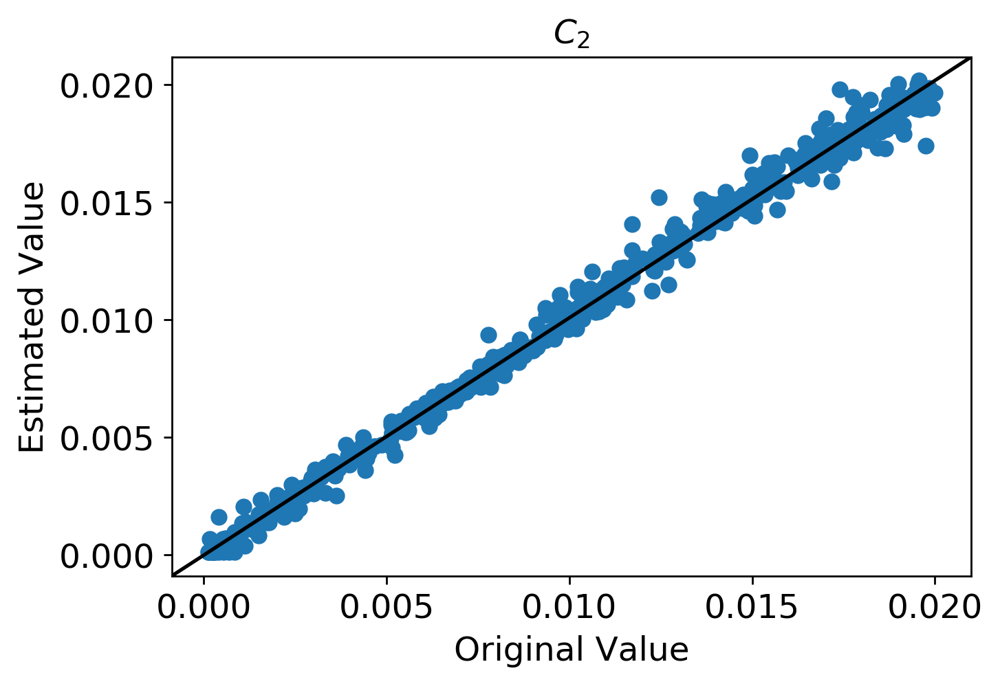

...

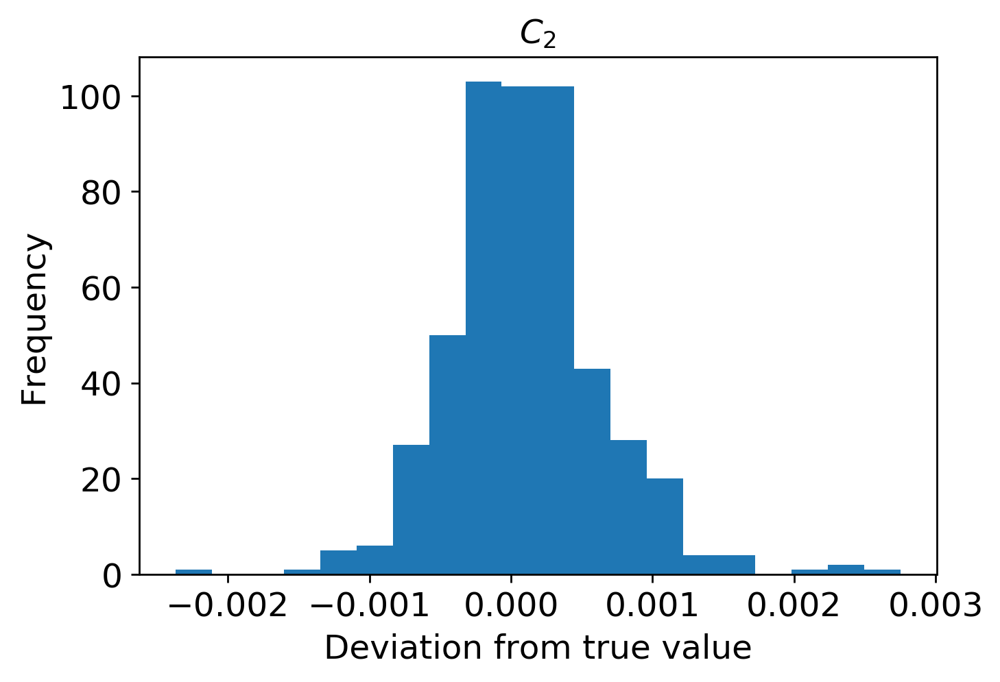

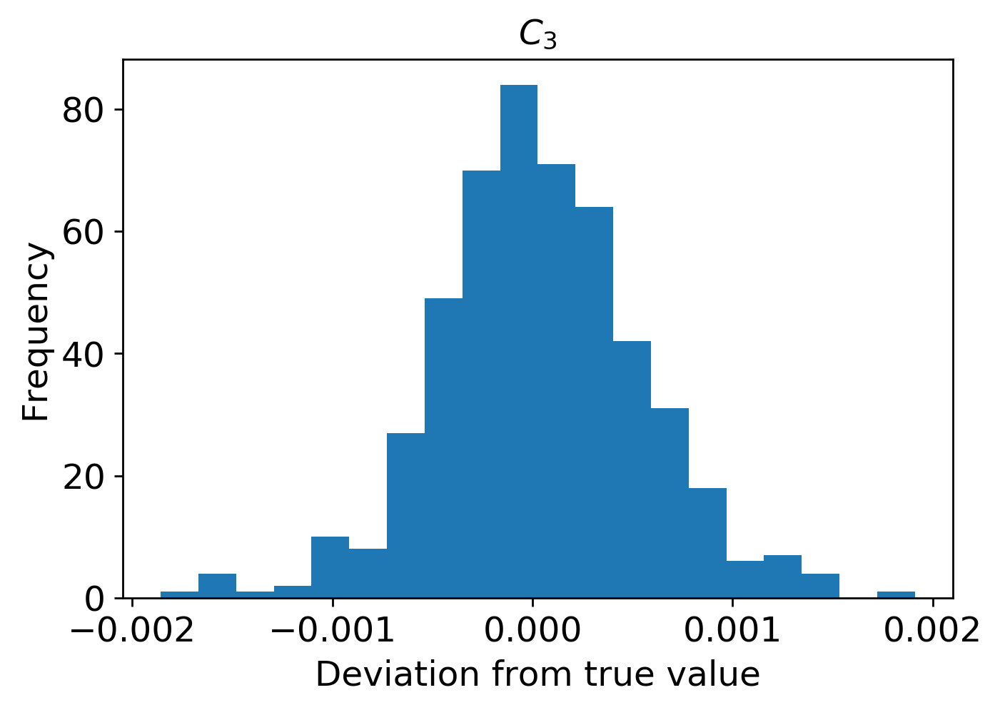

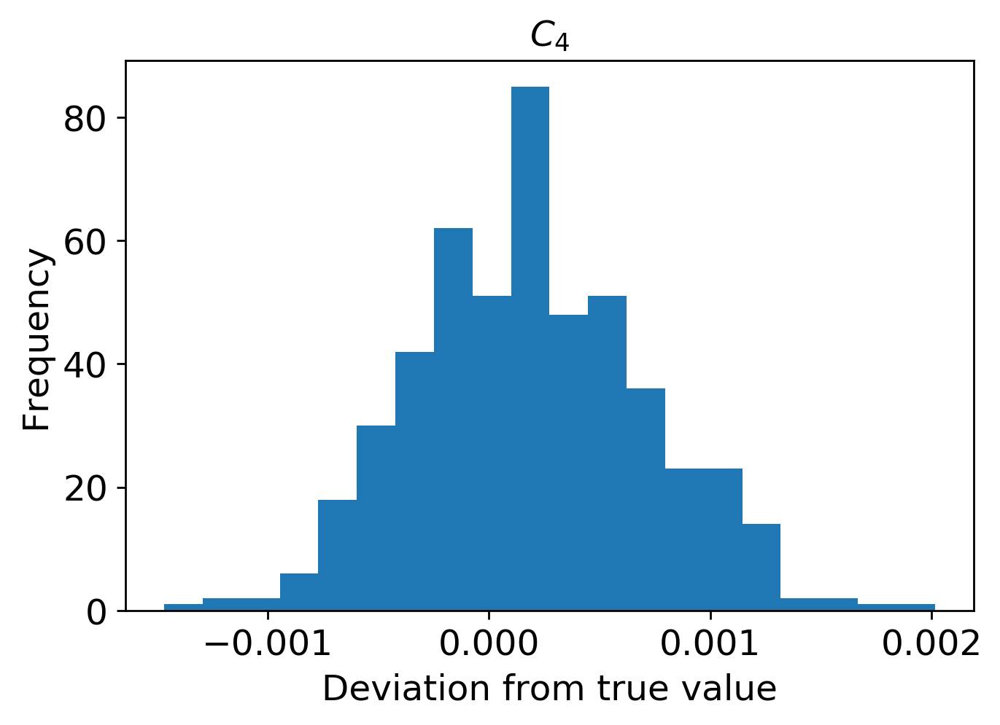

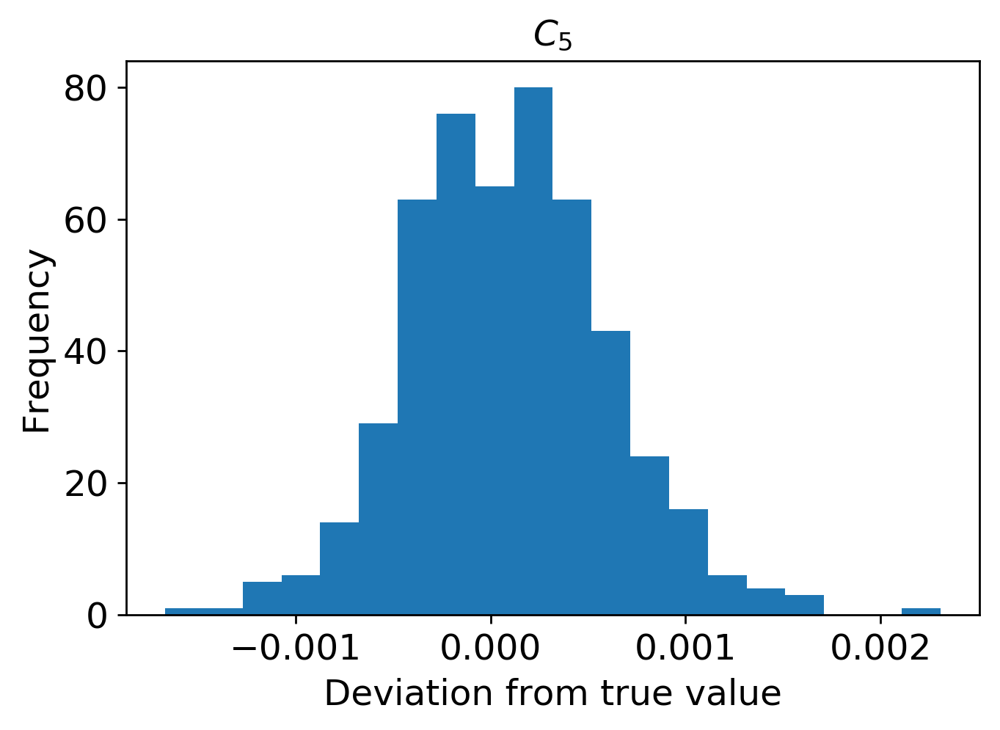

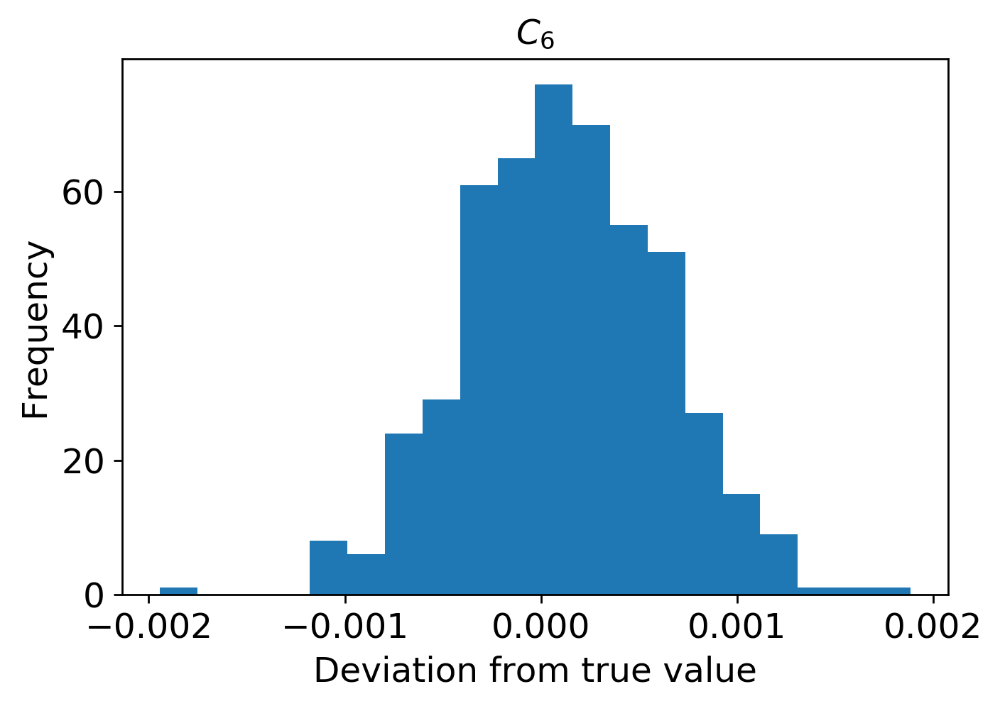

In [21]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi3400/'
resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi3400/4500/'

test_result = np.loadtxt(resdir + 'test_result.txt',delimiter=',')
icond = np.loadtxt(datadir + 'icond_test.txt',delimiter=',')
print(icond.shape)
loss = np.loadtxt(resdir+'loss.txt',delimiter=',')
epoch = range(0,2000)
vloss = np.loadtxt(resdir+'val_loss.txt',delimiter=',')
resi = test_result - icond

fig = plt.figure(num=None,dpi=250, facecolor='w', edgecolor='k')
plt.plot(epoch, loss, 'bo',label='Loss')
plt.plot(epoch, vloss, 'yo',label='Validation')
plt.xlabel('Epoch')
plt.ylabel('Mean Squared Error')
plt.legend(loc="upper right")
plt.savefig(resdir+ 'mse.eps')
plt.show()

fig2 = plt.figure()
hfont = {'fontname':'Century Gothic'}
textcol = 'k'
titlelabel = ['Max Inundation Length','Flow Velocity', 'Max. Flow Depth', '$C_1$', '$C_2$', '$C_3$', '$C_4$','$C_5$','$C_6$']


    
for i in range(len(titlelabel)):
    plt.figure(num=None,dpi=250, facecolor='w', edgecolor='k')
    plt.plot(icond[:,i],test_result[:,i],"o")
    x=icond[:,i]
    y=test_result[:,i]
    y_lim = plt.ylim()
    x_lim = plt.xlim()
    plt.plot(x_lim, y_lim, 'k-', color = 'k')
    plt.ylim(y_lim)
    plt.xlim(x_lim)
    plt.xlabel('Original Value',color=textcol,size=14,**hfont)
    plt.ylabel('Estimated Value',color=textcol,size=14,**hfont)
    plt.title(titlelabel[i],color=textcol,size=14,**hfont)
    plt.tick_params(labelsize=14,colors=textcol)
    plt.savefig(resdir+titlelabel[i] + '.eps')
    #plt.show()

for i in range(len(titlelabel)):
    plt.figure(num=None,dpi=250, facecolor='w', edgecolor='k')
    plt.hist(resi[:,i],bins=20)
    plt.title(titlelabel[i],color=textcol,size=14,**hfont)
    plt.xlabel('Deviation from true value',color=textcol,size=14,**hfont)
    plt.ylabel('Frequency',color=textcol,size=14,**hfont)
    plt.tick_params(labelsize=14,colors=textcol)
    plt.savefig(resdir+titlelabel[i] + 'hist' + '.eps')
    plt.show()

       distance        g1        g2        g3        g4        g5        g6
0      0.000000  0.036771  0.167260  0.114845  0.008449  0.002190  0.005161
1    103.794102  0.000000  0.075200  0.153283  0.013753  0.001885  0.000442
2    171.620654  0.002130  0.051171  0.084309  0.006218  0.001867  0.002843
3    397.112167  0.003115  0.016359  0.078858  0.011466  0.000597  0.000054
4    595.912969  0.000732  0.016896  0.028720  0.002661  0.000914  0.000000
5    707.625749  0.000143  0.002228  0.005502  0.000900  0.000187  0.000104
6    796.435078  0.000236  0.004337  0.021204  0.003169  0.000309  0.000080
7    895.065500  0.001688  0.016059  0.081413  0.020284  0.006824  0.004628
8    988.394177  0.004567  0.008166  0.074658  0.016913  0.002424  0.001580
9   1081.819325  0.001567  0.016305  0.060234  0.011086  0.004165  0.001994
10  1195.756993  0.001022  0.002370  0.017565  0.004194  0.000567  0.000142
11  1290.372534  0.000000  0.004121  0.057974  0.014565  0.000426  0.000213
12  1400.896

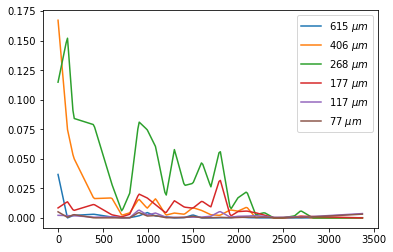

In [22]:
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.models import load_model
from scipy import stats
from scipy.interpolate import interp1d 
import pandas as pd
from pykrige import OrdinaryKriging as OK
import ipdb


datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi3400/'
resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi3400/4500/'
#Initial setting
if not "model" in locals(): 
    model = load_model(resdir+'model3.hdf5')
#gclass = 3
#gclass_label = ["500 $\mu$m","125 $\mu$m","63 $\mu$m"]
gclass = 6
gclass_label = ["615 ${\mu}m$","406 ${\mu}m$","268 ${\mu}m$","177 ${\mu}m$", "117 ${\mu}m$","77 ${\mu}m$"]
topodx = 15.0
coord_num = int(model.layers[0].input_shape[1]/gclass)

#Acquires a value for normalizing input data to [0, 1]
min_x, max_x = np.loadtxt(datadir + 'x_minmax.txt',delimiter=',')
y_min = np.loadtxt(datadir + 'icond_min.txt',delimiter=',')
y_max = np.loadtxt(datadir + 'icond_max.txt',delimiter=',')

#Read outcrop data
#dist_max = 22000. #Distance of distal end of learning data
outcrop = pd.read_csv('../FITTNUSS-forward_training_DNN/sendai_increased_class_edit.csv')
#outcrop = pd.read_csv('../DeepLearningTurbidite_Fukuda/GA_naruse_v2.csv')
#outcrop = outcrop.append(pd.DataFrame([[0,'Loc0',0,0,0],[dist_max,'LocE',0,0,0]], columns=outcrop.columns))
outcrop = outcrop.sort_values('distance')
outcrop['distance'] = outcrop['distance'] - 0
#d = pd.DataFrame(np.zeros((1, 7)),columns=['distance', 'g1','g2','g3','g4','g5','g6'])
#print(d)
#v=np.concatenate((outcrop, d))
#print(v)
#outcrop=pd.DataFrame(v,columns=['distance', 'g1','g2','g3','g4','g5','g6'])
#outcrop['distance'].iloc[-1]=4000
#outcrop = outcrop.append(pd.DataFrame([[0,'Loc0',0,0,0,0]], columns=outcrop.columns))
print(outcrop)

#Preparation under interpolation
thick_interp = np.zeros([1,coord_num*gclass])#補間されたサンプル厚さデータ
outcrop_x_id = np.round(outcrop['distance']/topodx).astype(np.int32) #逆解析システムでのサンプリング地点のindex番号
x = np.arange(0,coord_num*topodx,topodx)

#Complement data
for j in range(gclass):
    f = interp1d(outcrop['distance'],outcrop.iloc[:,j+1], kind="linear",bounds_error=False,fill_value='extrapolate')
    #f = interp1d(outcrop['distance'],outcrop.iloc[:,j+2], kind="linear",bounds_error=False,fill_value='extrapolate') 
    #Interpolation function of jth granularity level
    thick_interp[0,coord_num*j:coord_num*(j+1)] = f(x) #Supplemented data

#ipdb.set_trace()
#Kriging Interpolation by
#vparams = np.array([[0.035, 10000., 0.001],[0.006, 10000., 0.002],[0.005, 10000., 0.002],[0.035, 10000., 0.001]])
#for j in range(gclass):
    #okip = OK(outcrop['distance'],np.zeros(outcrop['distance'].shape),outcrop.iloc[:,j+1],variogram_model='gaussian',)
    #okip.display_variogram_model()
    #ipdata, ipstd = okip.execute('grid',x,np.array([0.]))
    #ipdata = np.squeeze(ipdata)
    #thick_interp[0,coord_num*j:coord_num*(j+1)] = ipdata #Assign complemented d

#Normalize data
thick_interp[thick_interp < 0] = 0
thick_interp_norm =  (thick_interp - min_x) / (max_x - min_x)

#Perform inverse analysis
test_result_outcrop = model.predict(thick_interp_norm)
test_result_outcrop = test_result_outcrop * (y_max - y_min) + y_min
print(test_result_outcrop)
#add=np.array(3000)
#test_result_outcrop_add=np.concatenate((add,test_result_outcrop), axis=None)
#Output results
#print(test_result_outcrop_add)
np.savetxt('outcrop_result_g6_g300_H_5000_20_11_roi3400.txt',test_result_outcrop, delimiter=',')
for i in range(len(gclass_label)):
    plt.plot(x,thick_interp[0,coord_num * i:coord_num * (i+1)],label=gclass_label[i])
plt.legend()
plt.show()



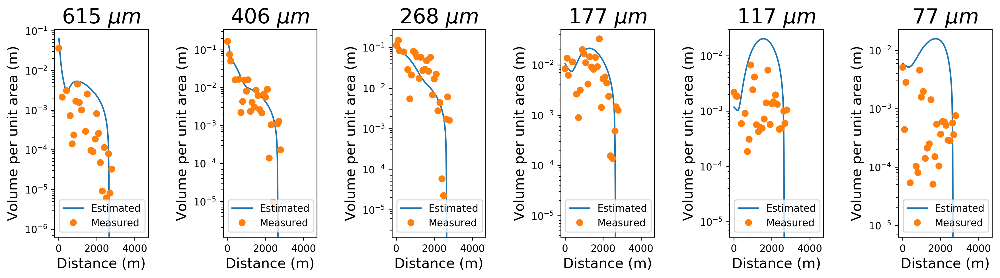

In [23]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import Forward_model_modified_FITTNUSS_5000_g6_300grid_19_11_case2 as fmodel
import time
import ipdb
%matplotlib inline

#Basic setting

#dist_max = 3000.
gclass = 6
topodx=15.0
gclass_name = ['615microm','406microm','268microm','177microm','117microm','77microm']
#gclass_name = ['500micron', '125micron', '63micron']
gname_tex = ["615 ${\mu}m$","406 ${\mu}m$","268 ${\mu}m$","177 ${\mu}m$", "117 ${\mu}m$","77 ${\mu}m$"]
#gname_tex = ['500 $\mu$m','125 $\mu$m','63 $\mu$m']
#calcdir = 'home/rimali2009/FITTNUSS-forward_training_DNN/'
#calcdir = '/home/naruse/Documents/Documents/MATLAB/TCtrainData_forML/TCModel_for_MLTEST/test_output_otadai07/'

#Load estimate
#H1 = np.loadtxt(calcdir + 'H1.txt',delimiter=',')
#H2 = np.loadtxt(calcdir + 'H2.txt',delimiter=',')
#H3 = np.loadtxt(calcdir + 'H3.txt',delimiter=',')
#H4 = np.loadtxt(calcdir + 'H4.txt',delimiter=',')
#Ht = np.loadtxt(calcdir + 'Ht.txt',delimiter=',')
#U = np.loadtxt(calcdir + 'U.txt',delimiter=',')
#xi = np.loadtxt(calcdir + 'xi.txt',delimiter=',')
#x = np.loadtxt(calcdir + 'x.txt',delimiter=',')
#x_bed = np.loadtxt(calcdir + 'x_init.txt',delimiter=',')
#eta_init = np.loadtxt(calcdir + 'eta_init.txt',delimiter=',')
#Ct = np.loadtxt(calcdir + 'Ct.txt',delimiter=',')
#time = np.loadtxt(calcdir + 'time.txt',delimiter=',')
estimated_icond=np.loadtxt('outcrop_result_g6_g300_H_5000_20_11_roi3400.txt', delimiter=',')
start = time.time()
fmodel.read_setfile("config_g6_300grid_19_11_case2.ini")
(x,C,x_dep,deposit) = fmodel.forward(estimated_icond)
np.savetxt('eta_estimated_thickness_5K_g6_TC4_Rwcnst_H_5000_20_11_roi3400.csv', deposit, delimiter=',')
np.savetxt('eta_estimated_Distance_5K_g6_TC4_Rwcnst_H_5000_20_11_roi3400.csv', x_dep,delimiter=',')
estimated_dep_thickness_5000=np.transpose(np.loadtxt('/home/rimali2009/FITTNUSS-forward_training_DNN/'+'eta_estimated_thickness_5K_g6_TC4_Rwcnst_H_5000_20_11_roi3400.csv', delimiter=','))
estimated_dep_thickness_5000=pd.DataFrame(estimated_dep_thickness_5000,columns=['615microm','406microm','268microm','177microm','117microm','77microm'])
estimated_dep_distance_5000=np.transpose(np.loadtxt('/home/rimali2009/FITTNUSS-forward_training_DNN/'+'eta_estimated_Distance_5K_g6_TC4_Rwcnst_H_5000_20_11_roi3400.csv', delimiter=','))
estimated_dep_distance_5000=pd.DataFrame(estimated_dep_distance_5000,columns=['distance'])
estimated_dep_5000=pd.concat([estimated_dep_distance_5000,estimated_dep_thickness_5000],axis=1)
np.savetxt('estimated_dep_5K_g6_TC4_Rwcnst_H_5000_20_11_roi3400.csv',estimated_dep_5000,delimiter=',')
#data_estim=pd.DataFrame(estimated_dep_5000,columns=['distance','1.5phi','2.5phi','3.5phi','4.5phi'])

#Formatting the loaded data
#estimated_dep_df = pd.DataFrame(estimated_dep,columns=['distance','1.5phi','2.5phi','3.5phi','4.5phi'])
#estimated_dep = pd.DataFrame(np.array([x_bed - dist_offset,H1[-1,:],H2[-1,:],H3[-1,:]]).T,columns=['distance','500micron','125micron','63micron'])
estimated_dep_5000= estimated_dep_5000.query('distance > 0')
#estimated_dep_5000 = estimated_dep_5000.query('distance < {}'.format(dist_max))

#Read original data
outcrop = pd.read_csv('../FITTNUSS-forward_training_DNN/sendai_increased_class.csv')
outcrop= pd.DataFrame(outcrop,columns=['distance','615microm','406microm','268microm','177microm','117microm','77microm'])
#outcrop = pd.read_csv('../DeepLearningTurbidite_Fukuda/GA_naruse_v2.csv')
#outcrop = outcrop.append(pd.DataFrame([[0,'Loc0',0,0,0],[dist_max,'LocE',0,0,0]], columns=outcrop.columns))
#outcrop = outcrop.sort_values('distance')
#outcrop['distance'] = outcrop['distance'] - 1000

#Plot
plt.figure(num=None, figsize=(17, 4), dpi=250, facecolor='w', edgecolor='g')
hfont = {'fontname':'Sans'}
plt.subplots_adjust(bottom=0.15, wspace=0.8)

for i in range(gclass):
    plt.subplot(1,gclass,i+1)
    plt.plot(estimated_dep_5000['distance'],estimated_dep_5000[gclass_name[i]],'-', label='Estimated')
    plt.plot(outcrop['distance'], outcrop[gclass_name[i]],'o', label='Measured')
    plt.yscale('log')
    plt.title(gname_tex[i], size=21,**hfont)
    plt.xlabel('Distance (m)', size = 14, **hfont)
    plt.ylabel('Volume per unit area (m)', size = 14, **hfont)
    plt.legend(fontsize=10)
    plt.savefig("thickness_distance_curve_5000_g6_300grid_H_5000_20_11_roi3400.png")
    plt.savefig("thickness_distance_curve_5000_g6_300grid_H_5000_20_11_roi3400.eps")
plt.show()



Using TensorFlow backend.


       distance        g1        g2        g3        g4        g5        g6
0      0.000000  0.036771  0.167260  0.114845  0.008449  0.002190  0.005161
1    103.794102  0.000000  0.075200  0.153283  0.013753  0.001885  0.000442
2    171.620654  0.002130  0.051171  0.084309  0.006218  0.001867  0.002843
3    397.112167  0.003115  0.016359  0.078858  0.011466  0.000597  0.000054
4    595.912969  0.000732  0.016896  0.028720  0.002661  0.000914  0.000000
5    707.625749  0.000143  0.002228  0.005502  0.000900  0.000187  0.000104
6    796.435078  0.000236  0.004337  0.021204  0.003169  0.000309  0.000080
7    895.065500  0.001688  0.016059  0.081413  0.020284  0.006824  0.004628
8    988.394177  0.004567  0.008166  0.074658  0.016913  0.002424  0.001580
9   1081.819325  0.001567  0.016305  0.060234  0.011086  0.004165  0.001994
10  1195.756993  0.001022  0.002370  0.017565  0.004194  0.000567  0.000142
11  1290.372534  0.000000  0.004121  0.057974  0.014565  0.000426  0.000213
12  1400.896

       distance        g1        g2        g3        g4        g5        g6
0      0.000000  0.036771  0.167260  0.114845  0.008449  0.002190  0.005161
1    103.794102  0.000000  0.075200  0.153283  0.013753  0.001885  0.000442
2    171.620654  0.002130  0.051171  0.084309  0.006218  0.001867  0.002843
3    397.112167  0.003115  0.016359  0.078858  0.011466  0.000597  0.000054
4    595.912969  0.000732  0.016896  0.028720  0.002661  0.000914  0.000000
5    707.625749  0.000143  0.002228  0.005502  0.000900  0.000187  0.000104
6    895.065500  0.001688  0.016059  0.081413  0.020284  0.006824  0.004628
7    988.394177  0.004567  0.008166  0.074658  0.016913  0.002424  0.001580
8   1081.819325  0.001567  0.016305  0.060234  0.011086  0.004165  0.001994
9   1195.756993  0.001022  0.002370  0.017565  0.004194  0.000567  0.000142
10  1290.372534  0.000000  0.004121  0.057974  0.014565  0.000426  0.000213
11  1400.896519  0.000295  0.003096  0.027406  0.009121  0.000502  0.000251
12  1495.352

/home/rimali2009/anaconda3/envs/test3/lib/python3.6/site-packages/matplotlib/font_manager.py:1241: UserWarning: findfont: Font family ['Century Gothic'] not found. Falling back to DejaVu Sans.
  (prop.get_family(), self.defaultFamily[fontext]))


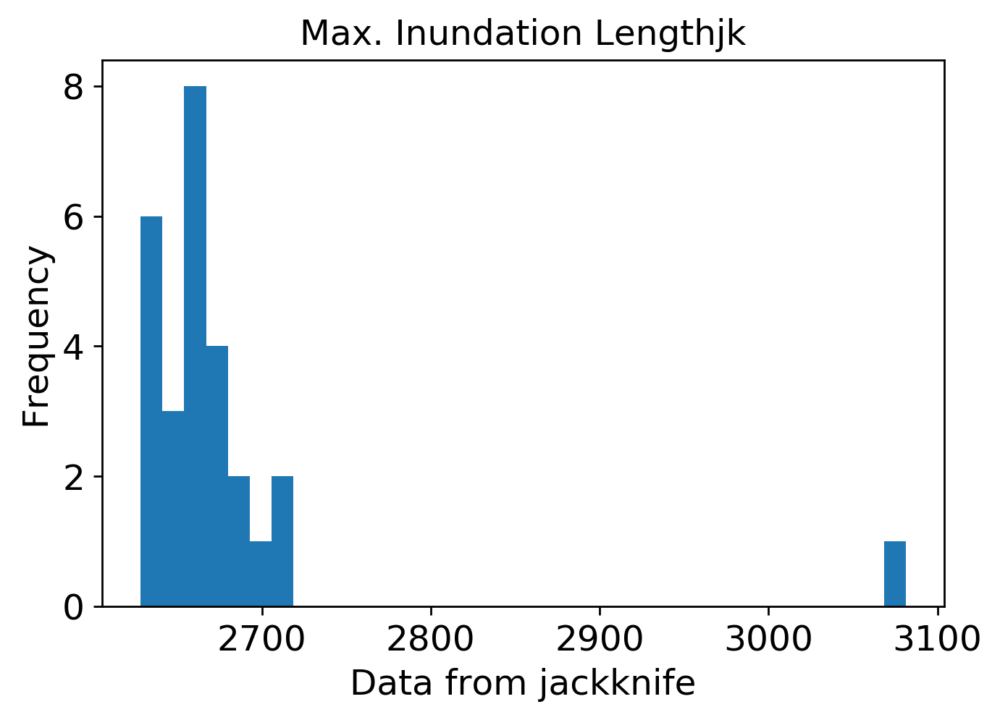

mean: 4.7508195471723695
jk_e: 0.07606273958723356


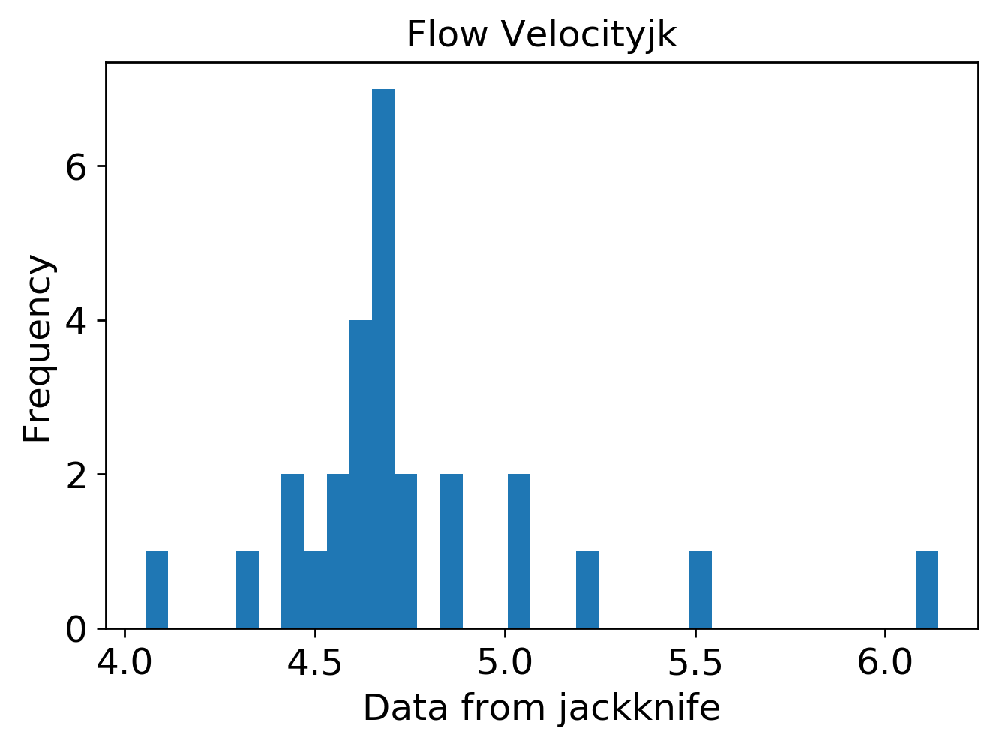

mean: 6.977236990186532
jk_e: 0.15886404340565627


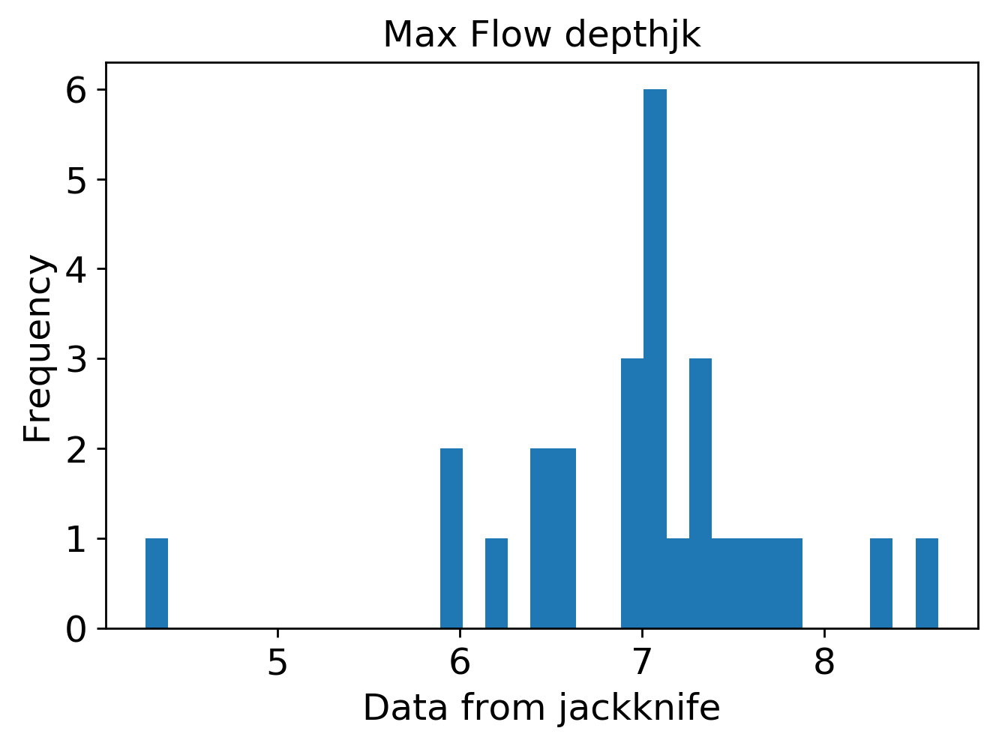

mean: 0.006106759722222484
jk_e: 0.00015569213836289032


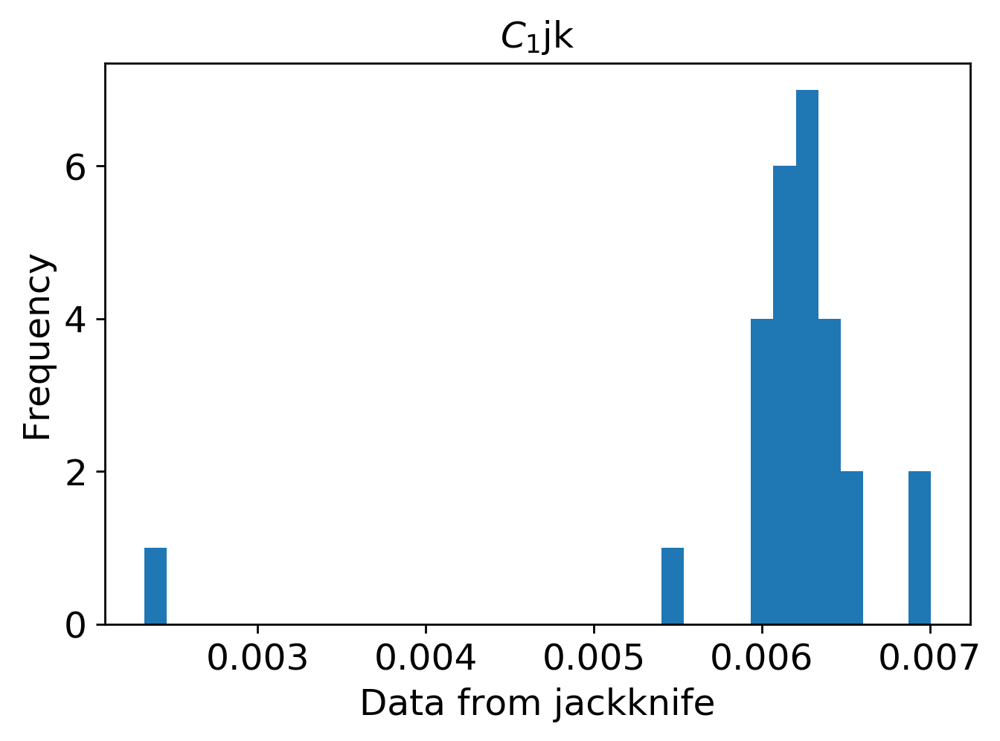

mean: 0.01835055065139142
jk_e: 0.00030851950635867156


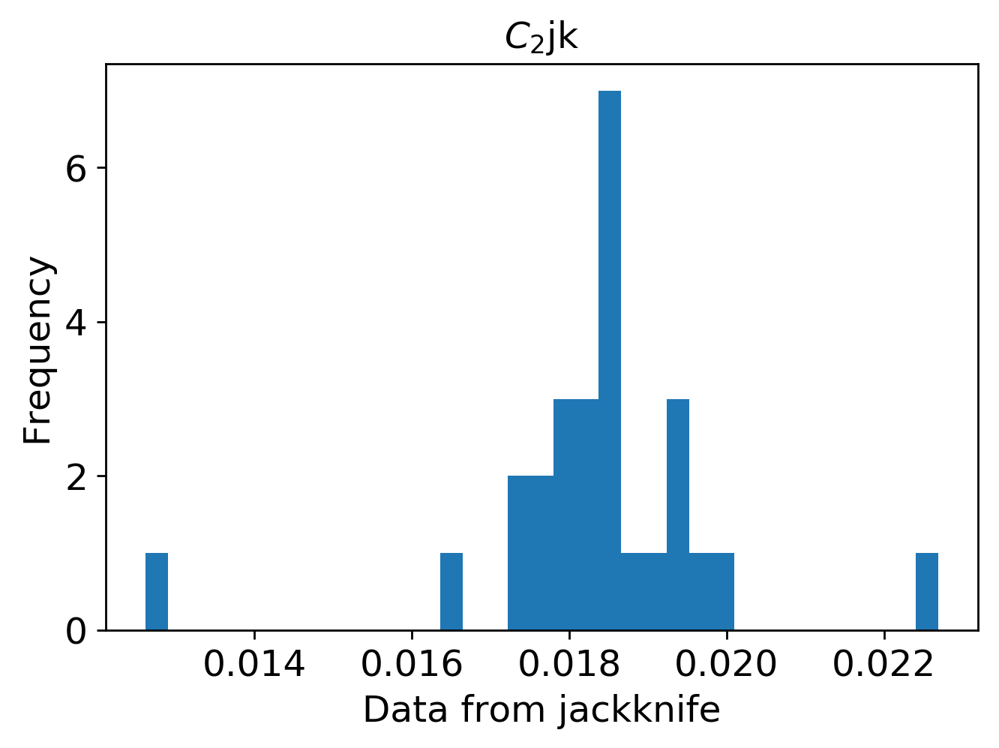

mean: 0.015156783021525722
jk_e: 0.00032683832284337067


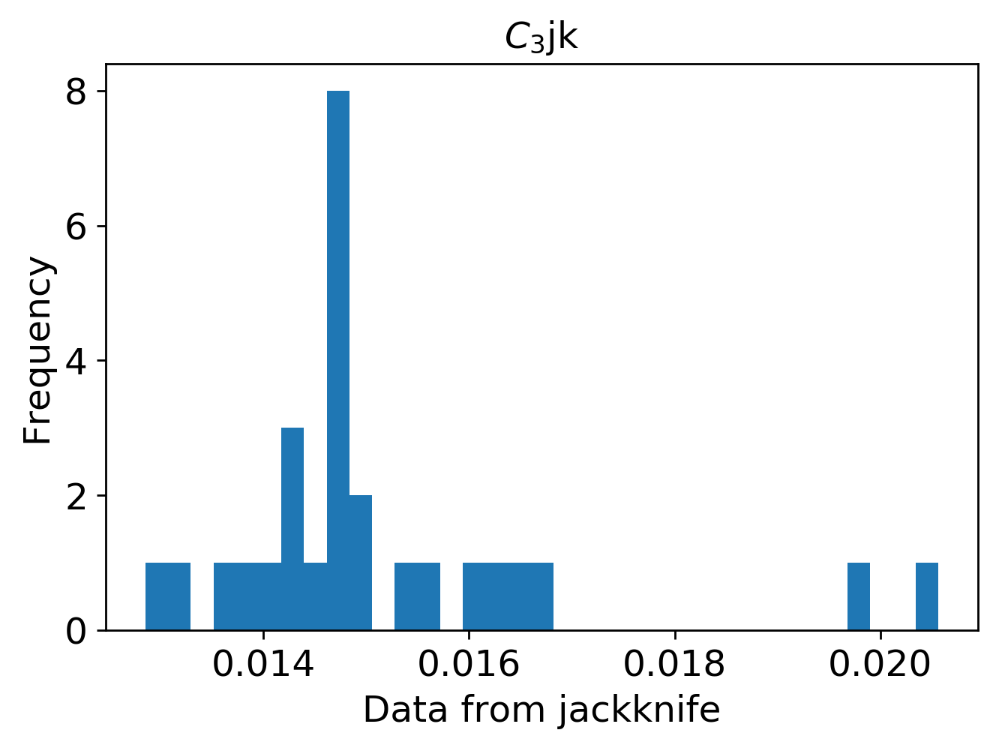

mean: 0.000977072842015812
jk_e: 4.277801993757082e-05


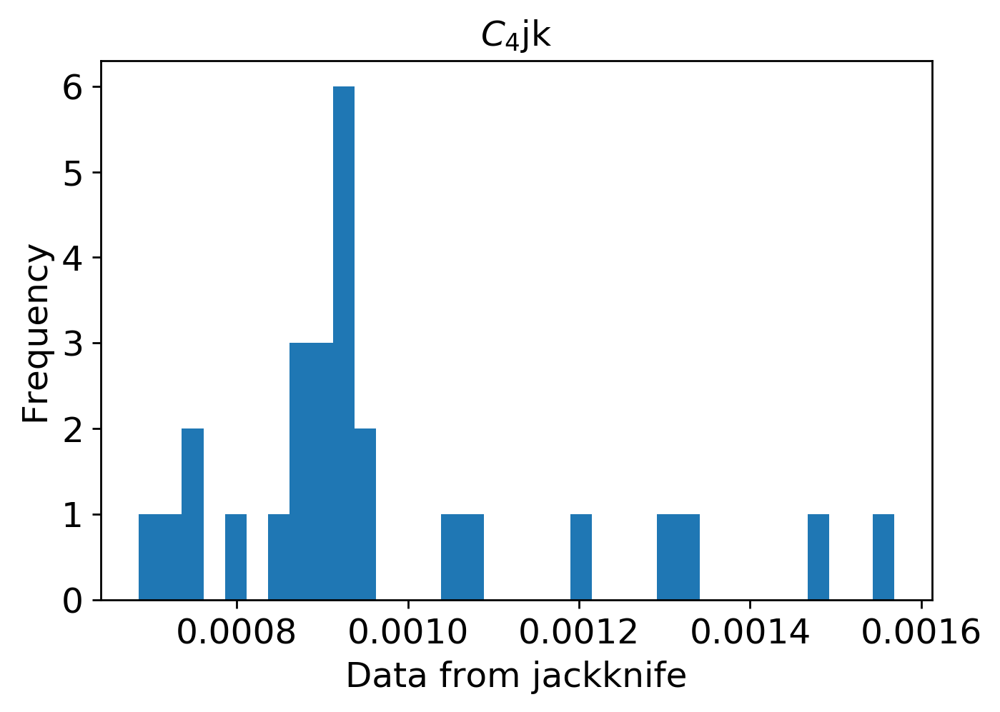

mean: 0.00013153260910729413
jk_e: 2.320573330252609e-05


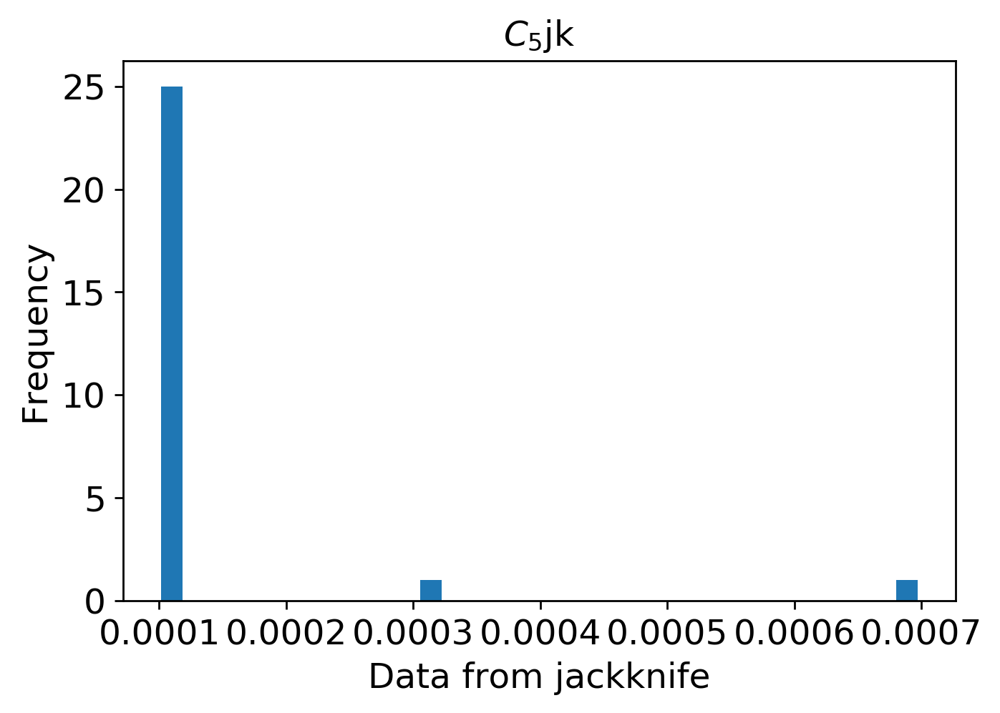

mean: 0.0005007892026915432
jk_e: 1.8115691312322978e-05


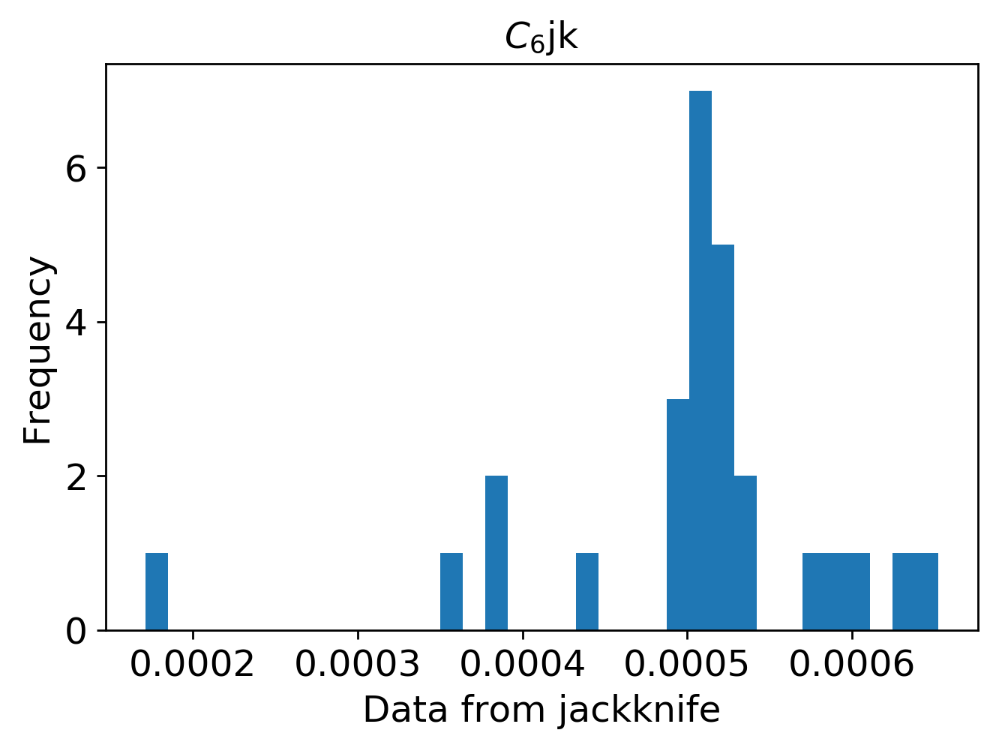

In [1]:
# Jackknife Method
import csv
import numpy as np
import pandas as pd
import math
from keras.models import load_model
from scipy.interpolate import interp1d
import matplotlib.pyplot as plt
%matplotlib inline

datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi3400/'
resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi3400/4500/'
# Initial setting
if not "model" in locals():
    model = load_model(resdir+'model3.hdf5')
gclass = 6
gclass_label = ["615 ${\mu}m$", "406 ${\mu}m$", "268 ${\mu}m$",
                "177 ${\mu}m$", "117 ${\mu}m$", "77 ${\mu}m$"]
topodx = 15.0
coord_num = int(model.layers[0].input_shape[1]/gclass)
min_x, max_x = np.loadtxt(datadir + 'x_minmax.txt', delimiter=',')
y_min = np.loadtxt(datadir + 'icond_min.txt', delimiter=',')
y_max = np.loadtxt(datadir + 'icond_max.txt', delimiter=',')


a = pd.read_csv(
    '../FITTNUSS-forward_training_DNN/sendai_increased_class_edit.csv', delimiter=',')
print(a)
y = pd.DataFrame()
output = []

with open('output_final_20_11_roi3400.csv', 'w') as outfile:

    # x=[]
    for index in range(len(a)):
        df = y.append(pd.read_csv(
            '../FITTNUSS-forward_training_DNN/sendai_increased_class_edit.csv', skiprows=[index+1]))
        print(df)
        df = df.sort_values('distance')
        thick_interp = np.zeros([1, coord_num*gclass])
        x = np.arange(0, coord_num*topodx, topodx)
        for j in range(gclass):
            # Interpolation function of jth granularity level
            f = interp1d(df['distance'], df.iloc[:, j+1],
                         kind="linear", bounds_error=False,fill_value='extrapolate')
            thick_interp[0, coord_num*j:coord_num*(j+1)] = f(x)
        thick_interp[thick_interp < 0] = 0
        thick_interp_norm = (thick_interp - min_x) / (max_x - min_x)
        test_result_outcrop = model.predict(thick_interp_norm)
        test_result_outcrop = test_result_outcrop * (y_max - y_min) + y_min
        print(test_result_outcrop.shape)
        print(test_result_outcrop)
    # output.append(test_result_outcrop)
        np.savetxt(outfile,test_result_outcrop, delimiter=',')
        # outfile.write('# New iteration\n')
hfont = {'fontname': 'Century Gothic'}
textcol = 'k'
resi = np.loadtxt('output_final_20_11_roi3400.csv', delimiter=',')
titlelabel = ['Max. Inundation Lengthjk','Flow Velocityjk', 'Max Flow depthjk',
              '$C_1$jk', '$C_2$jk', '$C_3$jk', '$C_4$jk', '$C_5$jk', '$C_6$jk']
jk_er=[]
with open('jk_e_roi3400.txt','wb') as ftext:
    for i in range(len(titlelabel)):
        plt.figure(num=None, dpi=250, facecolor='w', edgecolor='k')
        plt.hist(resi[:, i], bins=35)
        mean = sum(resi[:,i]) / len(resi[:,i])
        print("mean:",mean)
        var_jk  = sum(pow(x-mean,2) for x in resi[:,i]) / ((len(resi[:,i])-1)*(len(resi[:,i])))
        jk_e= math.sqrt(var_jk)
        print("jk_e:",jk_e)
        e=np.append(jk_e,jk_er)
        np.savetxt(ftext,e,delimiter=',')
        plt.title(titlelabel[i], color=textcol, size=14, **hfont)
        plt.xlabel('Data from jackknife', color=textcol, size=14, **hfont)
        plt.ylabel('Frequency', color=textcol, size=14, **hfont)
        plt.tick_params(labelsize=14, colors=textcol)
        plt.savefig(resdir+titlelabel[i] + 'jkhist' + '.eps')
        plt.show()


# ROI 3600

In [25]:
import numpy as np
import os
#import ipdb

def connect_dataset(file_list, icond_file_list, outputdir,
                    topodx=15, roi=2500, offset=5000,gclass_num=6,test_data_num=500):
    """
    複数のデータセットを連結する
    """
    #ipdb.set_trace()
    
    #Reading and combining files Decide start and end points of the learning area and convert them to grid numbers
    H = np.loadtxt(file_list[0], delimiter = ',')
    icond = np.loadtxt(icond_file_list[0], delimiter = ',')
    
    #Reading and combining files
    if len(file_list) > 1:
        for i in range(1, len(file_list)):
            H_temp = np.loadtxt(file_list[i], delimiter = ',')
            icond_temp = np.loadtxt(icond_file_list[i], delimiter = ',')
            H = np.concatenate((H,H_temp),axis=0)
            icond = np.concatenate((icond,icond_temp),axis = 0)
    
    roi_grids = int(roi / topodx)
    num_grids = int(H.shape[1] / gclass_num)
    H_subset = np.zeros([H.shape[0], roi_grids * gclass_num])
    for i in range(gclass_num):
        H_subset[:, i*roi_grids:(i+1)*roi_grids] = H[:, i*num_grids:(i*num_grids+roi_grids)]
    
    #Obtain the maximum and minimum values of data
    max_x = np.max(H_subset)
    min_x = np.min(H_subset)
    icond_max = np.max(icond, axis=0)
    icond_min = np.min(icond, axis=0)
    
    #Split the data into tests and training
    H_train = H_subset[0:-test_data_num,:]
    H_test = H_subset[H_subset.shape[0] - test_data_num:,:]
    icond_train = icond[0:-test_data_num,:]
    icond_test = icond[H.shape[0] - test_data_num:,:]
    
    #Save the data
    if not os.path.exists(outputdir):
        os.mkdir(outputdir)
    np.savetxt(outputdir + '/x_train.txt',H_train,delimiter = ',')
    np.savetxt(outputdir + '/x_test.txt',H_test,delimiter = ',')
    np.savetxt(outputdir + '/icond_train.txt',icond_train,delimiter = ',')
    np.savetxt(outputdir + '/icond_test.txt',icond_test,delimiter = ',')
    np.savetxt(outputdir + '/icond_min.txt',icond_min,delimiter = ',')
    np.savetxt(outputdir + '/icond_max.txt',icond_max,delimiter = ',')
    np.savetxt(outputdir + '/x_minmax.txt',[min_x, max_x],delimiter = ',')
    
    
if __name__=="__main__":
    original_data_dir = "/home/rimali2009/FITTNUSS-forward_training_DNN"
    parent_dir = "/home/rimali2009/FITTNUSS-forward_training_DNN"
    if not os.path.exists(parent_dir):
        os.mkdir(parent_dir)
    outputdir = parent_dir + "/data_g6_300grid_H_5000_20_11_roi3600"
    file_list = ['/home/rimali2009/FITTNUSS-forward_training_DNN/eta_5000_g6_300grid_19_11.csv']
    initial_conditions = ['/home/rimali2009/FITTNUSS-forward_training_DNN/start_param_random_5000_g6_300grid_19_11.csv']
connect_dataset(file_list, initial_conditions, outputdir, test_data_num=500, gclass_num=6, topodx=15., roi=3600)
        
        
    

Train on 3600 samples, validate on 900 samples
Epoch 1/2000
3600/3600 [==============================] - 2s 509us/step - loss: 0.0965 - mean_squared_error: 0.0965 - val_loss: 0.0699 - val_mean_squared_error: 0.0699
Epoch 2/2000
3600/3600 [==============================] - 1s 382us/step - loss: 0.0646 - mean_squared_error: 0.0646 - val_loss: 0.0558 - val_mean_squared_error: 0.0558
Epoch 3/2000
3600/3600 [==============================] - 2s 427us/step - loss: 0.0552 - mean_squared_error: 0.0552 - val_loss: 0.0467 - val_mean_squared_error: 0.0467
Epoch 4/2000
3600/3600 [==============================] - 1s 398us/step - loss: 0.0485 - mean_squared_error: 0.0485 - val_loss: 0.0410 - val_mean_squared_error: 0.0410
Epoch 5/2000
3600/3600 [==============================] - 1s 386us/step - loss: 0.0428 - mean_squared_error: 0.0428 - val_loss: 0.0350 - val_mean_squared_error: 0.0350
Epoch 6/2000
3600/3600 [==============================] - 2s 426us/step - loss: 0.0378 - mean_squared_error: 0.03

3600/3600 [==============================] - 2s 418us/step - loss: 0.0091 - mean_squared_error: 0.0091 - val_loss: 0.0057 - val_mean_squared_error: 0.0057
Epoch 98/2000
3600/3600 [==============================] - 1s 399us/step - loss: 0.0089 - mean_squared_error: 0.0089 - val_loss: 0.0063 - val_mean_squared_error: 0.0063
Epoch 99/2000
3600/3600 [==============================] - 1s 381us/step - loss: 0.0090 - mean_squared_error: 0.0090 - val_loss: 0.0064 - val_mean_squared_error: 0.0064
Epoch 100/2000
3600/3600 [==============================] - 1s 380us/step - loss: 0.0090 - mean_squared_error: 0.0090 - val_loss: 0.0063 - val_mean_squared_error: 0.0063
Epoch 101/2000
3600/3600 [==============================] - 1s 372us/step - loss: 0.0088 - mean_squared_error: 0.0088 - val_loss: 0.0061 - val_mean_squared_error: 0.0061
Epoch 102/2000
3600/3600 [==============================] - 1s 409us/step - loss: 0.0088 - mean_squared_error: 0.0088 - val_loss: 0.0051 - val_mean_squared_error: 0.00

3600/3600 [==============================] - 1s 409us/step - loss: 0.0067 - mean_squared_error: 0.0067 - val_loss: 0.0034 - val_mean_squared_error: 0.0034
Epoch 194/2000
3600/3600 [==============================] - 1s 407us/step - loss: 0.0069 - mean_squared_error: 0.0069 - val_loss: 0.0038 - val_mean_squared_error: 0.0038
Epoch 195/2000
3600/3600 [==============================] - 1s 400us/step - loss: 0.0068 - mean_squared_error: 0.0068 - val_loss: 0.0037 - val_mean_squared_error: 0.0037
Epoch 196/2000
3600/3600 [==============================] - 1s 394us/step - loss: 0.0067 - mean_squared_error: 0.0067 - val_loss: 0.0042 - val_mean_squared_error: 0.0042
Epoch 197/2000
3600/3600 [==============================] - 2s 428us/step - loss: 0.0067 - mean_squared_error: 0.0067 - val_loss: 0.0036 - val_mean_squared_error: 0.0036
Epoch 198/2000
3600/3600 [==============================] - 1s 398us/step - loss: 0.0068 - mean_squared_error: 0.0068 - val_loss: 0.0034 - val_mean_squared_error: 0.

3600/3600 [==============================] - 2s 417us/step - loss: 0.0059 - mean_squared_error: 0.0059 - val_loss: 0.0029 - val_mean_squared_error: 0.0029
Epoch 290/2000
3600/3600 [==============================] - 1s 406us/step - loss: 0.0059 - mean_squared_error: 0.0059 - val_loss: 0.0027 - val_mean_squared_error: 0.0027
Epoch 291/2000
3600/3600 [==============================] - 1s 394us/step - loss: 0.0060 - mean_squared_error: 0.0060 - val_loss: 0.0037 - val_mean_squared_error: 0.0037
Epoch 292/2000
3600/3600 [==============================] - 1s 381us/step - loss: 0.0059 - mean_squared_error: 0.0059 - val_loss: 0.0028 - val_mean_squared_error: 0.0028
Epoch 293/2000
3600/3600 [==============================] - 1s 401us/step - loss: 0.0059 - mean_squared_error: 0.0059 - val_loss: 0.0027 - val_mean_squared_error: 0.0027
Epoch 294/2000
3600/3600 [==============================] - 1s 396us/step - loss: 0.0059 - mean_squared_error: 0.0059 - val_loss: 0.0035 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 388us/step - loss: 0.0055 - mean_squared_error: 0.0055 - val_loss: 0.0026 - val_mean_squared_error: 0.0026
Epoch 386/2000
3600/3600 [==============================] - 1s 396us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0027 - val_mean_squared_error: 0.0027
Epoch 387/2000
3600/3600 [==============================] - 1s 385us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0026 - val_mean_squared_error: 0.0026
Epoch 388/2000
3600/3600 [==============================] - 1s 378us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0023 - val_mean_squared_error: 0.0023
Epoch 389/2000
3600/3600 [==============================] - 1s 408us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0022 - val_mean_squared_error: 0.0022
Epoch 390/2000
3600/3600 [==============================] - 1s 398us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0026 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 375us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0024 - val_mean_squared_error: 0.0024
Epoch 482/2000
3600/3600 [==============================] - 1s 391us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 483/2000
3600/3600 [==============================] - 1s 409us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 484/2000
3600/3600 [==============================] - 1s 404us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0026 - val_mean_squared_error: 0.0026
Epoch 485/2000
3600/3600 [==============================] - 1s 399us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0021 - val_mean_squared_error: 0.0021
Epoch 486/2000
3600/3600 [==============================] - 1s 413us/step - loss: 0.0052 - mean_squared_error: 0.0052 - val_loss: 0.0021 - val_mean_squared_error: 0.

3600/3600 [==============================] - 2s 425us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0021 - val_mean_squared_error: 0.0021
Epoch 578/2000
3600/3600 [==============================] - 1s 395us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0022 - val_mean_squared_error: 0.0022
Epoch 579/2000
3600/3600 [==============================] - 1s 380us/step - loss: 0.0049 - mean_squared_error: 0.0049 - val_loss: 0.0022 - val_mean_squared_error: 0.0022
Epoch 580/2000
3600/3600 [==============================] - 1s 370us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0023 - val_mean_squared_error: 0.0023
Epoch 581/2000
3600/3600 [==============================] - 2s 417us/step - loss: 0.0049 - mean_squared_error: 0.0049 - val_loss: 0.0022 - val_mean_squared_error: 0.0022
Epoch 582/2000
3600/3600 [==============================] - 1s 394us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0021 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 413us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0020 - val_mean_squared_error: 0.0020
Epoch 674/2000
3600/3600 [==============================] - 2s 426us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0024 - val_mean_squared_error: 0.0024
Epoch 675/2000
3600/3600 [==============================] - 1s 401us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0021 - val_mean_squared_error: 0.0021
Epoch 676/2000
3600/3600 [==============================] - 1s 392us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0020 - val_mean_squared_error: 0.0020
Epoch 677/2000
3600/3600 [==============================] - 1s 387us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0018 - val_mean_squared_error: 0.0018
Epoch 678/2000
3600/3600 [==============================] - 1s 396us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0018 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 390us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0019 - val_mean_squared_error: 0.0019
Epoch 770/2000
3600/3600 [==============================] - 1s 390us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0019 - val_mean_squared_error: 0.0019
Epoch 771/2000
3600/3600 [==============================] - 1s 388us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0017 - val_mean_squared_error: 0.0017
Epoch 772/2000
3600/3600 [==============================] - 1s 408us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0024 - val_mean_squared_error: 0.0024
Epoch 773/2000
3600/3600 [==============================] - 1s 376us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0020 - val_mean_squared_error: 0.0020
Epoch 774/2000
3600/3600 [==============================] - 1s 407us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0023 - val_mean_squared_error: 0.

3600/3600 [==============================] - 2s 418us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0017 - val_mean_squared_error: 0.0017
Epoch 866/2000
3600/3600 [==============================] - 1s 396us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0018 - val_mean_squared_error: 0.0018
Epoch 867/2000
3600/3600 [==============================] - 1s 413us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0019 - val_mean_squared_error: 0.0019
Epoch 868/2000
3600/3600 [==============================] - 1s 408us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0017 - val_mean_squared_error: 0.0017
Epoch 869/2000
3600/3600 [==============================] - 1s 400us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 870/2000
3600/3600 [==============================] - 1s 368us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0016 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 396us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 962/2000
3600/3600 [==============================] - 1s 405us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0017 - val_mean_squared_error: 0.0017
Epoch 963/2000
3600/3600 [==============================] - 1s 387us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0018 - val_mean_squared_error: 0.0018
Epoch 964/2000
3600/3600 [==============================] - 1s 409us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 965/2000
3600/3600 [==============================] - 1s 408us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0017 - val_mean_squared_error: 0.0017
Epoch 966/2000
3600/3600 [==============================] - 2s 424us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0017 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 378us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0017 - val_mean_squared_error: 0.0017
Epoch 1058/2000
3600/3600 [==============================] - 1s 388us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1059/2000
3600/3600 [==============================] - 1s 410us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1060/2000
3600/3600 [==============================] - 1s 391us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1061/2000
3600/3600 [==============================] - 1s 411us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1062/2000
3600/3600 [==============================] - 1s 400us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0017 - val_mean_squared_erro

3600/3600 [==============================] - 1s 372us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1106/2000
3600/3600 [==============================] - 1s 377us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1107/2000
3600/3600 [==============================] - 1s 395us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1108/2000
3600/3600 [==============================] - 1s 383us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0017 - val_mean_squared_error: 0.0017
Epoch 1109/2000
3600/3600 [==============================] - 1s 406us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1110/2000
3600/3600 [==============================] - 2s 419us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0014 - val_mean_squared_erro

3600/3600 [==============================] - 1s 401us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1154/2000
3600/3600 [==============================] - 1s 400us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1155/2000
3600/3600 [==============================] - 1s 413us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0017 - val_mean_squared_error: 0.0017
Epoch 1156/2000
3600/3600 [==============================] - 2s 418us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1157/2000
3600/3600 [==============================] - 1s 410us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1158/2000
3600/3600 [==============================] - 1s 398us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0015 - val_mean_squared_erro

3600/3600 [==============================] - 1s 407us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1202/2000
3600/3600 [==============================] - 1s 398us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1203/2000
3600/3600 [==============================] - 1s 410us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1204/2000
3600/3600 [==============================] - 1s 390us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1205/2000
3600/3600 [==============================] - 2s 429us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1206/2000
3600/3600 [==============================] - 1s 384us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0013 - val_mean_squared_erro

3600/3600 [==============================] - 1s 395us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1250/2000
3600/3600 [==============================] - 1s 410us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1251/2000
3600/3600 [==============================] - 1s 398us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1252/2000
3600/3600 [==============================] - 1s 382us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1253/2000
3600/3600 [==============================] - 1s 413us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1254/2000
3600/3600 [==============================] - 1s 383us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0019 - val_mean_squared_erro

3600/3600 [==============================] - 1s 399us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1298/2000
3600/3600 [==============================] - 1s 377us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1299/2000
3600/3600 [==============================] - 1s 390us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0018 - val_mean_squared_error: 0.0018
Epoch 1300/2000
3600/3600 [==============================] - 1s 387us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1301/2000
3600/3600 [==============================] - 1s 399us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1302/2000
3600/3600 [==============================] - 1s 379us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0014 - val_mean_squared_erro

3600/3600 [==============================] - 1s 392us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1346/2000
3600/3600 [==============================] - 1s 407us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1347/2000
3600/3600 [==============================] - 1s 379us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1348/2000
3600/3600 [==============================] - 2s 445us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1349/2000
3600/3600 [==============================] - 1s 383us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1350/2000
3600/3600 [==============================] - 1s 392us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0014 - val_mean_squared_erro

3600/3600 [==============================] - 1s 379us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1394/2000
3600/3600 [==============================] - 1s 391us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1395/2000
3600/3600 [==============================] - 1s 392us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1396/2000
3600/3600 [==============================] - 1s 412us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1397/2000
3600/3600 [==============================] - 1s 384us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1398/2000
3600/3600 [==============================] - 1s 405us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0012 - val_mean_squared_erro

3600/3600 [==============================] - 1s 387us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1442/2000
3600/3600 [==============================] - 2s 428us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1443/2000
3600/3600 [==============================] - 1s 385us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1444/2000
3600/3600 [==============================] - 1s 395us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1445/2000
3600/3600 [==============================] - 1s 396us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1446/2000
3600/3600 [==============================] - 2s 430us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0015 - val_mean_squared_erro

3600/3600 [==============================] - 1s 379us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1490/2000
3600/3600 [==============================] - 1s 408us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1491/2000
3600/3600 [==============================] - 1s 407us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1492/2000
3600/3600 [==============================] - 1s 403us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1493/2000
3600/3600 [==============================] - 1s 388us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1494/2000
3600/3600 [==============================] - 1s 403us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0014 - val_mean_squared_erro

3600/3600 [==============================] - 1s 397us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1538/2000
3600/3600 [==============================] - 1s 408us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1539/2000
3600/3600 [==============================] - 2s 425us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1540/2000
3600/3600 [==============================] - 1s 405us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1541/2000
3600/3600 [==============================] - 1s 412us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1542/2000
3600/3600 [==============================] - 1s 404us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0012 - val_mean_squared_erro

3600/3600 [==============================] - 1s 391us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1586/2000
3600/3600 [==============================] - 1s 386us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1587/2000
3600/3600 [==============================] - 1s 375us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1588/2000
3600/3600 [==============================] - 1s 374us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1589/2000
3600/3600 [==============================] - 1s 383us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1590/2000
3600/3600 [==============================] - 1s 382us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0013 - val_mean_squared_erro

Epoch 1633/2000
3600/3600 [==============================] - 1s 385us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1634/2000
3600/3600 [==============================] - 1s 399us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1635/2000
3600/3600 [==============================] - 1s 392us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1636/2000
3600/3600 [==============================] - 2s 427us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1637/2000
3600/3600 [==============================] - 2s 421us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1638/2000
3600/3600 [==============================] - 1s 379us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0013 - val_m

Epoch 1681/2000
3600/3600 [==============================] - 1s 378us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1682/2000
3600/3600 [==============================] - 1s 398us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1683/2000
3600/3600 [==============================] - 1s 378us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1684/2000
3600/3600 [==============================] - 1s 379us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1685/2000
3600/3600 [==============================] - 1s 414us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1686/2000
3600/3600 [==============================] - 1s 395us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0013 - val_m

Epoch 1729/2000
3600/3600 [==============================] - 1s 400us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1730/2000
3600/3600 [==============================] - 1s 401us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0010 - val_mean_squared_error: 0.0010
Epoch 1731/2000
3600/3600 [==============================] - 1s 394us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1732/2000
3600/3600 [==============================] - 2s 421us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0010 - val_mean_squared_error: 0.0010
Epoch 1733/2000
3600/3600 [==============================] - 1s 410us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1734/2000
3600/3600 [==============================] - 1s 391us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0014 - val_m

Epoch 1777/2000
3600/3600 [==============================] - 2s 417us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1778/2000
3600/3600 [==============================] - 1s 398us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1779/2000
3600/3600 [==============================] - 1s 406us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1780/2000
3600/3600 [==============================] - 1s 397us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1781/2000
3600/3600 [==============================] - 2s 423us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1782/2000
3600/3600 [==============================] - 2s 418us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0013 - val_m

Epoch 1825/2000
3600/3600 [==============================] - 2s 419us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1826/2000
3600/3600 [==============================] - 1s 415us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1827/2000
3600/3600 [==============================] - 1s 402us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1828/2000
3600/3600 [==============================] - 1s 386us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1829/2000
3600/3600 [==============================] - 1s 392us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1830/2000
3600/3600 [==============================] - 2s 446us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0012 - val_m

Epoch 1873/2000
3600/3600 [==============================] - 1s 412us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1874/2000
3600/3600 [==============================] - 1s 405us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1875/2000
3600/3600 [==============================] - 1s 400us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1876/2000
3600/3600 [==============================] - 1s 388us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1877/2000
3600/3600 [==============================] - 1s 401us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1878/2000
3600/3600 [==============================] - 1s 399us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0011 - val_m

Epoch 1921/2000
3600/3600 [==============================] - 1s 387us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1922/2000
3600/3600 [==============================] - 1s 411us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1923/2000
3600/3600 [==============================] - 1s 400us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1924/2000
3600/3600 [==============================] - 1s 360us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0010 - val_mean_squared_error: 0.0010
Epoch 1925/2000
3600/3600 [==============================] - 1s 391us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1926/2000
3600/3600 [==============================] - 1s 386us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0012 - val_m

Epoch 1969/2000
3600/3600 [==============================] - 1s 398us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1970/2000
3600/3600 [==============================] - 1s 393us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1971/2000
3600/3600 [==============================] - 1s 388us/step - loss: 0.0035 - mean_squared_error: 0.0035 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1972/2000
3600/3600 [==============================] - 1s 395us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1973/2000
3600/3600 [==============================] - 1s 379us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1974/2000
3600/3600 [==============================] - 1s 388us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0012 - val_m

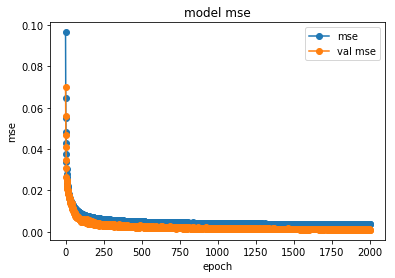

save the model


In [26]:
# -*- coding: utf-8 -*-
"""
Created on Tue Mar  7 15:43:18 2017

@author: hanar
"""
import time
import numpy as np
import os
from keras.utils import np_utils
from keras.models import Sequential
from keras.layers import Dense, Activation, Dropout
from keras.optimizers import SGD
from keras.optimizers import RMSprop
from keras.optimizers import Adagrad
from keras.optimizers import Adadelta
from keras.optimizers import Adam
from keras.optimizers import Adamax
from keras.optimizers import Nadam
from keras.callbacks import ModelCheckpoint
from keras.callbacks import EarlyStopping
from keras.callbacks import TensorBoard
from keras.models import load_model
#from keras.utils.visualize_util import plot
import matplotlib.pyplot as plt
import keras.callbacks
import keras.backend.tensorflow_backend as KTF
import tensorflow as tf

#Global variables for normalizing parameters
max_x = 1.0
min_x = 0.0
max_y = 1.0
min_y = 0.0


def deep_learning_tsunami(resdir, X_train_raw, y_train_raw, X_test_raw, y_test_raw,
                            _lr=0.02, _decay=0,
                            _validation_split=0.2, _batch_size=32,
                            _momentum=0.9, _nesterov=True,
                            num_layers=4, dropout=0.5,
                            node_num = 2500,
                            _epochs=2000):
    """
    Creating the inversion model of turbidity currents by deep learning
    """
    #Normalizing dataset
    X_train = get_normalized_data(X_train_raw, min_x, max_x)
    X_test = get_normalized_data(X_test_raw, min_x, max_x)
    y_train = get_normalized_data(y_train_raw, min_y, max_y)
    y_test = get_normalized_data(y_test_raw, min_y, max_y)
    
    #Generation of neural network model
    model = Sequential()
    model.add(Dense(node_num, input_dim=X_train.shape[1], activation='relu', kernel_initializer ='glorot_uniform'))#1st layer
    model.add(Dropout(dropout))
    for i in range(num_layers - 2):
        model.add(Dense(node_num, activation='relu', kernel_initializer ='glorot_uniform'))#2nd layer
        model.add(Dropout(dropout))
    model.add(Dense(y_train.shape[1], activation = 'relu', kernel_initializer ='glorot_uniform')) #last layer
    
    #Compiling the model
    model.compile(loss="mean_squared_error", 
              optimizer=SGD(lr=_lr, decay=_decay, momentum=_momentum, nesterov=_nesterov),
              #optimizer=Adadelta(),
              metrics=["mean_squared_error"])    
    
    #Perform learning
    t = time.time()
    check = ModelCheckpoint("model3.hdf5")
    #es_cb = EarlyStopping(monitor='val_loss', patience=5, verbose=0, mode='auto')
    #tb_cb = TensorBoard(log_dir=resdir, histogram_freq=2, write_graph=True, write_images=True)
    history = model.fit(X_train, y_train, epochs=_epochs, 
                    validation_split=_validation_split, batch_size=_batch_size,
                    callbacks=[check])
    
    #Evaluate learning result
    loss_and_metrics = model.evaluate(X_test,y_test)
    print("\nloss:{} mse:{}".format(loss_and_metrics[0],loss_and_metrics[1]))
    
    print("Elapsed time: {:.1f} sec.".format(time.time()-t))
    
    #Visualize learning result   
    #plot(model, to_file="model.png", show_shapes=True, show_layer_names=True)

    # model The state of change when letting you learnplot
    plot_history(history)
    
    return model, history

def apply_model(model, X, min_x, max_x, min_y, max_y):
    """
    Apply model
    Maximum and minimum values ​​of X and Y are required to normalize
    """
    X_norm =  (X - min_x) / (max_x - min_x)
    Y_norm = model.predict(X_norm)
    Y = Y_norm*(max_y - min_y)+min_y
    return Y

def plot_history(history):
    # Plot accuracy history
    plt.plot(history.history['mean_squared_error'],"o-",label="mse")
    plt.plot(history.history['val_mean_squared_error'],"o-",label="val mse")
    plt.title('model mse')
    plt.xlabel('epoch')
    plt.ylabel('mse')
    plt.legend(loc="upper right")
    plt.show()

#    # 損失の履歴をプロット
#    plt.plot(history.history['loss'],"o-",label="loss",)
#    plt.plot(history.history['val_loss'],"o-",label="val_loss")
#    plt.title('model loss')
#    plt.xlabel('epoch')
#    plt.ylabel('loss')
#    plt.legend(loc='upper right')
#    plt.show()

def test_model(model, x_test):
    #Test the results
    
    x_test_norm = get_normalized_data(x_test, min_x, max_x)
    test_result_norm = model.predict(x_test_norm)
    test_result = get_raw_data(test_result_norm, min_y, max_y)
    
    return test_result


def save_result(savedir, model, history, test_result):
    
    
    np.savetxt(savedir + 'test_result.txt',test_result,delimiter=',')
    np.savetxt(savedir+'loss.txt',history.history.get('loss'),delimiter=',')
    np.savetxt(savedir+'val_loss.txt',history.history.get('val_loss'),delimiter=',')
    
    #Serialize model and save
    print('save the model')
    model.save(savedir + 'model3.hdf5')

def load_data(datadir):
    """
    This function load training and test data sets, and returns variables
    """
    global min_x, max_x, min_y, max_y
    
    x_train = np.loadtxt(datadir + 'x_train.txt',delimiter=',')
    x_test = np.loadtxt(datadir + 'x_test.txt',delimiter=',')
    y_train = np.loadtxt(datadir + 'icond_train.txt',delimiter=',')
    y_test = np.loadtxt(datadir + 'icond_test.txt',delimiter=',')
    min_y = np.loadtxt(datadir + 'icond_min.txt',delimiter=',')
    max_y = np.loadtxt(datadir + 'icond_max.txt',delimiter=',')
    [min_x, max_x] = np.loadtxt(datadir + 'x_minmax.txt',delimiter=',')
    
    return x_train, y_train, x_test, y_test

def set_minmax_data(_min_x, _max_x, _min_y, _max_y):
    global min_x, max_x, min_y, max_y
    
    min_x, max_x, min_y, max_y = _min_x, _max_x, _min_y, _max_y
    return
    


def get_normalized_data(x, min_val, max_val):
    """
    Normalizing the training and test dataset
    """
    x_norm = (x - min_val) / (max_val - min_val)
    
    return x_norm

def get_raw_data(x_norm, min_val, max_val):
    """
    Get raw data from the normalized dataset
    """
    x = x_norm * (max_val - min_val) + min_val
    
    return x

if __name__ == "__main__":
    
    #Reading data  
    datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi3600/'
    resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi3600/'
    if not os.path.exists(resdir):
        os.mkdir(resdir)
    
    x_train, y_train, x_test, y_test = load_data(datadir)
    
     
    #Execution of learning
    testcases = [4500]
    for i in range(len(testcases)):
        resdir_case = resdir + '{}/'.format(testcases[i])        
        if not os.path.exists(resdir_case):
            os.mkdir(resdir_case)
        x_train_sub = x_train[0:testcases[i],:]
        y_train_sub = y_train[0:testcases[i],:]
        model, history = deep_learning_tsunami(resdir_case, x_train_sub, y_train_sub, x_test, y_test, num_layers=5)
        #Verify and save results
        result = test_model(model, x_test)
        save_result(resdir_case,model,history,result)




(500, 9)


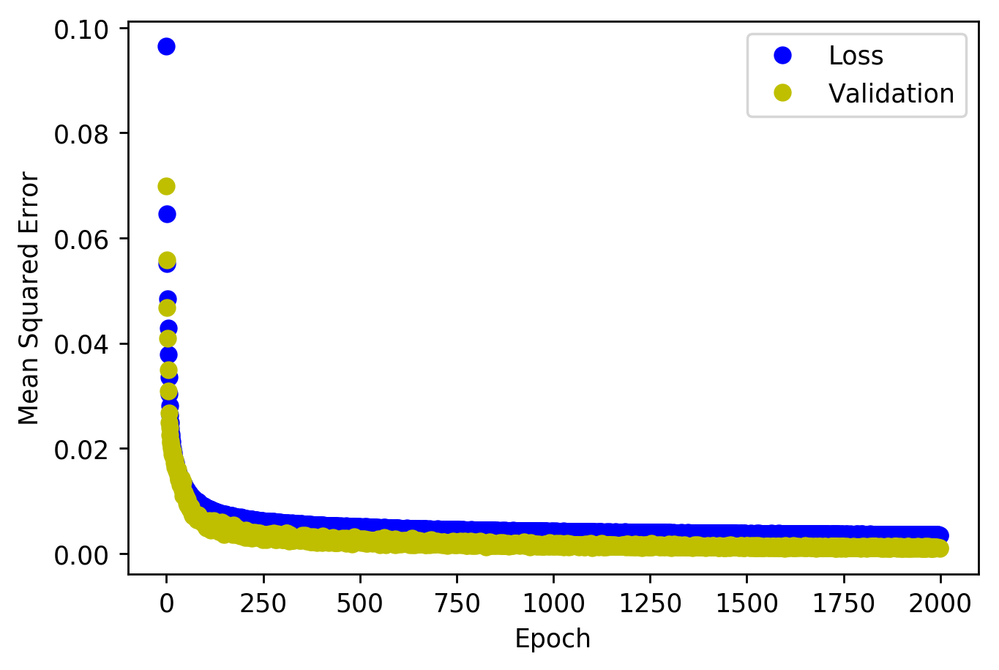

<Figure size 432x288 with 0 Axes>

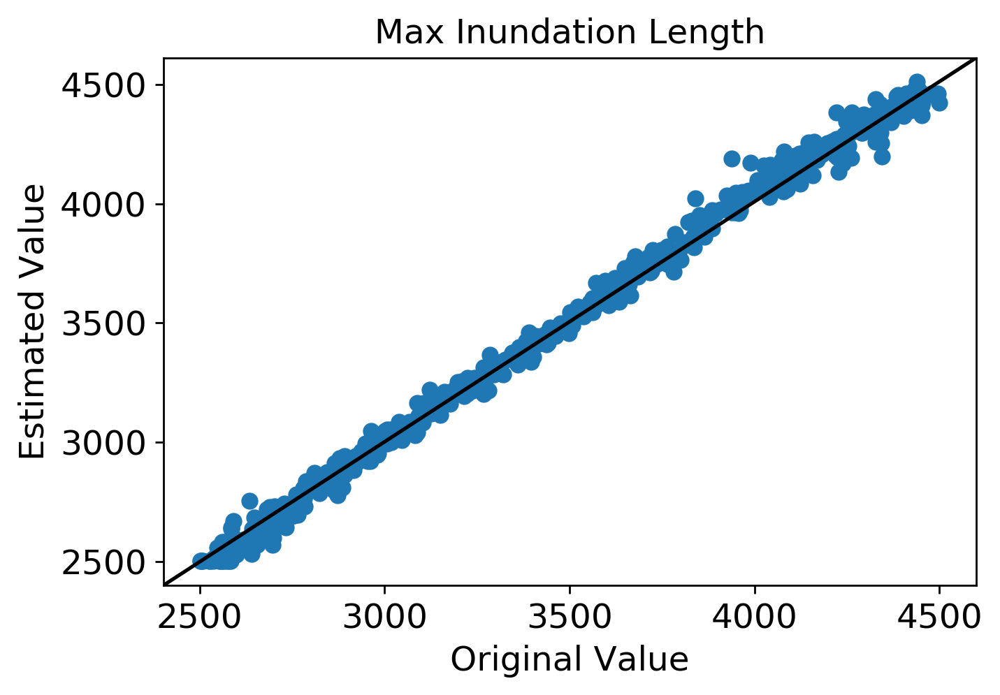

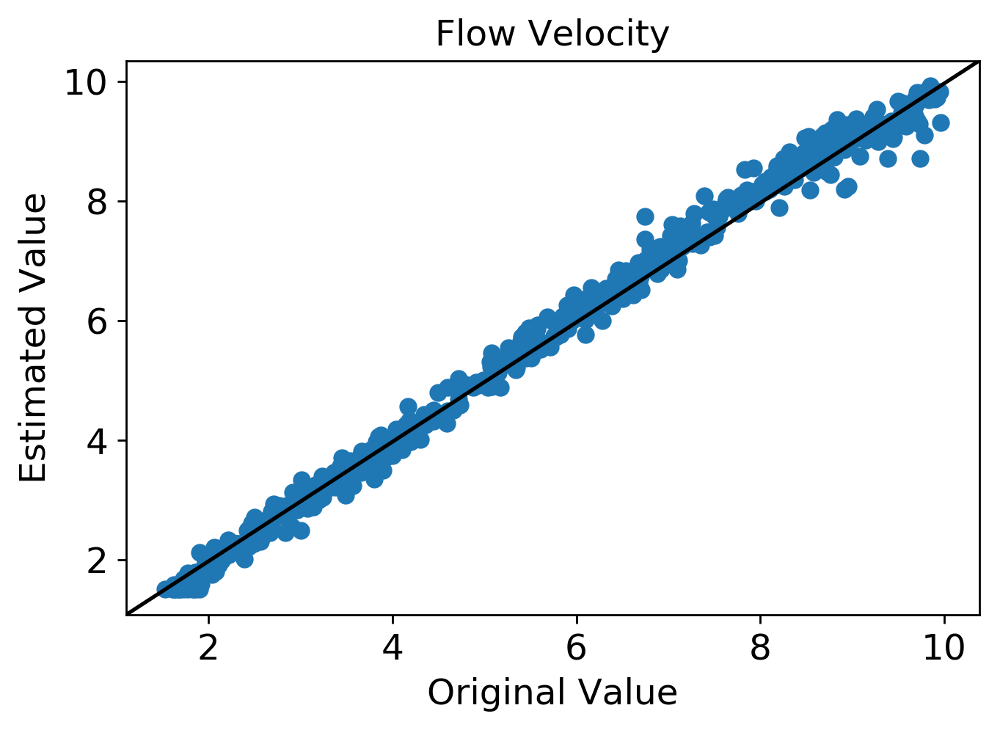

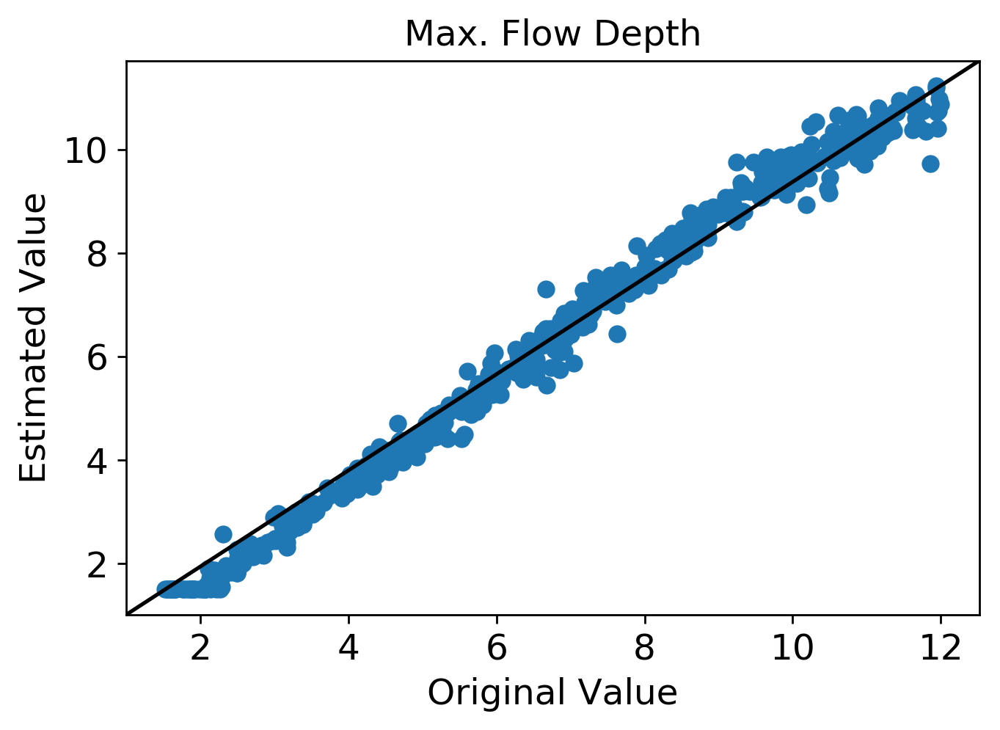

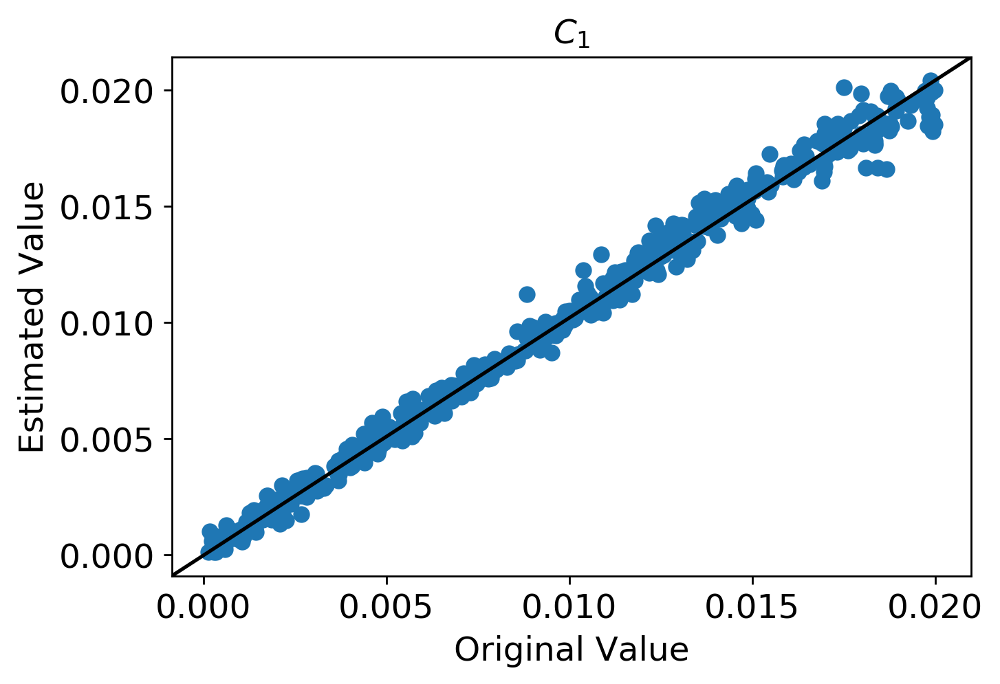

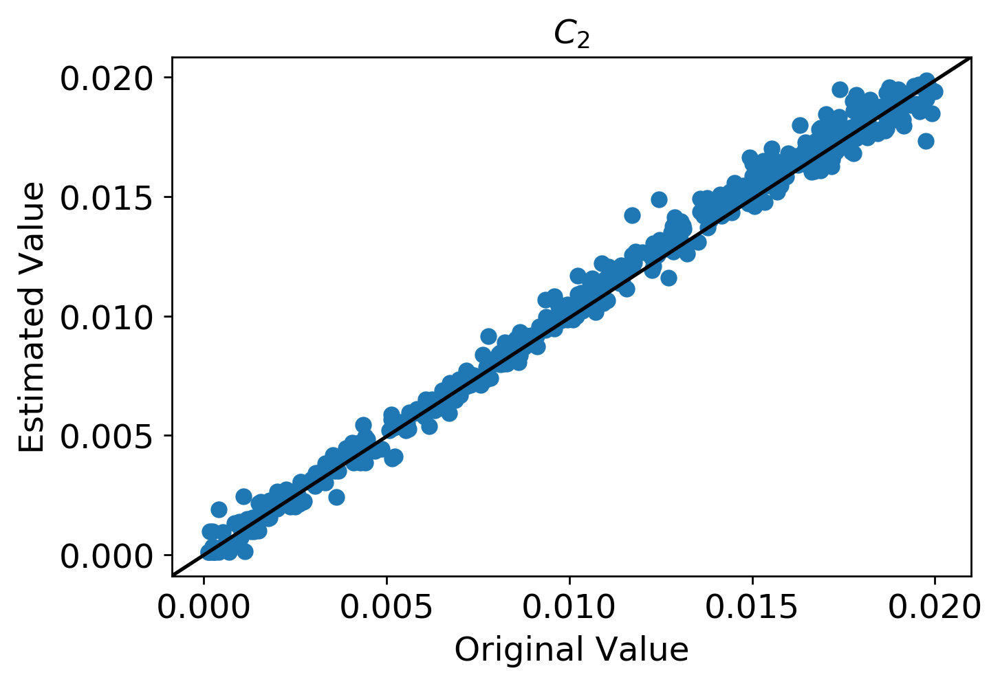

...

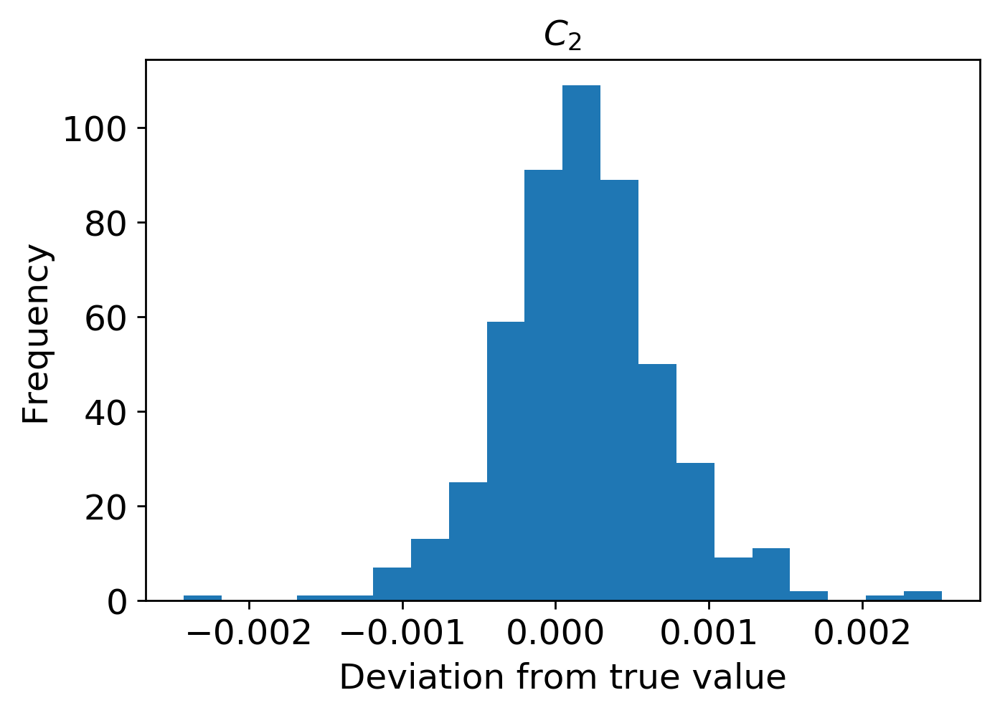

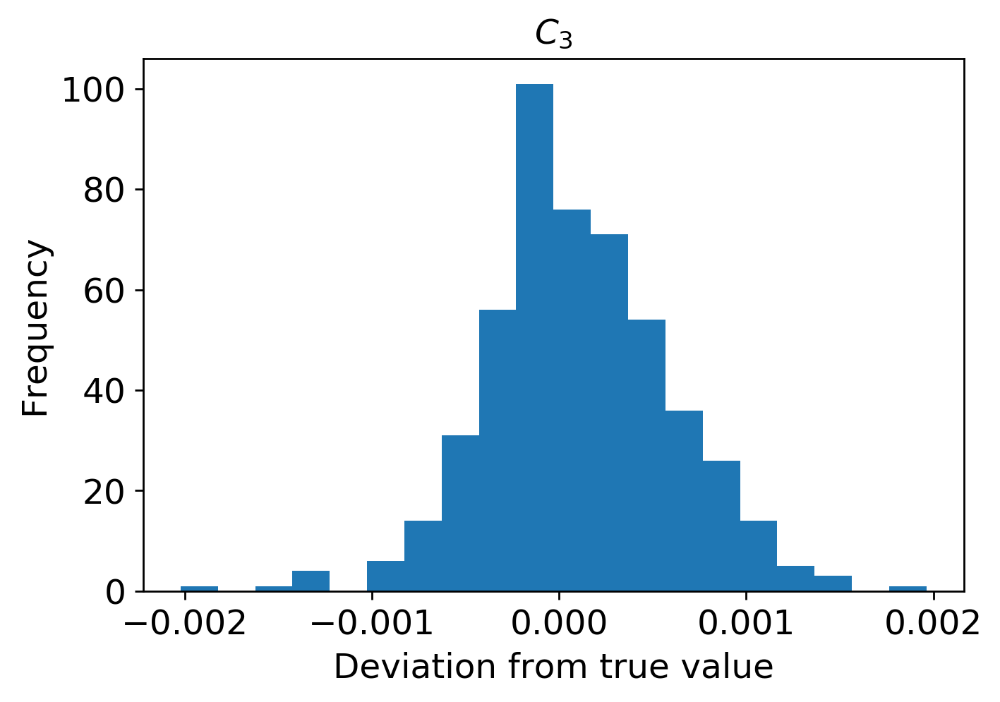

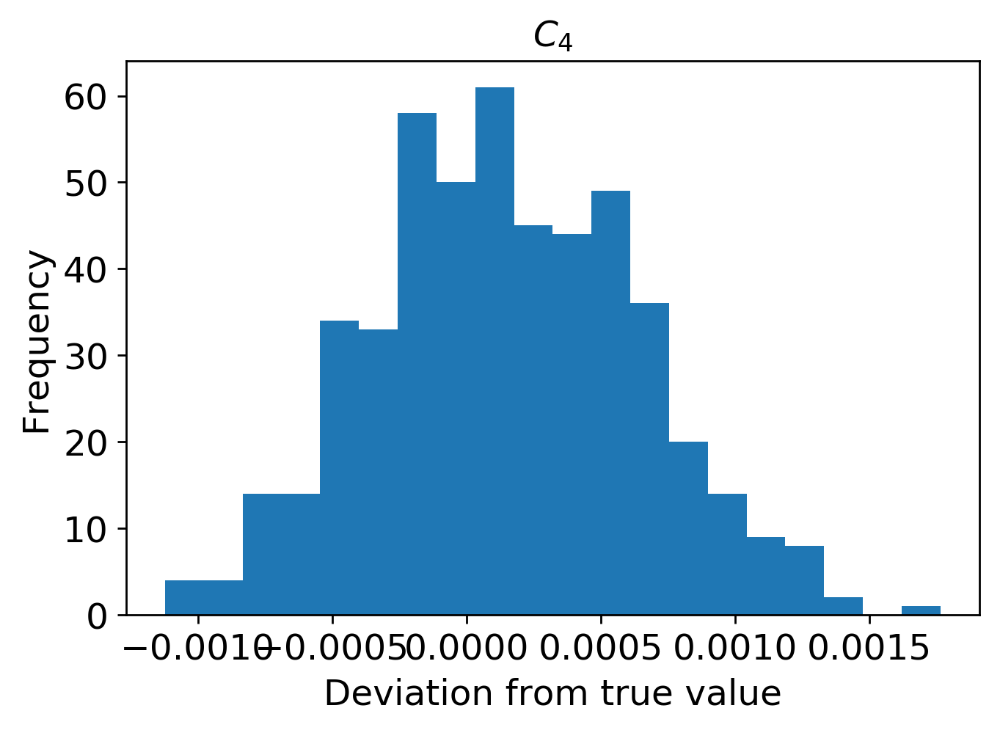

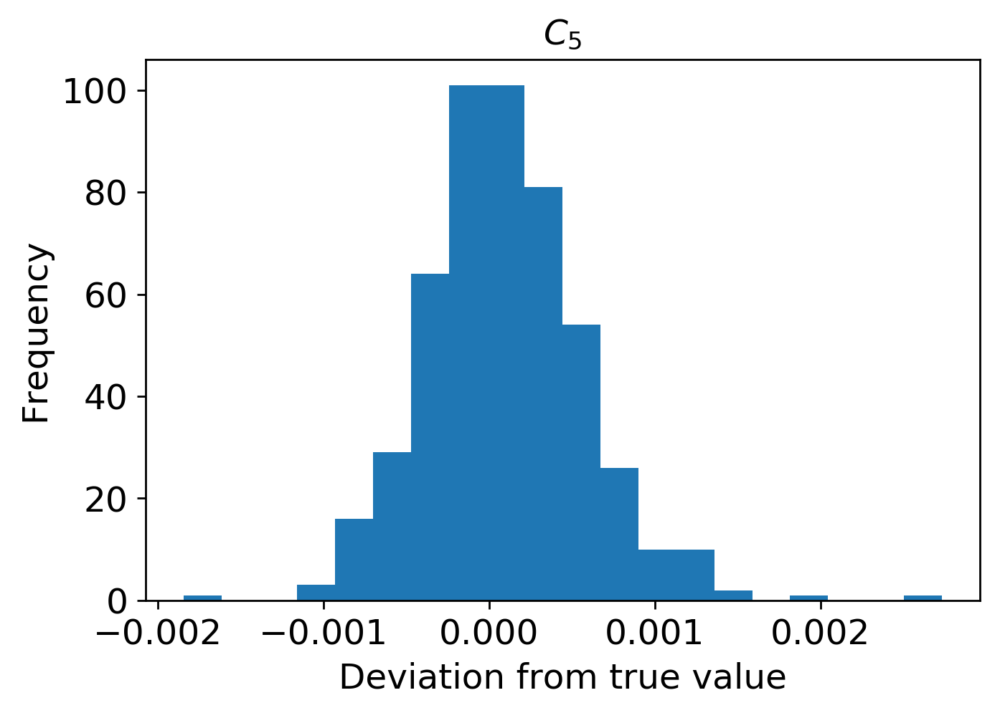

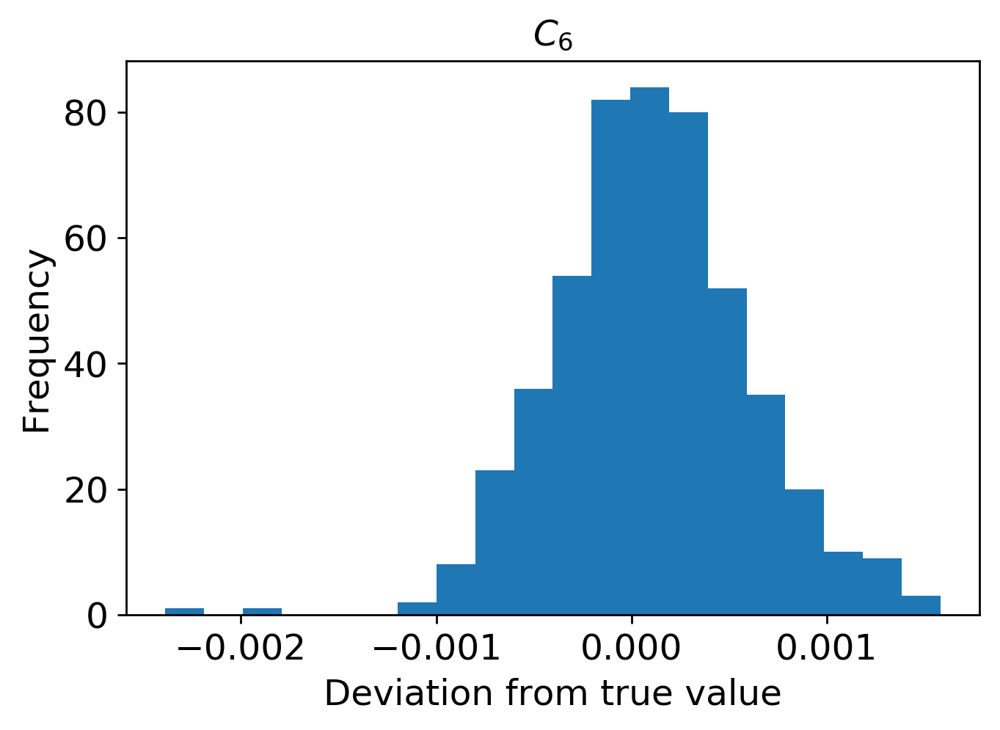

In [27]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi3600/'
resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi3600/4500/'

test_result = np.loadtxt(resdir + 'test_result.txt',delimiter=',')
icond = np.loadtxt(datadir + 'icond_test.txt',delimiter=',')
print(icond.shape)
loss = np.loadtxt(resdir+'loss.txt',delimiter=',')
epoch = range(0,2000)
vloss = np.loadtxt(resdir+'val_loss.txt',delimiter=',')
resi = test_result - icond

fig = plt.figure(num=None,dpi=250, facecolor='w', edgecolor='k')
plt.plot(epoch, loss, 'bo',label='Loss')
plt.plot(epoch, vloss, 'yo',label='Validation')
plt.xlabel('Epoch')
plt.ylabel('Mean Squared Error')
plt.legend(loc="upper right")
plt.savefig(resdir+ 'mse.eps')
plt.show()

fig2 = plt.figure()
hfont = {'fontname':'Century Gothic'}
textcol = 'k'
titlelabel = ['Max Inundation Length','Flow Velocity', 'Max. Flow Depth', '$C_1$', '$C_2$', '$C_3$', '$C_4$','$C_5$','$C_6$']


    
for i in range(len(titlelabel)):
    plt.figure(num=None,dpi=250, facecolor='w', edgecolor='k')
    plt.plot(icond[:,i],test_result[:,i],"o")
    x=icond[:,i]
    y=test_result[:,i]
    y_lim = plt.ylim()
    x_lim = plt.xlim()
    plt.plot(x_lim, y_lim, 'k-', color = 'k')
    plt.ylim(y_lim)
    plt.xlim(x_lim)
    plt.xlabel('Original Value',color=textcol,size=14,**hfont)
    plt.ylabel('Estimated Value',color=textcol,size=14,**hfont)
    plt.title(titlelabel[i],color=textcol,size=14,**hfont)
    plt.tick_params(labelsize=14,colors=textcol)
    plt.savefig(resdir+titlelabel[i] + '.eps')
    #plt.show()

for i in range(len(titlelabel)):
    plt.figure(num=None,dpi=250, facecolor='w', edgecolor='k')
    plt.hist(resi[:,i],bins=20)
    plt.title(titlelabel[i],color=textcol,size=14,**hfont)
    plt.xlabel('Deviation from true value',color=textcol,size=14,**hfont)
    plt.ylabel('Frequency',color=textcol,size=14,**hfont)
    plt.tick_params(labelsize=14,colors=textcol)
    plt.savefig(resdir+titlelabel[i] + 'hist' + '.eps')
    plt.show()

       distance        g1        g2        g3        g4        g5        g6
0      0.000000  0.036771  0.167260  0.114845  0.008449  0.002190  0.005161
1    103.794102  0.000000  0.075200  0.153283  0.013753  0.001885  0.000442
2    171.620654  0.002130  0.051171  0.084309  0.006218  0.001867  0.002843
3    397.112167  0.003115  0.016359  0.078858  0.011466  0.000597  0.000054
4    595.912969  0.000732  0.016896  0.028720  0.002661  0.000914  0.000000
5    707.625749  0.000143  0.002228  0.005502  0.000900  0.000187  0.000104
6    796.435078  0.000236  0.004337  0.021204  0.003169  0.000309  0.000080
7    895.065500  0.001688  0.016059  0.081413  0.020284  0.006824  0.004628
8    988.394177  0.004567  0.008166  0.074658  0.016913  0.002424  0.001580
9   1081.819325  0.001567  0.016305  0.060234  0.011086  0.004165  0.001994
10  1195.756993  0.001022  0.002370  0.017565  0.004194  0.000567  0.000142
11  1290.372534  0.000000  0.004121  0.057974  0.014565  0.000426  0.000213
12  1400.896

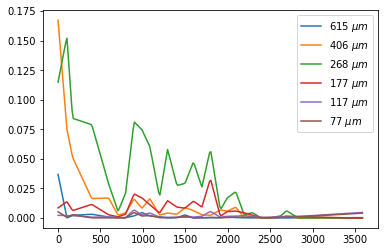

In [28]:
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.models import load_model
from scipy import stats
from scipy.interpolate import interp1d 
import pandas as pd
from pykrige import OrdinaryKriging as OK
import ipdb


datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi3600/'
resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi3600/4500/'
#Initial setting
if not "model" in locals(): 
    model = load_model(resdir+'model3.hdf5')
#gclass = 3
#gclass_label = ["500 $\mu$m","125 $\mu$m","63 $\mu$m"]
gclass = 6
gclass_label = ["615 ${\mu}m$","406 ${\mu}m$","268 ${\mu}m$","177 ${\mu}m$", "117 ${\mu}m$","77 ${\mu}m$"]
topodx = 15.0
coord_num = int(model.layers[0].input_shape[1]/gclass)

#Acquires a value for normalizing input data to [0, 1]
min_x, max_x = np.loadtxt(datadir + 'x_minmax.txt',delimiter=',')
y_min = np.loadtxt(datadir + 'icond_min.txt',delimiter=',')
y_max = np.loadtxt(datadir + 'icond_max.txt',delimiter=',')

#Read outcrop data
#dist_max = 22000. #Distance of distal end of learning data
outcrop = pd.read_csv('../FITTNUSS-forward_training_DNN/sendai_increased_class_edit.csv')
#outcrop = pd.read_csv('../DeepLearningTurbidite_Fukuda/GA_naruse_v2.csv')
#outcrop = outcrop.append(pd.DataFrame([[0,'Loc0',0,0,0],[dist_max,'LocE',0,0,0]], columns=outcrop.columns))
outcrop = outcrop.sort_values('distance')
outcrop['distance'] = outcrop['distance'] - 0
#d = pd.DataFrame(np.zeros((1, 7)),columns=['distance', 'g1','g2','g3','g4','g5','g6'])
#print(d)
#v=np.concatenate((outcrop, d))
#print(v)
#outcrop=pd.DataFrame(v,columns=['distance', 'g1','g2','g3','g4','g5','g6'])
#outcrop['distance'].iloc[-1]=4000
#outcrop = outcrop.append(pd.DataFrame([[0,'Loc0',0,0,0,0]], columns=outcrop.columns))
print(outcrop)

#Preparation under interpolation
thick_interp = np.zeros([1,coord_num*gclass])#補間されたサンプル厚さデータ
outcrop_x_id = np.round(outcrop['distance']/topodx).astype(np.int32) #逆解析システムでのサンプリング地点のindex番号
x = np.arange(0,coord_num*topodx,topodx)

#Complement data
for j in range(gclass):
    f = interp1d(outcrop['distance'],outcrop.iloc[:,j+1], kind="linear",bounds_error=False,fill_value='extrapolate')
    #f = interp1d(outcrop['distance'],outcrop.iloc[:,j+2], kind="linear",bounds_error=False,fill_value='extrapolate') 
    #Interpolation function of jth granularity level
    thick_interp[0,coord_num*j:coord_num*(j+1)] = f(x) #Supplemented data

#ipdb.set_trace()
#Kriging Interpolation by
#vparams = np.array([[0.035, 10000., 0.001],[0.006, 10000., 0.002],[0.005, 10000., 0.002],[0.035, 10000., 0.001]])
#for j in range(gclass):
    #okip = OK(outcrop['distance'],np.zeros(outcrop['distance'].shape),outcrop.iloc[:,j+1],variogram_model='gaussian',)
    #okip.display_variogram_model()
    #ipdata, ipstd = okip.execute('grid',x,np.array([0.]))
    #ipdata = np.squeeze(ipdata)
    #thick_interp[0,coord_num*j:coord_num*(j+1)] = ipdata #Assign complemented d

#Normalize data
thick_interp[thick_interp < 0] = 0
thick_interp_norm =  (thick_interp - min_x) / (max_x - min_x)

#Perform inverse analysis
test_result_outcrop = model.predict(thick_interp_norm)
test_result_outcrop = test_result_outcrop * (y_max - y_min) + y_min
print(test_result_outcrop)
#add=np.array(3000)
#test_result_outcrop_add=np.concatenate((add,test_result_outcrop), axis=None)
#Output results
#print(test_result_outcrop_add)
np.savetxt('outcrop_result_g6_g300_H_5000_20_11_roi3600.txt',test_result_outcrop, delimiter=',')
for i in range(len(gclass_label)):
    plt.plot(x,thick_interp[0,coord_num * i:coord_num * (i+1)],label=gclass_label[i])
plt.legend()
plt.show()



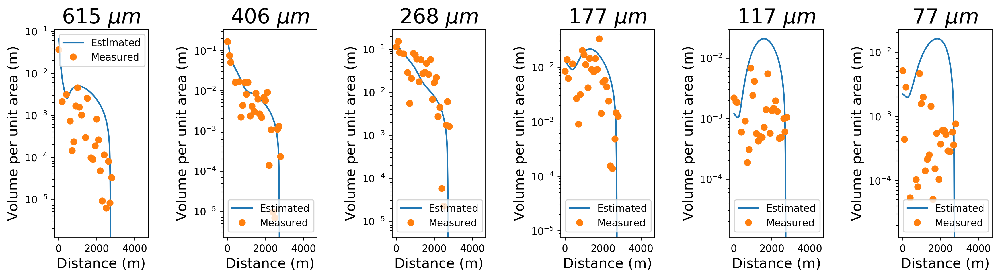

In [29]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import Forward_model_modified_FITTNUSS_5000_g6_300grid_19_11_case2 as fmodel
import time
import ipdb
%matplotlib inline

#Basic setting

#dist_max = 3000.
gclass = 6
topodx=15.0
gclass_name = ['615microm','406microm','268microm','177microm','117microm','77microm']
#gclass_name = ['500micron', '125micron', '63micron']
gname_tex = ["615 ${\mu}m$","406 ${\mu}m$","268 ${\mu}m$","177 ${\mu}m$", "117 ${\mu}m$","77 ${\mu}m$"]
#gname_tex = ['500 $\mu$m','125 $\mu$m','63 $\mu$m']
#calcdir = 'home/rimali2009/FITTNUSS-forward_training_DNN/'
#calcdir = '/home/naruse/Documents/Documents/MATLAB/TCtrainData_forML/TCModel_for_MLTEST/test_output_otadai07/'

#Load estimate
#H1 = np.loadtxt(calcdir + 'H1.txt',delimiter=',')
#H2 = np.loadtxt(calcdir + 'H2.txt',delimiter=',')
#H3 = np.loadtxt(calcdir + 'H3.txt',delimiter=',')
#H4 = np.loadtxt(calcdir + 'H4.txt',delimiter=',')
#Ht = np.loadtxt(calcdir + 'Ht.txt',delimiter=',')
#U = np.loadtxt(calcdir + 'U.txt',delimiter=',')
#xi = np.loadtxt(calcdir + 'xi.txt',delimiter=',')
#x = np.loadtxt(calcdir + 'x.txt',delimiter=',')
#x_bed = np.loadtxt(calcdir + 'x_init.txt',delimiter=',')
#eta_init = np.loadtxt(calcdir + 'eta_init.txt',delimiter=',')
#Ct = np.loadtxt(calcdir + 'Ct.txt',delimiter=',')
#time = np.loadtxt(calcdir + 'time.txt',delimiter=',')
estimated_icond=np.loadtxt('outcrop_result_g6_g300_H_5000_20_11_roi3600.txt', delimiter=',')
start = time.time()
fmodel.read_setfile("config_g6_300grid_19_11_case2.ini")
(x,C,x_dep,deposit) = fmodel.forward(estimated_icond)
np.savetxt('eta_estimated_thickness_5K_g6_TC4_Rwcnst_H_5000_20_11_roi3600.csv', deposit, delimiter=',')
np.savetxt('eta_estimated_Distance_5K_g6_TC4_Rwcnst_H_5000_20_11_roi3600.csv', x_dep,delimiter=',')
estimated_dep_thickness_5000=np.transpose(np.loadtxt('/home/rimali2009/FITTNUSS-forward_training_DNN/'+'eta_estimated_thickness_5K_g6_TC4_Rwcnst_H_5000_20_11_roi3600.csv', delimiter=','))
estimated_dep_thickness_5000=pd.DataFrame(estimated_dep_thickness_5000,columns=['615microm','406microm','268microm','177microm','117microm','77microm'])
estimated_dep_distance_5000=np.transpose(np.loadtxt('/home/rimali2009/FITTNUSS-forward_training_DNN/'+'eta_estimated_Distance_5K_g6_TC4_Rwcnst_H_5000_20_11_roi3600.csv', delimiter=','))
estimated_dep_distance_5000=pd.DataFrame(estimated_dep_distance_5000,columns=['distance'])
estimated_dep_5000=pd.concat([estimated_dep_distance_5000,estimated_dep_thickness_5000],axis=1)
np.savetxt('estimated_dep_5K_g6_TC4_Rwcnst_H_5000_20_11_roi3600.csv',estimated_dep_5000,delimiter=',')
#data_estim=pd.DataFrame(estimated_dep_5000,columns=['distance','1.5phi','2.5phi','3.5phi','4.5phi'])

#Formatting the loaded data
#estimated_dep_df = pd.DataFrame(estimated_dep,columns=['distance','1.5phi','2.5phi','3.5phi','4.5phi'])
#estimated_dep = pd.DataFrame(np.array([x_bed - dist_offset,H1[-1,:],H2[-1,:],H3[-1,:]]).T,columns=['distance','500micron','125micron','63micron'])
estimated_dep_5000= estimated_dep_5000.query('distance > 0')
#estimated_dep_5000 = estimated_dep_5000.query('distance < {}'.format(dist_max))

#Read original data
outcrop = pd.read_csv('../FITTNUSS-forward_training_DNN/sendai_increased_class.csv')
outcrop= pd.DataFrame(outcrop,columns=['distance','615microm','406microm','268microm','177microm','117microm','77microm'])
#outcrop = pd.read_csv('../DeepLearningTurbidite_Fukuda/GA_naruse_v2.csv')
#outcrop = outcrop.append(pd.DataFrame([[0,'Loc0',0,0,0],[dist_max,'LocE',0,0,0]], columns=outcrop.columns))
#outcrop = outcrop.sort_values('distance')
#outcrop['distance'] = outcrop['distance'] - 1000

#Plot
plt.figure(num=None, figsize=(17, 4), dpi=250, facecolor='w', edgecolor='g')
hfont = {'fontname':'Sans'}
plt.subplots_adjust(bottom=0.15, wspace=0.8)

for i in range(gclass):
    plt.subplot(1,gclass,i+1)
    plt.plot(estimated_dep_5000['distance'],estimated_dep_5000[gclass_name[i]],'-', label='Estimated')
    plt.plot(outcrop['distance'], outcrop[gclass_name[i]],'o', label='Measured')
    plt.yscale('log')
    plt.title(gname_tex[i], size=21,**hfont)
    plt.xlabel('Distance (m)', size = 14, **hfont)
    plt.ylabel('Volume per unit area (m)', size = 14, **hfont)
    plt.legend(fontsize=10)
    plt.savefig("thickness_distance_curve_5000_g6_300grid_H_5000_20_11_roi3600.png")
    plt.savefig("thickness_distance_curve_5000_g6_300grid_H_5000_20_11_roi3600.eps")
plt.show()



Using TensorFlow backend.


       distance        g1        g2        g3        g4        g5        g6
0      0.000000  0.036771  0.167260  0.114845  0.008449  0.002190  0.005161
1    103.794102  0.000000  0.075200  0.153283  0.013753  0.001885  0.000442
2    171.620654  0.002130  0.051171  0.084309  0.006218  0.001867  0.002843
3    397.112167  0.003115  0.016359  0.078858  0.011466  0.000597  0.000054
4    595.912969  0.000732  0.016896  0.028720  0.002661  0.000914  0.000000
5    707.625749  0.000143  0.002228  0.005502  0.000900  0.000187  0.000104
6    796.435078  0.000236  0.004337  0.021204  0.003169  0.000309  0.000080
7    895.065500  0.001688  0.016059  0.081413  0.020284  0.006824  0.004628
8    988.394177  0.004567  0.008166  0.074658  0.016913  0.002424  0.001580
9   1081.819325  0.001567  0.016305  0.060234  0.011086  0.004165  0.001994
10  1195.756993  0.001022  0.002370  0.017565  0.004194  0.000567  0.000142
11  1290.372534  0.000000  0.004121  0.057974  0.014565  0.000426  0.000213
12  1400.896

       distance        g1        g2        g3        g4        g5        g6
0      0.000000  0.036771  0.167260  0.114845  0.008449  0.002190  0.005161
1    103.794102  0.000000  0.075200  0.153283  0.013753  0.001885  0.000442
2    171.620654  0.002130  0.051171  0.084309  0.006218  0.001867  0.002843
3    397.112167  0.003115  0.016359  0.078858  0.011466  0.000597  0.000054
4    595.912969  0.000732  0.016896  0.028720  0.002661  0.000914  0.000000
5    707.625749  0.000143  0.002228  0.005502  0.000900  0.000187  0.000104
6    796.435078  0.000236  0.004337  0.021204  0.003169  0.000309  0.000080
7    895.065500  0.001688  0.016059  0.081413  0.020284  0.006824  0.004628
8   1081.819325  0.001567  0.016305  0.060234  0.011086  0.004165  0.001994
9   1195.756993  0.001022  0.002370  0.017565  0.004194  0.000567  0.000142
10  1290.372534  0.000000  0.004121  0.057974  0.014565  0.000426  0.000213
11  1400.896519  0.000295  0.003096  0.027406  0.009121  0.000502  0.000251
12  1495.352

/home/rimali2009/anaconda3/envs/test3/lib/python3.6/site-packages/matplotlib/font_manager.py:1241: UserWarning: findfont: Font family ['Century Gothic'] not found. Falling back to DejaVu Sans.
  (prop.get_family(), self.defaultFamily[fontext]))


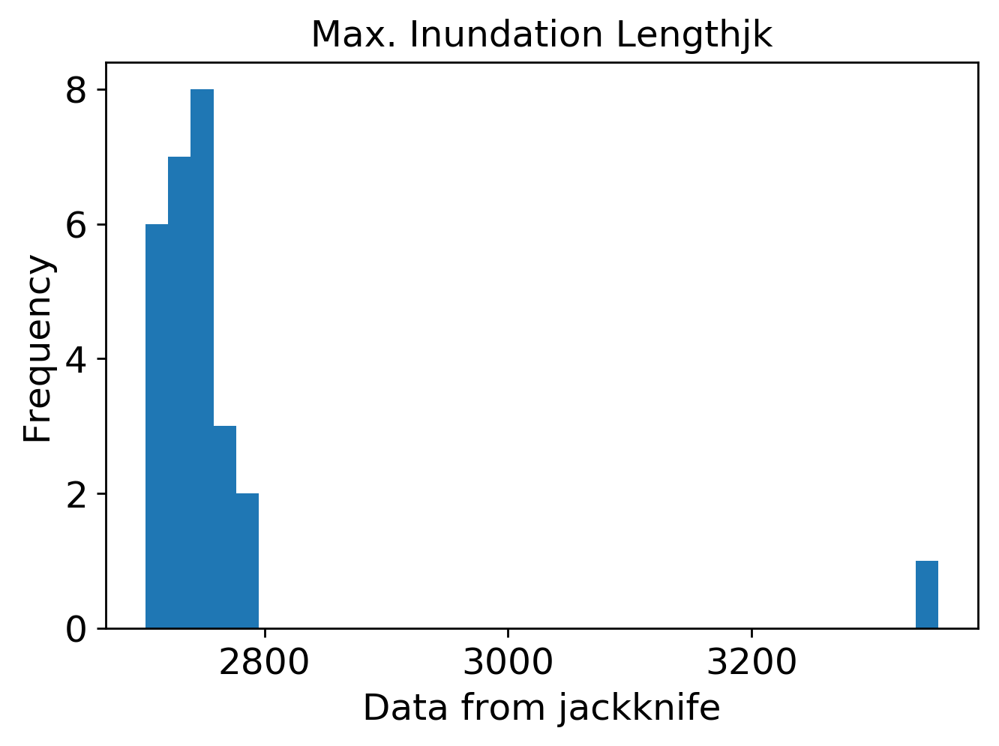

mean: 4.550408951324408
jk_e: 0.08385830873139981


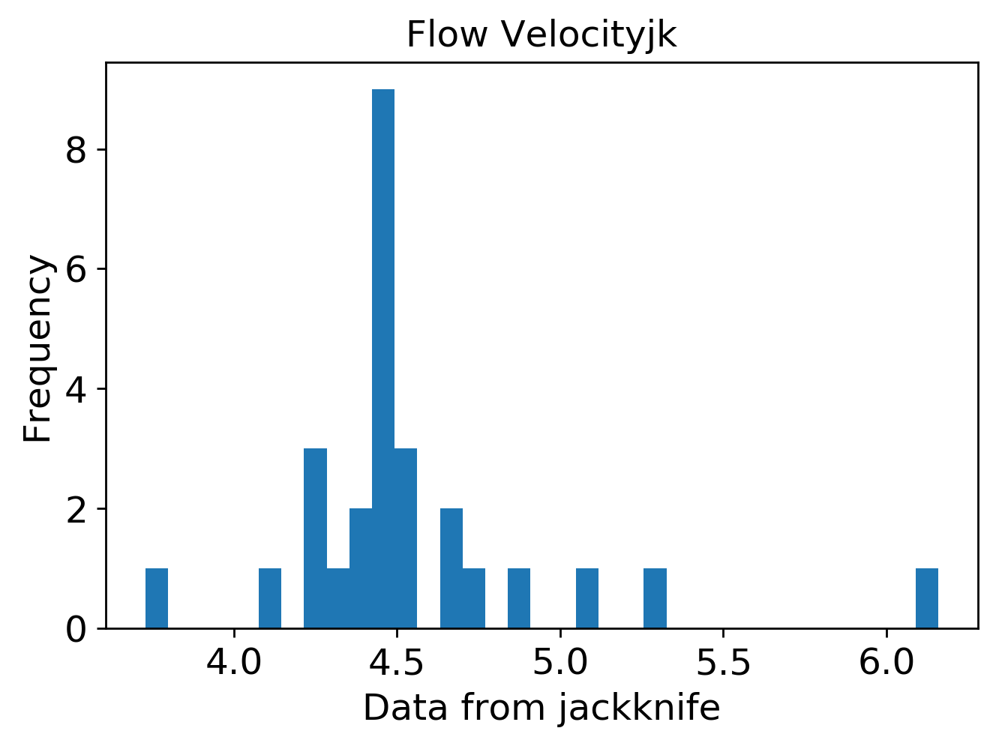

mean: 7.077929546611405
jk_e: 0.16649130491259242


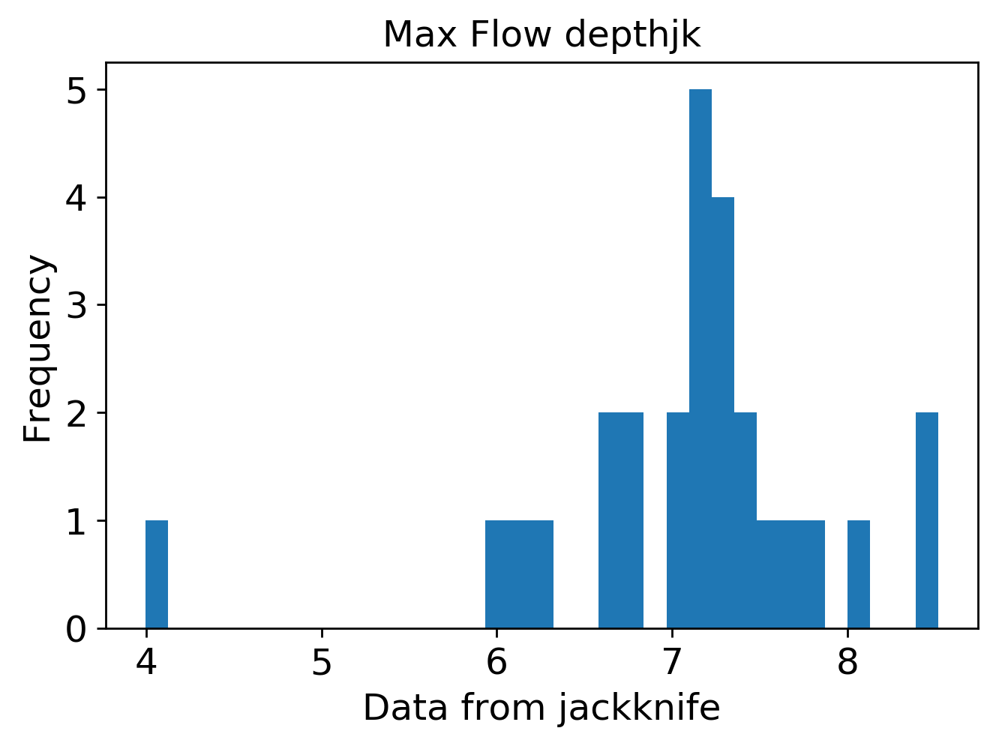

mean: 0.006325348607519299
jk_e: 0.00016841045794642275


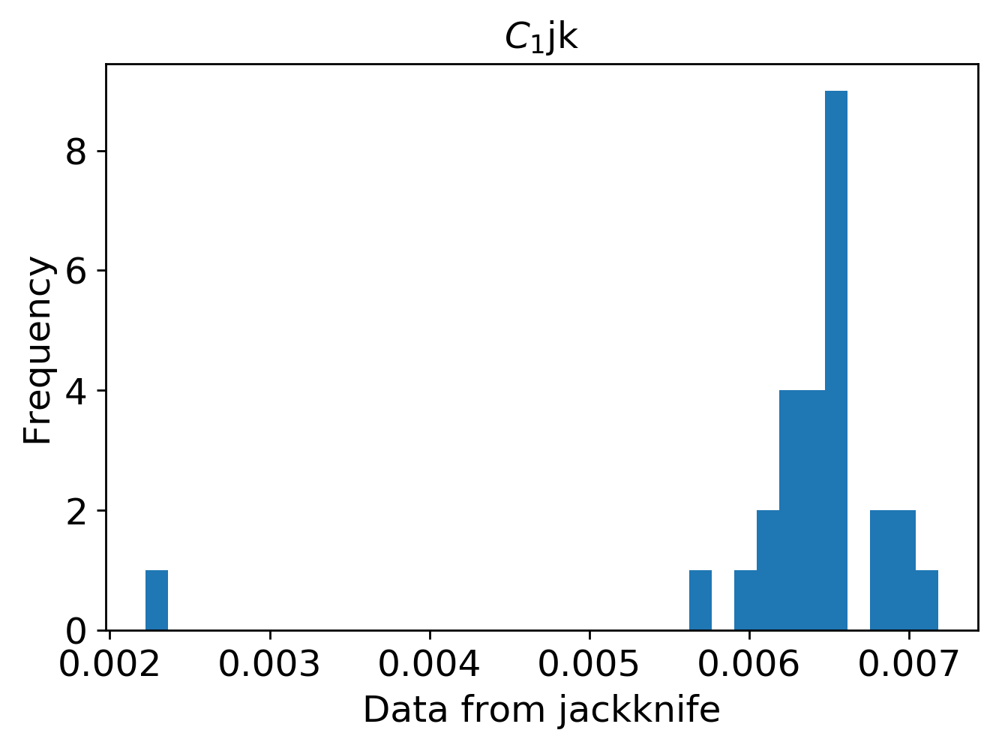

mean: 0.018268574643794663
jk_e: 0.0003231094162570319


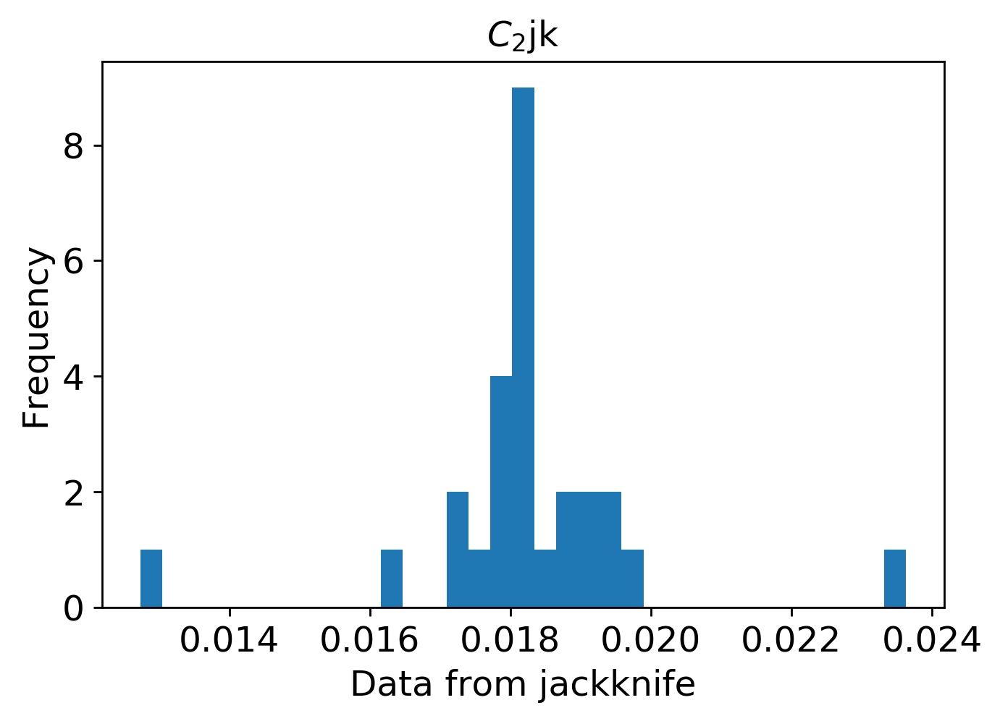

mean: 0.015964605365262386
jk_e: 0.00036240182527850817


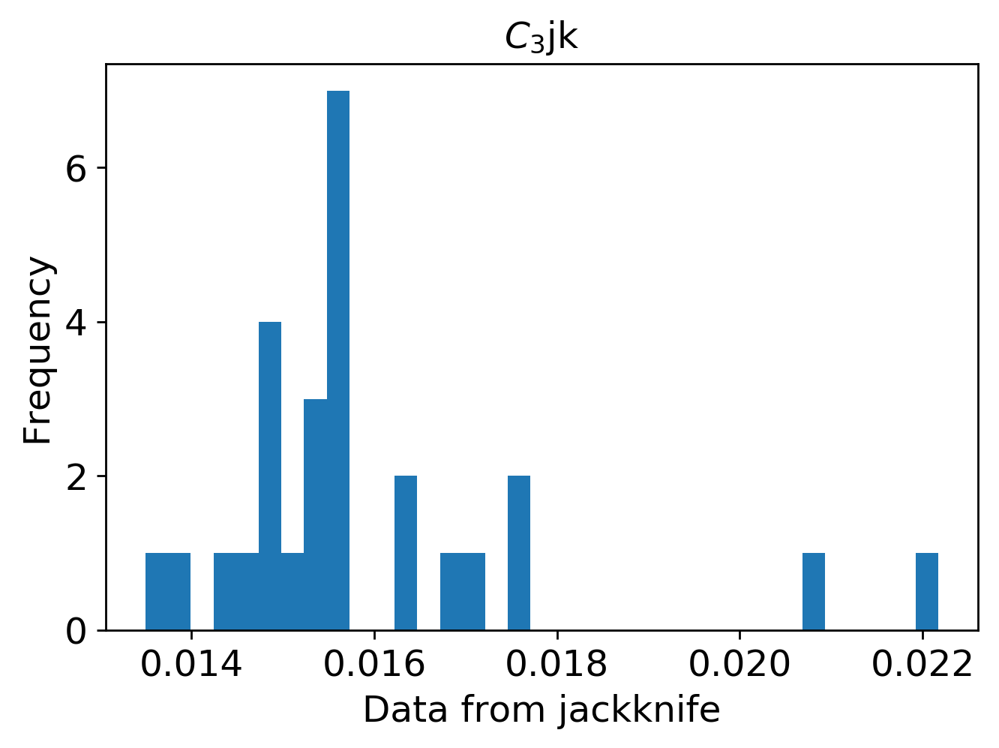

mean: 0.0012443514091334438
jk_e: 7.134162122859628e-05


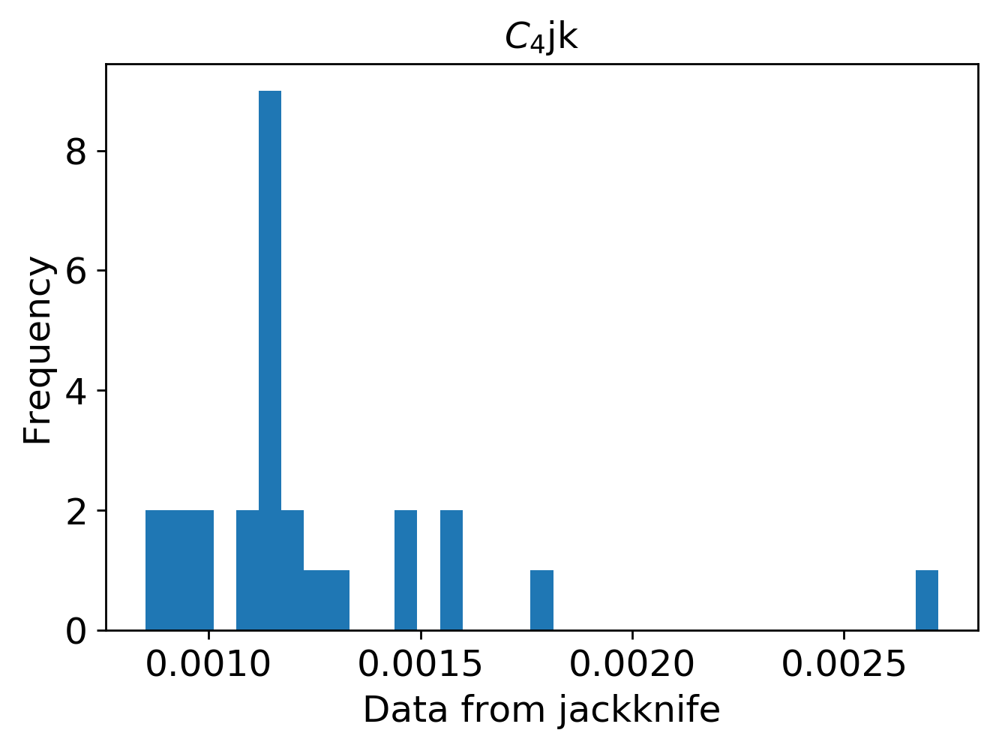

mean: 0.00013826320398880964
jk_e: 3.6902243770233125e-05


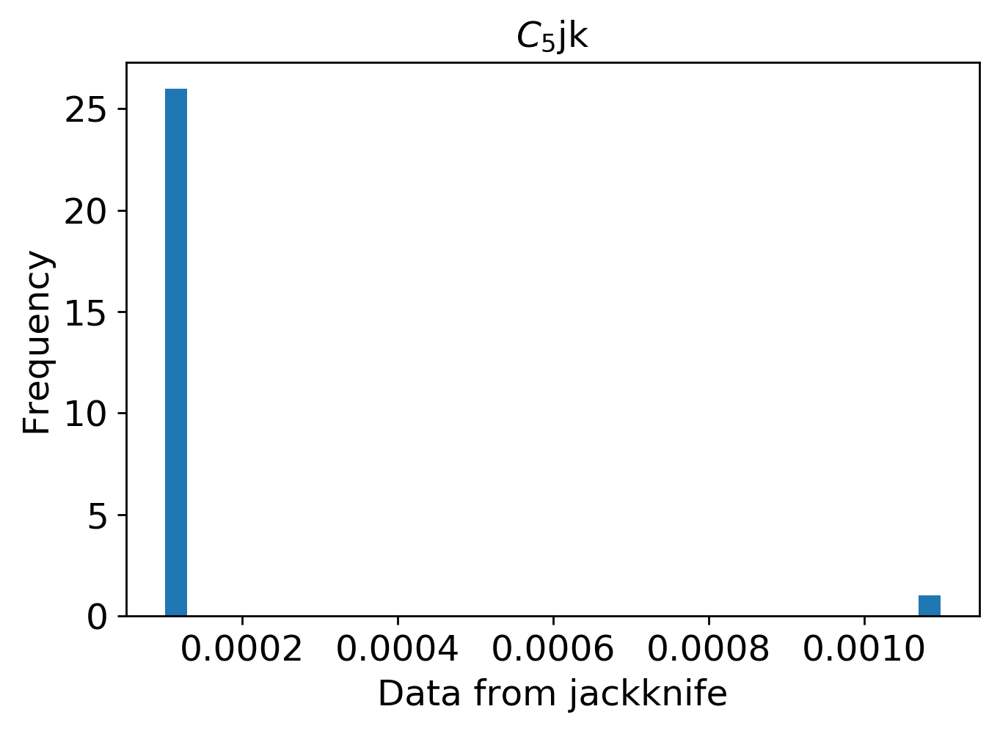

mean: 0.00024927525173056866
jk_e: 4.7138566176343515e-05


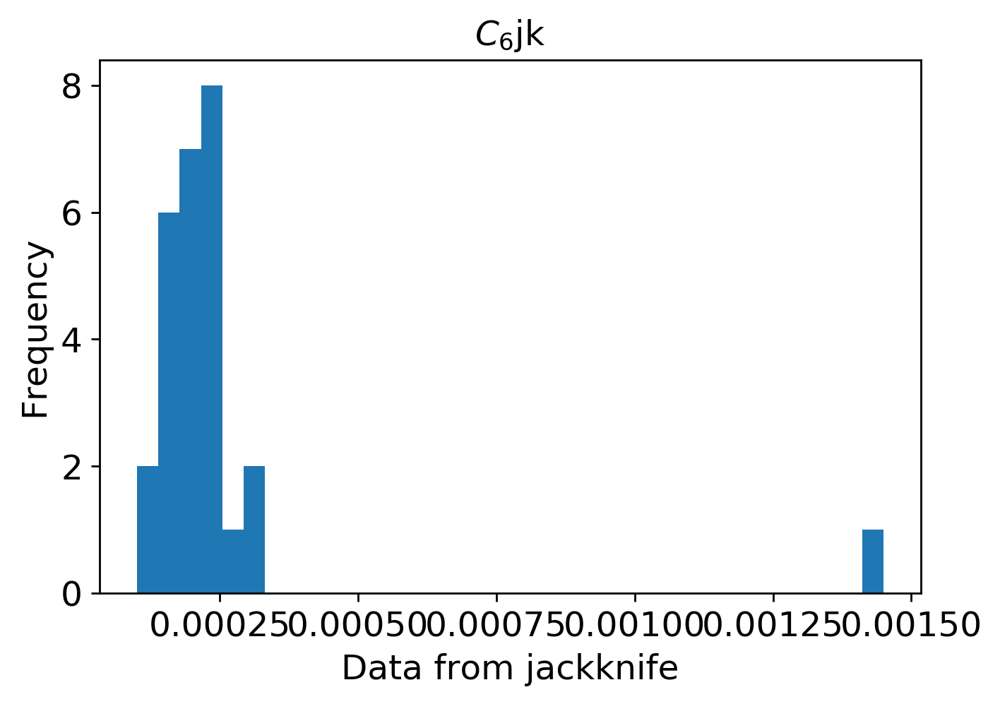

In [1]:
# Jackknife Method
import csv
import numpy as np
import pandas as pd
import math
from keras.models import load_model
from scipy.interpolate import interp1d
import matplotlib.pyplot as plt
%matplotlib inline

datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi3600/'
resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi3600/4500/'
# Initial setting
if not "model" in locals():
    model = load_model(resdir+'model3.hdf5')
gclass = 6
gclass_label = ["615 ${\mu}m$", "406 ${\mu}m$", "268 ${\mu}m$",
                "177 ${\mu}m$", "117 ${\mu}m$", "77 ${\mu}m$"]
topodx = 15.0
coord_num = int(model.layers[0].input_shape[1]/gclass)
min_x, max_x = np.loadtxt(datadir + 'x_minmax.txt', delimiter=',')
y_min = np.loadtxt(datadir + 'icond_min.txt', delimiter=',')
y_max = np.loadtxt(datadir + 'icond_max.txt', delimiter=',')


a = pd.read_csv(
    '../FITTNUSS-forward_training_DNN/sendai_increased_class_edit.csv', delimiter=',')
print(a)
y = pd.DataFrame()
output = []

with open('output_final_20_11_roi3600.csv', 'w') as outfile:

    # x=[]
    for index in range(len(a)):
        df = y.append(pd.read_csv(
            '../FITTNUSS-forward_training_DNN/sendai_increased_class_edit.csv', skiprows=[index+1]))
        print(df)
        df = df.sort_values('distance')
        thick_interp = np.zeros([1, coord_num*gclass])
        x = np.arange(0, coord_num*topodx, topodx)
        for j in range(gclass):
            # Interpolation function of jth granularity level
            f = interp1d(df['distance'], df.iloc[:, j+1],
                         kind="linear", bounds_error=False,fill_value='extrapolate')
            thick_interp[0, coord_num*j:coord_num*(j+1)] = f(x)
        thick_interp[thick_interp < 0] = 0
        thick_interp_norm = (thick_interp - min_x) / (max_x - min_x)
        test_result_outcrop = model.predict(thick_interp_norm)
        test_result_outcrop = test_result_outcrop * (y_max - y_min) + y_min
        print(test_result_outcrop.shape)
        print(test_result_outcrop)
    # output.append(test_result_outcrop)
        np.savetxt(outfile,test_result_outcrop, delimiter=',')
        # outfile.write('# New iteration\n')
hfont = {'fontname': 'Century Gothic'}
textcol = 'k'
resi = np.loadtxt('output_final_20_11_roi3600.csv', delimiter=',')
titlelabel = ['Max. Inundation Lengthjk','Flow Velocityjk', 'Max Flow depthjk',
              '$C_1$jk', '$C_2$jk', '$C_3$jk', '$C_4$jk', '$C_5$jk', '$C_6$jk']
jk_er=[]
with open('jk_e_roi3600.txt','wb') as ftext:
    for i in range(len(titlelabel)):
        plt.figure(num=None, dpi=250, facecolor='w', edgecolor='k')
        plt.hist(resi[:, i], bins=35)
        mean = sum(resi[:,i]) / len(resi[:,i])
        print("mean:",mean)
        var_jk  = sum(pow(x-mean,2) for x in resi[:,i]) / ((len(resi[:,i])-1)*(len(resi[:,i])))
        jk_e= math.sqrt(var_jk)
        print("jk_e:",jk_e)
        e=np.append(jk_e,jk_er)
        np.savetxt(ftext,e,delimiter=',')
        plt.title(titlelabel[i], color=textcol, size=14, **hfont)
        plt.xlabel('Data from jackknife', color=textcol, size=14, **hfont)
        plt.ylabel('Frequency', color=textcol, size=14, **hfont)
        plt.tick_params(labelsize=14, colors=textcol)
        plt.savefig(resdir+titlelabel[i] + 'jkhist' + '.eps')
        plt.show()


# ROI 3700

In [31]:
import numpy as np
import os
#import ipdb

def connect_dataset(file_list, icond_file_list, outputdir,
                    topodx=15, roi=2500, offset=5000,gclass_num=6,test_data_num=500):
    """
    複数のデータセットを連結する
    """
    #ipdb.set_trace()
    
    #Reading and combining files Decide start and end points of the learning area and convert them to grid numbers
    H = np.loadtxt(file_list[0], delimiter = ',')
    icond = np.loadtxt(icond_file_list[0], delimiter = ',')
    
    #Reading and combining files
    if len(file_list) > 1:
        for i in range(1, len(file_list)):
            H_temp = np.loadtxt(file_list[i], delimiter = ',')
            icond_temp = np.loadtxt(icond_file_list[i], delimiter = ',')
            H = np.concatenate((H,H_temp),axis=0)
            icond = np.concatenate((icond,icond_temp),axis = 0)
    
    roi_grids = int(roi / topodx)
    num_grids = int(H.shape[1] / gclass_num)
    H_subset = np.zeros([H.shape[0], roi_grids * gclass_num])
    for i in range(gclass_num):
        H_subset[:, i*roi_grids:(i+1)*roi_grids] = H[:, i*num_grids:(i*num_grids+roi_grids)]
    
    #Obtain the maximum and minimum values of data
    max_x = np.max(H_subset)
    min_x = np.min(H_subset)
    icond_max = np.max(icond, axis=0)
    icond_min = np.min(icond, axis=0)
    
    #Split the data into tests and training
    H_train = H_subset[0:-test_data_num,:]
    H_test = H_subset[H_subset.shape[0] - test_data_num:,:]
    icond_train = icond[0:-test_data_num,:]
    icond_test = icond[H.shape[0] - test_data_num:,:]
    
    #Save the data
    if not os.path.exists(outputdir):
        os.mkdir(outputdir)
    np.savetxt(outputdir + '/x_train.txt',H_train,delimiter = ',')
    np.savetxt(outputdir + '/x_test.txt',H_test,delimiter = ',')
    np.savetxt(outputdir + '/icond_train.txt',icond_train,delimiter = ',')
    np.savetxt(outputdir + '/icond_test.txt',icond_test,delimiter = ',')
    np.savetxt(outputdir + '/icond_min.txt',icond_min,delimiter = ',')
    np.savetxt(outputdir + '/icond_max.txt',icond_max,delimiter = ',')
    np.savetxt(outputdir + '/x_minmax.txt',[min_x, max_x],delimiter = ',')
    
    
if __name__=="__main__":
    original_data_dir = "/home/rimali2009/FITTNUSS-forward_training_DNN"
    parent_dir = "/home/rimali2009/FITTNUSS-forward_training_DNN"
    if not os.path.exists(parent_dir):
        os.mkdir(parent_dir)
    outputdir = parent_dir + "/data_g6_300grid_H_5000_20_11_roi3700"
    file_list = ['/home/rimali2009/FITTNUSS-forward_training_DNN/eta_5000_g6_300grid_19_11.csv']
    initial_conditions = ['/home/rimali2009/FITTNUSS-forward_training_DNN/start_param_random_5000_g6_300grid_19_11.csv']
connect_dataset(file_list, initial_conditions, outputdir, test_data_num=500, gclass_num=6, topodx=15., roi=3700)
        
        
    

Train on 3600 samples, validate on 900 samples
Epoch 1/2000
3600/3600 [==============================] - 2s 520us/step - loss: 0.1020 - mean_squared_error: 0.1020 - val_loss: 0.0699 - val_mean_squared_error: 0.0699
Epoch 2/2000
3600/3600 [==============================] - 1s 386us/step - loss: 0.0650 - mean_squared_error: 0.0650 - val_loss: 0.0555 - val_mean_squared_error: 0.0555
Epoch 3/2000
3600/3600 [==============================] - 2s 425us/step - loss: 0.0550 - mean_squared_error: 0.0550 - val_loss: 0.0455 - val_mean_squared_error: 0.0455
Epoch 4/2000
3600/3600 [==============================] - 2s 422us/step - loss: 0.0481 - mean_squared_error: 0.0481 - val_loss: 0.0404 - val_mean_squared_error: 0.0404
Epoch 5/2000
3600/3600 [==============================] - 1s 378us/step - loss: 0.0428 - mean_squared_error: 0.0428 - val_loss: 0.0342 - val_mean_squared_error: 0.0342
Epoch 6/2000
3600/3600 [==============================] - 1s 414us/step - loss: 0.0378 - mean_squared_error: 0.03

3600/3600 [==============================] - 2s 431us/step - loss: 0.0089 - mean_squared_error: 0.0089 - val_loss: 0.0066 - val_mean_squared_error: 0.0066
Epoch 98/2000
3600/3600 [==============================] - 2s 421us/step - loss: 0.0090 - mean_squared_error: 0.0090 - val_loss: 0.0055 - val_mean_squared_error: 0.0055
Epoch 99/2000
3600/3600 [==============================] - 1s 389us/step - loss: 0.0088 - mean_squared_error: 0.0088 - val_loss: 0.0065 - val_mean_squared_error: 0.0065
Epoch 100/2000
3600/3600 [==============================] - 1s 392us/step - loss: 0.0087 - mean_squared_error: 0.0087 - val_loss: 0.0059 - val_mean_squared_error: 0.0059
Epoch 101/2000
3600/3600 [==============================] - 1s 400us/step - loss: 0.0087 - mean_squared_error: 0.0087 - val_loss: 0.0061 - val_mean_squared_error: 0.0061
Epoch 102/2000
3600/3600 [==============================] - 1s 409us/step - loss: 0.0086 - mean_squared_error: 0.0086 - val_loss: 0.0060 - val_mean_squared_error: 0.00

3600/3600 [==============================] - 1s 394us/step - loss: 0.0067 - mean_squared_error: 0.0067 - val_loss: 0.0039 - val_mean_squared_error: 0.0039
Epoch 194/2000
3600/3600 [==============================] - 1s 379us/step - loss: 0.0067 - mean_squared_error: 0.0067 - val_loss: 0.0038 - val_mean_squared_error: 0.0038
Epoch 195/2000
3600/3600 [==============================] - 1s 397us/step - loss: 0.0068 - mean_squared_error: 0.0068 - val_loss: 0.0038 - val_mean_squared_error: 0.0038
Epoch 196/2000
3600/3600 [==============================] - 1s 387us/step - loss: 0.0067 - mean_squared_error: 0.0067 - val_loss: 0.0030 - val_mean_squared_error: 0.0030
Epoch 197/2000
3600/3600 [==============================] - 1s 409us/step - loss: 0.0067 - mean_squared_error: 0.0067 - val_loss: 0.0038 - val_mean_squared_error: 0.0038
Epoch 198/2000
3600/3600 [==============================] - 1s 378us/step - loss: 0.0066 - mean_squared_error: 0.0066 - val_loss: 0.0038 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 411us/step - loss: 0.0060 - mean_squared_error: 0.0060 - val_loss: 0.0030 - val_mean_squared_error: 0.0030
Epoch 290/2000
3600/3600 [==============================] - 1s 406us/step - loss: 0.0059 - mean_squared_error: 0.0059 - val_loss: 0.0030 - val_mean_squared_error: 0.0030
Epoch 291/2000
3600/3600 [==============================] - 1s 388us/step - loss: 0.0059 - mean_squared_error: 0.0059 - val_loss: 0.0037 - val_mean_squared_error: 0.0037
Epoch 292/2000
3600/3600 [==============================] - 1s 394us/step - loss: 0.0059 - mean_squared_error: 0.0059 - val_loss: 0.0028 - val_mean_squared_error: 0.0028
Epoch 293/2000
3600/3600 [==============================] - 1s 394us/step - loss: 0.0059 - mean_squared_error: 0.0059 - val_loss: 0.0032 - val_mean_squared_error: 0.0032
Epoch 294/2000
3600/3600 [==============================] - 1s 399us/step - loss: 0.0059 - mean_squared_error: 0.0059 - val_loss: 0.0034 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 415us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0028 - val_mean_squared_error: 0.0028
Epoch 386/2000
3600/3600 [==============================] - 1s 393us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0027 - val_mean_squared_error: 0.0027
Epoch 387/2000
3600/3600 [==============================] - 1s 403us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 388/2000
3600/3600 [==============================] - 2s 419us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0032 - val_mean_squared_error: 0.0032
Epoch 389/2000
3600/3600 [==============================] - 1s 391us/step - loss: 0.0055 - mean_squared_error: 0.0055 - val_loss: 0.0026 - val_mean_squared_error: 0.0026
Epoch 390/2000
3600/3600 [==============================] - 1s 396us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0034 - val_mean_squared_error: 0.

3600/3600 [==============================] - 2s 426us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0026 - val_mean_squared_error: 0.0026
Epoch 482/2000
3600/3600 [==============================] - 1s 394us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0023 - val_mean_squared_error: 0.0023
Epoch 483/2000
3600/3600 [==============================] - 1s 373us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 484/2000
3600/3600 [==============================] - 2s 426us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0028 - val_mean_squared_error: 0.0028
Epoch 485/2000
3600/3600 [==============================] - 1s 398us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 486/2000
3600/3600 [==============================] - 1s 383us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0031 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 400us/step - loss: 0.0049 - mean_squared_error: 0.0049 - val_loss: 0.0019 - val_mean_squared_error: 0.0019
Epoch 578/2000
3600/3600 [==============================] - 1s 389us/step - loss: 0.0049 - mean_squared_error: 0.0049 - val_loss: 0.0022 - val_mean_squared_error: 0.0022
Epoch 579/2000
3600/3600 [==============================] - 1s 405us/step - loss: 0.0049 - mean_squared_error: 0.0049 - val_loss: 0.0018 - val_mean_squared_error: 0.0018
Epoch 580/2000
3600/3600 [==============================] - 1s 376us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0023 - val_mean_squared_error: 0.0023
Epoch 581/2000
3600/3600 [==============================] - 1s 375us/step - loss: 0.0049 - mean_squared_error: 0.0049 - val_loss: 0.0021 - val_mean_squared_error: 0.0021
Epoch 582/2000
3600/3600 [==============================] - 1s 397us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0022 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 382us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0022 - val_mean_squared_error: 0.0022
Epoch 674/2000
3600/3600 [==============================] - 1s 370us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0019 - val_mean_squared_error: 0.0019
Epoch 675/2000
3600/3600 [==============================] - 1s 390us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0021 - val_mean_squared_error: 0.0021
Epoch 676/2000
3600/3600 [==============================] - 2s 432us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0019 - val_mean_squared_error: 0.0019
Epoch 677/2000
3600/3600 [==============================] - 1s 412us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0023 - val_mean_squared_error: 0.0023
Epoch 678/2000
3600/3600 [==============================] - 1s 375us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0019 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 412us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0020 - val_mean_squared_error: 0.0020
Epoch 770/2000
3600/3600 [==============================] - 1s 399us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0020 - val_mean_squared_error: 0.0020
Epoch 771/2000
3600/3600 [==============================] - 1s 381us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0019 - val_mean_squared_error: 0.0019
Epoch 772/2000
3600/3600 [==============================] - 1s 394us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0018 - val_mean_squared_error: 0.0018
Epoch 773/2000
3600/3600 [==============================] - 1s 401us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0017 - val_mean_squared_error: 0.0017
Epoch 774/2000
3600/3600 [==============================] - 1s 413us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0018 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 404us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0018 - val_mean_squared_error: 0.0018
Epoch 866/2000
3600/3600 [==============================] - 1s 392us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0017 - val_mean_squared_error: 0.0017
Epoch 867/2000
3600/3600 [==============================] - 1s 408us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0017 - val_mean_squared_error: 0.0017
Epoch 868/2000
3600/3600 [==============================] - 1s 402us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0018 - val_mean_squared_error: 0.0018
Epoch 869/2000
3600/3600 [==============================] - 1s 400us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0019 - val_mean_squared_error: 0.0019
Epoch 870/2000
3600/3600 [==============================] - 1s 392us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0019 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 407us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 962/2000
3600/3600 [==============================] - 1s 401us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 963/2000
3600/3600 [==============================] - 1s 387us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0019 - val_mean_squared_error: 0.0019
Epoch 964/2000
3600/3600 [==============================] - 1s 413us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0019 - val_mean_squared_error: 0.0019
Epoch 965/2000
3600/3600 [==============================] - 1s 403us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0019 - val_mean_squared_error: 0.0019
Epoch 966/2000
3600/3600 [==============================] - 1s 408us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0018 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 402us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0017 - val_mean_squared_error: 0.0017
Epoch 1058/2000
3600/3600 [==============================] - 1s 415us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1059/2000
3600/3600 [==============================] - 2s 442us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0018 - val_mean_squared_error: 0.0018
Epoch 1060/2000
3600/3600 [==============================] - 1s 406us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1061/2000
3600/3600 [==============================] - 2s 419us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0017 - val_mean_squared_error: 0.0017
Epoch 1062/2000
3600/3600 [==============================] - 1s 414us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0018 - val_mean_squared_erro

3600/3600 [==============================] - 1s 389us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0017 - val_mean_squared_error: 0.0017
Epoch 1106/2000
3600/3600 [==============================] - 1s 383us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0017 - val_mean_squared_error: 0.0017
Epoch 1107/2000
3600/3600 [==============================] - 1s 397us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1108/2000
3600/3600 [==============================] - 1s 397us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0017 - val_mean_squared_error: 0.0017
Epoch 1109/2000
3600/3600 [==============================] - 1s 402us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1110/2000
3600/3600 [==============================] - 1s 383us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0018 - val_mean_squared_erro

3600/3600 [==============================] - 1s 394us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1154/2000
3600/3600 [==============================] - 1s 396us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1155/2000
3600/3600 [==============================] - 2s 419us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1156/2000
3600/3600 [==============================] - 1s 375us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1157/2000
3600/3600 [==============================] - 1s 370us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0018 - val_mean_squared_error: 0.0018
Epoch 1158/2000
3600/3600 [==============================] - 1s 395us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0014 - val_mean_squared_erro

3600/3600 [==============================] - 1s 409us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1202/2000
3600/3600 [==============================] - 1s 393us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1203/2000
3600/3600 [==============================] - 1s 393us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1204/2000
3600/3600 [==============================] - 2s 418us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1205/2000
3600/3600 [==============================] - 1s 394us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1206/2000
3600/3600 [==============================] - 2s 425us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0013 - val_mean_squared_erro

3600/3600 [==============================] - 1s 389us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1250/2000
3600/3600 [==============================] - 1s 397us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0017 - val_mean_squared_error: 0.0017
Epoch 1251/2000
3600/3600 [==============================] - 1s 398us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0020 - val_mean_squared_error: 0.0020
Epoch 1252/2000
3600/3600 [==============================] - 1s 406us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1253/2000
3600/3600 [==============================] - 1s 397us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1254/2000
3600/3600 [==============================] - 1s 411us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0014 - val_mean_squared_erro

3600/3600 [==============================] - 1s 404us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1298/2000
3600/3600 [==============================] - 1s 388us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1299/2000
3600/3600 [==============================] - 2s 419us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1300/2000
3600/3600 [==============================] - 1s 369us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1301/2000
3600/3600 [==============================] - 1s 403us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1302/2000
3600/3600 [==============================] - 1s 404us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0013 - val_mean_squared_erro

3600/3600 [==============================] - 1s 393us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1346/2000
3600/3600 [==============================] - 1s 386us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0019 - val_mean_squared_error: 0.0019
Epoch 1347/2000
3600/3600 [==============================] - 1s 399us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1348/2000
3600/3600 [==============================] - 1s 398us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1349/2000
3600/3600 [==============================] - 2s 424us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1350/2000
3600/3600 [==============================] - 1s 400us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0012 - val_mean_squared_erro

3600/3600 [==============================] - 1s 391us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1394/2000
3600/3600 [==============================] - 1s 399us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1395/2000
3600/3600 [==============================] - 1s 407us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0017 - val_mean_squared_error: 0.0017
Epoch 1396/2000
3600/3600 [==============================] - 1s 406us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1397/2000
3600/3600 [==============================] - 1s 397us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1398/2000
3600/3600 [==============================] - 1s 414us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0015 - val_mean_squared_erro

3600/3600 [==============================] - 1s 398us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1442/2000
3600/3600 [==============================] - 1s 391us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1443/2000
3600/3600 [==============================] - 1s 406us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1444/2000
3600/3600 [==============================] - 1s 392us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1445/2000
3600/3600 [==============================] - 1s 410us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1446/2000
3600/3600 [==============================] - 1s 385us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0012 - val_mean_squared_erro

3600/3600 [==============================] - 1s 397us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1490/2000
3600/3600 [==============================] - 2s 417us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0017 - val_mean_squared_error: 0.0017
Epoch 1491/2000
3600/3600 [==============================] - 2s 424us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1492/2000
3600/3600 [==============================] - 1s 412us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1493/2000
3600/3600 [==============================] - 1s 406us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1494/2000
3600/3600 [==============================] - 1s 407us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0014 - val_mean_squared_erro

3600/3600 [==============================] - 1s 398us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1538/2000
3600/3600 [==============================] - 1s 376us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1539/2000
3600/3600 [==============================] - 1s 415us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1540/2000
3600/3600 [==============================] - 2s 418us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1541/2000
3600/3600 [==============================] - 1s 412us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1542/2000
3600/3600 [==============================] - 1s 403us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0013 - val_mean_squared_erro

3600/3600 [==============================] - 1s 408us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1586/2000
3600/3600 [==============================] - 1s 386us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1587/2000
3600/3600 [==============================] - 1s 396us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0010 - val_mean_squared_error: 0.0010
Epoch 1588/2000
3600/3600 [==============================] - 1s 411us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1589/2000
3600/3600 [==============================] - 1s 383us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1590/2000
3600/3600 [==============================] - 1s 400us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0014 - val_mean_squared_erro

3600/3600 [==============================] - 1s 408us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1634/2000
3600/3600 [==============================] - 1s 413us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1635/2000
3600/3600 [==============================] - 1s 404us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1636/2000
3600/3600 [==============================] - 2s 429us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1637/2000
3600/3600 [==============================] - 1s 394us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1638/2000
3600/3600 [==============================] - 1s 409us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0011 - val_mean_squared_erro

3600/3600 [==============================] - 1s 381us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1682/2000
3600/3600 [==============================] - 1s 403us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1683/2000
3600/3600 [==============================] - 1s 396us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1684/2000
3600/3600 [==============================] - 2s 419us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1685/2000
3600/3600 [==============================] - 1s 376us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1686/2000
3600/3600 [==============================] - 1s 397us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0013 - val_mean_squared_erro

3600/3600 [==============================] - 1s 394us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1730/2000
3600/3600 [==============================] - 1s 390us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1731/2000
3600/3600 [==============================] - 1s 405us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1732/2000
3600/3600 [==============================] - 1s 389us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1733/2000
3600/3600 [==============================] - 1s 407us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1734/2000
3600/3600 [==============================] - 1s 379us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0013 - val_mean_squared_erro

3600/3600 [==============================] - 2s 418us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0010 - val_mean_squared_error: 0.0010
Epoch 1778/2000
3600/3600 [==============================] - 1s 386us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1779/2000
3600/3600 [==============================] - 1s 403us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1780/2000
3600/3600 [==============================] - 1s 413us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0010 - val_mean_squared_error: 0.0010
Epoch 1781/2000
3600/3600 [==============================] - 1s 405us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1782/2000
3600/3600 [==============================] - 1s 388us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0010 - val_mean_squared_erro

3600/3600 [==============================] - 1s 385us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1826/2000
3600/3600 [==============================] - 1s 413us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1827/2000
3600/3600 [==============================] - 1s 394us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1828/2000
3600/3600 [==============================] - 1s 404us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1829/2000
3600/3600 [==============================] - 1s 404us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1830/2000
3600/3600 [==============================] - 1s 376us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0012 - val_mean_squared_erro

Epoch 1873/2000
3600/3600 [==============================] - 1s 383us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1874/2000
3600/3600 [==============================] - 1s 410us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1875/2000
3600/3600 [==============================] - 1s 398us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1876/2000
3600/3600 [==============================] - 1s 403us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1877/2000
3600/3600 [==============================] - 1s 374us/step - loss: 0.0035 - mean_squared_error: 0.0035 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1878/2000
3600/3600 [==============================] - 1s 402us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0013 - val_m

Epoch 1921/2000
3600/3600 [==============================] - 1s 389us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1922/2000
3600/3600 [==============================] - 1s 379us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1923/2000
3600/3600 [==============================] - 1s 400us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1924/2000
3600/3600 [==============================] - 2s 420us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1925/2000
3600/3600 [==============================] - 1s 391us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1926/2000
3600/3600 [==============================] - 1s 411us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0011 - val_m

Epoch 1969/2000
3600/3600 [==============================] - 1s 399us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1970/2000
3600/3600 [==============================] - 1s 383us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 9.9270e-04 - val_mean_squared_error: 9.9270e-04
Epoch 1971/2000
3600/3600 [==============================] - 2s 421us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1972/2000
3600/3600 [==============================] - 1s 404us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1973/2000
3600/3600 [==============================] - 2s 418us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1974/2000
3600/3600 [==============================] - 1s 385us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0011

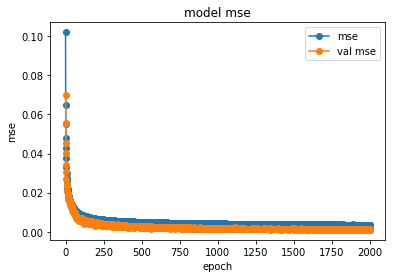

save the model


In [32]:
# -*- coding: utf-8 -*-
"""
Created on Tue Mar  7 15:43:18 2017

@author: hanar
"""
import time
import numpy as np
import os
from keras.utils import np_utils
from keras.models import Sequential
from keras.layers import Dense, Activation, Dropout
from keras.optimizers import SGD
from keras.optimizers import RMSprop
from keras.optimizers import Adagrad
from keras.optimizers import Adadelta
from keras.optimizers import Adam
from keras.optimizers import Adamax
from keras.optimizers import Nadam
from keras.callbacks import ModelCheckpoint
from keras.callbacks import EarlyStopping
from keras.callbacks import TensorBoard
from keras.models import load_model
#from keras.utils.visualize_util import plot
import matplotlib.pyplot as plt
import keras.callbacks
import keras.backend.tensorflow_backend as KTF
import tensorflow as tf

#Global variables for normalizing parameters
max_x = 1.0
min_x = 0.0
max_y = 1.0
min_y = 0.0


def deep_learning_tsunami(resdir, X_train_raw, y_train_raw, X_test_raw, y_test_raw,
                            _lr=0.02, _decay=0,
                            _validation_split=0.2, _batch_size=32,
                            _momentum=0.9, _nesterov=True,
                            num_layers=4, dropout=0.5,
                            node_num = 2500,
                            _epochs=2000):
    """
    Creating the inversion model of turbidity currents by deep learning
    """
    #Normalizing dataset
    X_train = get_normalized_data(X_train_raw, min_x, max_x)
    X_test = get_normalized_data(X_test_raw, min_x, max_x)
    y_train = get_normalized_data(y_train_raw, min_y, max_y)
    y_test = get_normalized_data(y_test_raw, min_y, max_y)
    
    #Generation of neural network model
    model = Sequential()
    model.add(Dense(node_num, input_dim=X_train.shape[1], activation='relu', kernel_initializer ='glorot_uniform'))#1st layer
    model.add(Dropout(dropout))
    for i in range(num_layers - 2):
        model.add(Dense(node_num, activation='relu', kernel_initializer ='glorot_uniform'))#2nd layer
        model.add(Dropout(dropout))
    model.add(Dense(y_train.shape[1], activation = 'relu', kernel_initializer ='glorot_uniform')) #last layer
    
    #Compiling the model
    model.compile(loss="mean_squared_error", 
              optimizer=SGD(lr=_lr, decay=_decay, momentum=_momentum, nesterov=_nesterov),
              #optimizer=Adadelta(),
              metrics=["mean_squared_error"])    
    
    #Perform learning
    t = time.time()
    check = ModelCheckpoint("model3.hdf5")
    #es_cb = EarlyStopping(monitor='val_loss', patience=5, verbose=0, mode='auto')
    #tb_cb = TensorBoard(log_dir=resdir, histogram_freq=2, write_graph=True, write_images=True)
    history = model.fit(X_train, y_train, epochs=_epochs, 
                    validation_split=_validation_split, batch_size=_batch_size,
                    callbacks=[check])
    
    #Evaluate learning result
    loss_and_metrics = model.evaluate(X_test,y_test)
    print("\nloss:{} mse:{}".format(loss_and_metrics[0],loss_and_metrics[1]))
    
    print("Elapsed time: {:.1f} sec.".format(time.time()-t))
    
    #Visualize learning result   
    #plot(model, to_file="model.png", show_shapes=True, show_layer_names=True)

    # model The state of change when letting you learnplot
    plot_history(history)
    
    return model, history

def apply_model(model, X, min_x, max_x, min_y, max_y):
    """
    Apply model
    Maximum and minimum values ​​of X and Y are required to normalize
    """
    X_norm =  (X - min_x) / (max_x - min_x)
    Y_norm = model.predict(X_norm)
    Y = Y_norm*(max_y - min_y)+min_y
    return Y

def plot_history(history):
    # Plot accuracy history
    plt.plot(history.history['mean_squared_error'],"o-",label="mse")
    plt.plot(history.history['val_mean_squared_error'],"o-",label="val mse")
    plt.title('model mse')
    plt.xlabel('epoch')
    plt.ylabel('mse')
    plt.legend(loc="upper right")
    plt.show()

#    # 損失の履歴をプロット
#    plt.plot(history.history['loss'],"o-",label="loss",)
#    plt.plot(history.history['val_loss'],"o-",label="val_loss")
#    plt.title('model loss')
#    plt.xlabel('epoch')
#    plt.ylabel('loss')
#    plt.legend(loc='upper right')
#    plt.show()

def test_model(model, x_test):
    #Test the results
    
    x_test_norm = get_normalized_data(x_test, min_x, max_x)
    test_result_norm = model.predict(x_test_norm)
    test_result = get_raw_data(test_result_norm, min_y, max_y)
    
    return test_result


def save_result(savedir, model, history, test_result):
    
    
    np.savetxt(savedir + 'test_result.txt',test_result,delimiter=',')
    np.savetxt(savedir+'loss.txt',history.history.get('loss'),delimiter=',')
    np.savetxt(savedir+'val_loss.txt',history.history.get('val_loss'),delimiter=',')
    
    #Serialize model and save
    print('save the model')
    model.save(savedir + 'model3.hdf5')

def load_data(datadir):
    """
    This function load training and test data sets, and returns variables
    """
    global min_x, max_x, min_y, max_y
    
    x_train = np.loadtxt(datadir + 'x_train.txt',delimiter=',')
    x_test = np.loadtxt(datadir + 'x_test.txt',delimiter=',')
    y_train = np.loadtxt(datadir + 'icond_train.txt',delimiter=',')
    y_test = np.loadtxt(datadir + 'icond_test.txt',delimiter=',')
    min_y = np.loadtxt(datadir + 'icond_min.txt',delimiter=',')
    max_y = np.loadtxt(datadir + 'icond_max.txt',delimiter=',')
    [min_x, max_x] = np.loadtxt(datadir + 'x_minmax.txt',delimiter=',')
    
    return x_train, y_train, x_test, y_test

def set_minmax_data(_min_x, _max_x, _min_y, _max_y):
    global min_x, max_x, min_y, max_y
    
    min_x, max_x, min_y, max_y = _min_x, _max_x, _min_y, _max_y
    return
    


def get_normalized_data(x, min_val, max_val):
    """
    Normalizing the training and test dataset
    """
    x_norm = (x - min_val) / (max_val - min_val)
    
    return x_norm

def get_raw_data(x_norm, min_val, max_val):
    """
    Get raw data from the normalized dataset
    """
    x = x_norm * (max_val - min_val) + min_val
    
    return x

if __name__ == "__main__":
    
    #Reading data  
    datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi3700/'
    resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi3700/'
    if not os.path.exists(resdir):
        os.mkdir(resdir)
    
    x_train, y_train, x_test, y_test = load_data(datadir)
    
     
    #Execution of learning
    testcases = [4500]
    for i in range(len(testcases)):
        resdir_case = resdir + '{}/'.format(testcases[i])        
        if not os.path.exists(resdir_case):
            os.mkdir(resdir_case)
        x_train_sub = x_train[0:testcases[i],:]
        y_train_sub = y_train[0:testcases[i],:]
        model, history = deep_learning_tsunami(resdir_case, x_train_sub, y_train_sub, x_test, y_test, num_layers=5)
        #Verify and save results
        result = test_model(model, x_test)
        save_result(resdir_case,model,history,result)




(500, 9)


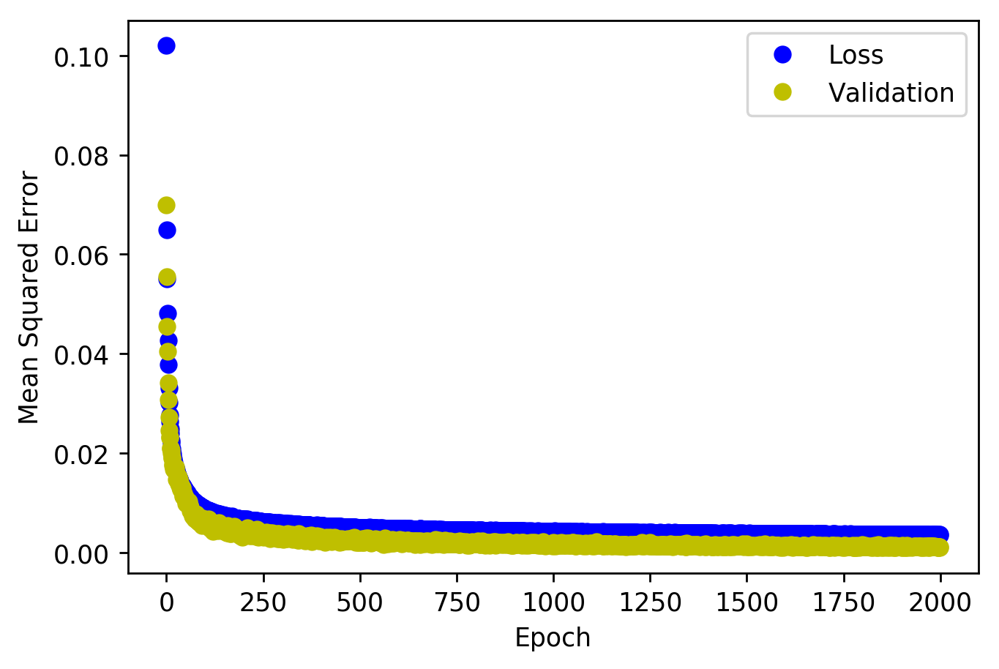

<Figure size 432x288 with 0 Axes>

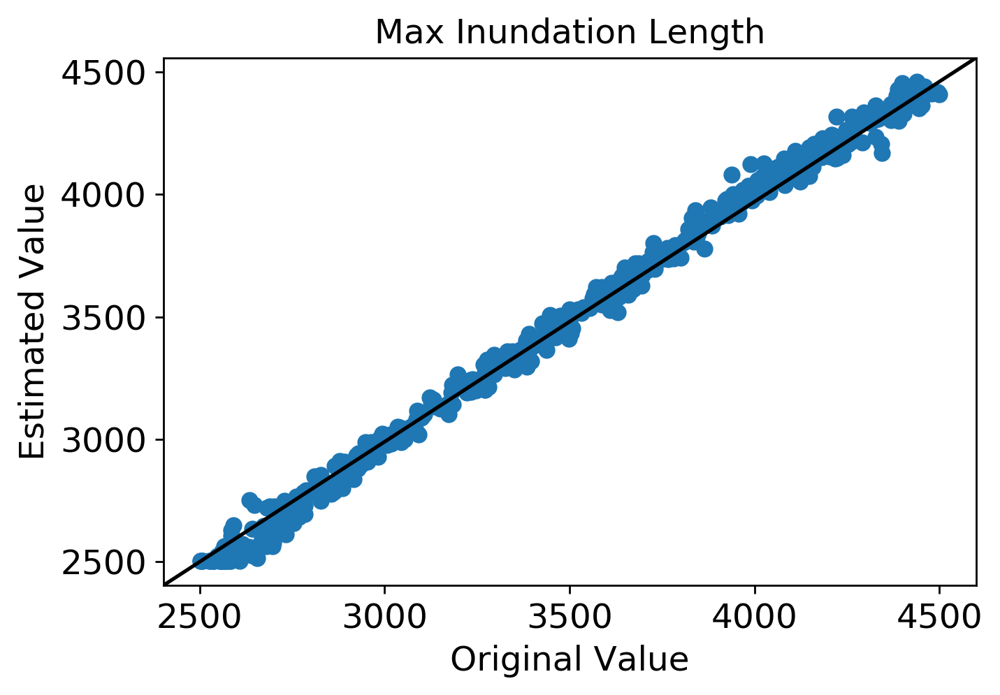

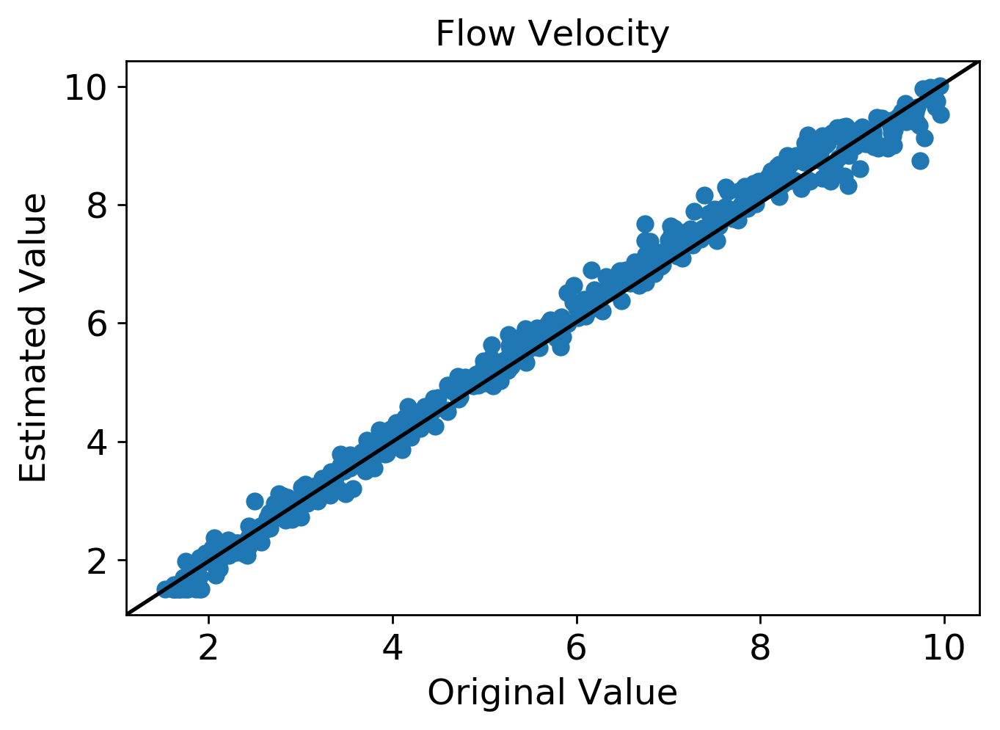

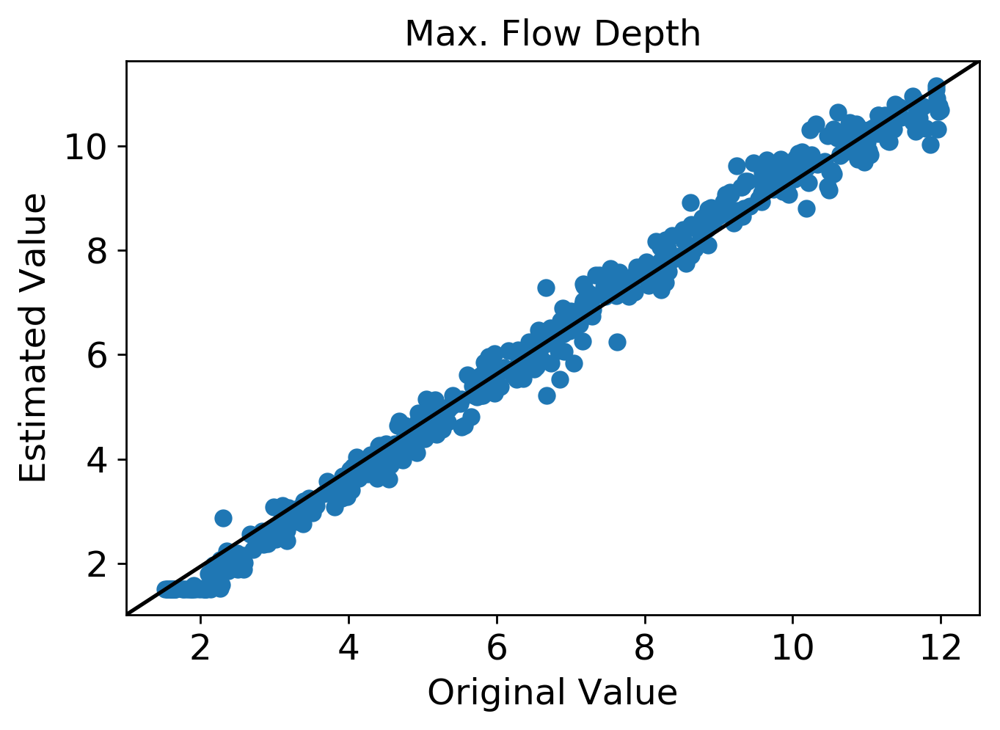

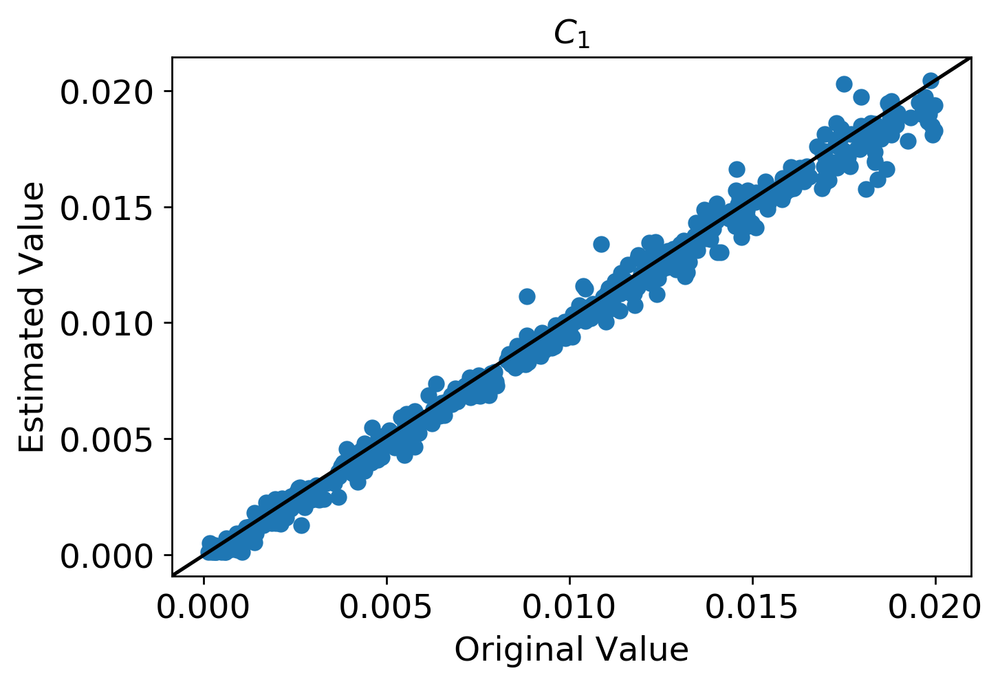

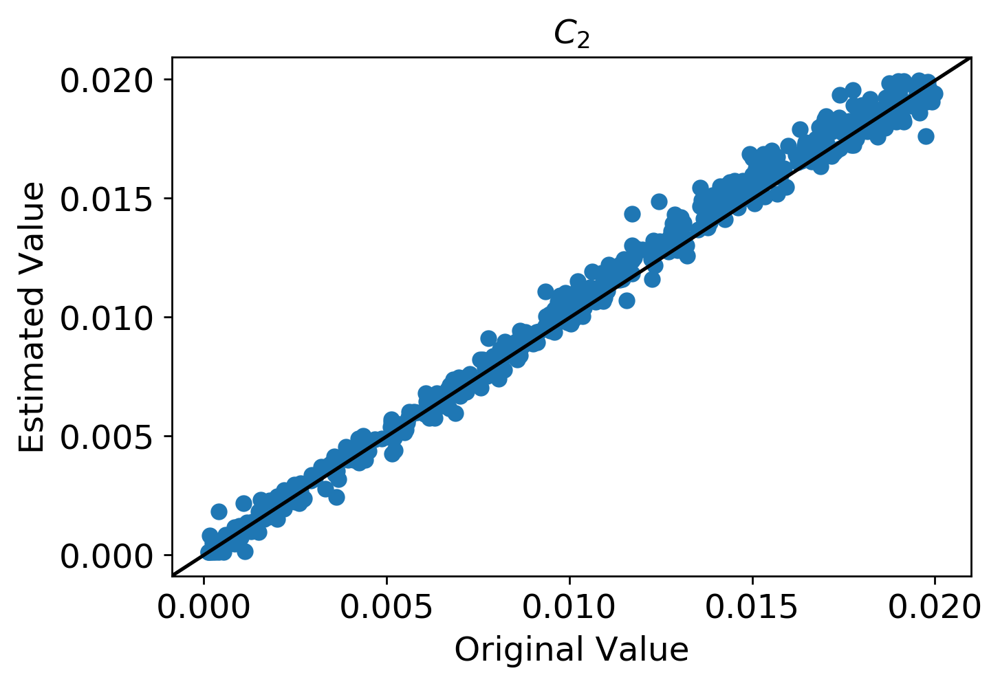

...

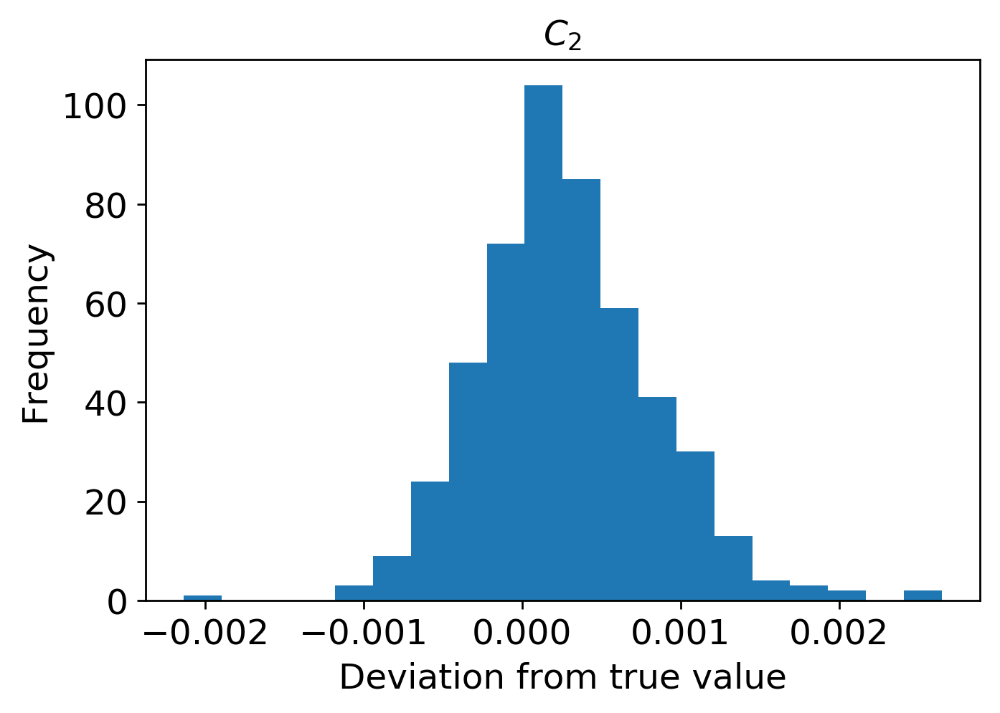

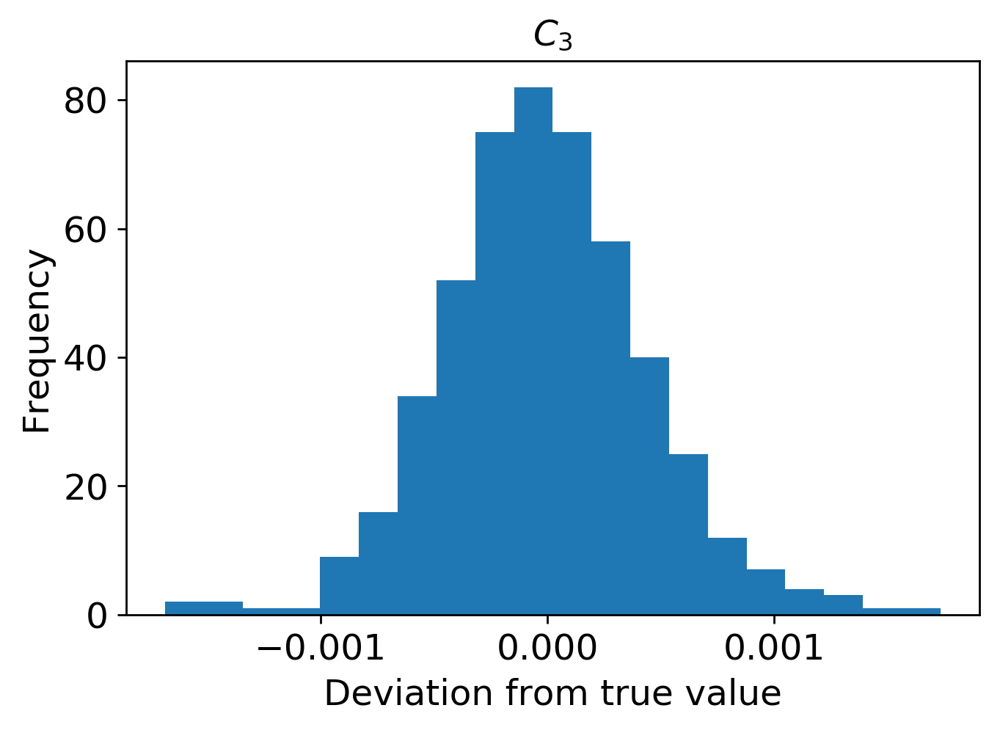

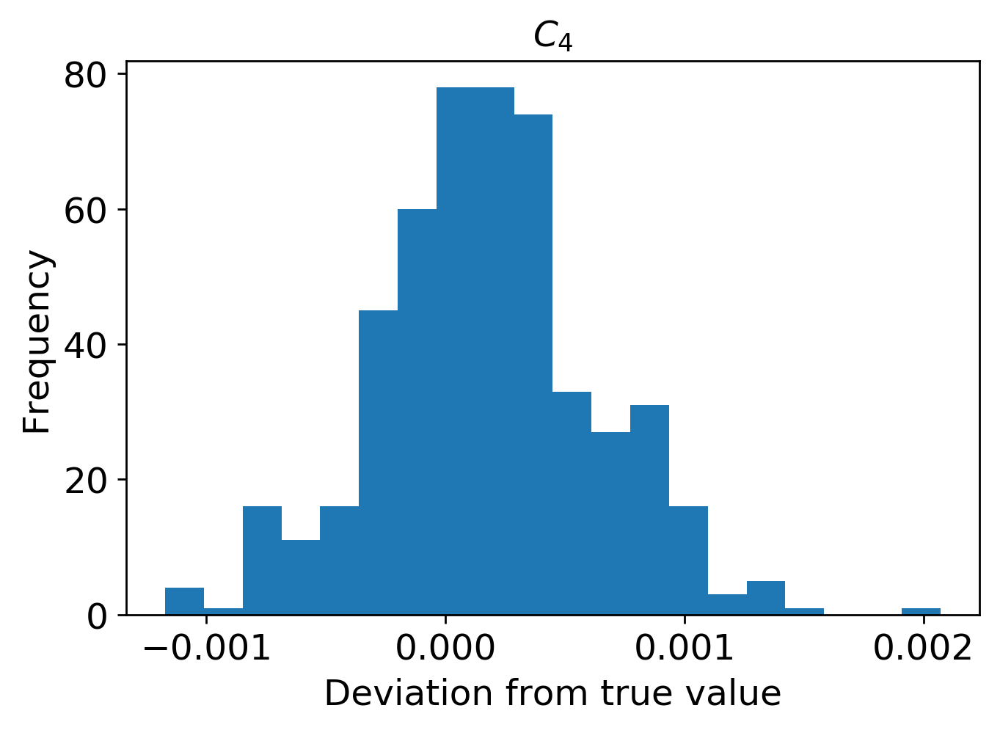

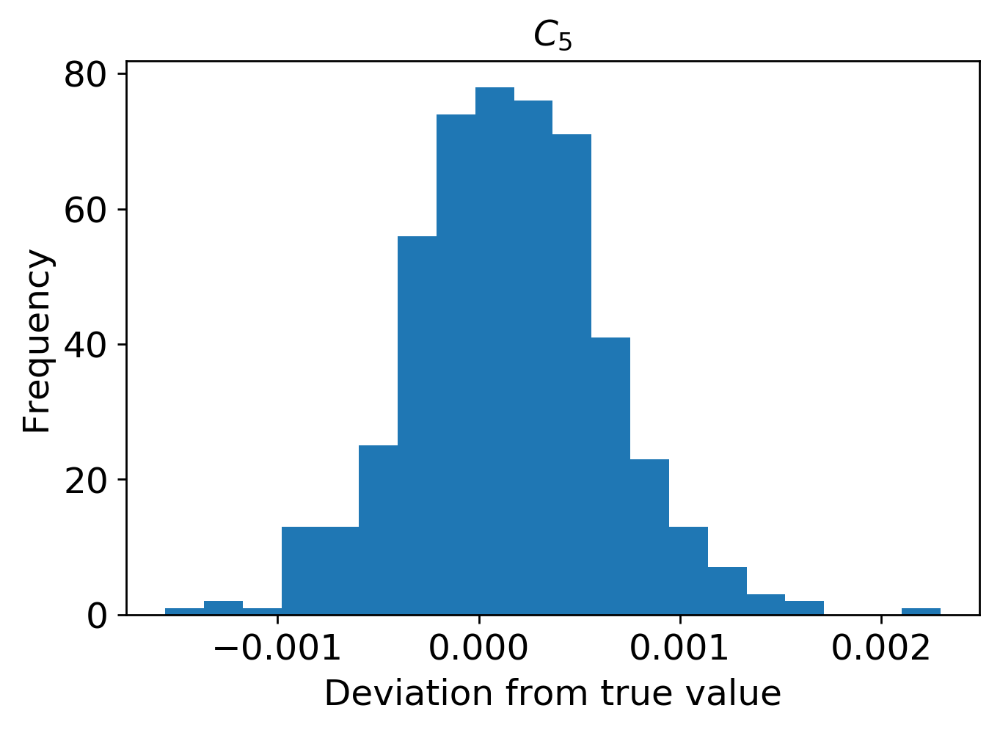

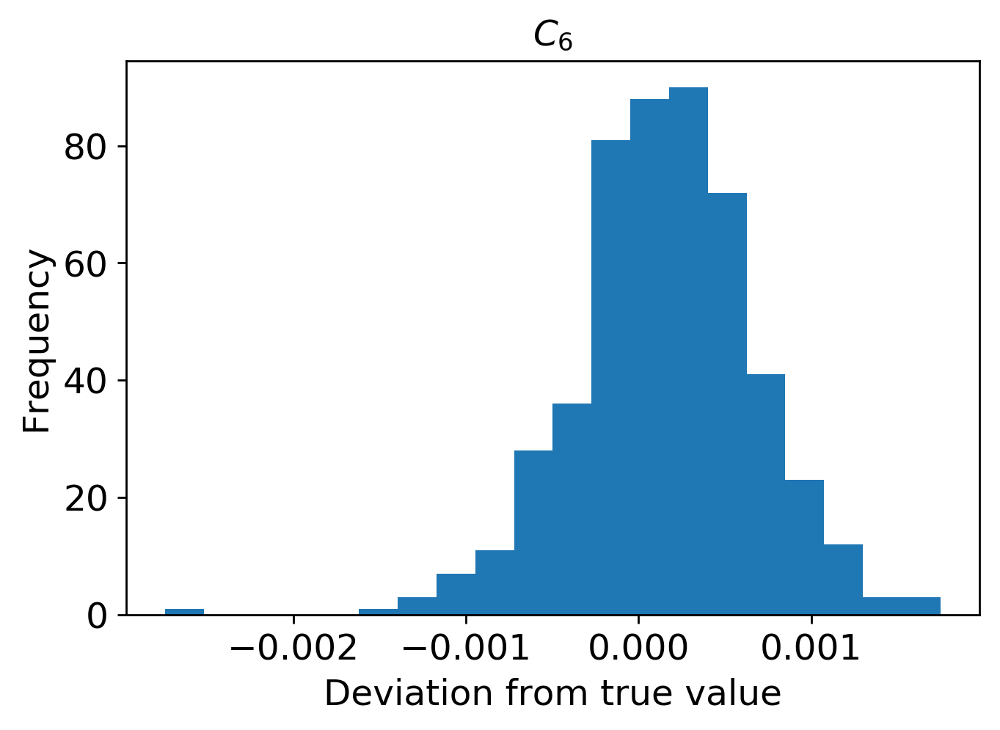

In [33]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi3700/'
resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi3700/4500/'

test_result = np.loadtxt(resdir + 'test_result.txt',delimiter=',')
icond = np.loadtxt(datadir + 'icond_test.txt',delimiter=',')
print(icond.shape)
loss = np.loadtxt(resdir+'loss.txt',delimiter=',')
epoch = range(0,2000)
vloss = np.loadtxt(resdir+'val_loss.txt',delimiter=',')
resi = test_result - icond

fig = plt.figure(num=None,dpi=250, facecolor='w', edgecolor='k')
plt.plot(epoch, loss, 'bo',label='Loss')
plt.plot(epoch, vloss, 'yo',label='Validation')
plt.xlabel('Epoch')
plt.ylabel('Mean Squared Error')
plt.legend(loc="upper right")
plt.savefig(resdir+ 'mse.eps')
plt.show()

fig2 = plt.figure()
hfont = {'fontname':'Century Gothic'}
textcol = 'k'
titlelabel = ['Max Inundation Length','Flow Velocity', 'Max. Flow Depth', '$C_1$', '$C_2$', '$C_3$', '$C_4$','$C_5$','$C_6$']


    
for i in range(len(titlelabel)):
    plt.figure(num=None,dpi=250, facecolor='w', edgecolor='k')
    plt.plot(icond[:,i],test_result[:,i],"o")
    x=icond[:,i]
    y=test_result[:,i]
    y_lim = plt.ylim()
    x_lim = plt.xlim()
    plt.plot(x_lim, y_lim, 'k-', color = 'k')
    plt.ylim(y_lim)
    plt.xlim(x_lim)
    plt.xlabel('Original Value',color=textcol,size=14,**hfont)
    plt.ylabel('Estimated Value',color=textcol,size=14,**hfont)
    plt.title(titlelabel[i],color=textcol,size=14,**hfont)
    plt.tick_params(labelsize=14,colors=textcol)
    plt.savefig(resdir+titlelabel[i] + '.eps')
    #plt.show()

for i in range(len(titlelabel)):
    plt.figure(num=None,dpi=250, facecolor='w', edgecolor='k')
    plt.hist(resi[:,i],bins=20)
    plt.title(titlelabel[i],color=textcol,size=14,**hfont)
    plt.xlabel('Deviation from true value',color=textcol,size=14,**hfont)
    plt.ylabel('Frequency',color=textcol,size=14,**hfont)
    plt.tick_params(labelsize=14,colors=textcol)
    plt.savefig(resdir+titlelabel[i] + 'hist' + '.eps')
    plt.show()

       distance        g1        g2        g3        g4        g5        g6
0      0.000000  0.036771  0.167260  0.114845  0.008449  0.002190  0.005161
1    103.794102  0.000000  0.075200  0.153283  0.013753  0.001885  0.000442
2    171.620654  0.002130  0.051171  0.084309  0.006218  0.001867  0.002843
3    397.112167  0.003115  0.016359  0.078858  0.011466  0.000597  0.000054
4    595.912969  0.000732  0.016896  0.028720  0.002661  0.000914  0.000000
5    707.625749  0.000143  0.002228  0.005502  0.000900  0.000187  0.000104
6    796.435078  0.000236  0.004337  0.021204  0.003169  0.000309  0.000080
7    895.065500  0.001688  0.016059  0.081413  0.020284  0.006824  0.004628
8    988.394177  0.004567  0.008166  0.074658  0.016913  0.002424  0.001580
9   1081.819325  0.001567  0.016305  0.060234  0.011086  0.004165  0.001994
10  1195.756993  0.001022  0.002370  0.017565  0.004194  0.000567  0.000142
11  1290.372534  0.000000  0.004121  0.057974  0.014565  0.000426  0.000213
12  1400.896

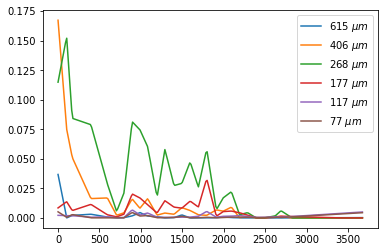

In [2]:
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.models import load_model
from scipy import stats
from scipy.interpolate import interp1d 
import pandas as pd
from pykrige import OrdinaryKriging as OK
import ipdb


datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi3700/'
resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi3700/4500/'
#Initial setting
if not "model" in locals(): 
    model = load_model(resdir+'model3.hdf5')
#gclass = 3
#gclass_label = ["500 $\mu$m","125 $\mu$m","63 $\mu$m"]
gclass = 6
gclass_label = ["615 ${\mu}m$","406 ${\mu}m$","268 ${\mu}m$","177 ${\mu}m$", "117 ${\mu}m$","77 ${\mu}m$"]
topodx = 15.0
coord_num = int(model.layers[0].input_shape[1]/gclass)

#Acquires a value for normalizing input data to [0, 1]
min_x, max_x = np.loadtxt(datadir + 'x_minmax.txt',delimiter=',')
y_min = np.loadtxt(datadir + 'icond_min.txt',delimiter=',')
y_max = np.loadtxt(datadir + 'icond_max.txt',delimiter=',')

#Read outcrop data
#dist_max = 22000. #Distance of distal end of learning data
outcrop = pd.read_csv('../FITTNUSS-forward_training_DNN/sendai_increased_class_edit.csv')
#outcrop = pd.read_csv('../DeepLearningTurbidite_Fukuda/GA_naruse_v2.csv')
#outcrop = outcrop.append(pd.DataFrame([[0,'Loc0',0,0,0],[dist_max,'LocE',0,0,0]], columns=outcrop.columns))
outcrop = outcrop.sort_values('distance')
outcrop['distance'] = outcrop['distance'] - 0
#d = pd.DataFrame(np.zeros((1, 7)),columns=['distance', 'g1','g2','g3','g4','g5','g6'])
#print(d)
#v=np.concatenate((outcrop, d))
#print(v)
#outcrop=pd.DataFrame(v,columns=['distance', 'g1','g2','g3','g4','g5','g6'])
#outcrop['distance'].iloc[-1]=4000
#outcrop = outcrop.append(pd.DataFrame([[0,'Loc0',0,0,0,0]], columns=outcrop.columns))
print(outcrop)

#Preparation under interpolation
thick_interp = np.zeros([1,coord_num*gclass])#補間されたサンプル厚さデータ
outcrop_x_id = np.round(outcrop['distance']/topodx).astype(np.int32) #逆解析システムでのサンプリング地点のindex番号
x = np.arange(0,coord_num*topodx,topodx)

#Complement data
for j in range(gclass):
    f = interp1d(outcrop['distance'],outcrop.iloc[:,j+1], kind="linear",bounds_error=False,fill_value='extrapolate')
    #f = interp1d(outcrop['distance'],outcrop.iloc[:,j+2], kind="linear",bounds_error=False,fill_value='extrapolate') 
    #Interpolation function of jth granularity level
    thick_interp[0,coord_num*j:coord_num*(j+1)] = f(x) #Supplemented data

#ipdb.set_trace()
#Kriging Interpolation by
#vparams = np.array([[0.035, 10000., 0.001],[0.006, 10000., 0.002],[0.005, 10000., 0.002],[0.035, 10000., 0.001]])
#for j in range(gclass):
    #okip = OK(outcrop['distance'],np.zeros(outcrop['distance'].shape),outcrop.iloc[:,j+1],variogram_model='gaussian',)
    #okip.display_variogram_model()
    #ipdata, ipstd = okip.execute('grid',x,np.array([0.]))
    #ipdata = np.squeeze(ipdata)
    #thick_interp[0,coord_num*j:coord_num*(j+1)] = ipdata #Assign complemented d

#Normalize data
thick_interp[thick_interp < 0] = 0
thick_interp_norm =  (thick_interp - min_x) / (max_x - min_x)

#Perform inverse analysis
test_result_outcrop = model.predict(thick_interp_norm)
test_result_outcrop = test_result_outcrop * (y_max - y_min) + y_min
print(test_result_outcrop)
#add=np.array(3000)
#test_result_outcrop_add=np.concatenate((add,test_result_outcrop), axis=None)
#Output results
#print(test_result_outcrop_add)
np.savetxt('outcrop_result_g6_g300_H_5000_20_11_roi3700.txt',test_result_outcrop, delimiter=',')
for i in range(len(gclass_label)):
    plt.plot(x,thick_interp[0,coord_num * i:coord_num * (i+1)],label=gclass_label[i])
plt.legend()
plt.show()



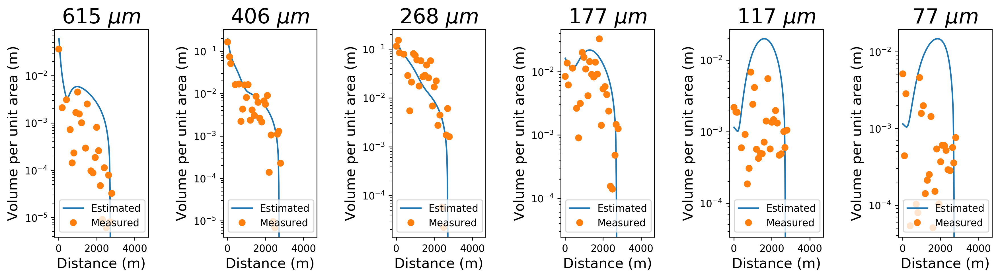

In [35]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import Forward_model_modified_FITTNUSS_5000_g6_300grid_19_11_case2 as fmodel
import time
import ipdb
%matplotlib inline

#Basic setting

#dist_max = 3000.
gclass = 6
topodx=15.0
gclass_name = ['615microm','406microm','268microm','177microm','117microm','77microm']
#gclass_name = ['500micron', '125micron', '63micron']
gname_tex = ["615 ${\mu}m$","406 ${\mu}m$","268 ${\mu}m$","177 ${\mu}m$", "117 ${\mu}m$","77 ${\mu}m$"]
#gname_tex = ['500 $\mu$m','125 $\mu$m','63 $\mu$m']
#calcdir = 'home/rimali2009/FITTNUSS-forward_training_DNN/'
#calcdir = '/home/naruse/Documents/Documents/MATLAB/TCtrainData_forML/TCModel_for_MLTEST/test_output_otadai07/'

#Load estimate
#H1 = np.loadtxt(calcdir + 'H1.txt',delimiter=',')
#H2 = np.loadtxt(calcdir + 'H2.txt',delimiter=',')
#H3 = np.loadtxt(calcdir + 'H3.txt',delimiter=',')
#H4 = np.loadtxt(calcdir + 'H4.txt',delimiter=',')
#Ht = np.loadtxt(calcdir + 'Ht.txt',delimiter=',')
#U = np.loadtxt(calcdir + 'U.txt',delimiter=',')
#xi = np.loadtxt(calcdir + 'xi.txt',delimiter=',')
#x = np.loadtxt(calcdir + 'x.txt',delimiter=',')
#x_bed = np.loadtxt(calcdir + 'x_init.txt',delimiter=',')
#eta_init = np.loadtxt(calcdir + 'eta_init.txt',delimiter=',')
#Ct = np.loadtxt(calcdir + 'Ct.txt',delimiter=',')
#time = np.loadtxt(calcdir + 'time.txt',delimiter=',')
estimated_icond=np.loadtxt('outcrop_result_g6_g300_H_5000_20_11_roi3700.txt', delimiter=',')
start = time.time()
fmodel.read_setfile("config_g6_300grid_19_11_case2.ini")
(x,C,x_dep,deposit) = fmodel.forward(estimated_icond)
np.savetxt('eta_estimated_thickness_5K_g6_TC4_Rwcnst_H_5000_20_11_roi3700.csv', deposit, delimiter=',')
np.savetxt('eta_estimated_Distance_5K_g6_TC4_Rwcnst_H_5000_20_11_roi3700.csv', x_dep,delimiter=',')
estimated_dep_thickness_5000=np.transpose(np.loadtxt('/home/rimali2009/FITTNUSS-forward_training_DNN/'+'eta_estimated_thickness_5K_g6_TC4_Rwcnst_H_5000_20_11_roi3700.csv', delimiter=','))
estimated_dep_thickness_5000=pd.DataFrame(estimated_dep_thickness_5000,columns=['615microm','406microm','268microm','177microm','117microm','77microm'])
estimated_dep_distance_5000=np.transpose(np.loadtxt('/home/rimali2009/FITTNUSS-forward_training_DNN/'+'eta_estimated_Distance_5K_g6_TC4_Rwcnst_H_5000_20_11_roi3700.csv', delimiter=','))
estimated_dep_distance_5000=pd.DataFrame(estimated_dep_distance_5000,columns=['distance'])
estimated_dep_5000=pd.concat([estimated_dep_distance_5000,estimated_dep_thickness_5000],axis=1)
np.savetxt('estimated_dep_5K_g6_TC4_Rwcnst_H_5000_20_11_roi3700.csv',estimated_dep_5000,delimiter=',')
#data_estim=pd.DataFrame(estimated_dep_5000,columns=['distance','1.5phi','2.5phi','3.5phi','4.5phi'])

#Formatting the loaded data
#estimated_dep_df = pd.DataFrame(estimated_dep,columns=['distance','1.5phi','2.5phi','3.5phi','4.5phi'])
#estimated_dep = pd.DataFrame(np.array([x_bed - dist_offset,H1[-1,:],H2[-1,:],H3[-1,:]]).T,columns=['distance','500micron','125micron','63micron'])
estimated_dep_5000= estimated_dep_5000.query('distance > 0')
#estimated_dep_5000 = estimated_dep_5000.query('distance < {}'.format(dist_max))

#Read original data
outcrop = pd.read_csv('../FITTNUSS-forward_training_DNN/sendai_increased_class.csv')
outcrop= pd.DataFrame(outcrop,columns=['distance','615microm','406microm','268microm','177microm','117microm','77microm'])
#outcrop = pd.read_csv('../DeepLearningTurbidite_Fukuda/GA_naruse_v2.csv')
#outcrop = outcrop.append(pd.DataFrame([[0,'Loc0',0,0,0],[dist_max,'LocE',0,0,0]], columns=outcrop.columns))
#outcrop = outcrop.sort_values('distance')
#outcrop['distance'] = outcrop['distance'] - 1000

#Plot
plt.figure(num=None, figsize=(17, 4), dpi=250, facecolor='w', edgecolor='g')
hfont = {'fontname':'Sans'}
plt.subplots_adjust(bottom=0.15, wspace=0.8)

for i in range(gclass):
    plt.subplot(1,gclass,i+1)
    plt.plot(estimated_dep_5000['distance'],estimated_dep_5000[gclass_name[i]],'-', label='Estimated')
    plt.plot(outcrop['distance'], outcrop[gclass_name[i]],'o', label='Measured')
    plt.yscale('log')
    plt.title(gname_tex[i], size=21,**hfont)
    plt.xlabel('Distance (m)', size = 14, **hfont)
    plt.ylabel('Volume per unit area (m)', size = 14, **hfont)
    plt.legend(fontsize=10)
    plt.savefig("thickness_distance_curve_5000_g6_300grid_H_5000_20_11_roi3700.png")
    plt.savefig("thickness_distance_curve_5000_g6_300grid_H_5000_20_11_roi3700.eps")
plt.show()



Using TensorFlow backend.


       distance        g1        g2        g3        g4        g5        g6
0      0.000000  0.036771  0.167260  0.114845  0.008449  0.002190  0.005161
1    103.794102  0.000000  0.075200  0.153283  0.013753  0.001885  0.000442
2    171.620654  0.002130  0.051171  0.084309  0.006218  0.001867  0.002843
3    397.112167  0.003115  0.016359  0.078858  0.011466  0.000597  0.000054
4    595.912969  0.000732  0.016896  0.028720  0.002661  0.000914  0.000000
5    707.625749  0.000143  0.002228  0.005502  0.000900  0.000187  0.000104
6    796.435078  0.000236  0.004337  0.021204  0.003169  0.000309  0.000080
7    895.065500  0.001688  0.016059  0.081413  0.020284  0.006824  0.004628
8    988.394177  0.004567  0.008166  0.074658  0.016913  0.002424  0.001580
9   1081.819325  0.001567  0.016305  0.060234  0.011086  0.004165  0.001994
10  1195.756993  0.001022  0.002370  0.017565  0.004194  0.000567  0.000142
11  1290.372534  0.000000  0.004121  0.057974  0.014565  0.000426  0.000213
12  1400.896

(1, 9)
[[2.72987501e+03 5.03635829e+00 7.00212887e+00 6.04116911e-03
  1.86205638e-02 1.47430762e-02 1.44466301e-03 1.01360960e-04
  1.00773694e-04]]
       distance        g1        g2        g3        g4        g5        g6
0      0.000000  0.036771  0.167260  0.114845  0.008449  0.002190  0.005161
1    103.794102  0.000000  0.075200  0.153283  0.013753  0.001885  0.000442
2    171.620654  0.002130  0.051171  0.084309  0.006218  0.001867  0.002843
3    397.112167  0.003115  0.016359  0.078858  0.011466  0.000597  0.000054
4    595.912969  0.000732  0.016896  0.028720  0.002661  0.000914  0.000000
5    707.625749  0.000143  0.002228  0.005502  0.000900  0.000187  0.000104
6    796.435078  0.000236  0.004337  0.021204  0.003169  0.000309  0.000080
7    895.065500  0.001688  0.016059  0.081413  0.020284  0.006824  0.004628
8    988.394177  0.004567  0.008166  0.074658  0.016913  0.002424  0.001580
9   1195.756993  0.001022  0.002370  0.017565  0.004194  0.000567  0.000142
10  1290.37253

/home/rimali2009/anaconda3/envs/test3/lib/python3.6/site-packages/matplotlib/font_manager.py:1241: UserWarning: findfont: Font family ['Century Gothic'] not found. Falling back to DejaVu Sans.
  (prop.get_family(), self.defaultFamily[fontext]))


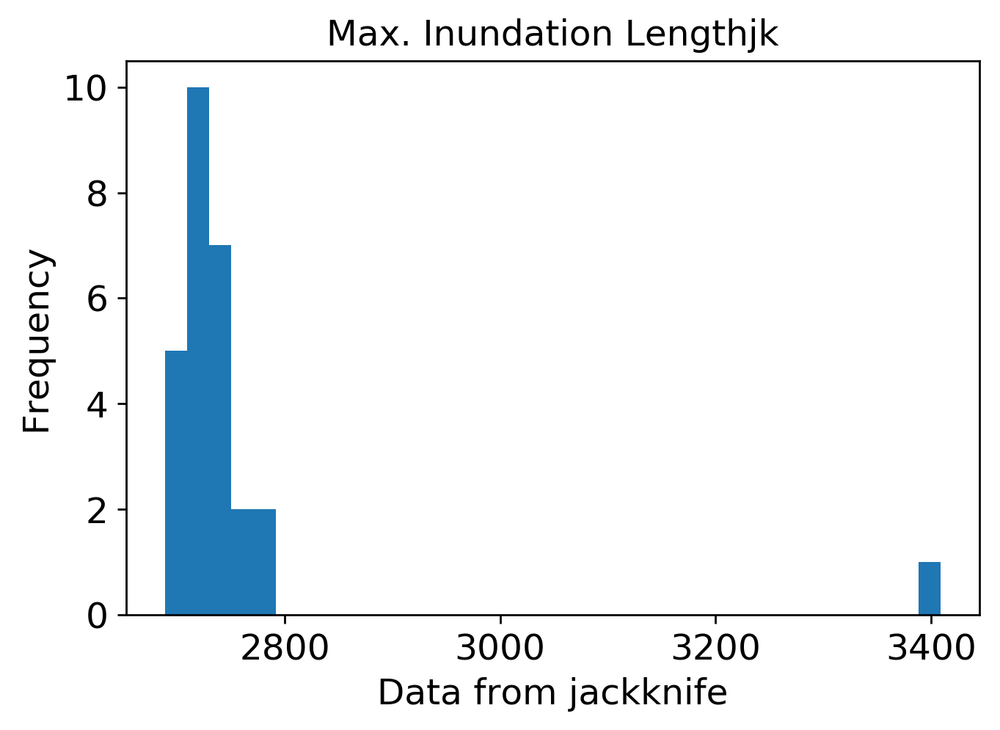

mean: 5.146851482054422
jk_e: 0.10093684838153029


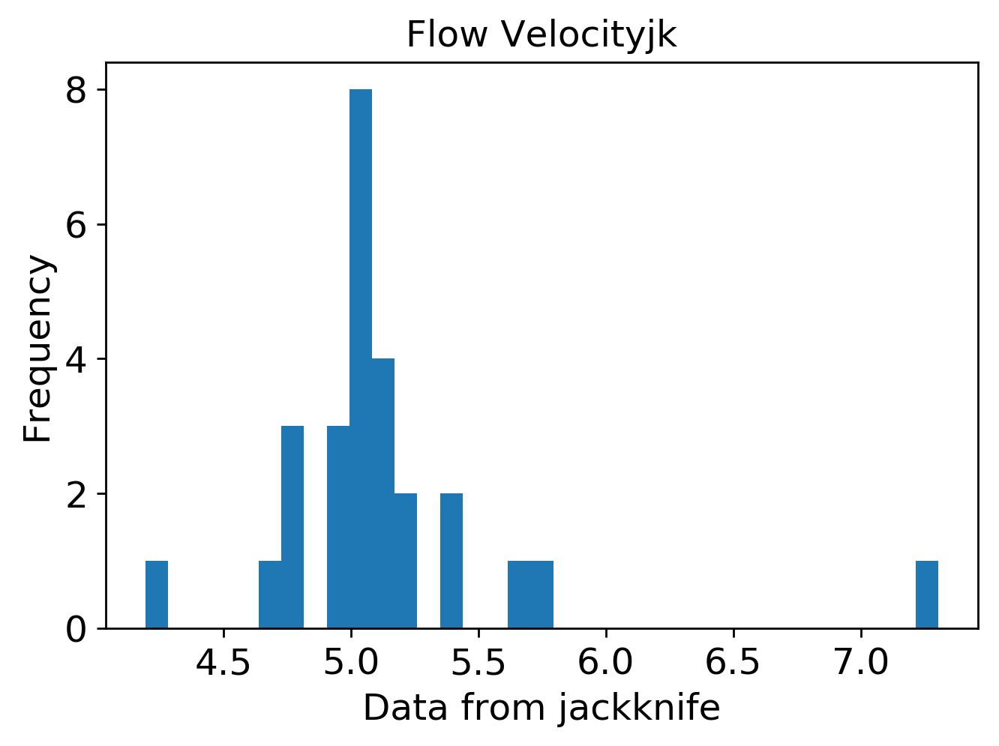

mean: 6.781534055599161
jk_e: 0.16512379736835933


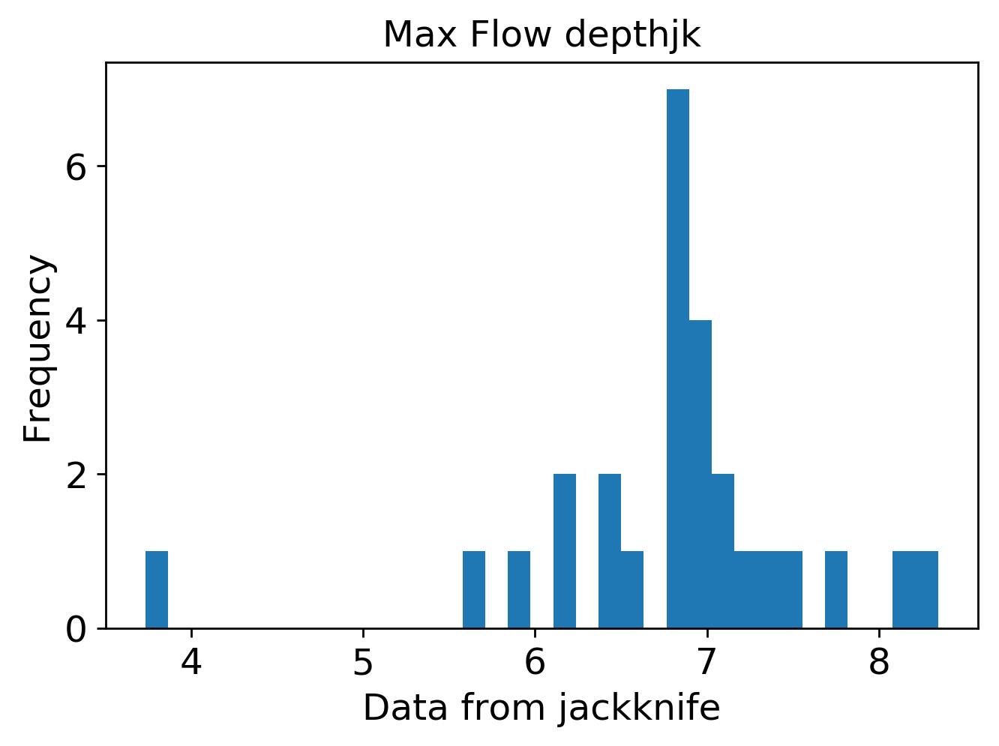

mean: 0.006003336954917237
jk_e: 0.00016319247625548044


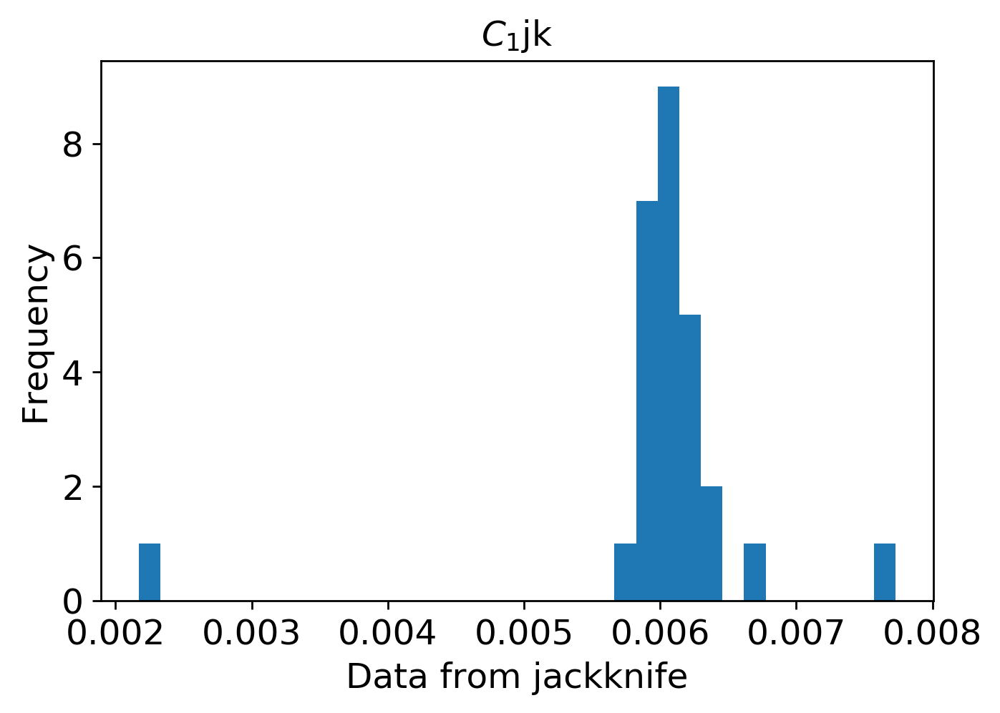

mean: 0.01885448529860316
jk_e: 0.0003562853531147928


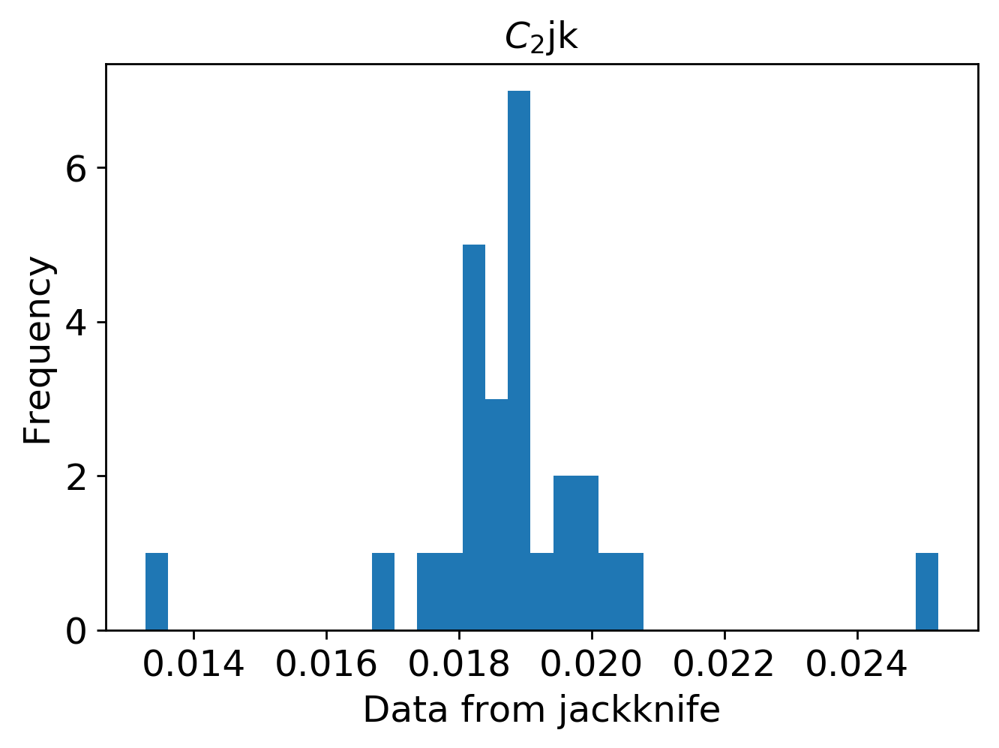

mean: 0.01530577001058174
jk_e: 0.0003624712042719416


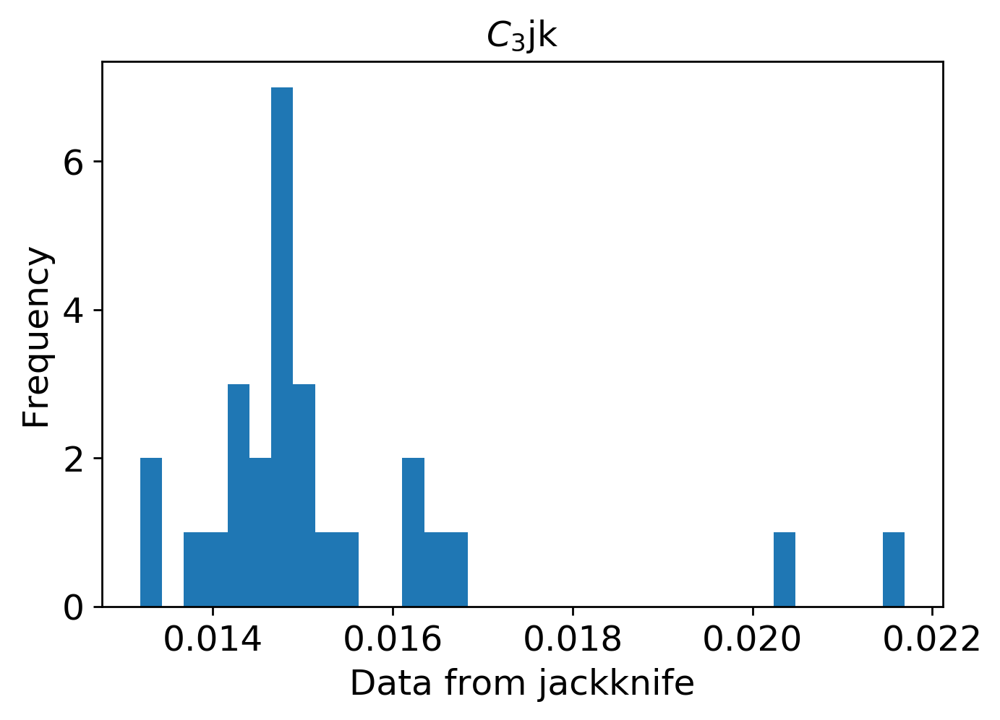

mean: 0.0015389813242823595
jk_e: 6.786981979312028e-05


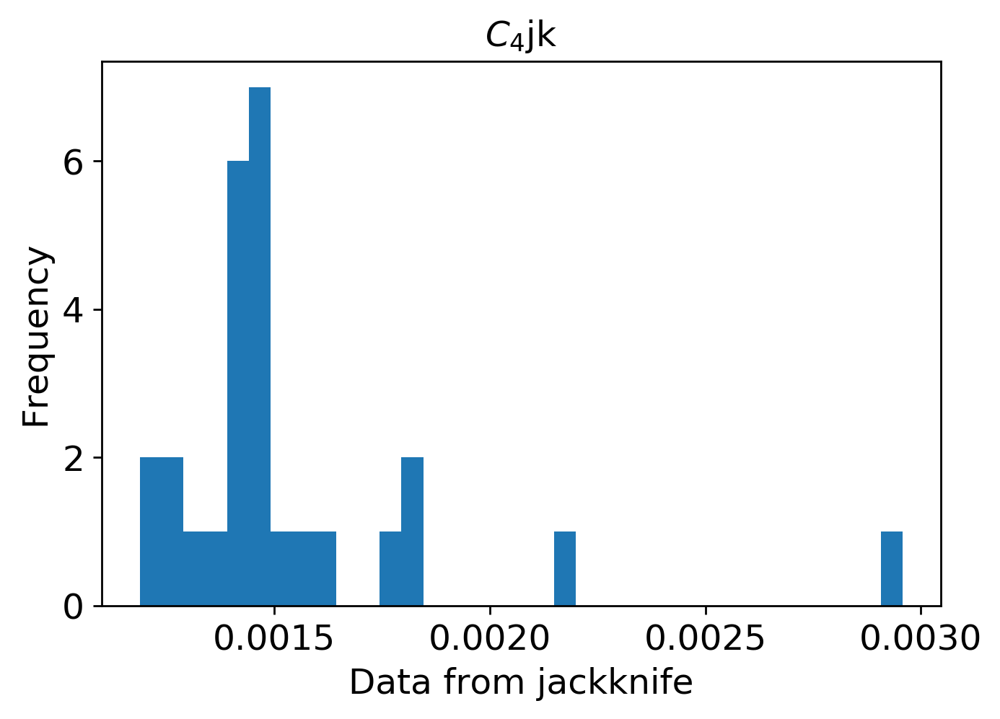

mean: 0.00018010418520952954
jk_e: 7.227568286569287e-05


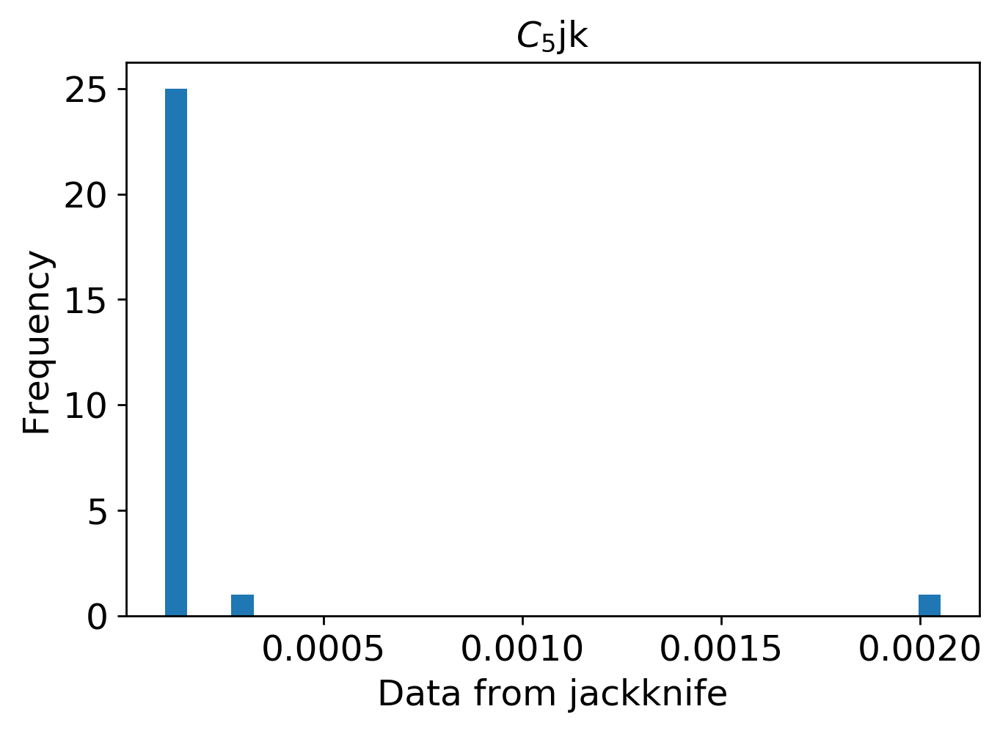

mean: 0.0001403457753701348
jk_e: 2.084734734919706e-05


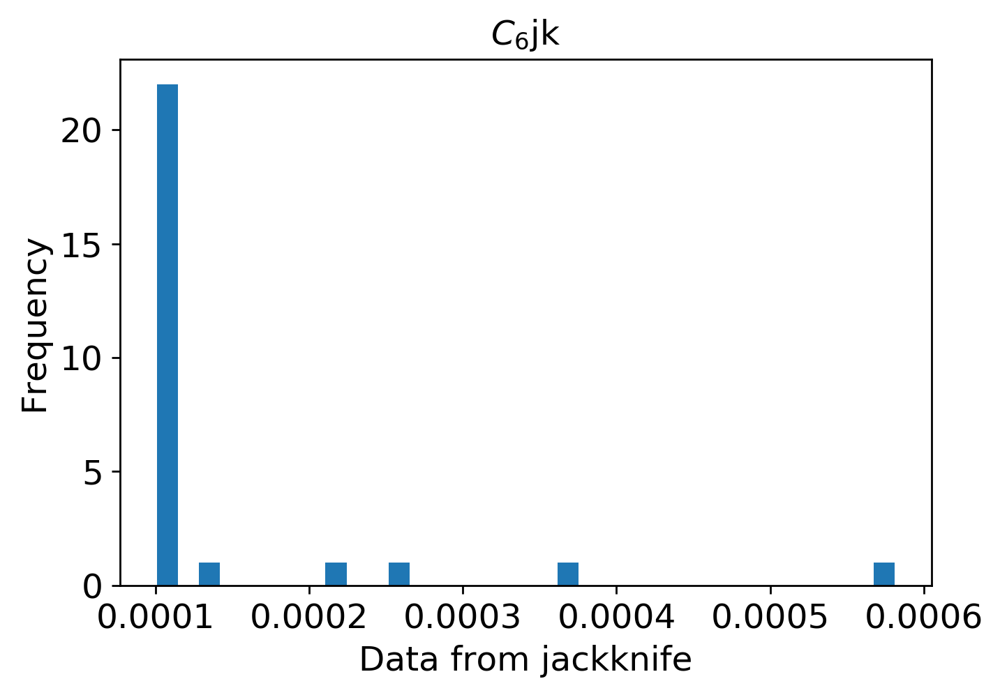

In [1]:
# Jackknife Method
import csv
import numpy as np
import pandas as pd
import math
from keras.models import load_model
from scipy.interpolate import interp1d
import matplotlib.pyplot as plt
%matplotlib inline

datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi3700/'
resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi3700/4500/'
# Initial setting
if not "model" in locals():
    model = load_model(resdir+'model3.hdf5')
gclass = 6
gclass_label = ["615 ${\mu}m$", "406 ${\mu}m$", "268 ${\mu}m$",
                "177 ${\mu}m$", "117 ${\mu}m$", "77 ${\mu}m$"]
topodx = 15.0
coord_num = int(model.layers[0].input_shape[1]/gclass)
min_x, max_x = np.loadtxt(datadir + 'x_minmax.txt', delimiter=',')
y_min = np.loadtxt(datadir + 'icond_min.txt', delimiter=',')
y_max = np.loadtxt(datadir + 'icond_max.txt', delimiter=',')


a = pd.read_csv(
    '../FITTNUSS-forward_training_DNN/sendai_increased_class_edit.csv', delimiter=',')
print(a)
y = pd.DataFrame()
output = []

with open('output_final_20_11_roi3700.csv', 'w') as outfile:

    # x=[]
    for index in range(len(a)):
        df = y.append(pd.read_csv(
            '../FITTNUSS-forward_training_DNN/sendai_increased_class_edit.csv', skiprows=[index+1]))
        print(df)
        df = df.sort_values('distance')
        thick_interp = np.zeros([1, coord_num*gclass])
        x = np.arange(0, coord_num*topodx, topodx)
        for j in range(gclass):
            # Interpolation function of jth granularity level
            f = interp1d(df['distance'], df.iloc[:, j+1],
                         kind="linear", bounds_error=False,fill_value='extrapolate')
            thick_interp[0, coord_num*j:coord_num*(j+1)] = f(x)
        thick_interp[thick_interp < 0] = 0
        thick_interp_norm = (thick_interp - min_x) / (max_x - min_x)
        test_result_outcrop = model.predict(thick_interp_norm)
        test_result_outcrop = test_result_outcrop * (y_max - y_min) + y_min
        print(test_result_outcrop.shape)
        print(test_result_outcrop)
    # output.append(test_result_outcrop)
        np.savetxt(outfile,test_result_outcrop, delimiter=',')
        # outfile.write('# New iteration\n')
hfont = {'fontname': 'Century Gothic'}
textcol = 'k'
resi = np.loadtxt('output_final_20_11_roi3700.csv', delimiter=',')
titlelabel = ['Max. Inundation Lengthjk','Flow Velocityjk', 'Max Flow depthjk',
              '$C_1$jk', '$C_2$jk', '$C_3$jk', '$C_4$jk', '$C_5$jk', '$C_6$jk']
jk_er=[]
with open('jk_e_roi3700.txt','wb') as ftext:
    for i in range(len(titlelabel)):
        plt.figure(num=None, dpi=250, facecolor='w', edgecolor='k')
        plt.hist(resi[:, i], bins=35)
        mean = sum(resi[:,i]) / len(resi[:,i])
        print("mean:",mean)
        var_jk  = sum(pow(x-mean,2) for x in resi[:,i]) / ((len(resi[:,i])-1)*(len(resi[:,i])))
        jk_e= math.sqrt(var_jk)
        print("jk_e:",jk_e)
        e=np.append(jk_e,jk_er)
        np.savetxt(ftext,e,delimiter=',')
        plt.title(titlelabel[i], color=textcol, size=14, **hfont)
        plt.xlabel('Data from jackknife', color=textcol, size=14, **hfont)
        plt.ylabel('Frequency', color=textcol, size=14, **hfont)
        plt.tick_params(labelsize=14, colors=textcol)
        plt.savefig(resdir+titlelabel[i] + 'jkhist' + '.eps')
        plt.show()


# ROI 3800

In [37]:
import numpy as np
import os
#import ipdb

def connect_dataset(file_list, icond_file_list, outputdir,
                    topodx=15, roi=2500, offset=5000,gclass_num=6,test_data_num=500):
    """
    複数のデータセットを連結する
    """
    #ipdb.set_trace()
    
    #Reading and combining files Decide start and end points of the learning area and convert them to grid numbers
    H = np.loadtxt(file_list[0], delimiter = ',')
    icond = np.loadtxt(icond_file_list[0], delimiter = ',')
    
    #Reading and combining files
    if len(file_list) > 1:
        for i in range(1, len(file_list)):
            H_temp = np.loadtxt(file_list[i], delimiter = ',')
            icond_temp = np.loadtxt(icond_file_list[i], delimiter = ',')
            H = np.concatenate((H,H_temp),axis=0)
            icond = np.concatenate((icond,icond_temp),axis = 0)
    
    roi_grids = int(roi / topodx)
    num_grids = int(H.shape[1] / gclass_num)
    H_subset = np.zeros([H.shape[0], roi_grids * gclass_num])
    for i in range(gclass_num):
        H_subset[:, i*roi_grids:(i+1)*roi_grids] = H[:, i*num_grids:(i*num_grids+roi_grids)]
    
    #Obtain the maximum and minimum values of data
    max_x = np.max(H_subset)
    min_x = np.min(H_subset)
    icond_max = np.max(icond, axis=0)
    icond_min = np.min(icond, axis=0)
    
    #Split the data into tests and training
    H_train = H_subset[0:-test_data_num,:]
    H_test = H_subset[H_subset.shape[0] - test_data_num:,:]
    icond_train = icond[0:-test_data_num,:]
    icond_test = icond[H.shape[0] - test_data_num:,:]
    
    #Save the data
    if not os.path.exists(outputdir):
        os.mkdir(outputdir)
    np.savetxt(outputdir + '/x_train.txt',H_train,delimiter = ',')
    np.savetxt(outputdir + '/x_test.txt',H_test,delimiter = ',')
    np.savetxt(outputdir + '/icond_train.txt',icond_train,delimiter = ',')
    np.savetxt(outputdir + '/icond_test.txt',icond_test,delimiter = ',')
    np.savetxt(outputdir + '/icond_min.txt',icond_min,delimiter = ',')
    np.savetxt(outputdir + '/icond_max.txt',icond_max,delimiter = ',')
    np.savetxt(outputdir + '/x_minmax.txt',[min_x, max_x],delimiter = ',')
    
    
if __name__=="__main__":
    original_data_dir = "/home/rimali2009/FITTNUSS-forward_training_DNN"
    parent_dir = "/home/rimali2009/FITTNUSS-forward_training_DNN"
    if not os.path.exists(parent_dir):
        os.mkdir(parent_dir)
    outputdir = parent_dir + "/data_g6_300grid_H_5000_20_11_roi3800"
    file_list = ['/home/rimali2009/FITTNUSS-forward_training_DNN/eta_5000_g6_300grid_19_11.csv']
    initial_conditions = ['/home/rimali2009/FITTNUSS-forward_training_DNN/start_param_random_5000_g6_300grid_19_11.csv']
connect_dataset(file_list, initial_conditions, outputdir, test_data_num=500, gclass_num=6, topodx=15., roi=3800)
        
        
    

Train on 3600 samples, validate on 900 samples
Epoch 1/2000
3600/3600 [==============================] - 2s 508us/step - loss: 0.0956 - mean_squared_error: 0.0956 - val_loss: 0.0696 - val_mean_squared_error: 0.0696
Epoch 2/2000
3600/3600 [==============================] - 1s 391us/step - loss: 0.0641 - mean_squared_error: 0.0641 - val_loss: 0.0549 - val_mean_squared_error: 0.0549
Epoch 3/2000
3600/3600 [==============================] - 2s 427us/step - loss: 0.0549 - mean_squared_error: 0.0549 - val_loss: 0.0465 - val_mean_squared_error: 0.0465
Epoch 4/2000
3600/3600 [==============================] - 1s 383us/step - loss: 0.0480 - mean_squared_error: 0.0480 - val_loss: 0.0403 - val_mean_squared_error: 0.0403
Epoch 5/2000
3600/3600 [==============================] - 2s 424us/step - loss: 0.0425 - mean_squared_error: 0.0425 - val_loss: 0.0346 - val_mean_squared_error: 0.0346
Epoch 6/2000
3600/3600 [==============================] - 1s 414us/step - loss: 0.0376 - mean_squared_error: 0.03

3600/3600 [==============================] - 1s 393us/step - loss: 0.0090 - mean_squared_error: 0.0090 - val_loss: 0.0060 - val_mean_squared_error: 0.0060
Epoch 98/2000
3600/3600 [==============================] - 1s 398us/step - loss: 0.0089 - mean_squared_error: 0.0089 - val_loss: 0.0057 - val_mean_squared_error: 0.0057
Epoch 99/2000
3600/3600 [==============================] - 1s 394us/step - loss: 0.0088 - mean_squared_error: 0.0088 - val_loss: 0.0057 - val_mean_squared_error: 0.0057
Epoch 100/2000
3600/3600 [==============================] - 1s 395us/step - loss: 0.0087 - mean_squared_error: 0.0087 - val_loss: 0.0058 - val_mean_squared_error: 0.0058
Epoch 101/2000
3600/3600 [==============================] - 1s 393us/step - loss: 0.0089 - mean_squared_error: 0.0089 - val_loss: 0.0060 - val_mean_squared_error: 0.0060
Epoch 102/2000
3600/3600 [==============================] - 2s 422us/step - loss: 0.0086 - mean_squared_error: 0.0086 - val_loss: 0.0052 - val_mean_squared_error: 0.00

3600/3600 [==============================] - 1s 409us/step - loss: 0.0068 - mean_squared_error: 0.0068 - val_loss: 0.0038 - val_mean_squared_error: 0.0038
Epoch 194/2000
3600/3600 [==============================] - 1s 414us/step - loss: 0.0067 - mean_squared_error: 0.0067 - val_loss: 0.0040 - val_mean_squared_error: 0.0040
Epoch 195/2000
3600/3600 [==============================] - 1s 402us/step - loss: 0.0067 - mean_squared_error: 0.0067 - val_loss: 0.0035 - val_mean_squared_error: 0.0035
Epoch 196/2000
3600/3600 [==============================] - 1s 412us/step - loss: 0.0067 - mean_squared_error: 0.0067 - val_loss: 0.0042 - val_mean_squared_error: 0.0042
Epoch 197/2000
3600/3600 [==============================] - 2s 434us/step - loss: 0.0067 - mean_squared_error: 0.0067 - val_loss: 0.0039 - val_mean_squared_error: 0.0039
Epoch 198/2000
3600/3600 [==============================] - 2s 425us/step - loss: 0.0068 - mean_squared_error: 0.0068 - val_loss: 0.0042 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 383us/step - loss: 0.0059 - mean_squared_error: 0.0059 - val_loss: 0.0032 - val_mean_squared_error: 0.0032
Epoch 290/2000
3600/3600 [==============================] - 1s 400us/step - loss: 0.0060 - mean_squared_error: 0.0060 - val_loss: 0.0030 - val_mean_squared_error: 0.0030
Epoch 291/2000
3600/3600 [==============================] - 1s 404us/step - loss: 0.0059 - mean_squared_error: 0.0059 - val_loss: 0.0032 - val_mean_squared_error: 0.0032
Epoch 292/2000
3600/3600 [==============================] - 2s 433us/step - loss: 0.0059 - mean_squared_error: 0.0059 - val_loss: 0.0029 - val_mean_squared_error: 0.0029
Epoch 293/2000
3600/3600 [==============================] - 2s 444us/step - loss: 0.0058 - mean_squared_error: 0.0058 - val_loss: 0.0034 - val_mean_squared_error: 0.0034
Epoch 294/2000
3600/3600 [==============================] - 1s 391us/step - loss: 0.0059 - mean_squared_error: 0.0059 - val_loss: 0.0032 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 405us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0031 - val_mean_squared_error: 0.0031
Epoch 386/2000
3600/3600 [==============================] - 1s 410us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0027 - val_mean_squared_error: 0.0027
Epoch 387/2000
3600/3600 [==============================] - 1s 381us/step - loss: 0.0055 - mean_squared_error: 0.0055 - val_loss: 0.0024 - val_mean_squared_error: 0.0024
Epoch 388/2000
3600/3600 [==============================] - 1s 401us/step - loss: 0.0055 - mean_squared_error: 0.0055 - val_loss: 0.0031 - val_mean_squared_error: 0.0031
Epoch 389/2000
3600/3600 [==============================] - 1s 394us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0029 - val_mean_squared_error: 0.0029
Epoch 390/2000
3600/3600 [==============================] - 1s 386us/step - loss: 0.0055 - mean_squared_error: 0.0055 - val_loss: 0.0029 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 388us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 482/2000
3600/3600 [==============================] - 1s 414us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0027 - val_mean_squared_error: 0.0027
Epoch 483/2000
3600/3600 [==============================] - 1s 396us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0021 - val_mean_squared_error: 0.0021
Epoch 484/2000
3600/3600 [==============================] - 1s 375us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0023 - val_mean_squared_error: 0.0023
Epoch 485/2000
3600/3600 [==============================] - 1s 398us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0021 - val_mean_squared_error: 0.0021
Epoch 486/2000
3600/3600 [==============================] - 1s 409us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0030 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 400us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0020 - val_mean_squared_error: 0.0020
Epoch 578/2000
3600/3600 [==============================] - 1s 381us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0021 - val_mean_squared_error: 0.0021
Epoch 579/2000
3600/3600 [==============================] - 2s 417us/step - loss: 0.0049 - mean_squared_error: 0.0049 - val_loss: 0.0019 - val_mean_squared_error: 0.0019
Epoch 580/2000
3600/3600 [==============================] - 1s 408us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0021 - val_mean_squared_error: 0.0021
Epoch 581/2000
3600/3600 [==============================] - 1s 388us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0022 - val_mean_squared_error: 0.0022
Epoch 582/2000
3600/3600 [==============================] - 1s 403us/step - loss: 0.0049 - mean_squared_error: 0.0049 - val_loss: 0.0020 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 397us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0021 - val_mean_squared_error: 0.0021
Epoch 674/2000
3600/3600 [==============================] - 1s 390us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0021 - val_mean_squared_error: 0.0021
Epoch 675/2000
3600/3600 [==============================] - 2s 419us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0018 - val_mean_squared_error: 0.0018
Epoch 676/2000
3600/3600 [==============================] - 1s 403us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0021 - val_mean_squared_error: 0.0021
Epoch 677/2000
3600/3600 [==============================] - 1s 380us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0022 - val_mean_squared_error: 0.0022
Epoch 678/2000
3600/3600 [==============================] - 1s 396us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0022 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 385us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0017 - val_mean_squared_error: 0.0017
Epoch 770/2000
3600/3600 [==============================] - 1s 396us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0020 - val_mean_squared_error: 0.0020
Epoch 771/2000
3600/3600 [==============================] - 1s 401us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0017 - val_mean_squared_error: 0.0017
Epoch 772/2000
3600/3600 [==============================] - 1s 415us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0019 - val_mean_squared_error: 0.0019
Epoch 773/2000
3600/3600 [==============================] - 1s 412us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0019 - val_mean_squared_error: 0.0019
Epoch 774/2000
3600/3600 [==============================] - 1s 416us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0022 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 374us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0019 - val_mean_squared_error: 0.0019
Epoch 866/2000
3600/3600 [==============================] - 1s 405us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0017 - val_mean_squared_error: 0.0017
Epoch 867/2000
3600/3600 [==============================] - 1s 392us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 868/2000
3600/3600 [==============================] - 2s 446us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0017 - val_mean_squared_error: 0.0017
Epoch 869/2000
3600/3600 [==============================] - 1s 400us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 870/2000
3600/3600 [==============================] - 1s 386us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0016 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 412us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 962/2000
3600/3600 [==============================] - 2s 424us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0018 - val_mean_squared_error: 0.0018
Epoch 963/2000
3600/3600 [==============================] - 1s 378us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 964/2000
3600/3600 [==============================] - 1s 373us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 965/2000
3600/3600 [==============================] - 1s 394us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 966/2000
3600/3600 [==============================] - 1s 405us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0018 - val_mean_squared_error: 0.

3600/3600 [==============================] - 2s 423us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1058/2000
3600/3600 [==============================] - 1s 382us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0017 - val_mean_squared_error: 0.0017
Epoch 1059/2000
3600/3600 [==============================] - 2s 431us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1060/2000
3600/3600 [==============================] - 1s 410us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1061/2000
3600/3600 [==============================] - 1s 411us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0017 - val_mean_squared_error: 0.0017
Epoch 1062/2000
3600/3600 [==============================] - 1s 390us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0015 - val_mean_squared_erro

3600/3600 [==============================] - 1s 417us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0017 - val_mean_squared_error: 0.0017
Epoch 1106/2000
3600/3600 [==============================] - 1s 402us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1107/2000
3600/3600 [==============================] - 1s 399us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1108/2000
3600/3600 [==============================] - 2s 428us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1109/2000
3600/3600 [==============================] - 1s 411us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1110/2000
3600/3600 [==============================] - 1s 399us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0017 - val_mean_squared_erro

3600/3600 [==============================] - 1s 391us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1154/2000
3600/3600 [==============================] - 1s 368us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1155/2000
3600/3600 [==============================] - 1s 393us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1156/2000
3600/3600 [==============================] - 1s 402us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1157/2000
3600/3600 [==============================] - 1s 399us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1158/2000
3600/3600 [==============================] - 2s 434us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0016 - val_mean_squared_erro

3600/3600 [==============================] - 1s 415us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1202/2000
3600/3600 [==============================] - 1s 415us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1203/2000
3600/3600 [==============================] - 1s 389us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1204/2000
3600/3600 [==============================] - 1s 397us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1205/2000
3600/3600 [==============================] - 1s 412us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1206/2000
3600/3600 [==============================] - 1s 385us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0015 - val_mean_squared_erro

3600/3600 [==============================] - 1s 394us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1250/2000
3600/3600 [==============================] - 1s 408us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1251/2000
3600/3600 [==============================] - 1s 402us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1252/2000
3600/3600 [==============================] - 1s 392us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1253/2000
3600/3600 [==============================] - 2s 430us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1254/2000
3600/3600 [==============================] - 2s 429us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0016 - val_mean_squared_erro

3600/3600 [==============================] - 1s 396us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1298/2000
3600/3600 [==============================] - 2s 422us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1299/2000
3600/3600 [==============================] - 1s 400us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1300/2000
3600/3600 [==============================] - 1s 396us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1301/2000
3600/3600 [==============================] - 2s 417us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1302/2000
3600/3600 [==============================] - 1s 414us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0011 - val_mean_squared_erro

3600/3600 [==============================] - 1s 415us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1346/2000
3600/3600 [==============================] - 1s 401us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1347/2000
3600/3600 [==============================] - 1s 407us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1348/2000
3600/3600 [==============================] - 1s 381us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1349/2000
3600/3600 [==============================] - 1s 377us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1350/2000
3600/3600 [==============================] - 1s 414us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0014 - val_mean_squared_erro

3600/3600 [==============================] - 1s 405us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0017 - val_mean_squared_error: 0.0017
Epoch 1394/2000
3600/3600 [==============================] - 1s 400us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1395/2000
3600/3600 [==============================] - 1s 412us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1396/2000
3600/3600 [==============================] - 2s 425us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1397/2000
3600/3600 [==============================] - 1s 408us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1398/2000
3600/3600 [==============================] - 1s 389us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0012 - val_mean_squared_erro

3600/3600 [==============================] - 1s 398us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1442/2000
3600/3600 [==============================] - 1s 386us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1443/2000
3600/3600 [==============================] - 2s 431us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1444/2000
3600/3600 [==============================] - 1s 395us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1445/2000
3600/3600 [==============================] - 1s 407us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1446/2000
3600/3600 [==============================] - 1s 412us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0015 - val_mean_squared_erro

3600/3600 [==============================] - 1s 393us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1490/2000
3600/3600 [==============================] - 1s 406us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1491/2000
3600/3600 [==============================] - 1s 412us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1492/2000
3600/3600 [==============================] - 2s 422us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1493/2000
3600/3600 [==============================] - 1s 387us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1494/2000
3600/3600 [==============================] - 1s 403us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0012 - val_mean_squared_erro

3600/3600 [==============================] - 1s 391us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1538/2000
3600/3600 [==============================] - 1s 384us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1539/2000
3600/3600 [==============================] - 2s 427us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1540/2000
3600/3600 [==============================] - 1s 397us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1541/2000
3600/3600 [==============================] - 1s 395us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1542/2000
3600/3600 [==============================] - 1s 396us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0014 - val_mean_squared_erro

3600/3600 [==============================] - 1s 386us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1586/2000
3600/3600 [==============================] - 1s 386us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1587/2000
3600/3600 [==============================] - 1s 412us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1588/2000
3600/3600 [==============================] - 2s 420us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1589/2000
3600/3600 [==============================] - 2s 428us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1590/2000
3600/3600 [==============================] - 1s 366us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0013 - val_mean_squared_erro

Epoch 1633/2000
3600/3600 [==============================] - 1s 406us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1634/2000
3600/3600 [==============================] - 1s 371us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1635/2000
3600/3600 [==============================] - 1s 390us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1636/2000
3600/3600 [==============================] - 1s 386us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1637/2000
3600/3600 [==============================] - 2s 420us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1638/2000
3600/3600 [==============================] - 1s 411us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0013 - val_m

Epoch 1681/2000
3600/3600 [==============================] - 1s 406us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1682/2000
3600/3600 [==============================] - 1s 415us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1683/2000
3600/3600 [==============================] - 1s 402us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1684/2000
3600/3600 [==============================] - 1s 402us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1685/2000
3600/3600 [==============================] - 1s 410us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1686/2000
3600/3600 [==============================] - 1s 385us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0011 - val_m

Epoch 1729/2000
3600/3600 [==============================] - 1s 392us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1730/2000
3600/3600 [==============================] - 1s 389us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1731/2000
3600/3600 [==============================] - 1s 382us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1732/2000
3600/3600 [==============================] - 1s 404us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1733/2000
3600/3600 [==============================] - 1s 410us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1734/2000
3600/3600 [==============================] - 2s 438us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0013 - val_m

Epoch 1777/2000
3600/3600 [==============================] - 1s 396us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0010 - val_mean_squared_error: 0.0010
Epoch 1778/2000
3600/3600 [==============================] - 1s 402us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1779/2000
3600/3600 [==============================] - 1s 405us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1780/2000
3600/3600 [==============================] - 1s 406us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0010 - val_mean_squared_error: 0.0010
Epoch 1781/2000
3600/3600 [==============================] - 1s 396us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1782/2000
3600/3600 [==============================] - 1s 381us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0012 - val_m

Epoch 1825/2000
3600/3600 [==============================] - 1s 393us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1826/2000
3600/3600 [==============================] - 1s 409us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1827/2000
3600/3600 [==============================] - 1s 388us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1828/2000
3600/3600 [==============================] - 1s 395us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1829/2000
3600/3600 [==============================] - 1s 400us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1830/2000
3600/3600 [==============================] - 2s 425us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0013 - val_m

Epoch 1873/2000
3600/3600 [==============================] - 1s 385us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1874/2000
3600/3600 [==============================] - 1s 411us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1875/2000
3600/3600 [==============================] - 1s 374us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1876/2000
3600/3600 [==============================] - 1s 411us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1877/2000
3600/3600 [==============================] - 1s 389us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1878/2000
3600/3600 [==============================] - 2s 424us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0012 - val_m

Epoch 1921/2000
3600/3600 [==============================] - 1s 383us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1922/2000
3600/3600 [==============================] - 1s 401us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1923/2000
3600/3600 [==============================] - 1s 404us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1924/2000
3600/3600 [==============================] - 1s 378us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1925/2000
3600/3600 [==============================] - 1s 402us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1926/2000
3600/3600 [==============================] - 1s 387us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0013 - val_m

Epoch 1969/2000
3600/3600 [==============================] - 1s 396us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0010 - val_mean_squared_error: 0.0010
Epoch 1970/2000
3600/3600 [==============================] - 2s 417us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 9.9335e-04 - val_mean_squared_error: 9.9335e-04
Epoch 1971/2000
3600/3600 [==============================] - 1s 387us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0010 - val_mean_squared_error: 0.0010
Epoch 1972/2000
3600/3600 [==============================] - 1s 374us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1973/2000
3600/3600 [==============================] - 1s 389us/step - loss: 0.0035 - mean_squared_error: 0.0035 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1974/2000
3600/3600 [==============================] - 1s 388us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 9.9559

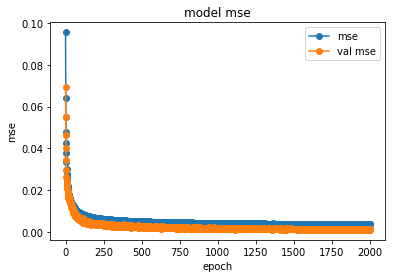

save the model


In [38]:
# -*- coding: utf-8 -*-
"""
Created on Tue Mar  7 15:43:18 2017

@author: hanar
"""
import time
import numpy as np
import os
from keras.utils import np_utils
from keras.models import Sequential
from keras.layers import Dense, Activation, Dropout
from keras.optimizers import SGD
from keras.optimizers import RMSprop
from keras.optimizers import Adagrad
from keras.optimizers import Adadelta
from keras.optimizers import Adam
from keras.optimizers import Adamax
from keras.optimizers import Nadam
from keras.callbacks import ModelCheckpoint
from keras.callbacks import EarlyStopping
from keras.callbacks import TensorBoard
from keras.models import load_model
#from keras.utils.visualize_util import plot
import matplotlib.pyplot as plt
import keras.callbacks
import keras.backend.tensorflow_backend as KTF
import tensorflow as tf

#Global variables for normalizing parameters
max_x = 1.0
min_x = 0.0
max_y = 1.0
min_y = 0.0


def deep_learning_tsunami(resdir, X_train_raw, y_train_raw, X_test_raw, y_test_raw,
                            _lr=0.02, _decay=0,
                            _validation_split=0.2, _batch_size=32,
                            _momentum=0.9, _nesterov=True,
                            num_layers=4, dropout=0.5,
                            node_num = 2500,
                            _epochs=2000):
    """
    Creating the inversion model of turbidity currents by deep learning
    """
    #Normalizing dataset
    X_train = get_normalized_data(X_train_raw, min_x, max_x)
    X_test = get_normalized_data(X_test_raw, min_x, max_x)
    y_train = get_normalized_data(y_train_raw, min_y, max_y)
    y_test = get_normalized_data(y_test_raw, min_y, max_y)
    
    #Generation of neural network model
    model = Sequential()
    model.add(Dense(node_num, input_dim=X_train.shape[1], activation='relu', kernel_initializer ='glorot_uniform'))#1st layer
    model.add(Dropout(dropout))
    for i in range(num_layers - 2):
        model.add(Dense(node_num, activation='relu', kernel_initializer ='glorot_uniform'))#2nd layer
        model.add(Dropout(dropout))
    model.add(Dense(y_train.shape[1], activation = 'relu', kernel_initializer ='glorot_uniform')) #last layer
    
    #Compiling the model
    model.compile(loss="mean_squared_error", 
              optimizer=SGD(lr=_lr, decay=_decay, momentum=_momentum, nesterov=_nesterov),
              #optimizer=Adadelta(),
              metrics=["mean_squared_error"])    
    
    #Perform learning
    t = time.time()
    check = ModelCheckpoint("model3.hdf5")
    #es_cb = EarlyStopping(monitor='val_loss', patience=5, verbose=0, mode='auto')
    #tb_cb = TensorBoard(log_dir=resdir, histogram_freq=2, write_graph=True, write_images=True)
    history = model.fit(X_train, y_train, epochs=_epochs, 
                    validation_split=_validation_split, batch_size=_batch_size,
                    callbacks=[check])
    
    #Evaluate learning result
    loss_and_metrics = model.evaluate(X_test,y_test)
    print("\nloss:{} mse:{}".format(loss_and_metrics[0],loss_and_metrics[1]))
    
    print("Elapsed time: {:.1f} sec.".format(time.time()-t))
    
    #Visualize learning result   
    #plot(model, to_file="model.png", show_shapes=True, show_layer_names=True)

    # model The state of change when letting you learnplot
    plot_history(history)
    
    return model, history

def apply_model(model, X, min_x, max_x, min_y, max_y):
    """
    Apply model
    Maximum and minimum values ​​of X and Y are required to normalize
    """
    X_norm =  (X - min_x) / (max_x - min_x)
    Y_norm = model.predict(X_norm)
    Y = Y_norm*(max_y - min_y)+min_y
    return Y

def plot_history(history):
    # Plot accuracy history
    plt.plot(history.history['mean_squared_error'],"o-",label="mse")
    plt.plot(history.history['val_mean_squared_error'],"o-",label="val mse")
    plt.title('model mse')
    plt.xlabel('epoch')
    plt.ylabel('mse')
    plt.legend(loc="upper right")
    plt.show()

#    # 損失の履歴をプロット
#    plt.plot(history.history['loss'],"o-",label="loss",)
#    plt.plot(history.history['val_loss'],"o-",label="val_loss")
#    plt.title('model loss')
#    plt.xlabel('epoch')
#    plt.ylabel('loss')
#    plt.legend(loc='upper right')
#    plt.show()

def test_model(model, x_test):
    #Test the results
    
    x_test_norm = get_normalized_data(x_test, min_x, max_x)
    test_result_norm = model.predict(x_test_norm)
    test_result = get_raw_data(test_result_norm, min_y, max_y)
    
    return test_result


def save_result(savedir, model, history, test_result):
    
    
    np.savetxt(savedir + 'test_result.txt',test_result,delimiter=',')
    np.savetxt(savedir+'loss.txt',history.history.get('loss'),delimiter=',')
    np.savetxt(savedir+'val_loss.txt',history.history.get('val_loss'),delimiter=',')
    
    #Serialize model and save
    print('save the model')
    model.save(savedir + 'model3.hdf5')

def load_data(datadir):
    """
    This function load training and test data sets, and returns variables
    """
    global min_x, max_x, min_y, max_y
    
    x_train = np.loadtxt(datadir + 'x_train.txt',delimiter=',')
    x_test = np.loadtxt(datadir + 'x_test.txt',delimiter=',')
    y_train = np.loadtxt(datadir + 'icond_train.txt',delimiter=',')
    y_test = np.loadtxt(datadir + 'icond_test.txt',delimiter=',')
    min_y = np.loadtxt(datadir + 'icond_min.txt',delimiter=',')
    max_y = np.loadtxt(datadir + 'icond_max.txt',delimiter=',')
    [min_x, max_x] = np.loadtxt(datadir + 'x_minmax.txt',delimiter=',')
    
    return x_train, y_train, x_test, y_test

def set_minmax_data(_min_x, _max_x, _min_y, _max_y):
    global min_x, max_x, min_y, max_y
    
    min_x, max_x, min_y, max_y = _min_x, _max_x, _min_y, _max_y
    return
    


def get_normalized_data(x, min_val, max_val):
    """
    Normalizing the training and test dataset
    """
    x_norm = (x - min_val) / (max_val - min_val)
    
    return x_norm

def get_raw_data(x_norm, min_val, max_val):
    """
    Get raw data from the normalized dataset
    """
    x = x_norm * (max_val - min_val) + min_val
    
    return x

if __name__ == "__main__":
    
    #Reading data  
    datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi3800/'
    resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi3800/'
    if not os.path.exists(resdir):
        os.mkdir(resdir)
    
    x_train, y_train, x_test, y_test = load_data(datadir)
    
     
    #Execution of learning
    testcases = [4500]
    for i in range(len(testcases)):
        resdir_case = resdir + '{}/'.format(testcases[i])        
        if not os.path.exists(resdir_case):
            os.mkdir(resdir_case)
        x_train_sub = x_train[0:testcases[i],:]
        y_train_sub = y_train[0:testcases[i],:]
        model, history = deep_learning_tsunami(resdir_case, x_train_sub, y_train_sub, x_test, y_test, num_layers=5)
        #Verify and save results
        result = test_model(model, x_test)
        save_result(resdir_case,model,history,result)




(500, 9)


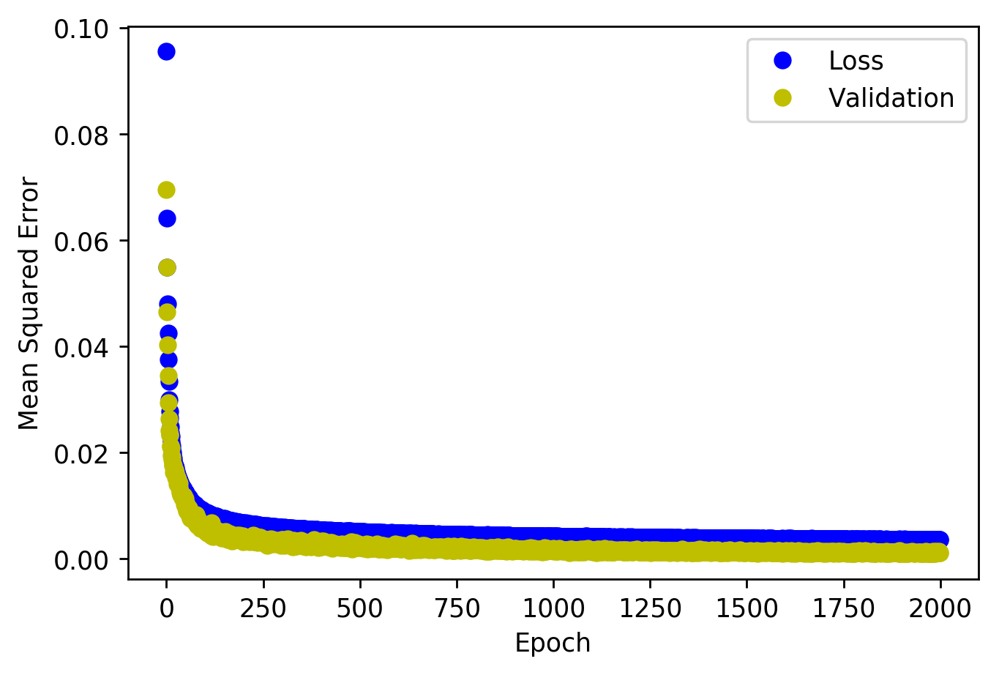

<Figure size 432x288 with 0 Axes>

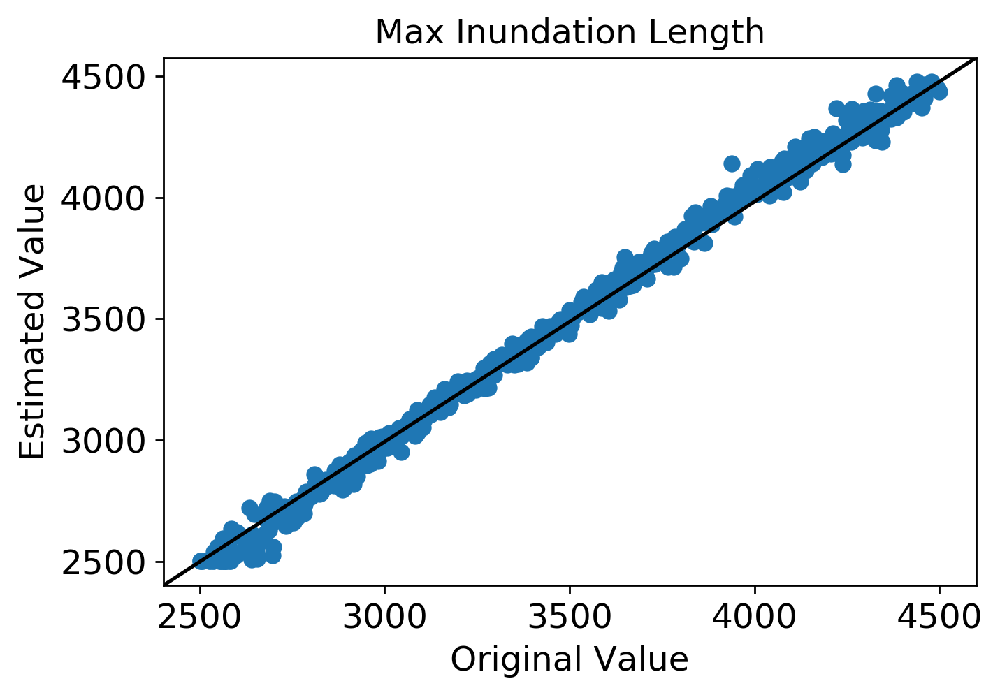

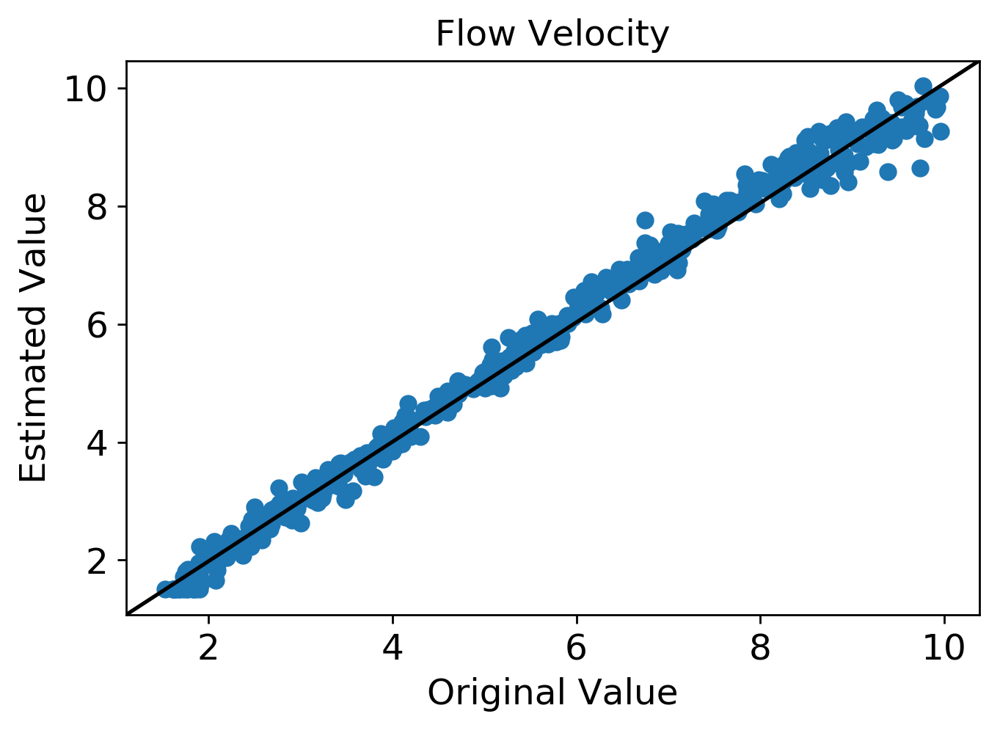

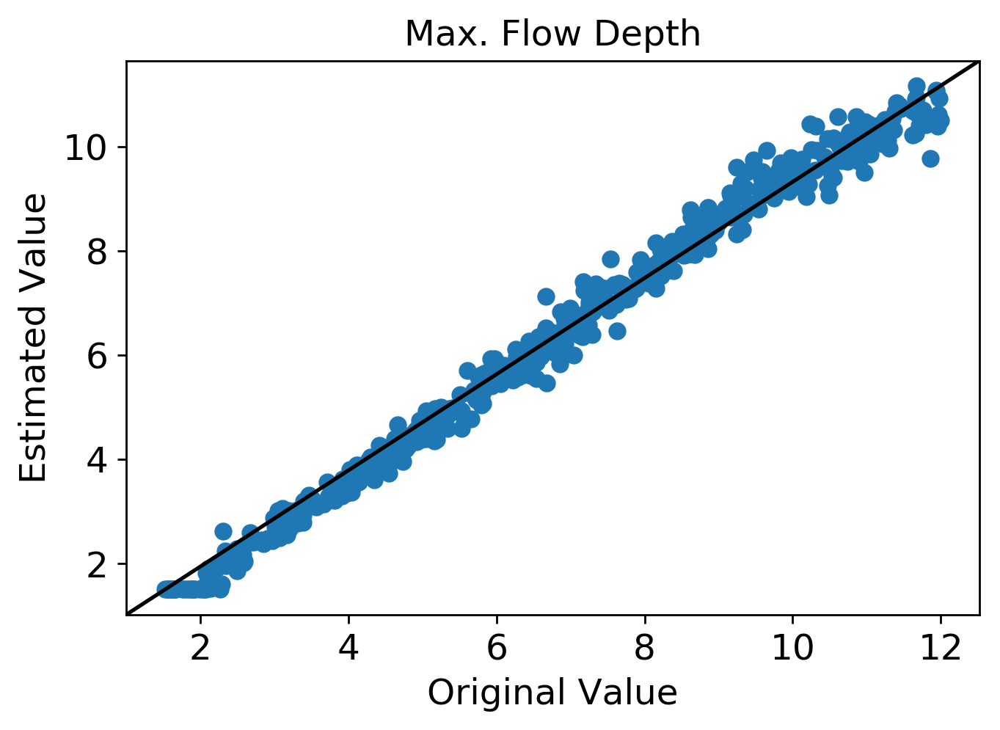

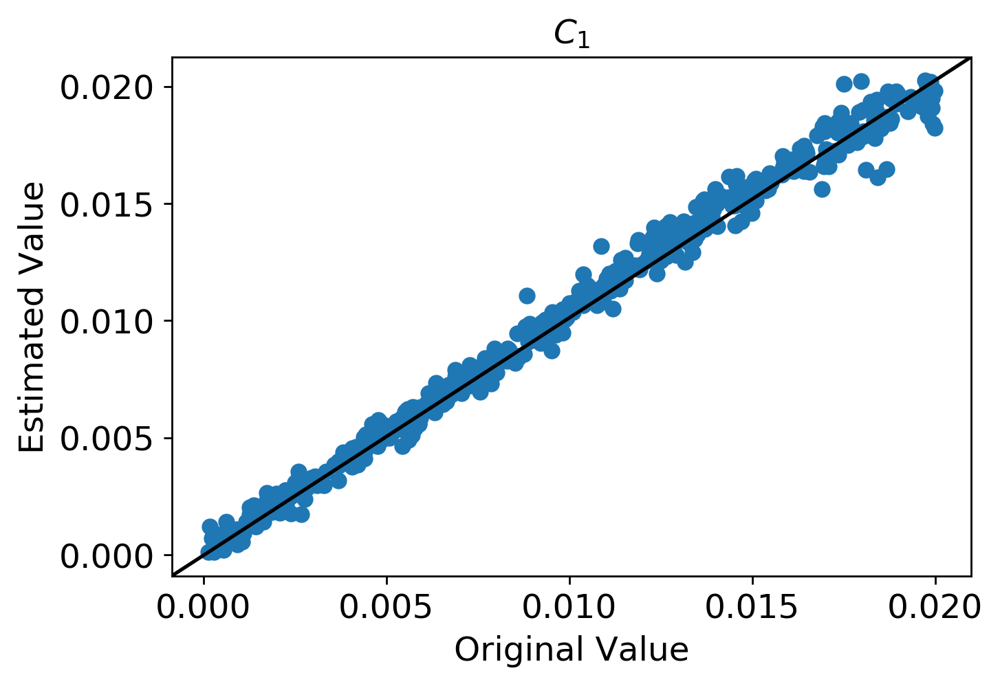

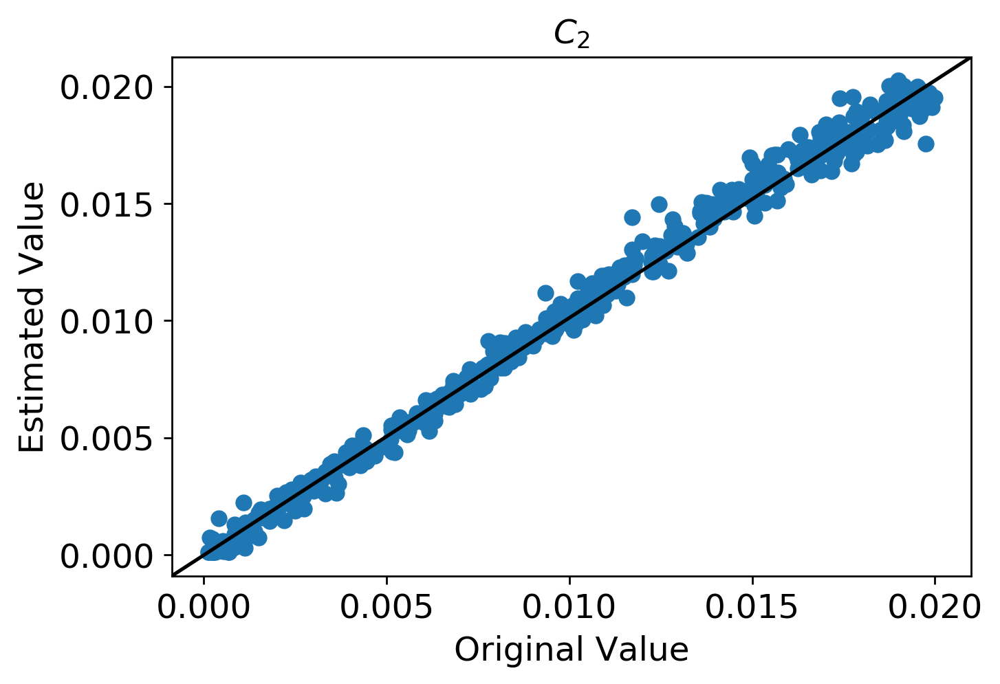

...

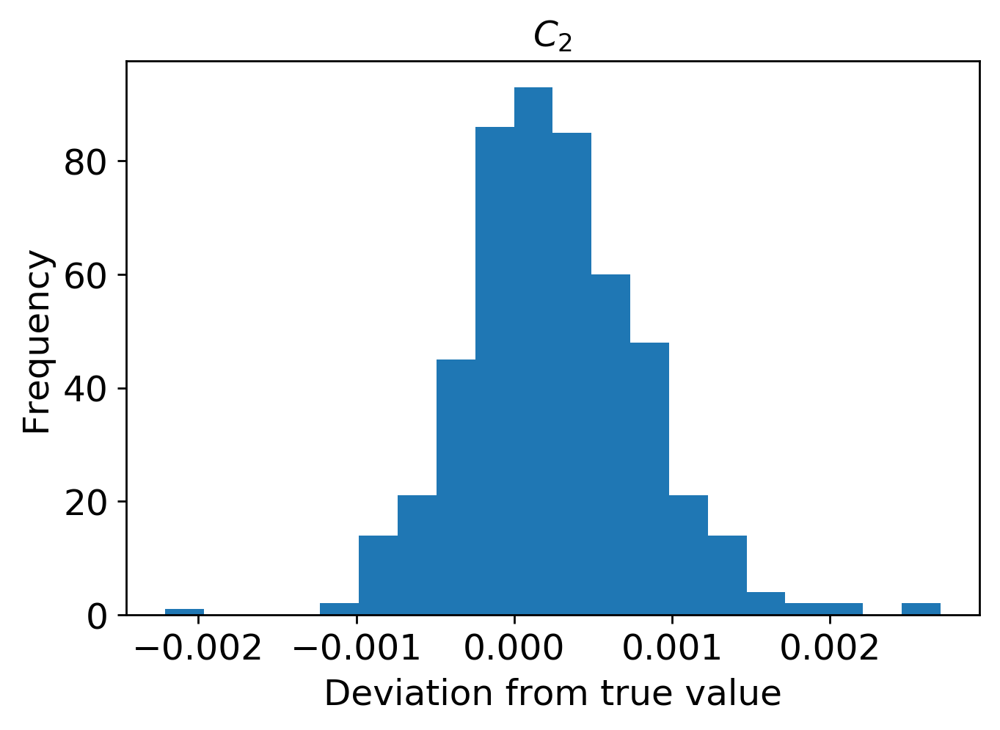

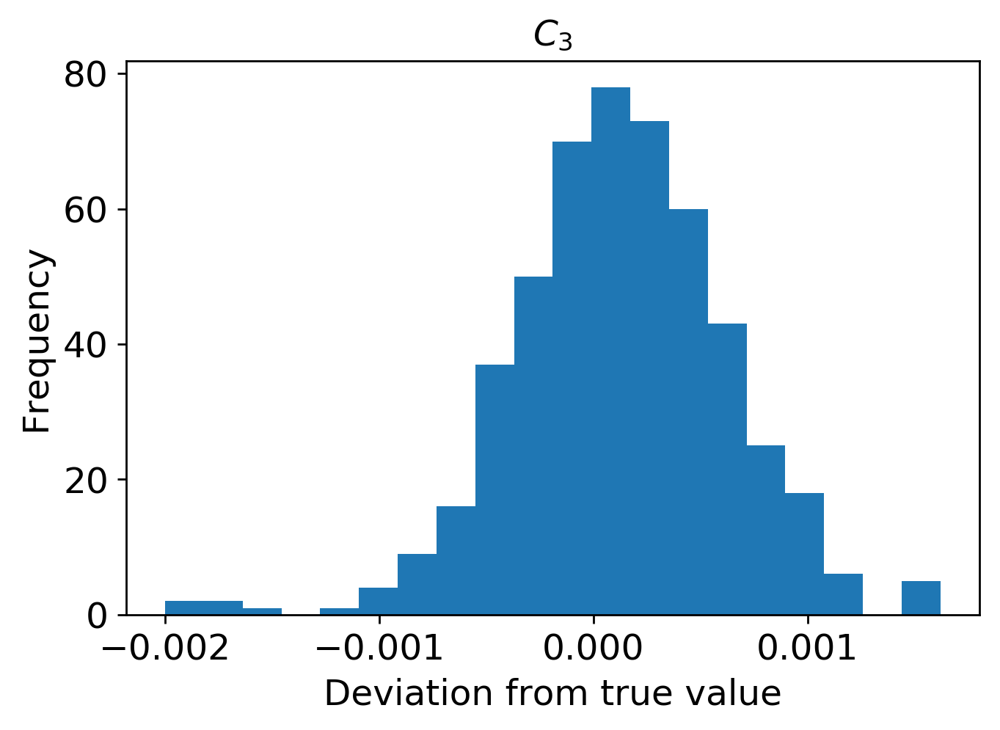

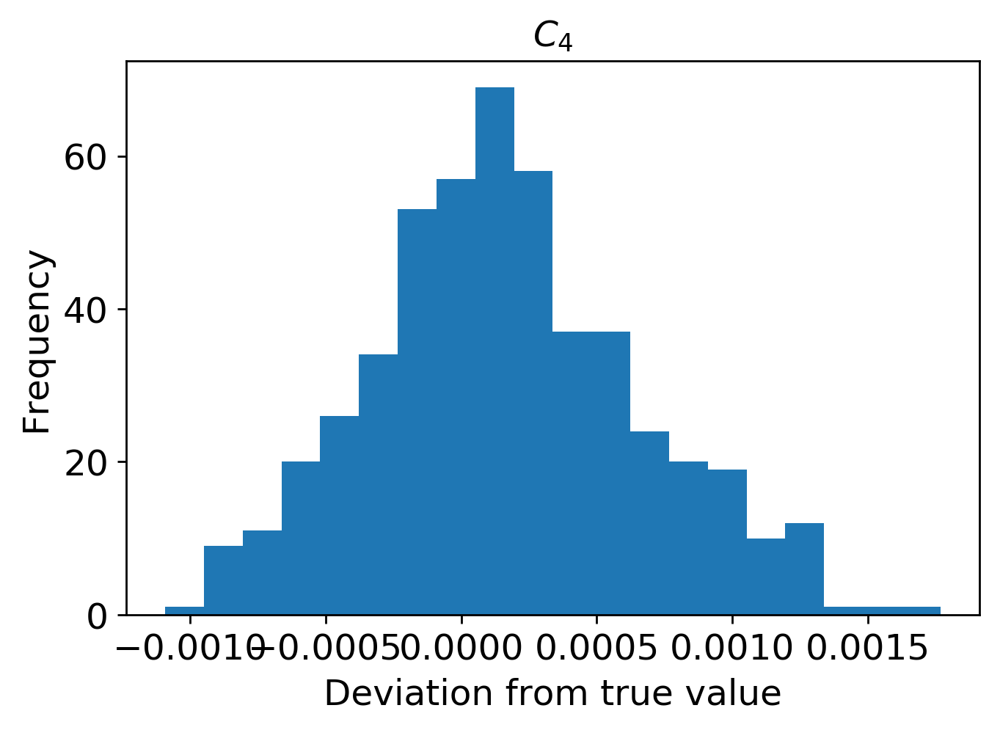

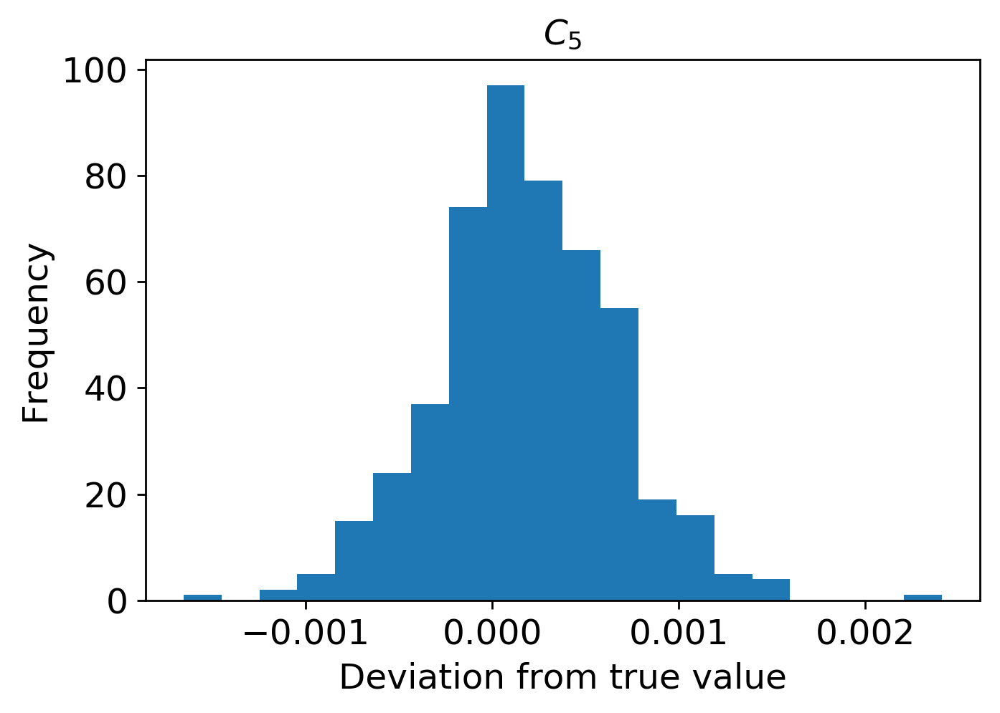

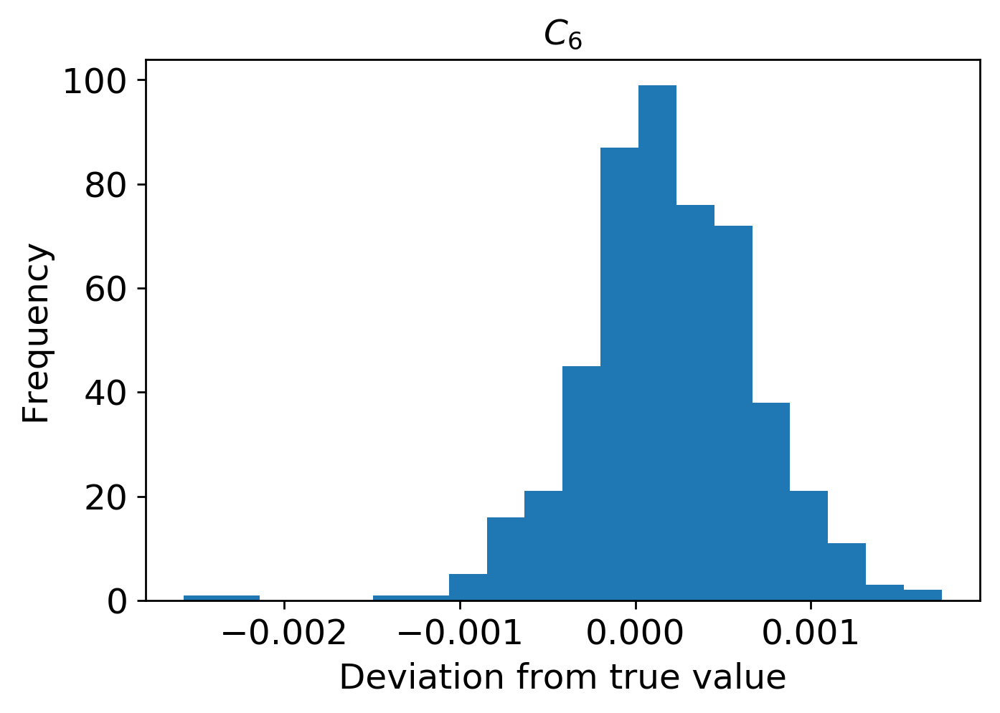

In [5]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi3800/'
resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi3800/4500/'

test_result = np.loadtxt(resdir + 'test_result.txt',delimiter=',')
icond = np.loadtxt(datadir + 'icond_test.txt',delimiter=',')
print(icond.shape)
loss = np.loadtxt(resdir+'loss.txt',delimiter=',')
epoch = range(0,2000)
vloss = np.loadtxt(resdir+'val_loss.txt',delimiter=',')
resi = test_result - icond

fig = plt.figure(num=None,dpi=250, facecolor='w', edgecolor='k')
plt.plot(epoch, loss, 'bo',label='Loss')
plt.plot(epoch, vloss, 'yo',label='Validation')
plt.xlabel('Epoch')
plt.ylabel('Mean Squared Error')
plt.legend(loc="upper right")
plt.savefig(resdir+ 'mse.eps')
plt.show()

fig2 = plt.figure()
hfont = {'fontname':'Century Gothic'}
textcol = 'k'
titlelabel = ['Max Inundation Length','Flow Velocity', 'Max. Flow Depth', '$C_1$', '$C_2$', '$C_3$', '$C_4$','$C_5$','$C_6$']


    
for i in range(len(titlelabel)):
    plt.figure(num=None,dpi=250, facecolor='w', edgecolor='k')
    plt.plot(icond[:,i],test_result[:,i],"o")
    x=icond[:,i]
    y=test_result[:,i]
    y_lim = plt.ylim()
    x_lim = plt.xlim()
    plt.plot(x_lim, y_lim, 'k-', color = 'k')
    plt.ylim(y_lim)
    plt.xlim(x_lim)
    plt.xlabel('Original Value',color=textcol,size=14,**hfont)
    plt.ylabel('Estimated Value',color=textcol,size=14,**hfont)
    plt.title(titlelabel[i],color=textcol,size=14,**hfont)
    plt.tick_params(labelsize=14,colors=textcol)
    plt.savefig(resdir+titlelabel[i] + '.eps')
    #plt.show()

for i in range(len(titlelabel)):
    plt.figure(num=None,dpi=250, facecolor='w', edgecolor='k')
    plt.hist(resi[:,i],bins=20)
    plt.title(titlelabel[i],color=textcol,size=14,**hfont)
    plt.xlabel('Deviation from true value',color=textcol,size=14,**hfont)
    plt.ylabel('Frequency',color=textcol,size=14,**hfont)
    plt.tick_params(labelsize=14,colors=textcol)
    plt.savefig(resdir+titlelabel[i] + 'hist' + '.eps')
    plt.show()

       distance        g1        g2        g3        g4        g5        g6
0      0.000000  0.036771  0.167260  0.114845  0.008449  0.002190  0.005161
1    103.794102  0.000000  0.075200  0.153283  0.013753  0.001885  0.000442
2    171.620654  0.002130  0.051171  0.084309  0.006218  0.001867  0.002843
3    397.112167  0.003115  0.016359  0.078858  0.011466  0.000597  0.000054
4    595.912969  0.000732  0.016896  0.028720  0.002661  0.000914  0.000000
5    707.625749  0.000143  0.002228  0.005502  0.000900  0.000187  0.000104
6    796.435078  0.000236  0.004337  0.021204  0.003169  0.000309  0.000080
7    895.065500  0.001688  0.016059  0.081413  0.020284  0.006824  0.004628
8    988.394177  0.004567  0.008166  0.074658  0.016913  0.002424  0.001580
9   1081.819325  0.001567  0.016305  0.060234  0.011086  0.004165  0.001994
10  1195.756993  0.001022  0.002370  0.017565  0.004194  0.000567  0.000142
11  1290.372534  0.000000  0.004121  0.057974  0.014565  0.000426  0.000213
12  1400.896

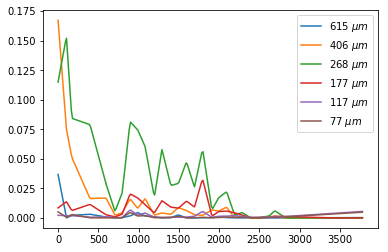

In [2]:
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.models import load_model
from scipy import stats
from scipy.interpolate import interp1d 
import pandas as pd
from pykrige import OrdinaryKriging as OK
import ipdb


datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi3800/'
resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi3800/4500/'
#Initial setting
if not "model" in locals(): 
    model = load_model(resdir+'model3.hdf5')
#gclass = 3
#gclass_label = ["500 $\mu$m","125 $\mu$m","63 $\mu$m"]
gclass = 6
gclass_label = ["615 ${\mu}m$","406 ${\mu}m$","268 ${\mu}m$","177 ${\mu}m$", "117 ${\mu}m$","77 ${\mu}m$"]
topodx = 15.0
coord_num = int(model.layers[0].input_shape[1]/gclass)

#Acquires a value for normalizing input data to [0, 1]
min_x, max_x = np.loadtxt(datadir + 'x_minmax.txt',delimiter=',')
y_min = np.loadtxt(datadir + 'icond_min.txt',delimiter=',')
y_max = np.loadtxt(datadir + 'icond_max.txt',delimiter=',')

#Read outcrop data
#dist_max = 22000. #Distance of distal end of learning data
outcrop = pd.read_csv('../FITTNUSS-forward_training_DNN/sendai_increased_class_edit.csv')
#outcrop = pd.read_csv('../DeepLearningTurbidite_Fukuda/GA_naruse_v2.csv')
#outcrop = outcrop.append(pd.DataFrame([[0,'Loc0',0,0,0],[dist_max,'LocE',0,0,0]], columns=outcrop.columns))
outcrop = outcrop.sort_values('distance')
outcrop['distance'] = outcrop['distance'] - 0
#d = pd.DataFrame(np.zeros((1, 7)),columns=['distance', 'g1','g2','g3','g4','g5','g6'])
#print(d)
#v=np.concatenate((outcrop, d))
#print(v)
#outcrop=pd.DataFrame(v,columns=['distance', 'g1','g2','g3','g4','g5','g6'])
#outcrop['distance'].iloc[-1]=4000
#outcrop = outcrop.append(pd.DataFrame([[0,'Loc0',0,0,0,0]], columns=outcrop.columns))
print(outcrop)

#Preparation under interpolation
thick_interp = np.zeros([1,coord_num*gclass])#補間されたサンプル厚さデータ
outcrop_x_id = np.round(outcrop['distance']/topodx).astype(np.int32) #逆解析システムでのサンプリング地点のindex番号
x = np.arange(0,coord_num*topodx,topodx)

#Complement data
for j in range(gclass):
    f = interp1d(outcrop['distance'],outcrop.iloc[:,j+1], kind="linear",bounds_error=False,fill_value='extrapolate')
    #f = interp1d(outcrop['distance'],outcrop.iloc[:,j+2], kind="linear",bounds_error=False,fill_value='extrapolate') 
    #Interpolation function of jth granularity level
    thick_interp[0,coord_num*j:coord_num*(j+1)] = f(x) #Supplemented data

#ipdb.set_trace()
#Kriging Interpolation by
#vparams = np.array([[0.035, 10000., 0.001],[0.006, 10000., 0.002],[0.005, 10000., 0.002],[0.035, 10000., 0.001]])
#for j in range(gclass):
    #okip = OK(outcrop['distance'],np.zeros(outcrop['distance'].shape),outcrop.iloc[:,j+1],variogram_model='gaussian',)
    #okip.display_variogram_model()
    #ipdata, ipstd = okip.execute('grid',x,np.array([0.]))
    #ipdata = np.squeeze(ipdata)
    #thick_interp[0,coord_num*j:coord_num*(j+1)] = ipdata #Assign complemented d

#Normalize data
thick_interp[thick_interp < 0] = 0
thick_interp_norm =  (thick_interp - min_x) / (max_x - min_x)

#Perform inverse analysis
test_result_outcrop = model.predict(thick_interp_norm)
test_result_outcrop = test_result_outcrop * (y_max - y_min) + y_min
print(test_result_outcrop)
#add=np.array(3000)
#test_result_outcrop_add=np.concatenate((add,test_result_outcrop), axis=None)
#Output results
#print(test_result_outcrop_add)
np.savetxt('outcrop_result_g6_g300_H_5000_20_11_roi3800.txt',test_result_outcrop, delimiter=',')
for i in range(len(gclass_label)):
    plt.plot(x,thick_interp[0,coord_num * i:coord_num * (i+1)],label=gclass_label[i])
plt.legend()
plt.show()



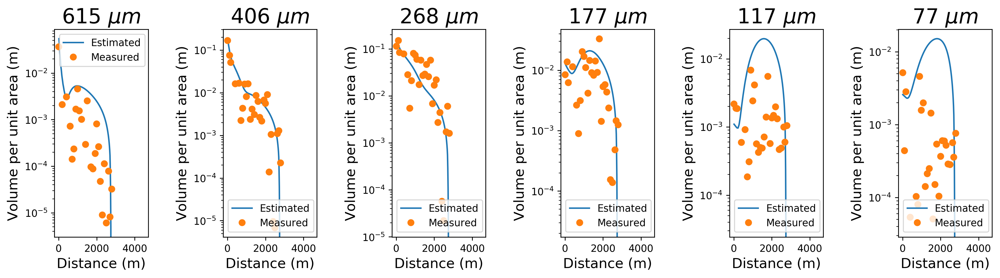

In [41]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import Forward_model_modified_FITTNUSS_5000_g6_300grid_19_11_case2 as fmodel
import time
import ipdb
%matplotlib inline

#Basic setting

#dist_max = 3000.
gclass = 6
topodx=15.0
gclass_name = ['615microm','406microm','268microm','177microm','117microm','77microm']
#gclass_name = ['500micron', '125micron', '63micron']
gname_tex = ["615 ${\mu}m$","406 ${\mu}m$","268 ${\mu}m$","177 ${\mu}m$", "117 ${\mu}m$","77 ${\mu}m$"]
#gname_tex = ['500 $\mu$m','125 $\mu$m','63 $\mu$m']
#calcdir = 'home/rimali2009/FITTNUSS-forward_training_DNN/'
#calcdir = '/home/naruse/Documents/Documents/MATLAB/TCtrainData_forML/TCModel_for_MLTEST/test_output_otadai07/'

#Load estimate
#H1 = np.loadtxt(calcdir + 'H1.txt',delimiter=',')
#H2 = np.loadtxt(calcdir + 'H2.txt',delimiter=',')
#H3 = np.loadtxt(calcdir + 'H3.txt',delimiter=',')
#H4 = np.loadtxt(calcdir + 'H4.txt',delimiter=',')
#Ht = np.loadtxt(calcdir + 'Ht.txt',delimiter=',')
#U = np.loadtxt(calcdir + 'U.txt',delimiter=',')
#xi = np.loadtxt(calcdir + 'xi.txt',delimiter=',')
#x = np.loadtxt(calcdir + 'x.txt',delimiter=',')
#x_bed = np.loadtxt(calcdir + 'x_init.txt',delimiter=',')
#eta_init = np.loadtxt(calcdir + 'eta_init.txt',delimiter=',')
#Ct = np.loadtxt(calcdir + 'Ct.txt',delimiter=',')
#time = np.loadtxt(calcdir + 'time.txt',delimiter=',')
estimated_icond=np.loadtxt('outcrop_result_g6_g300_H_5000_20_11_roi3800.txt', delimiter=',')
start = time.time()
fmodel.read_setfile("config_g6_300grid_19_11_case2.ini")
(x,C,x_dep,deposit) = fmodel.forward(estimated_icond)
np.savetxt('eta_estimated_thickness_5K_g6_TC4_Rwcnst_H_5000_20_11_roi3800.csv', deposit, delimiter=',')
np.savetxt('eta_estimated_Distance_5K_g6_TC4_Rwcnst_H_5000_20_11_roi3800.csv', x_dep,delimiter=',')
estimated_dep_thickness_5000=np.transpose(np.loadtxt('/home/rimali2009/FITTNUSS-forward_training_DNN/'+'eta_estimated_thickness_5K_g6_TC4_Rwcnst_H_5000_20_11_roi3800.csv', delimiter=','))
estimated_dep_thickness_5000=pd.DataFrame(estimated_dep_thickness_5000,columns=['615microm','406microm','268microm','177microm','117microm','77microm'])
estimated_dep_distance_5000=np.transpose(np.loadtxt('/home/rimali2009/FITTNUSS-forward_training_DNN/'+'eta_estimated_Distance_5K_g6_TC4_Rwcnst_H_5000_20_11_roi3800.csv', delimiter=','))
estimated_dep_distance_5000=pd.DataFrame(estimated_dep_distance_5000,columns=['distance'])
estimated_dep_5000=pd.concat([estimated_dep_distance_5000,estimated_dep_thickness_5000],axis=1)
np.savetxt('estimated_dep_5K_g6_TC4_Rwcnst_H_5000_20_11_roi3800.csv',estimated_dep_5000,delimiter=',')
#data_estim=pd.DataFrame(estimated_dep_5000,columns=['distance','1.5phi','2.5phi','3.5phi','4.5phi'])

#Formatting the loaded data
#estimated_dep_df = pd.DataFrame(estimated_dep,columns=['distance','1.5phi','2.5phi','3.5phi','4.5phi'])
#estimated_dep = pd.DataFrame(np.array([x_bed - dist_offset,H1[-1,:],H2[-1,:],H3[-1,:]]).T,columns=['distance','500micron','125micron','63micron'])
estimated_dep_5000= estimated_dep_5000.query('distance > 0')
#estimated_dep_5000 = estimated_dep_5000.query('distance < {}'.format(dist_max))

#Read original data
outcrop = pd.read_csv('../FITTNUSS-forward_training_DNN/sendai_increased_class.csv')
outcrop= pd.DataFrame(outcrop,columns=['distance','615microm','406microm','268microm','177microm','117microm','77microm'])
#outcrop = pd.read_csv('../DeepLearningTurbidite_Fukuda/GA_naruse_v2.csv')
#outcrop = outcrop.append(pd.DataFrame([[0,'Loc0',0,0,0],[dist_max,'LocE',0,0,0]], columns=outcrop.columns))
#outcrop = outcrop.sort_values('distance')
#outcrop['distance'] = outcrop['distance'] - 1000

#Plot
plt.figure(num=None, figsize=(17, 4), dpi=250, facecolor='w', edgecolor='g')
hfont = {'fontname':'Sans'}
plt.subplots_adjust(bottom=0.15, wspace=0.8)

for i in range(gclass):
    plt.subplot(1,gclass,i+1)
    plt.plot(estimated_dep_5000['distance'],estimated_dep_5000[gclass_name[i]],'-', label='Estimated')
    plt.plot(outcrop['distance'], outcrop[gclass_name[i]],'o', label='Measured')
    plt.yscale('log')
    plt.title(gname_tex[i], size=21,**hfont)
    plt.xlabel('Distance (m)', size = 14, **hfont)
    plt.ylabel('Volume per unit area (m)', size = 14, **hfont)
    plt.legend(fontsize=10)
    plt.savefig("thickness_distance_curve_5000_g6_300grid_H_5000_20_11_roi3800.png")
    plt.savefig("thickness_distance_curve_5000_g6_300grid_H_5000_20_11_roi3800.eps")
plt.show()



Using TensorFlow backend.


       distance        g1        g2        g3        g4        g5        g6
0      0.000000  0.036771  0.167260  0.114845  0.008449  0.002190  0.005161
1    103.794102  0.000000  0.075200  0.153283  0.013753  0.001885  0.000442
2    171.620654  0.002130  0.051171  0.084309  0.006218  0.001867  0.002843
3    397.112167  0.003115  0.016359  0.078858  0.011466  0.000597  0.000054
4    595.912969  0.000732  0.016896  0.028720  0.002661  0.000914  0.000000
5    707.625749  0.000143  0.002228  0.005502  0.000900  0.000187  0.000104
6    796.435078  0.000236  0.004337  0.021204  0.003169  0.000309  0.000080
7    895.065500  0.001688  0.016059  0.081413  0.020284  0.006824  0.004628
8    988.394177  0.004567  0.008166  0.074658  0.016913  0.002424  0.001580
9   1081.819325  0.001567  0.016305  0.060234  0.011086  0.004165  0.001994
10  1195.756993  0.001022  0.002370  0.017565  0.004194  0.000567  0.000142
11  1290.372534  0.000000  0.004121  0.057974  0.014565  0.000426  0.000213
12  1400.896

(1, 9)
[[2.82473366e+03 5.03714660e+00 6.01262394e+00 6.04932531e-03
  1.95513014e-02 1.70547241e-02 1.31939336e-03 1.01360960e-04
  2.43099122e-04]]
       distance        g1        g2        g3        g4        g5        g6
0      0.000000  0.036771  0.167260  0.114845  0.008449  0.002190  0.005161
1    103.794102  0.000000  0.075200  0.153283  0.013753  0.001885  0.000442
2    171.620654  0.002130  0.051171  0.084309  0.006218  0.001867  0.002843
3    397.112167  0.003115  0.016359  0.078858  0.011466  0.000597  0.000054
4    595.912969  0.000732  0.016896  0.028720  0.002661  0.000914  0.000000
5    707.625749  0.000143  0.002228  0.005502  0.000900  0.000187  0.000104
6    796.435078  0.000236  0.004337  0.021204  0.003169  0.000309  0.000080
7    895.065500  0.001688  0.016059  0.081413  0.020284  0.006824  0.004628
8   1081.819325  0.001567  0.016305  0.060234  0.011086  0.004165  0.001994
9   1195.756993  0.001022  0.002370  0.017565  0.004194  0.000567  0.000142
10  1290.37253

/home/rimali2009/anaconda3/envs/test3/lib/python3.6/site-packages/matplotlib/font_manager.py:1241: UserWarning: findfont: Font family ['Century Gothic'] not found. Falling back to DejaVu Sans.
  (prop.get_family(), self.defaultFamily[fontext]))


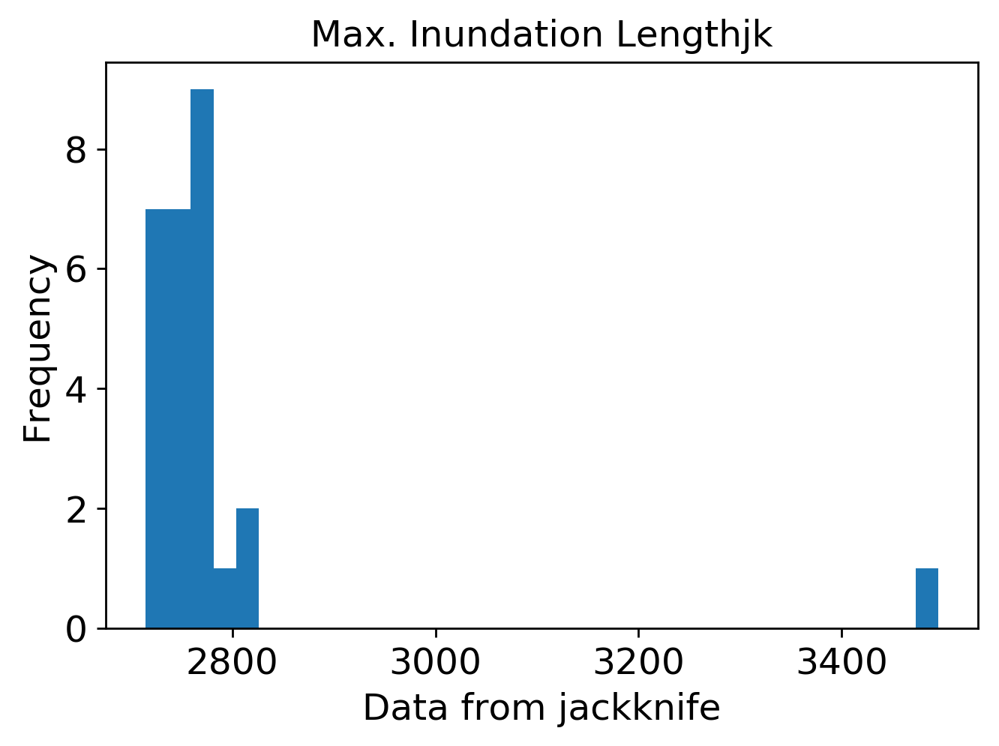

mean: 4.95264719234587
jk_e: 0.09995608883738649


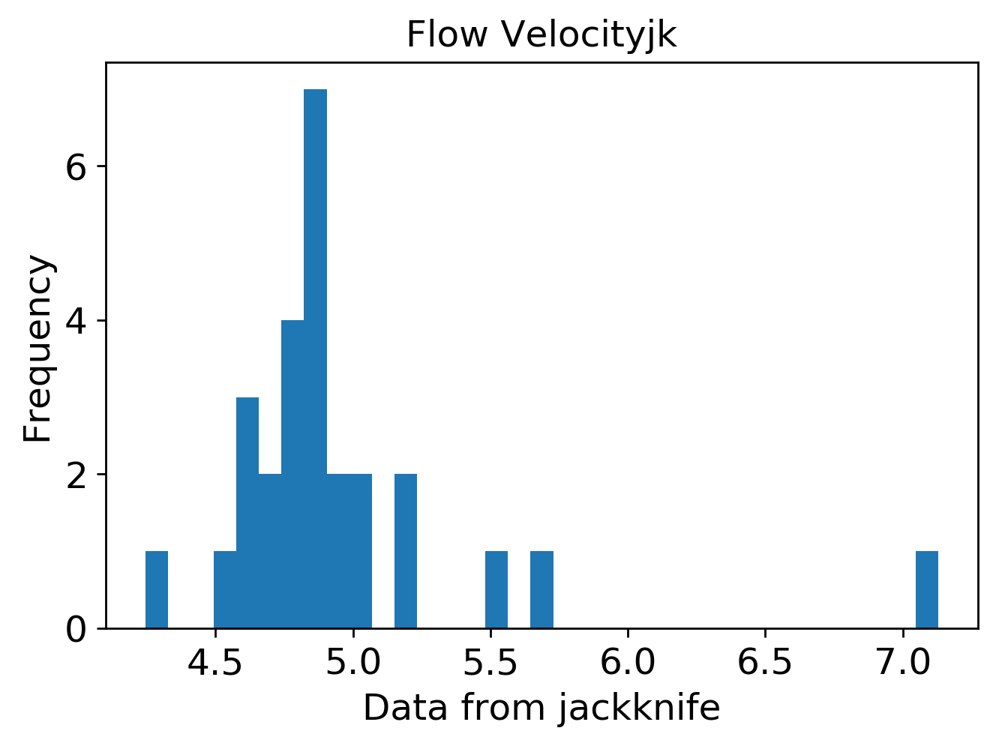

mean: 6.477333746378926
jk_e: 0.17426758704251205


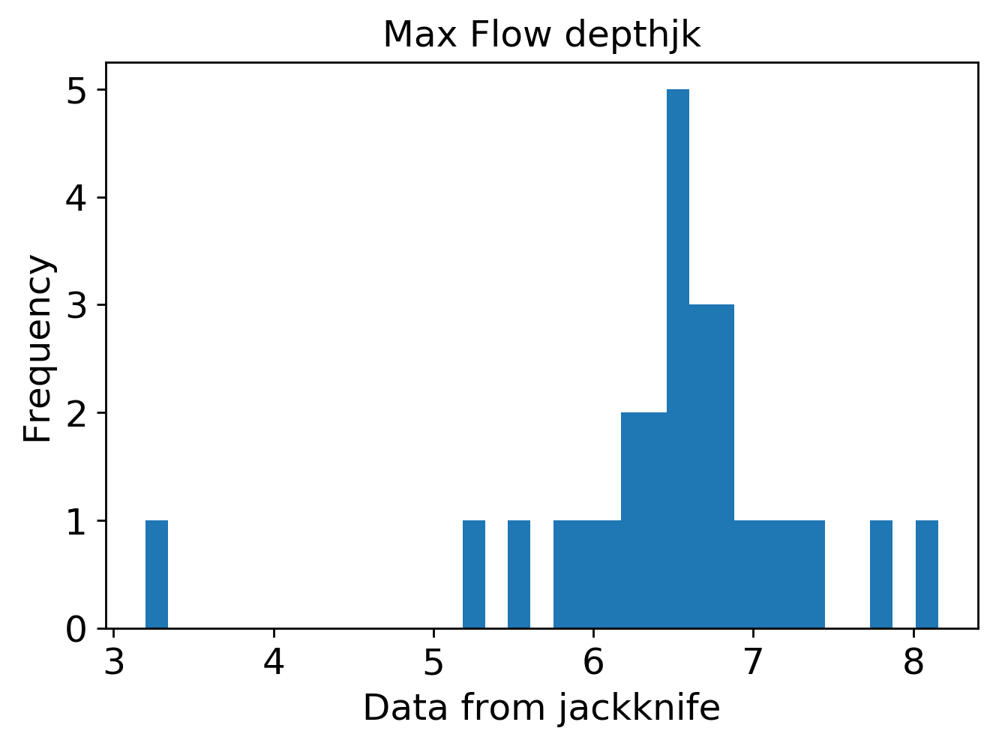

mean: 0.005665684303218109
jk_e: 0.00016398171225133379


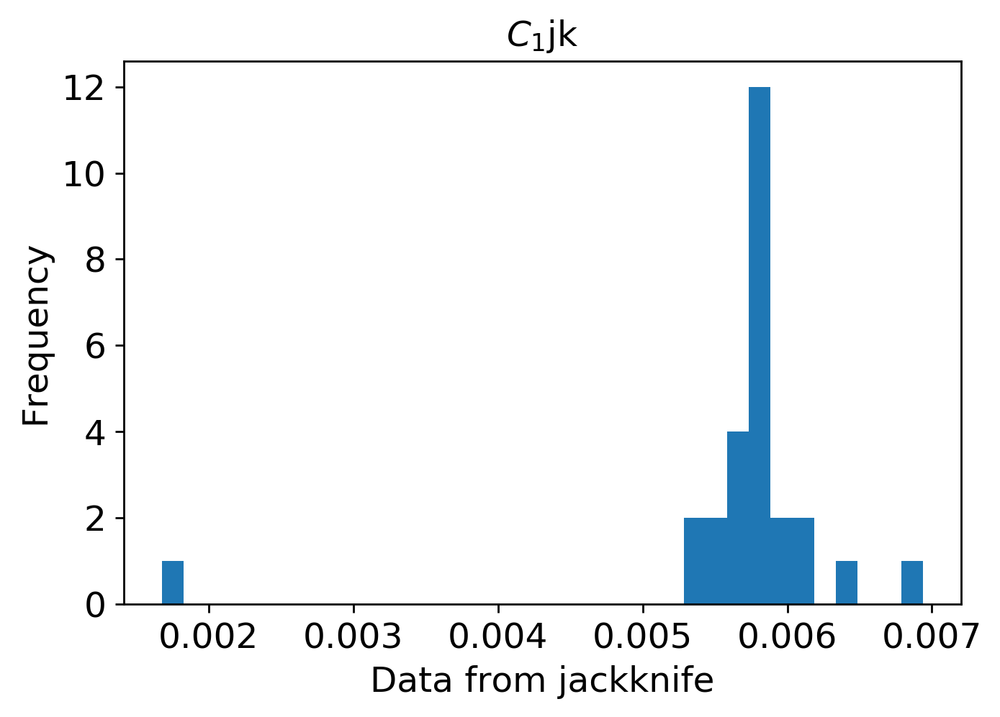

mean: 0.018571108972471852
jk_e: 0.0003653321856245772


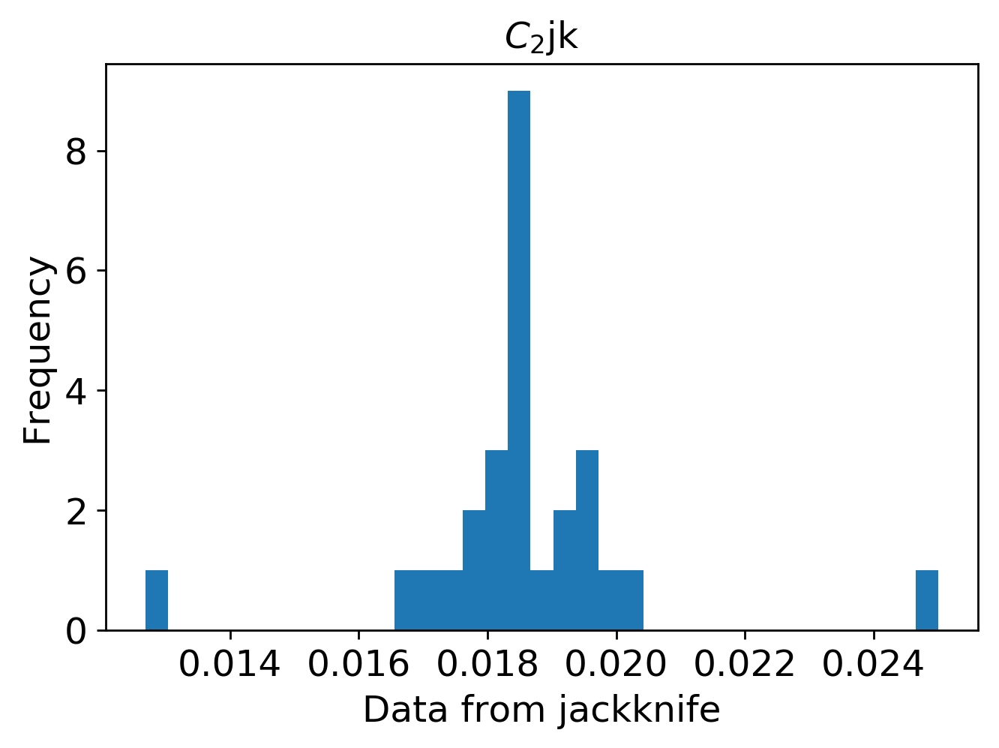

mean: 0.01628446980394376
jk_e: 0.0003755242140881524


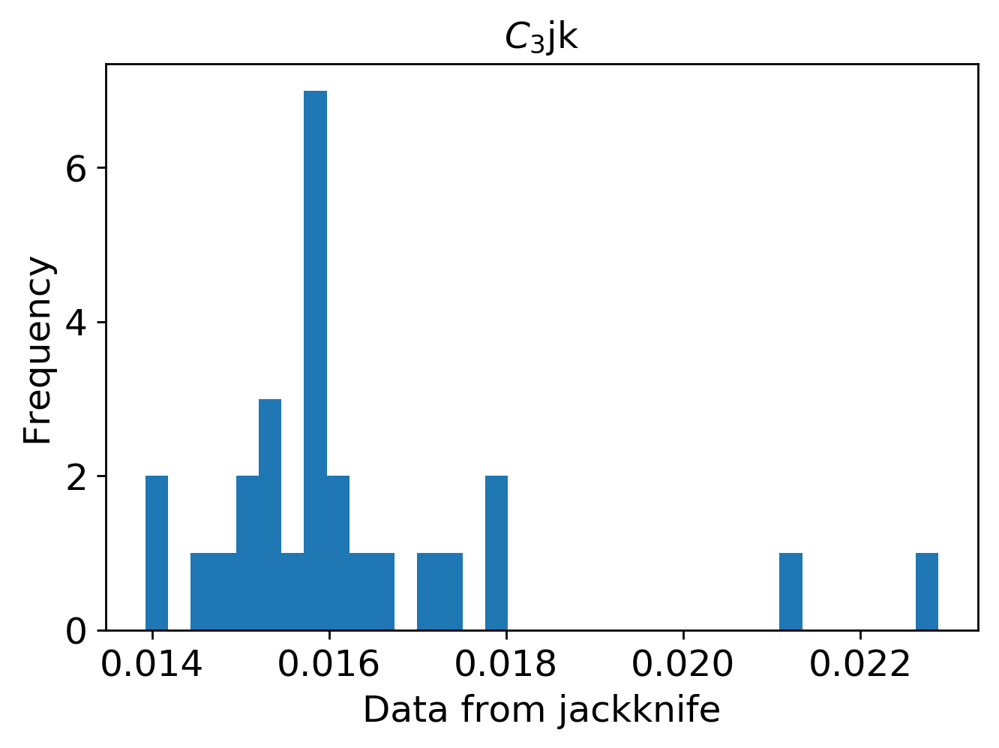

mean: 0.0012535264383836664
jk_e: 5.3679315748776374e-05


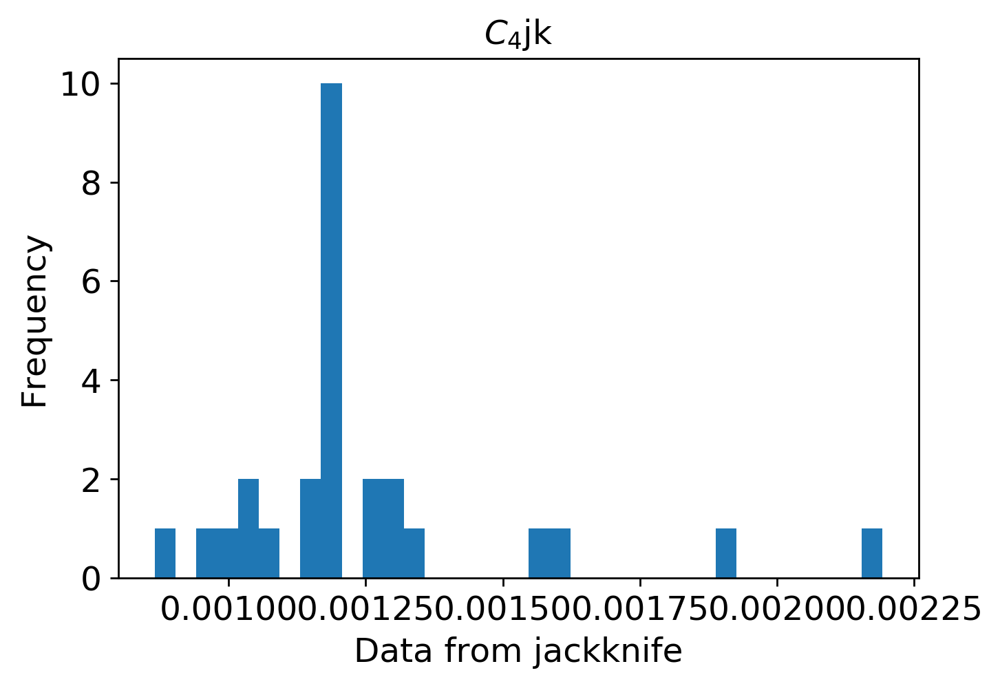

mean: 0.00019106219492302445
jk_e: 8.970123470444793e-05


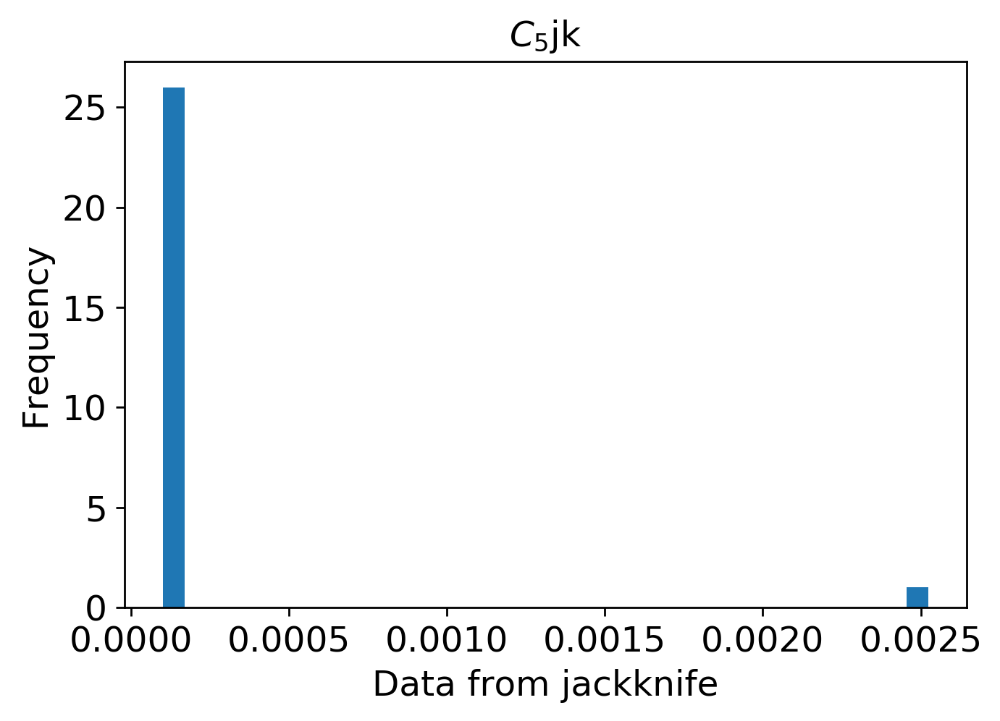

mean: 0.0002814313430964597
jk_e: 2.399142037442403e-05


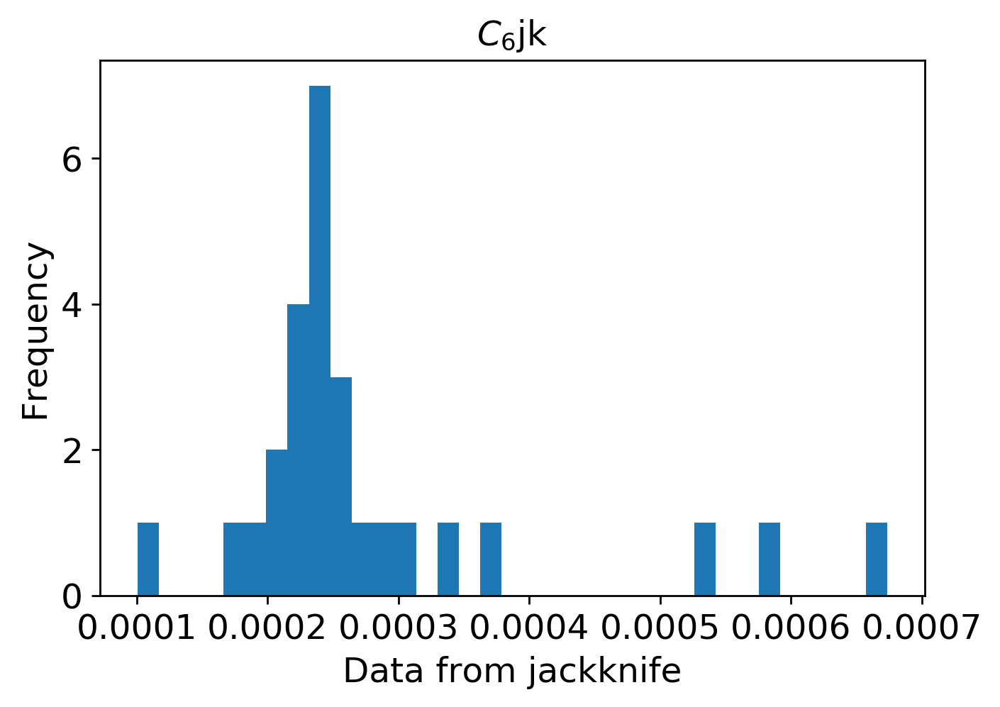

In [1]:
# Jackknife Method
import csv
import numpy as np
import pandas as pd
import math
from keras.models import load_model
from scipy.interpolate import interp1d
import matplotlib.pyplot as plt
%matplotlib inline

datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi3800/'
resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi3800/4500/'
# Initial setting
if not "model" in locals():
    model = load_model(resdir+'model3.hdf5')
gclass = 6
gclass_label = ["615 ${\mu}m$", "406 ${\mu}m$", "268 ${\mu}m$",
                "177 ${\mu}m$", "117 ${\mu}m$", "77 ${\mu}m$"]
topodx = 15.0
coord_num = int(model.layers[0].input_shape[1]/gclass)
min_x, max_x = np.loadtxt(datadir + 'x_minmax.txt', delimiter=',')
y_min = np.loadtxt(datadir + 'icond_min.txt', delimiter=',')
y_max = np.loadtxt(datadir + 'icond_max.txt', delimiter=',')


a = pd.read_csv(
    '../FITTNUSS-forward_training_DNN/sendai_increased_class_edit.csv', delimiter=',')
print(a)
y = pd.DataFrame()
output = []

with open('output_final_20_11_roi3800.csv', 'w') as outfile:

    # x=[]
    for index in range(len(a)):
        df = y.append(pd.read_csv(
            '../FITTNUSS-forward_training_DNN/sendai_increased_class_edit.csv', skiprows=[index+1]))
        print(df)
        df = df.sort_values('distance')
        thick_interp = np.zeros([1, coord_num*gclass])
        x = np.arange(0, coord_num*topodx, topodx)
        for j in range(gclass):
            # Interpolation function of jth granularity level
            f = interp1d(df['distance'], df.iloc[:, j+1],
                         kind="linear", bounds_error=False,fill_value='extrapolate')
            thick_interp[0, coord_num*j:coord_num*(j+1)] = f(x)
        thick_interp[thick_interp < 0] = 0
        thick_interp_norm = (thick_interp - min_x) / (max_x - min_x)
        test_result_outcrop = model.predict(thick_interp_norm)
        test_result_outcrop = test_result_outcrop * (y_max - y_min) + y_min
        print(test_result_outcrop.shape)
        print(test_result_outcrop)
    # output.append(test_result_outcrop)
        np.savetxt(outfile,test_result_outcrop, delimiter=',')
        # outfile.write('# New iteration\n')
hfont = {'fontname': 'Century Gothic'}
textcol = 'k'
resi = np.loadtxt('output_final_20_11_roi3800.csv', delimiter=',')
titlelabel = ['Max. Inundation Lengthjk','Flow Velocityjk', 'Max Flow depthjk',
              '$C_1$jk', '$C_2$jk', '$C_3$jk', '$C_4$jk', '$C_5$jk', '$C_6$jk']
jk_er=[]
with open('jk_e_roi3800.txt','wb') as ftext:
    for i in range(len(titlelabel)):
        plt.figure(num=None, dpi=250, facecolor='w', edgecolor='k')
        plt.hist(resi[:, i], bins=35)
        mean = sum(resi[:,i]) / len(resi[:,i])
        print("mean:",mean)
        var_jk  = sum(pow(x-mean,2) for x in resi[:,i]) / ((len(resi[:,i])-1)*(len(resi[:,i])))
        jk_e= math.sqrt(var_jk)
        print("jk_e:",jk_e)
        e=np.append(jk_e,jk_er)
        np.savetxt(ftext,e,delimiter=',')
        plt.title(titlelabel[i], color=textcol, size=14, **hfont)
        plt.xlabel('Data from jackknife', color=textcol, size=14, **hfont)
        plt.ylabel('Frequency', color=textcol, size=14, **hfont)
        plt.tick_params(labelsize=14, colors=textcol)
        plt.savefig(resdir+titlelabel[i] + 'jkhist' + '.eps')
        plt.show()


# ROI 3900 

In [43]:
import numpy as np
import os
#import ipdb

def connect_dataset(file_list, icond_file_list, outputdir,
                    topodx=15, roi=2500, offset=5000,gclass_num=6,test_data_num=500):
    """
    複数のデータセットを連結する
    """
    #ipdb.set_trace()
    
    #Reading and combining files Decide start and end points of the learning area and convert them to grid numbers
    H = np.loadtxt(file_list[0], delimiter = ',')
    icond = np.loadtxt(icond_file_list[0], delimiter = ',')
    
    #Reading and combining files
    if len(file_list) > 1:
        for i in range(1, len(file_list)):
            H_temp = np.loadtxt(file_list[i], delimiter = ',')
            icond_temp = np.loadtxt(icond_file_list[i], delimiter = ',')
            H = np.concatenate((H,H_temp),axis=0)
            icond = np.concatenate((icond,icond_temp),axis = 0)
    
    roi_grids = int(roi / topodx)
    num_grids = int(H.shape[1] / gclass_num)
    H_subset = np.zeros([H.shape[0], roi_grids * gclass_num])
    for i in range(gclass_num):
        H_subset[:, i*roi_grids:(i+1)*roi_grids] = H[:, i*num_grids:(i*num_grids+roi_grids)]
    
    #Obtain the maximum and minimum values of data
    max_x = np.max(H_subset)
    min_x = np.min(H_subset)
    icond_max = np.max(icond, axis=0)
    icond_min = np.min(icond, axis=0)
    
    #Split the data into tests and training
    H_train = H_subset[0:-test_data_num,:]
    H_test = H_subset[H_subset.shape[0] - test_data_num:,:]
    icond_train = icond[0:-test_data_num,:]
    icond_test = icond[H.shape[0] - test_data_num:,:]
    
    #Save the data
    if not os.path.exists(outputdir):
        os.mkdir(outputdir)
    np.savetxt(outputdir + '/x_train.txt',H_train,delimiter = ',')
    np.savetxt(outputdir + '/x_test.txt',H_test,delimiter = ',')
    np.savetxt(outputdir + '/icond_train.txt',icond_train,delimiter = ',')
    np.savetxt(outputdir + '/icond_test.txt',icond_test,delimiter = ',')
    np.savetxt(outputdir + '/icond_min.txt',icond_min,delimiter = ',')
    np.savetxt(outputdir + '/icond_max.txt',icond_max,delimiter = ',')
    np.savetxt(outputdir + '/x_minmax.txt',[min_x, max_x],delimiter = ',')
    
    
if __name__=="__main__":
    original_data_dir = "/home/rimali2009/FITTNUSS-forward_training_DNN"
    parent_dir = "/home/rimali2009/FITTNUSS-forward_training_DNN"
    if not os.path.exists(parent_dir):
        os.mkdir(parent_dir)
    outputdir = parent_dir + "/data_g6_300grid_H_5000_20_11_roi3900"
    file_list = ['/home/rimali2009/FITTNUSS-forward_training_DNN/eta_5000_g6_300grid_19_11.csv']
    initial_conditions = ['/home/rimali2009/FITTNUSS-forward_training_DNN/start_param_random_5000_g6_300grid_19_11.csv']
connect_dataset(file_list, initial_conditions, outputdir, test_data_num=500, gclass_num=6, topodx=15., roi=3900)
        
        
    

Train on 3600 samples, validate on 900 samples
Epoch 1/2000
3600/3600 [==============================] - 2s 526us/step - loss: 0.0971 - mean_squared_error: 0.0971 - val_loss: 0.0696 - val_mean_squared_error: 0.0696
Epoch 2/2000
3600/3600 [==============================] - 1s 381us/step - loss: 0.0648 - mean_squared_error: 0.0648 - val_loss: 0.0562 - val_mean_squared_error: 0.0562
Epoch 3/2000
3600/3600 [==============================] - 1s 398us/step - loss: 0.0557 - mean_squared_error: 0.0557 - val_loss: 0.0472 - val_mean_squared_error: 0.0472
Epoch 4/2000
3600/3600 [==============================] - 1s 389us/step - loss: 0.0487 - mean_squared_error: 0.0487 - val_loss: 0.0407 - val_mean_squared_error: 0.0407
Epoch 5/2000
3600/3600 [==============================] - 1s 397us/step - loss: 0.0433 - mean_squared_error: 0.0433 - val_loss: 0.0356 - val_mean_squared_error: 0.0356
Epoch 6/2000
3600/3600 [==============================] - 1s 413us/step - loss: 0.0382 - mean_squared_error: 0.03

3600/3600 [==============================] - 1s 377us/step - loss: 0.0088 - mean_squared_error: 0.0088 - val_loss: 0.0053 - val_mean_squared_error: 0.0053
Epoch 98/2000
3600/3600 [==============================] - 1s 376us/step - loss: 0.0088 - mean_squared_error: 0.0088 - val_loss: 0.0064 - val_mean_squared_error: 0.0064
Epoch 99/2000
3600/3600 [==============================] - 1s 400us/step - loss: 0.0087 - mean_squared_error: 0.0087 - val_loss: 0.0056 - val_mean_squared_error: 0.0056
Epoch 100/2000
3600/3600 [==============================] - 1s 394us/step - loss: 0.0087 - mean_squared_error: 0.0087 - val_loss: 0.0064 - val_mean_squared_error: 0.0064
Epoch 101/2000
3600/3600 [==============================] - 1s 367us/step - loss: 0.0088 - mean_squared_error: 0.0088 - val_loss: 0.0053 - val_mean_squared_error: 0.0053
Epoch 102/2000
3600/3600 [==============================] - 1s 382us/step - loss: 0.0087 - mean_squared_error: 0.0087 - val_loss: 0.0057 - val_mean_squared_error: 0.00

3600/3600 [==============================] - 1s 397us/step - loss: 0.0068 - mean_squared_error: 0.0068 - val_loss: 0.0038 - val_mean_squared_error: 0.0038
Epoch 194/2000
3600/3600 [==============================] - 2s 429us/step - loss: 0.0067 - mean_squared_error: 0.0067 - val_loss: 0.0042 - val_mean_squared_error: 0.0042
Epoch 195/2000
3600/3600 [==============================] - 1s 384us/step - loss: 0.0067 - mean_squared_error: 0.0067 - val_loss: 0.0041 - val_mean_squared_error: 0.0041
Epoch 196/2000
3600/3600 [==============================] - 1s 409us/step - loss: 0.0066 - mean_squared_error: 0.0066 - val_loss: 0.0031 - val_mean_squared_error: 0.0031
Epoch 197/2000
3600/3600 [==============================] - 1s 416us/step - loss: 0.0066 - mean_squared_error: 0.0066 - val_loss: 0.0036 - val_mean_squared_error: 0.0036
Epoch 198/2000
3600/3600 [==============================] - 1s 385us/step - loss: 0.0067 - mean_squared_error: 0.0067 - val_loss: 0.0036 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 404us/step - loss: 0.0058 - mean_squared_error: 0.0058 - val_loss: 0.0035 - val_mean_squared_error: 0.0035
Epoch 290/2000
3600/3600 [==============================] - 1s 401us/step - loss: 0.0058 - mean_squared_error: 0.0058 - val_loss: 0.0034 - val_mean_squared_error: 0.0034
Epoch 291/2000
3600/3600 [==============================] - 2s 446us/step - loss: 0.0058 - mean_squared_error: 0.0058 - val_loss: 0.0033 - val_mean_squared_error: 0.0033
Epoch 292/2000
3600/3600 [==============================] - 2s 422us/step - loss: 0.0058 - mean_squared_error: 0.0058 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 293/2000
3600/3600 [==============================] - 1s 410us/step - loss: 0.0058 - mean_squared_error: 0.0058 - val_loss: 0.0026 - val_mean_squared_error: 0.0026
Epoch 294/2000
3600/3600 [==============================] - 1s 380us/step - loss: 0.0058 - mean_squared_error: 0.0058 - val_loss: 0.0029 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 409us/step - loss: 0.0053 - mean_squared_error: 0.0053 - val_loss: 0.0027 - val_mean_squared_error: 0.0027
Epoch 386/2000
3600/3600 [==============================] - 1s 414us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0022 - val_mean_squared_error: 0.0022
Epoch 387/2000
3600/3600 [==============================] - 2s 419us/step - loss: 0.0053 - mean_squared_error: 0.0053 - val_loss: 0.0029 - val_mean_squared_error: 0.0029
Epoch 388/2000
3600/3600 [==============================] - 1s 402us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0027 - val_mean_squared_error: 0.0027
Epoch 389/2000
3600/3600 [==============================] - 1s 406us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0032 - val_mean_squared_error: 0.0032
Epoch 390/2000
3600/3600 [==============================] - 1s 401us/step - loss: 0.0054 - mean_squared_error: 0.0054 - val_loss: 0.0023 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 394us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0021 - val_mean_squared_error: 0.0021
Epoch 482/2000
3600/3600 [==============================] - 1s 412us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0026 - val_mean_squared_error: 0.0026
Epoch 483/2000
3600/3600 [==============================] - 1s 406us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0027 - val_mean_squared_error: 0.0027
Epoch 484/2000
3600/3600 [==============================] - 1s 391us/step - loss: 0.0051 - mean_squared_error: 0.0051 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 485/2000
3600/3600 [==============================] - 1s 407us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 486/2000
3600/3600 [==============================] - 1s 414us/step - loss: 0.0050 - mean_squared_error: 0.0050 - val_loss: 0.0028 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 414us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 578/2000
3600/3600 [==============================] - 1s 397us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0022 - val_mean_squared_error: 0.0022
Epoch 579/2000
3600/3600 [==============================] - 2s 417us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0021 - val_mean_squared_error: 0.0021
Epoch 580/2000
3600/3600 [==============================] - 2s 430us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0018 - val_mean_squared_error: 0.0018
Epoch 581/2000
3600/3600 [==============================] - 1s 397us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0018 - val_mean_squared_error: 0.0018
Epoch 582/2000
3600/3600 [==============================] - 2s 422us/step - loss: 0.0048 - mean_squared_error: 0.0048 - val_loss: 0.0025 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 393us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0017 - val_mean_squared_error: 0.0017
Epoch 674/2000
3600/3600 [==============================] - 2s 425us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0019 - val_mean_squared_error: 0.0019
Epoch 675/2000
3600/3600 [==============================] - 1s 407us/step - loss: 0.0047 - mean_squared_error: 0.0047 - val_loss: 0.0020 - val_mean_squared_error: 0.0020
Epoch 676/2000
3600/3600 [==============================] - 1s 412us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0021 - val_mean_squared_error: 0.0021
Epoch 677/2000
3600/3600 [==============================] - 1s 409us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0023 - val_mean_squared_error: 0.0023
Epoch 678/2000
3600/3600 [==============================] - 1s 410us/step - loss: 0.0046 - mean_squared_error: 0.0046 - val_loss: 0.0022 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 372us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0018 - val_mean_squared_error: 0.0018
Epoch 770/2000
3600/3600 [==============================] - 1s 395us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0018 - val_mean_squared_error: 0.0018
Epoch 771/2000
3600/3600 [==============================] - 1s 394us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0017 - val_mean_squared_error: 0.0017
Epoch 772/2000
3600/3600 [==============================] - 1s 406us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0017 - val_mean_squared_error: 0.0017
Epoch 773/2000
3600/3600 [==============================] - 1s 403us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0018 - val_mean_squared_error: 0.0018
Epoch 774/2000
3600/3600 [==============================] - 1s 394us/step - loss: 0.0045 - mean_squared_error: 0.0045 - val_loss: 0.0018 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 414us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0019 - val_mean_squared_error: 0.0019
Epoch 866/2000
3600/3600 [==============================] - 1s 395us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 867/2000
3600/3600 [==============================] - 2s 420us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 868/2000
3600/3600 [==============================] - 1s 409us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0025 - val_mean_squared_error: 0.0025
Epoch 869/2000
3600/3600 [==============================] - 1s 403us/step - loss: 0.0044 - mean_squared_error: 0.0044 - val_loss: 0.0018 - val_mean_squared_error: 0.0018
Epoch 870/2000
3600/3600 [==============================] - 1s 393us/step - loss: 0.0043 - mean_squared_error: 0.0043 - val_loss: 0.0020 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 405us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 962/2000
3600/3600 [==============================] - 1s 411us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0018 - val_mean_squared_error: 0.0018
Epoch 963/2000
3600/3600 [==============================] - 2s 420us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 964/2000
3600/3600 [==============================] - 1s 413us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 965/2000
3600/3600 [==============================] - 1s 388us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 966/2000
3600/3600 [==============================] - 1s 405us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0015 - val_mean_squared_error: 0.

3600/3600 [==============================] - 1s 413us/step - loss: 0.0042 - mean_squared_error: 0.0042 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1058/2000
3600/3600 [==============================] - 1s 405us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1059/2000
3600/3600 [==============================] - 1s 399us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1060/2000
3600/3600 [==============================] - 1s 388us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1061/2000
3600/3600 [==============================] - 2s 423us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1062/2000
3600/3600 [==============================] - 1s 414us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0017 - val_mean_squared_erro

3600/3600 [==============================] - 1s 388us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1106/2000
3600/3600 [==============================] - 2s 420us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1107/2000
3600/3600 [==============================] - 2s 418us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1108/2000
3600/3600 [==============================] - 1s 387us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1109/2000
3600/3600 [==============================] - 1s 417us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1110/2000
3600/3600 [==============================] - 1s 380us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0016 - val_mean_squared_erro

3600/3600 [==============================] - 1s 410us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1154/2000
3600/3600 [==============================] - 2s 424us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1155/2000
3600/3600 [==============================] - 1s 412us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1156/2000
3600/3600 [==============================] - 2s 424us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1157/2000
3600/3600 [==============================] - 1s 388us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1158/2000
3600/3600 [==============================] - 2s 426us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0017 - val_mean_squared_erro

3600/3600 [==============================] - 2s 417us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1202/2000
3600/3600 [==============================] - 1s 398us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1203/2000
3600/3600 [==============================] - 2s 419us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0019 - val_mean_squared_error: 0.0019
Epoch 1204/2000
3600/3600 [==============================] - 1s 383us/step - loss: 0.0041 - mean_squared_error: 0.0041 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1205/2000
3600/3600 [==============================] - 1s 378us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1206/2000
3600/3600 [==============================] - 1s 383us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0015 - val_mean_squared_erro

3600/3600 [==============================] - 1s 404us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1250/2000
3600/3600 [==============================] - 1s 416us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1251/2000
3600/3600 [==============================] - 1s 416us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1252/2000
3600/3600 [==============================] - 2s 419us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1253/2000
3600/3600 [==============================] - 1s 395us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1254/2000
3600/3600 [==============================] - 1s 386us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0013 - val_mean_squared_erro

3600/3600 [==============================] - 1s 385us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1298/2000
3600/3600 [==============================] - 1s 415us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1299/2000
3600/3600 [==============================] - 1s 406us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1300/2000
3600/3600 [==============================] - 2s 457us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1301/2000
3600/3600 [==============================] - 2s 427us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1302/2000
3600/3600 [==============================] - 1s 416us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0013 - val_mean_squared_erro

3600/3600 [==============================] - 1s 410us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0016 - val_mean_squared_error: 0.0016
Epoch 1346/2000
3600/3600 [==============================] - 1s 386us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1347/2000
3600/3600 [==============================] - 1s 397us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1348/2000
3600/3600 [==============================] - 1s 397us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1349/2000
3600/3600 [==============================] - 1s 405us/step - loss: 0.0040 - mean_squared_error: 0.0040 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1350/2000
3600/3600 [==============================] - 1s 413us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0015 - val_mean_squared_erro

3600/3600 [==============================] - 1s 402us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1394/2000
3600/3600 [==============================] - 1s 379us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1395/2000
3600/3600 [==============================] - 1s 380us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1396/2000
3600/3600 [==============================] - 1s 398us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1397/2000
3600/3600 [==============================] - 1s 396us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1398/2000
3600/3600 [==============================] - 1s 403us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0016 - val_mean_squared_erro

3600/3600 [==============================] - 1s 391us/step - loss: 0.0039 - mean_squared_error: 0.0039 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1442/2000
3600/3600 [==============================] - 2s 434us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0015 - val_mean_squared_error: 0.0015
Epoch 1443/2000
3600/3600 [==============================] - 1s 402us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1444/2000
3600/3600 [==============================] - 1s 385us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1445/2000
3600/3600 [==============================] - 1s 416us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1446/2000
3600/3600 [==============================] - 1s 386us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0011 - val_mean_squared_erro

3600/3600 [==============================] - 1s 391us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1490/2000
3600/3600 [==============================] - 2s 419us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1491/2000
3600/3600 [==============================] - 1s 416us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1492/2000
3600/3600 [==============================] - 1s 387us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1493/2000
3600/3600 [==============================] - 1s 402us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1494/2000
3600/3600 [==============================] - 1s 409us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0014 - val_mean_squared_erro

3600/3600 [==============================] - 1s 394us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1538/2000
3600/3600 [==============================] - 1s 387us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1539/2000
3600/3600 [==============================] - 2s 423us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1540/2000
3600/3600 [==============================] - 1s 410us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1541/2000
3600/3600 [==============================] - 1s 405us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1542/2000
3600/3600 [==============================] - 1s 366us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0014 - val_mean_squared_erro

3600/3600 [==============================] - 1s 407us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1586/2000
3600/3600 [==============================] - 2s 428us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1587/2000
3600/3600 [==============================] - 1s 399us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1588/2000
3600/3600 [==============================] - 1s 404us/step - loss: 0.0038 - mean_squared_error: 0.0038 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1589/2000
3600/3600 [==============================] - 2s 420us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1590/2000
3600/3600 [==============================] - 1s 402us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0013 - val_mean_squared_erro

3600/3600 [==============================] - 1s 393us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1634/2000
3600/3600 [==============================] - 1s 394us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1635/2000
3600/3600 [==============================] - 1s 386us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1636/2000
3600/3600 [==============================] - 2s 418us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1637/2000
3600/3600 [==============================] - 2s 434us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1638/2000
3600/3600 [==============================] - 1s 382us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0012 - val_mean_squared_erro

3600/3600 [==============================] - 1s 415us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1682/2000
3600/3600 [==============================] - 1s 407us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1683/2000
3600/3600 [==============================] - 1s 385us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1684/2000
3600/3600 [==============================] - 1s 382us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1685/2000
3600/3600 [==============================] - 2s 421us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1686/2000
3600/3600 [==============================] - 2s 422us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0011 - val_mean_squared_erro

3600/3600 [==============================] - 1s 386us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1730/2000
3600/3600 [==============================] - 1s 386us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1731/2000
3600/3600 [==============================] - 2s 418us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1732/2000
3600/3600 [==============================] - 1s 402us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1733/2000
3600/3600 [==============================] - 1s 406us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1734/2000
3600/3600 [==============================] - 1s 397us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0013 - val_mean_squared_erro

Epoch 1777/2000
3600/3600 [==============================] - 1s 409us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1778/2000
3600/3600 [==============================] - 1s 416us/step - loss: 0.0037 - mean_squared_error: 0.0037 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1779/2000
3600/3600 [==============================] - 2s 432us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1780/2000
3600/3600 [==============================] - 1s 412us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1781/2000
3600/3600 [==============================] - 1s 398us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1782/2000
3600/3600 [==============================] - 1s 409us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0011 - val_m

Epoch 1825/2000
3600/3600 [==============================] - 1s 399us/step - loss: 0.0035 - mean_squared_error: 0.0035 - val_loss: 0.0014 - val_mean_squared_error: 0.0014
Epoch 1826/2000
3600/3600 [==============================] - 1s 401us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1827/2000
3600/3600 [==============================] - 1s 383us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1828/2000
3600/3600 [==============================] - 1s 414us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1829/2000
3600/3600 [==============================] - 2s 425us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0012 - val_mean_squared_error: 0.0012
Epoch 1830/2000
3600/3600 [==============================] - 1s 405us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0011 - val_m

Epoch 1873/2000
3600/3600 [==============================] - 1s 391us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1874/2000
3600/3600 [==============================] - 1s 398us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1875/2000
3600/3600 [==============================] - 1s 396us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1876/2000
3600/3600 [==============================] - 1s 383us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1877/2000
3600/3600 [==============================] - 1s 389us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0010 - val_mean_squared_error: 0.0010
Epoch 1878/2000
3600/3600 [==============================] - 1s 402us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0011 - val_m

Epoch 1921/2000
3600/3600 [==============================] - 2s 423us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1922/2000
3600/3600 [==============================] - 1s 407us/step - loss: 0.0035 - mean_squared_error: 0.0035 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1923/2000
3600/3600 [==============================] - 1s 389us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1924/2000
3600/3600 [==============================] - 1s 394us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1925/2000
3600/3600 [==============================] - 1s 405us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1926/2000
3600/3600 [==============================] - 1s 399us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0013 - val_m

Epoch 1969/2000
3600/3600 [==============================] - 1s 400us/step - loss: 0.0035 - mean_squared_error: 0.0035 - val_loss: 0.0013 - val_mean_squared_error: 0.0013
Epoch 1970/2000
3600/3600 [==============================] - 1s 408us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1971/2000
3600/3600 [==============================] - 1s 407us/step - loss: 0.0035 - mean_squared_error: 0.0035 - val_loss: 0.0011 - val_mean_squared_error: 0.0011
Epoch 1972/2000
3600/3600 [==============================] - 2s 436us/step - loss: 0.0036 - mean_squared_error: 0.0036 - val_loss: 0.0010 - val_mean_squared_error: 0.0010
Epoch 1973/2000
3600/3600 [==============================] - 1s 389us/step - loss: 0.0035 - mean_squared_error: 0.0035 - val_loss: 0.0010 - val_mean_squared_error: 0.0010
Epoch 1974/2000
3600/3600 [==============================] - 1s 404us/step - loss: 0.0035 - mean_squared_error: 0.0035 - val_loss: 0.0011 - val_m

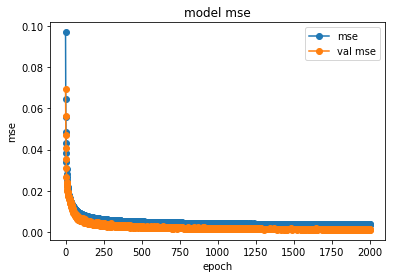

save the model


In [44]:
# -*- coding: utf-8 -*-
"""
Created on Tue Mar  7 15:43:18 2017

@author: hanar
"""
import time
import numpy as np
import os
from keras.utils import np_utils
from keras.models import Sequential
from keras.layers import Dense, Activation, Dropout
from keras.optimizers import SGD
from keras.optimizers import RMSprop
from keras.optimizers import Adagrad
from keras.optimizers import Adadelta
from keras.optimizers import Adam
from keras.optimizers import Adamax
from keras.optimizers import Nadam
from keras.callbacks import ModelCheckpoint
from keras.callbacks import EarlyStopping
from keras.callbacks import TensorBoard
from keras.models import load_model
#from keras.utils.visualize_util import plot
import matplotlib.pyplot as plt
import keras.callbacks
import keras.backend.tensorflow_backend as KTF
import tensorflow as tf

#Global variables for normalizing parameters
max_x = 1.0
min_x = 0.0
max_y = 1.0
min_y = 0.0


def deep_learning_tsunami(resdir, X_train_raw, y_train_raw, X_test_raw, y_test_raw,
                            _lr=0.02, _decay=0,
                            _validation_split=0.2, _batch_size=32,
                            _momentum=0.9, _nesterov=True,
                            num_layers=4, dropout=0.5,
                            node_num = 2500,
                            _epochs=2000):
    """
    Creating the inversion model of turbidity currents by deep learning
    """
    #Normalizing dataset
    X_train = get_normalized_data(X_train_raw, min_x, max_x)
    X_test = get_normalized_data(X_test_raw, min_x, max_x)
    y_train = get_normalized_data(y_train_raw, min_y, max_y)
    y_test = get_normalized_data(y_test_raw, min_y, max_y)
    
    #Generation of neural network model
    model = Sequential()
    model.add(Dense(node_num, input_dim=X_train.shape[1], activation='relu', kernel_initializer ='glorot_uniform'))#1st layer
    model.add(Dropout(dropout))
    for i in range(num_layers - 2):
        model.add(Dense(node_num, activation='relu', kernel_initializer ='glorot_uniform'))#2nd layer
        model.add(Dropout(dropout))
    model.add(Dense(y_train.shape[1], activation = 'relu', kernel_initializer ='glorot_uniform')) #last layer
    
    #Compiling the model
    model.compile(loss="mean_squared_error", 
              optimizer=SGD(lr=_lr, decay=_decay, momentum=_momentum, nesterov=_nesterov),
              #optimizer=Adadelta(),
              metrics=["mean_squared_error"])    
    
    #Perform learning
    t = time.time()
    check = ModelCheckpoint("model3.hdf5")
    #es_cb = EarlyStopping(monitor='val_loss', patience=5, verbose=0, mode='auto')
    #tb_cb = TensorBoard(log_dir=resdir, histogram_freq=2, write_graph=True, write_images=True)
    history = model.fit(X_train, y_train, epochs=_epochs, 
                    validation_split=_validation_split, batch_size=_batch_size,
                    callbacks=[check])
    
    #Evaluate learning result
    loss_and_metrics = model.evaluate(X_test,y_test)
    print("\nloss:{} mse:{}".format(loss_and_metrics[0],loss_and_metrics[1]))
    
    print("Elapsed time: {:.1f} sec.".format(time.time()-t))
    
    #Visualize learning result   
    #plot(model, to_file="model.png", show_shapes=True, show_layer_names=True)

    # model The state of change when letting you learnplot
    plot_history(history)
    
    return model, history

def apply_model(model, X, min_x, max_x, min_y, max_y):
    """
    Apply model
    Maximum and minimum values ​​of X and Y are required to normalize
    """
    X_norm =  (X - min_x) / (max_x - min_x)
    Y_norm = model.predict(X_norm)
    Y = Y_norm*(max_y - min_y)+min_y
    return Y

def plot_history(history):
    # Plot accuracy history
    plt.plot(history.history['mean_squared_error'],"o-",label="mse")
    plt.plot(history.history['val_mean_squared_error'],"o-",label="val mse")
    plt.title('model mse')
    plt.xlabel('epoch')
    plt.ylabel('mse')
    plt.legend(loc="upper right")
    plt.show()

#    # 損失の履歴をプロット
#    plt.plot(history.history['loss'],"o-",label="loss",)
#    plt.plot(history.history['val_loss'],"o-",label="val_loss")
#    plt.title('model loss')
#    plt.xlabel('epoch')
#    plt.ylabel('loss')
#    plt.legend(loc='upper right')
#    plt.show()

def test_model(model, x_test):
    #Test the results
    
    x_test_norm = get_normalized_data(x_test, min_x, max_x)
    test_result_norm = model.predict(x_test_norm)
    test_result = get_raw_data(test_result_norm, min_y, max_y)
    
    return test_result


def save_result(savedir, model, history, test_result):
    
    
    np.savetxt(savedir + 'test_result.txt',test_result,delimiter=',')
    np.savetxt(savedir+'loss.txt',history.history.get('loss'),delimiter=',')
    np.savetxt(savedir+'val_loss.txt',history.history.get('val_loss'),delimiter=',')
    
    #Serialize model and save
    print('save the model')
    model.save(savedir + 'model3.hdf5')

def load_data(datadir):
    """
    This function load training and test data sets, and returns variables
    """
    global min_x, max_x, min_y, max_y
    
    x_train = np.loadtxt(datadir + 'x_train.txt',delimiter=',')
    x_test = np.loadtxt(datadir + 'x_test.txt',delimiter=',')
    y_train = np.loadtxt(datadir + 'icond_train.txt',delimiter=',')
    y_test = np.loadtxt(datadir + 'icond_test.txt',delimiter=',')
    min_y = np.loadtxt(datadir + 'icond_min.txt',delimiter=',')
    max_y = np.loadtxt(datadir + 'icond_max.txt',delimiter=',')
    [min_x, max_x] = np.loadtxt(datadir + 'x_minmax.txt',delimiter=',')
    
    return x_train, y_train, x_test, y_test

def set_minmax_data(_min_x, _max_x, _min_y, _max_y):
    global min_x, max_x, min_y, max_y
    
    min_x, max_x, min_y, max_y = _min_x, _max_x, _min_y, _max_y
    return
    


def get_normalized_data(x, min_val, max_val):
    """
    Normalizing the training and test dataset
    """
    x_norm = (x - min_val) / (max_val - min_val)
    
    return x_norm

def get_raw_data(x_norm, min_val, max_val):
    """
    Get raw data from the normalized dataset
    """
    x = x_norm * (max_val - min_val) + min_val
    
    return x

if __name__ == "__main__":
    
    #Reading data  
    datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi3900/'
    resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi3900/'
    if not os.path.exists(resdir):
        os.mkdir(resdir)
    
    x_train, y_train, x_test, y_test = load_data(datadir)
    
     
    #Execution of learning
    testcases = [4500]
    for i in range(len(testcases)):
        resdir_case = resdir + '{}/'.format(testcases[i])        
        if not os.path.exists(resdir_case):
            os.mkdir(resdir_case)
        x_train_sub = x_train[0:testcases[i],:]
        y_train_sub = y_train[0:testcases[i],:]
        model, history = deep_learning_tsunami(resdir_case, x_train_sub, y_train_sub, x_test, y_test, num_layers=5)
        #Verify and save results
        result = test_model(model, x_test)
        save_result(resdir_case,model,history,result)




(500, 9)


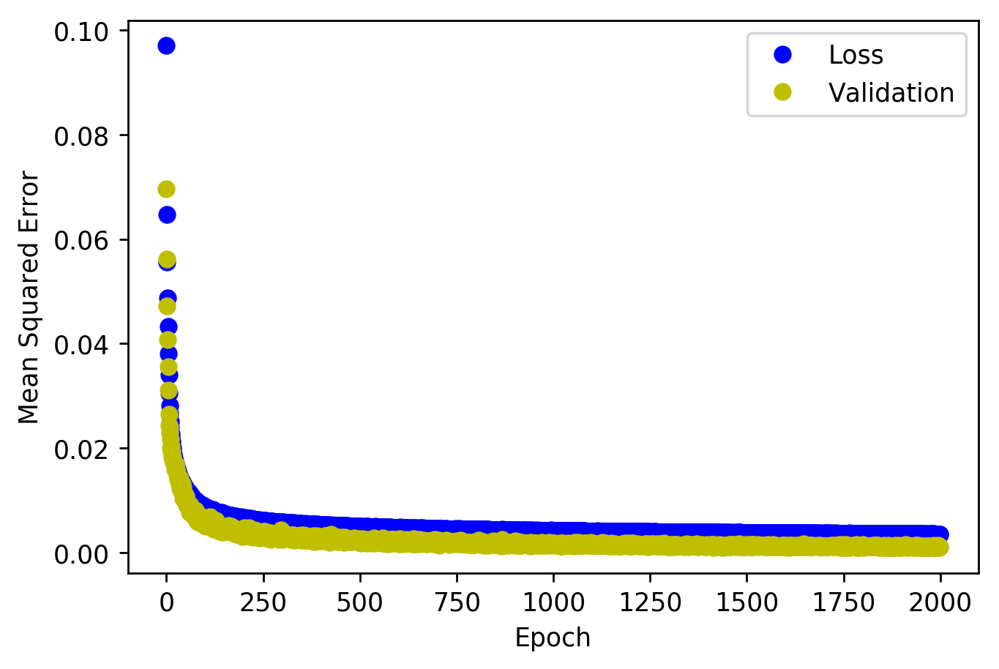

<Figure size 432x288 with 0 Axes>

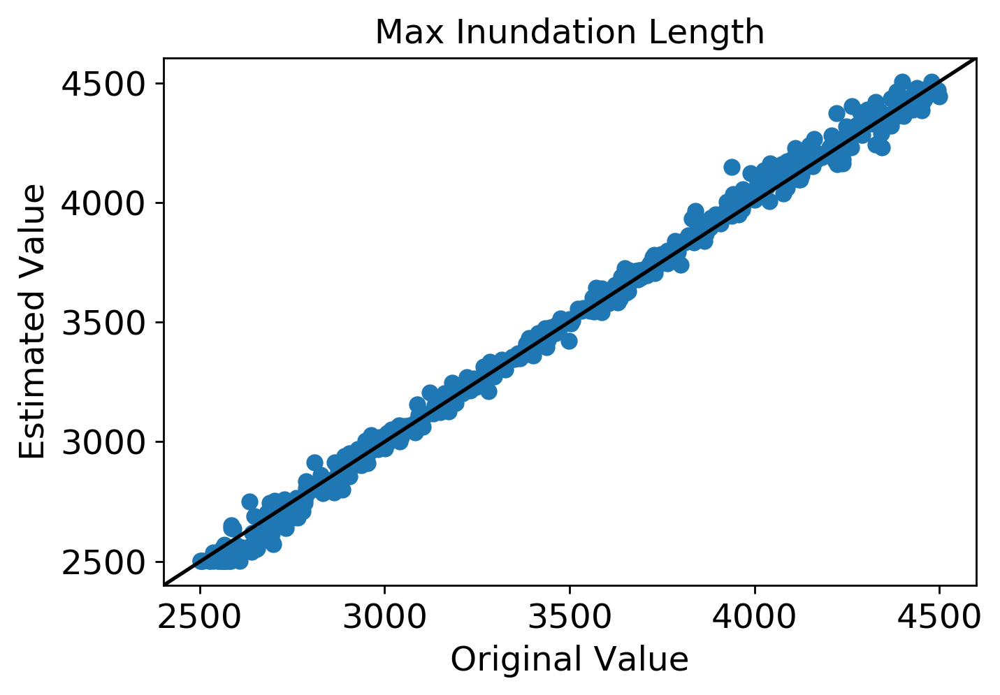

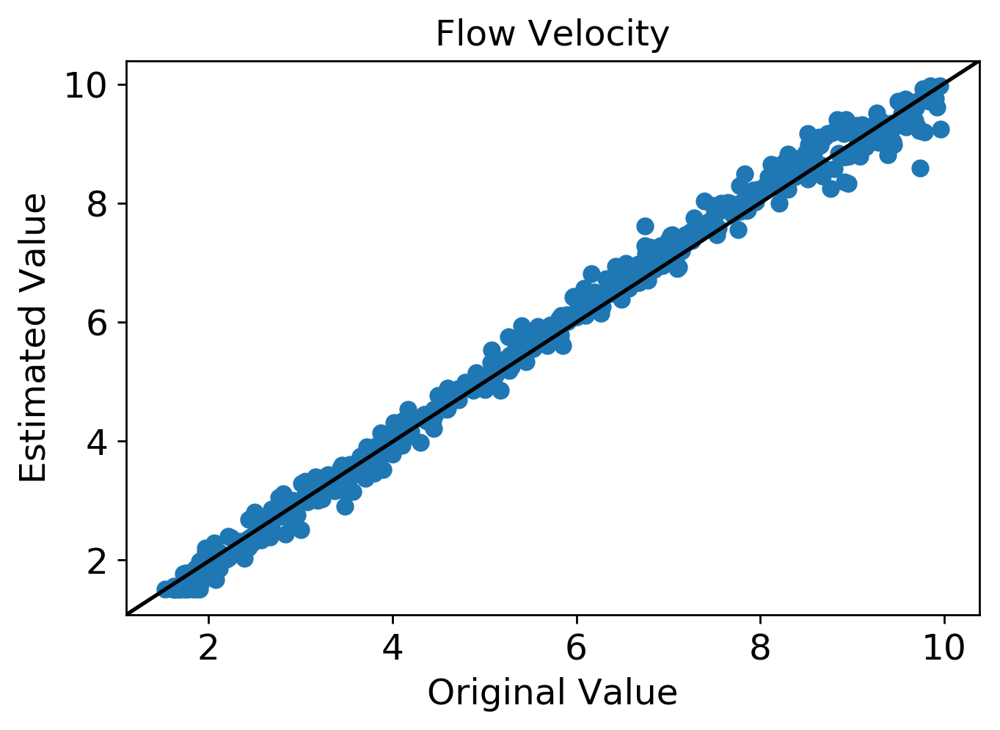

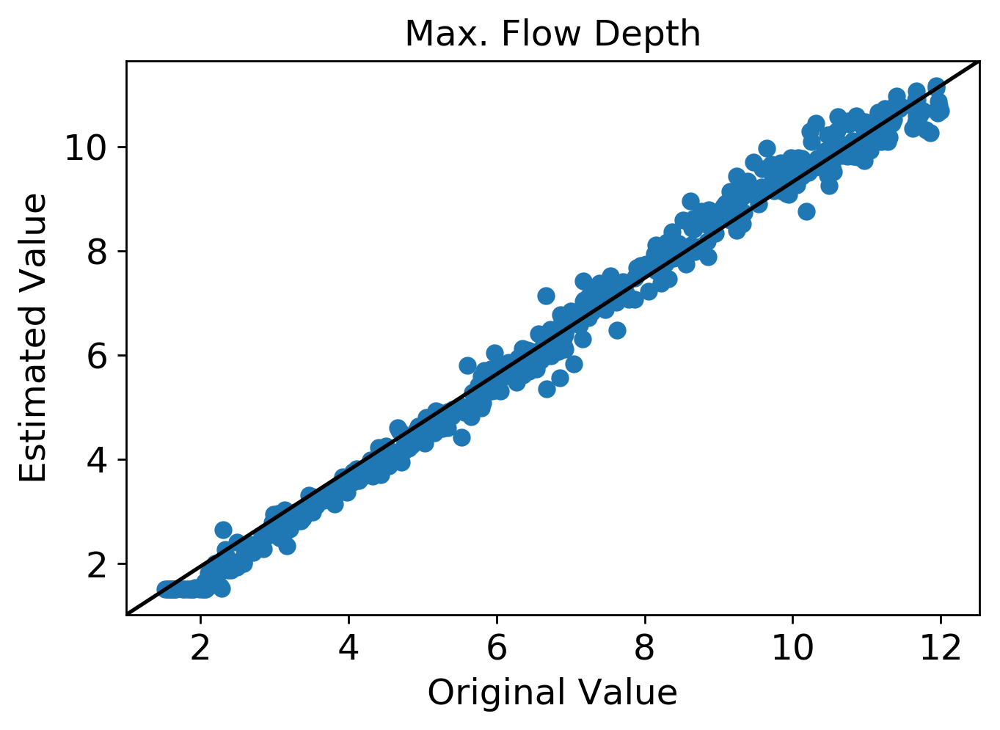

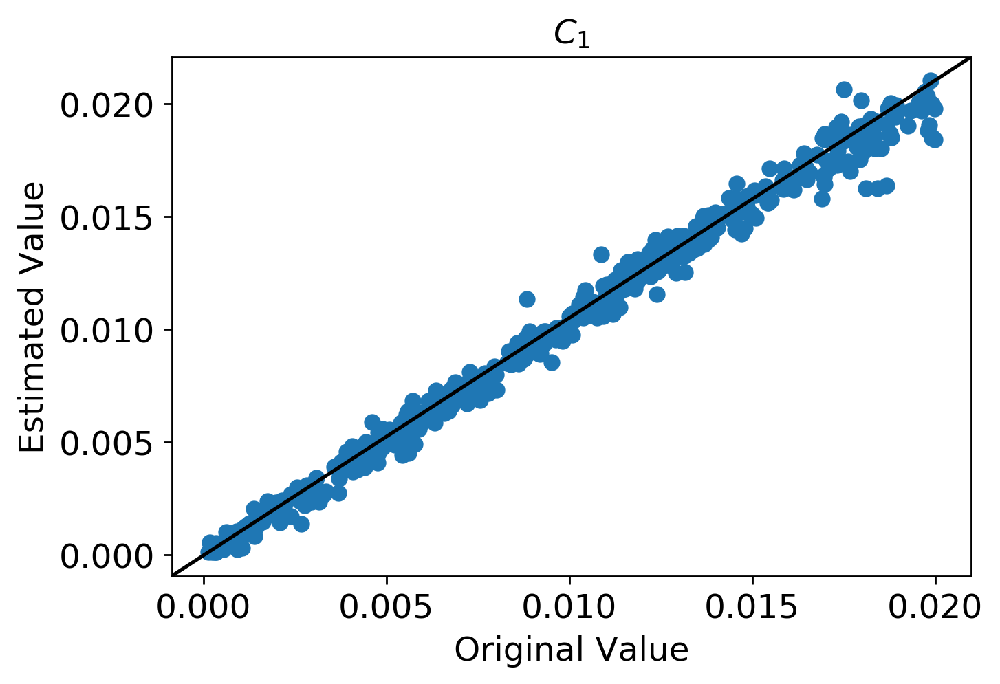

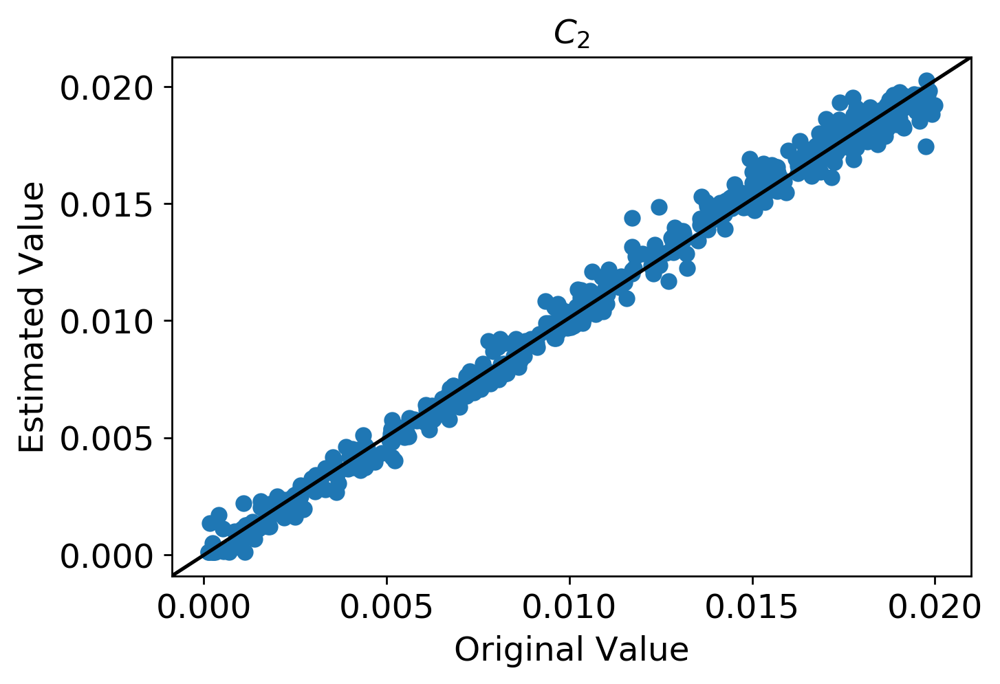

...

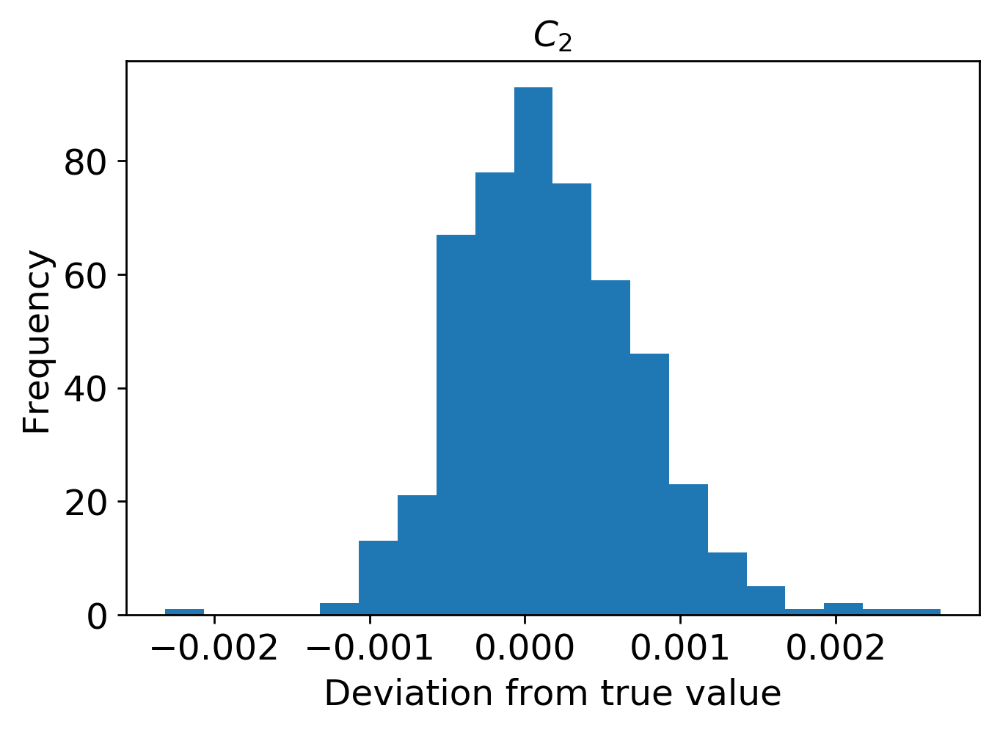

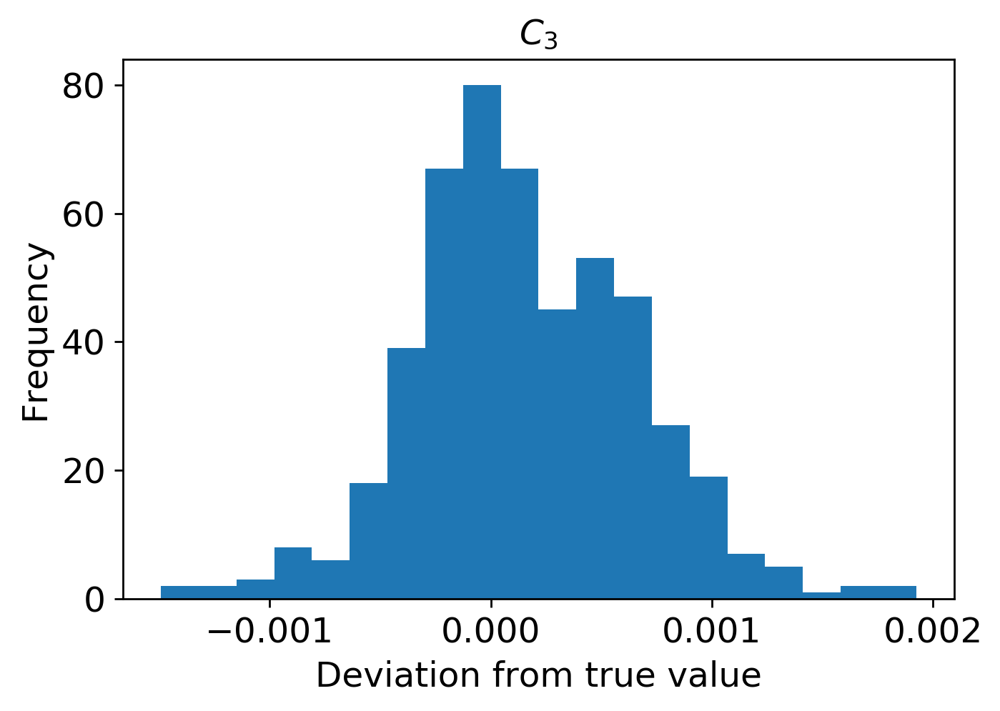

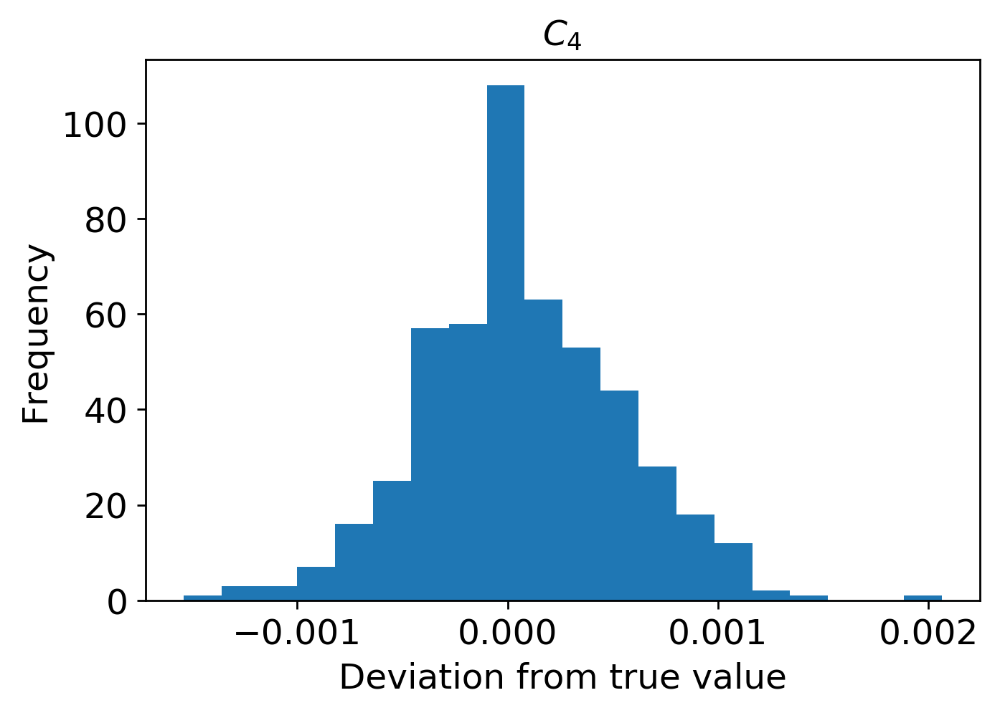

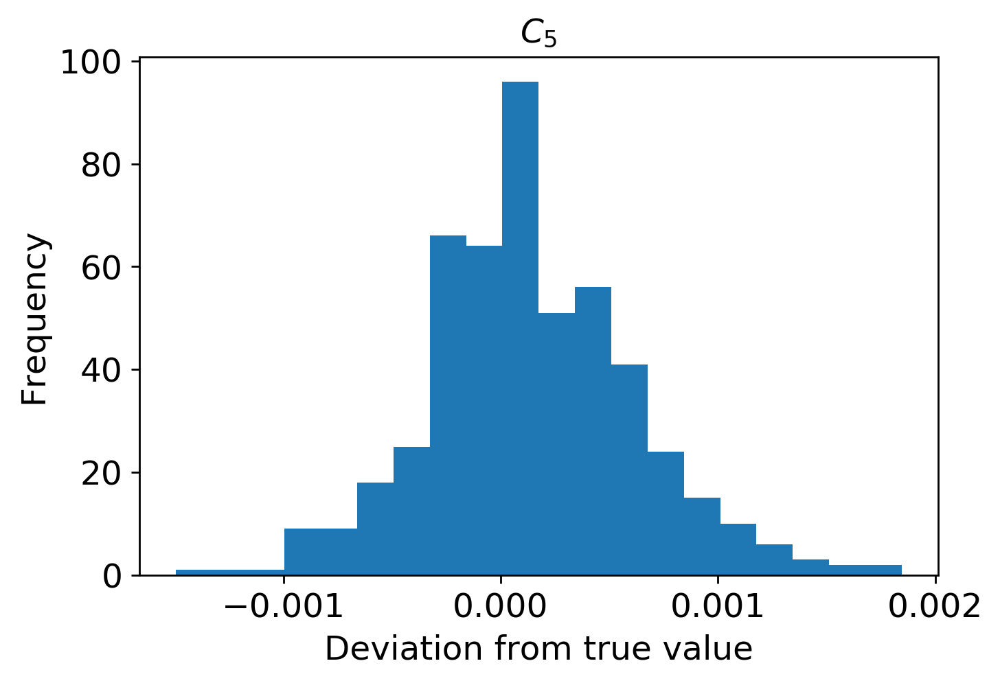

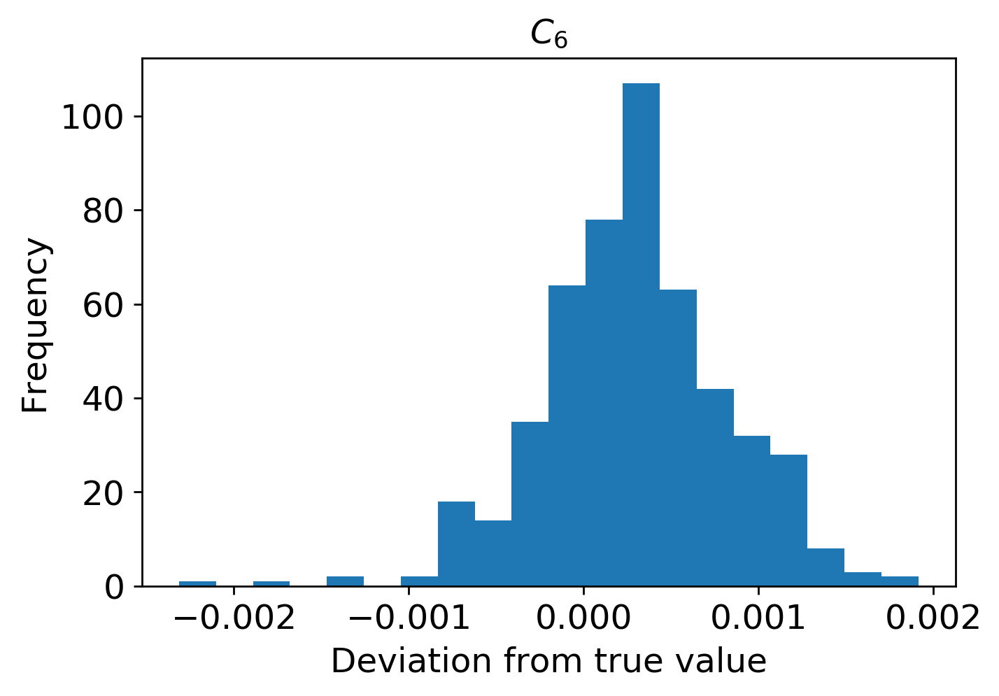

In [45]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi3900/'
resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi3900/4500/'

test_result = np.loadtxt(resdir + 'test_result.txt',delimiter=',')
icond = np.loadtxt(datadir + 'icond_test.txt',delimiter=',')
print(icond.shape)
loss = np.loadtxt(resdir+'loss.txt',delimiter=',')
epoch = range(0,2000)
vloss = np.loadtxt(resdir+'val_loss.txt',delimiter=',')
resi = test_result - icond

fig = plt.figure(num=None,dpi=250, facecolor='w', edgecolor='k')
plt.plot(epoch, loss, 'bo',label='Loss')
plt.plot(epoch, vloss, 'yo',label='Validation')
plt.xlabel('Epoch')
plt.ylabel('Mean Squared Error')
plt.legend(loc="upper right")
plt.savefig(resdir+ 'mse.eps')
plt.show()

fig2 = plt.figure()
hfont = {'fontname':'Century Gothic'}
textcol = 'k'
titlelabel = ['Max Inundation Length','Flow Velocity', 'Max. Flow Depth', '$C_1$', '$C_2$', '$C_3$', '$C_4$','$C_5$','$C_6$']


    
for i in range(len(titlelabel)):
    plt.figure(num=None,dpi=250, facecolor='w', edgecolor='k')
    plt.plot(icond[:,i],test_result[:,i],"o")
    x=icond[:,i]
    y=test_result[:,i]
    y_lim = plt.ylim()
    x_lim = plt.xlim()
    plt.plot(x_lim, y_lim, 'k-', color = 'k')
    plt.ylim(y_lim)
    plt.xlim(x_lim)
    plt.xlabel('Original Value',color=textcol,size=14,**hfont)
    plt.ylabel('Estimated Value',color=textcol,size=14,**hfont)
    plt.title(titlelabel[i],color=textcol,size=14,**hfont)
    plt.tick_params(labelsize=14,colors=textcol)
    plt.savefig(resdir+titlelabel[i] + '.eps')
    #plt.show()

for i in range(len(titlelabel)):
    plt.figure(num=None,dpi=250, facecolor='w', edgecolor='k')
    plt.hist(resi[:,i],bins=20)
    plt.title(titlelabel[i],color=textcol,size=14,**hfont)
    plt.xlabel('Deviation from true value',color=textcol,size=14,**hfont)
    plt.ylabel('Frequency',color=textcol,size=14,**hfont)
    plt.tick_params(labelsize=14,colors=textcol)
    plt.savefig(resdir+titlelabel[i] + 'hist' + '.eps')
    plt.show()

       distance        g1        g2        g3        g4        g5        g6
0      0.000000  0.036771  0.167260  0.114845  0.008449  0.002190  0.005161
1    103.794102  0.000000  0.075200  0.153283  0.013753  0.001885  0.000442
2    171.620654  0.002130  0.051171  0.084309  0.006218  0.001867  0.002843
3    397.112167  0.003115  0.016359  0.078858  0.011466  0.000597  0.000054
4    595.912969  0.000732  0.016896  0.028720  0.002661  0.000914  0.000000
5    707.625749  0.000143  0.002228  0.005502  0.000900  0.000187  0.000104
6    796.435078  0.000236  0.004337  0.021204  0.003169  0.000309  0.000080
7    895.065500  0.001688  0.016059  0.081413  0.020284  0.006824  0.004628
8    988.394177  0.004567  0.008166  0.074658  0.016913  0.002424  0.001580
9   1081.819325  0.001567  0.016305  0.060234  0.011086  0.004165  0.001994
10  1195.756993  0.001022  0.002370  0.017565  0.004194  0.000567  0.000142
11  1290.372534  0.000000  0.004121  0.057974  0.014565  0.000426  0.000213
12  1400.896

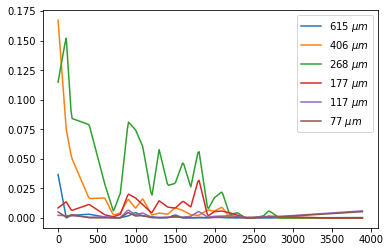

In [46]:
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.models import load_model
from scipy import stats
from scipy.interpolate import interp1d 
import pandas as pd
from pykrige import OrdinaryKriging as OK
import ipdb


datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi3900/'
resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi3900/4500/'
#Initial setting
if not "model" in locals(): 
    model = load_model(resdir+'model3.hdf5')
#gclass = 3
#gclass_label = ["500 $\mu$m","125 $\mu$m","63 $\mu$m"]
gclass = 6
gclass_label = ["615 ${\mu}m$","406 ${\mu}m$","268 ${\mu}m$","177 ${\mu}m$", "117 ${\mu}m$","77 ${\mu}m$"]
topodx = 15.0
coord_num = int(model.layers[0].input_shape[1]/gclass)

#Acquires a value for normalizing input data to [0, 1]
min_x, max_x = np.loadtxt(datadir + 'x_minmax.txt',delimiter=',')
y_min = np.loadtxt(datadir + 'icond_min.txt',delimiter=',')
y_max = np.loadtxt(datadir + 'icond_max.txt',delimiter=',')

#Read outcrop data
#dist_max = 22000. #Distance of distal end of learning data
outcrop = pd.read_csv('../FITTNUSS-forward_training_DNN/sendai_increased_class_edit.csv')
#outcrop = pd.read_csv('../DeepLearningTurbidite_Fukuda/GA_naruse_v2.csv')
#outcrop = outcrop.append(pd.DataFrame([[0,'Loc0',0,0,0],[dist_max,'LocE',0,0,0]], columns=outcrop.columns))
outcrop = outcrop.sort_values('distance')
outcrop['distance'] = outcrop['distance'] - 0
#d = pd.DataFrame(np.zeros((1, 7)),columns=['distance', 'g1','g2','g3','g4','g5','g6'])
#print(d)
#v=np.concatenate((outcrop, d))
#print(v)
#outcrop=pd.DataFrame(v,columns=['distance', 'g1','g2','g3','g4','g5','g6'])
#outcrop['distance'].iloc[-1]=4000
#outcrop = outcrop.append(pd.DataFrame([[0,'Loc0',0,0,0,0]], columns=outcrop.columns))
print(outcrop)

#Preparation under interpolation
thick_interp = np.zeros([1,coord_num*gclass])#補間されたサンプル厚さデータ
outcrop_x_id = np.round(outcrop['distance']/topodx).astype(np.int32) #逆解析システムでのサンプリング地点のindex番号
x = np.arange(0,coord_num*topodx,topodx)

#Complement data
for j in range(gclass):
    f = interp1d(outcrop['distance'],outcrop.iloc[:,j+1], kind="linear",bounds_error=False,fill_value='extrapolate')
    #f = interp1d(outcrop['distance'],outcrop.iloc[:,j+2], kind="linear",bounds_error=False,fill_value='extrapolate') 
    #Interpolation function of jth granularity level
    thick_interp[0,coord_num*j:coord_num*(j+1)] = f(x) #Supplemented data

#ipdb.set_trace()
#Kriging Interpolation by
#vparams = np.array([[0.035, 10000., 0.001],[0.006, 10000., 0.002],[0.005, 10000., 0.002],[0.035, 10000., 0.001]])
#for j in range(gclass):
    #okip = OK(outcrop['distance'],np.zeros(outcrop['distance'].shape),outcrop.iloc[:,j+1],variogram_model='gaussian',)
    #okip.display_variogram_model()
    #ipdata, ipstd = okip.execute('grid',x,np.array([0.]))
    #ipdata = np.squeeze(ipdata)
    #thick_interp[0,coord_num*j:coord_num*(j+1)] = ipdata #Assign complemented d

#Normalize data
thick_interp[thick_interp < 0] = 0
thick_interp_norm =  (thick_interp - min_x) / (max_x - min_x)

#Perform inverse analysis
test_result_outcrop = model.predict(thick_interp_norm)
test_result_outcrop = test_result_outcrop * (y_max - y_min) + y_min
print(test_result_outcrop)
#add=np.array(3000)
#test_result_outcrop_add=np.concatenate((add,test_result_outcrop), axis=None)
#Output results
#print(test_result_outcrop_add)
np.savetxt('outcrop_result_g6_g300_H_5000_20_11_roi3900.txt',test_result_outcrop, delimiter=',')
for i in range(len(gclass_label)):
    plt.plot(x,thick_interp[0,coord_num * i:coord_num * (i+1)],label=gclass_label[i])
plt.legend()
plt.show()



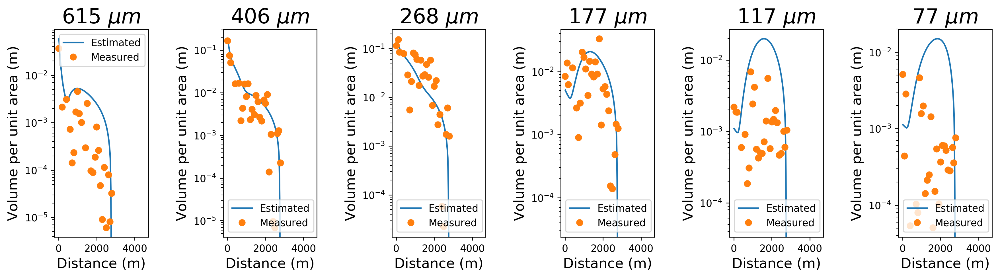

In [47]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import Forward_model_modified_FITTNUSS_5000_g6_300grid_19_11_case2 as fmodel
import time
import ipdb
%matplotlib inline

#Basic setting

#dist_max = 3000.
gclass = 6
topodx=15.0
gclass_name = ['615microm','406microm','268microm','177microm','117microm','77microm']
#gclass_name = ['500micron', '125micron', '63micron']
gname_tex = ["615 ${\mu}m$","406 ${\mu}m$","268 ${\mu}m$","177 ${\mu}m$", "117 ${\mu}m$","77 ${\mu}m$"]
#gname_tex = ['500 $\mu$m','125 $\mu$m','63 $\mu$m']
#calcdir = 'home/rimali2009/FITTNUSS-forward_training_DNN/'
#calcdir = '/home/naruse/Documents/Documents/MATLAB/TCtrainData_forML/TCModel_for_MLTEST/test_output_otadai07/'

#Load estimate
#H1 = np.loadtxt(calcdir + 'H1.txt',delimiter=',')
#H2 = np.loadtxt(calcdir + 'H2.txt',delimiter=',')
#H3 = np.loadtxt(calcdir + 'H3.txt',delimiter=',')
#H4 = np.loadtxt(calcdir + 'H4.txt',delimiter=',')
#Ht = np.loadtxt(calcdir + 'Ht.txt',delimiter=',')
#U = np.loadtxt(calcdir + 'U.txt',delimiter=',')
#xi = np.loadtxt(calcdir + 'xi.txt',delimiter=',')
#x = np.loadtxt(calcdir + 'x.txt',delimiter=',')
#x_bed = np.loadtxt(calcdir + 'x_init.txt',delimiter=',')
#eta_init = np.loadtxt(calcdir + 'eta_init.txt',delimiter=',')
#Ct = np.loadtxt(calcdir + 'Ct.txt',delimiter=',')
#time = np.loadtxt(calcdir + 'time.txt',delimiter=',')
estimated_icond=np.loadtxt('outcrop_result_g6_g300_H_5000_20_11_roi3900.txt', delimiter=',')
start = time.time()
fmodel.read_setfile("config_g6_300grid_19_11_case2.ini")
(x,C,x_dep,deposit) = fmodel.forward(estimated_icond)
np.savetxt('eta_estimated_thickness_5K_g6_TC4_Rwcnst_H_5000_20_11_roi3900.csv', deposit, delimiter=',')
np.savetxt('eta_estimated_Distance_5K_g6_TC4_Rwcnst_H_5000_20_11_roi3900.csv', x_dep,delimiter=',')
estimated_dep_thickness_5000=np.transpose(np.loadtxt('/home/rimali2009/FITTNUSS-forward_training_DNN/'+'eta_estimated_thickness_5K_g6_TC4_Rwcnst_H_5000_20_11_roi3900.csv', delimiter=','))
estimated_dep_thickness_5000=pd.DataFrame(estimated_dep_thickness_5000,columns=['615microm','406microm','268microm','177microm','117microm','77microm'])
estimated_dep_distance_5000=np.transpose(np.loadtxt('/home/rimali2009/FITTNUSS-forward_training_DNN/'+'eta_estimated_Distance_5K_g6_TC4_Rwcnst_H_5000_20_11_roi3900.csv', delimiter=','))
estimated_dep_distance_5000=pd.DataFrame(estimated_dep_distance_5000,columns=['distance'])
estimated_dep_5000=pd.concat([estimated_dep_distance_5000,estimated_dep_thickness_5000],axis=1)
np.savetxt('estimated_dep_5K_g6_TC4_Rwcnst_H_5000_20_11_roi3900.csv',estimated_dep_5000,delimiter=',')
#data_estim=pd.DataFrame(estimated_dep_5000,columns=['distance','1.5phi','2.5phi','3.5phi','4.5phi'])

#Formatting the loaded data
#estimated_dep_df = pd.DataFrame(estimated_dep,columns=['distance','1.5phi','2.5phi','3.5phi','4.5phi'])
#estimated_dep = pd.DataFrame(np.array([x_bed - dist_offset,H1[-1,:],H2[-1,:],H3[-1,:]]).T,columns=['distance','500micron','125micron','63micron'])
estimated_dep_5000= estimated_dep_5000.query('distance > 0')
#estimated_dep_5000 = estimated_dep_5000.query('distance < {}'.format(dist_max))

#Read original data
outcrop = pd.read_csv('../FITTNUSS-forward_training_DNN/sendai_increased_class.csv')
outcrop= pd.DataFrame(outcrop,columns=['distance','615microm','406microm','268microm','177microm','117microm','77microm'])
#outcrop = pd.read_csv('../DeepLearningTurbidite_Fukuda/GA_naruse_v2.csv')
#outcrop = outcrop.append(pd.DataFrame([[0,'Loc0',0,0,0],[dist_max,'LocE',0,0,0]], columns=outcrop.columns))
#outcrop = outcrop.sort_values('distance')
#outcrop['distance'] = outcrop['distance'] - 1000

#Plot
plt.figure(num=None, figsize=(17, 4), dpi=250, facecolor='w', edgecolor='g')
hfont = {'fontname':'Sans'}
plt.subplots_adjust(bottom=0.15, wspace=0.8)

for i in range(gclass):
    plt.subplot(1,gclass,i+1)
    plt.plot(estimated_dep_5000['distance'],estimated_dep_5000[gclass_name[i]],'-', label='Estimated')
    plt.plot(outcrop['distance'], outcrop[gclass_name[i]],'o', label='Measured')
    plt.yscale('log')
    plt.title(gname_tex[i], size=21,**hfont)
    plt.xlabel('Distance (m)', size = 14, **hfont)
    plt.ylabel('Volume per unit area (m)', size = 14, **hfont)
    plt.legend(fontsize=10)
    plt.savefig("thickness_distance_curve_5000_g6_300grid_H_5000_20_11_roi3900.png")
    plt.savefig("thickness_distance_curve_5000_g6_300grid_H_5000_20_11_roi3900.eps")
plt.show()



Using TensorFlow backend.


       distance        g1        g2        g3        g4        g5        g6
0      0.000000  0.036771  0.167260  0.114845  0.008449  0.002190  0.005161
1    103.794102  0.000000  0.075200  0.153283  0.013753  0.001885  0.000442
2    171.620654  0.002130  0.051171  0.084309  0.006218  0.001867  0.002843
3    397.112167  0.003115  0.016359  0.078858  0.011466  0.000597  0.000054
4    595.912969  0.000732  0.016896  0.028720  0.002661  0.000914  0.000000
5    707.625749  0.000143  0.002228  0.005502  0.000900  0.000187  0.000104
6    796.435078  0.000236  0.004337  0.021204  0.003169  0.000309  0.000080
7    895.065500  0.001688  0.016059  0.081413  0.020284  0.006824  0.004628
8    988.394177  0.004567  0.008166  0.074658  0.016913  0.002424  0.001580
9   1081.819325  0.001567  0.016305  0.060234  0.011086  0.004165  0.001994
10  1195.756993  0.001022  0.002370  0.017565  0.004194  0.000567  0.000142
11  1290.372534  0.000000  0.004121  0.057974  0.014565  0.000426  0.000213
12  1400.896

       distance        g1        g2        g3        g4        g5        g6
0      0.000000  0.036771  0.167260  0.114845  0.008449  0.002190  0.005161
1    103.794102  0.000000  0.075200  0.153283  0.013753  0.001885  0.000442
2    171.620654  0.002130  0.051171  0.084309  0.006218  0.001867  0.002843
3    397.112167  0.003115  0.016359  0.078858  0.011466  0.000597  0.000054
4    595.912969  0.000732  0.016896  0.028720  0.002661  0.000914  0.000000
5    707.625749  0.000143  0.002228  0.005502  0.000900  0.000187  0.000104
6    796.435078  0.000236  0.004337  0.021204  0.003169  0.000309  0.000080
7    895.065500  0.001688  0.016059  0.081413  0.020284  0.006824  0.004628
8   1081.819325  0.001567  0.016305  0.060234  0.011086  0.004165  0.001994
9   1195.756993  0.001022  0.002370  0.017565  0.004194  0.000567  0.000142
10  1290.372534  0.000000  0.004121  0.057974  0.014565  0.000426  0.000213
11  1400.896519  0.000295  0.003096  0.027406  0.009121  0.000502  0.000251
12  1495.352

/home/rimali2009/anaconda3/envs/test3/lib/python3.6/site-packages/matplotlib/font_manager.py:1241: UserWarning: findfont: Font family ['Century Gothic'] not found. Falling back to DejaVu Sans.
  (prop.get_family(), self.defaultFamily[fontext]))


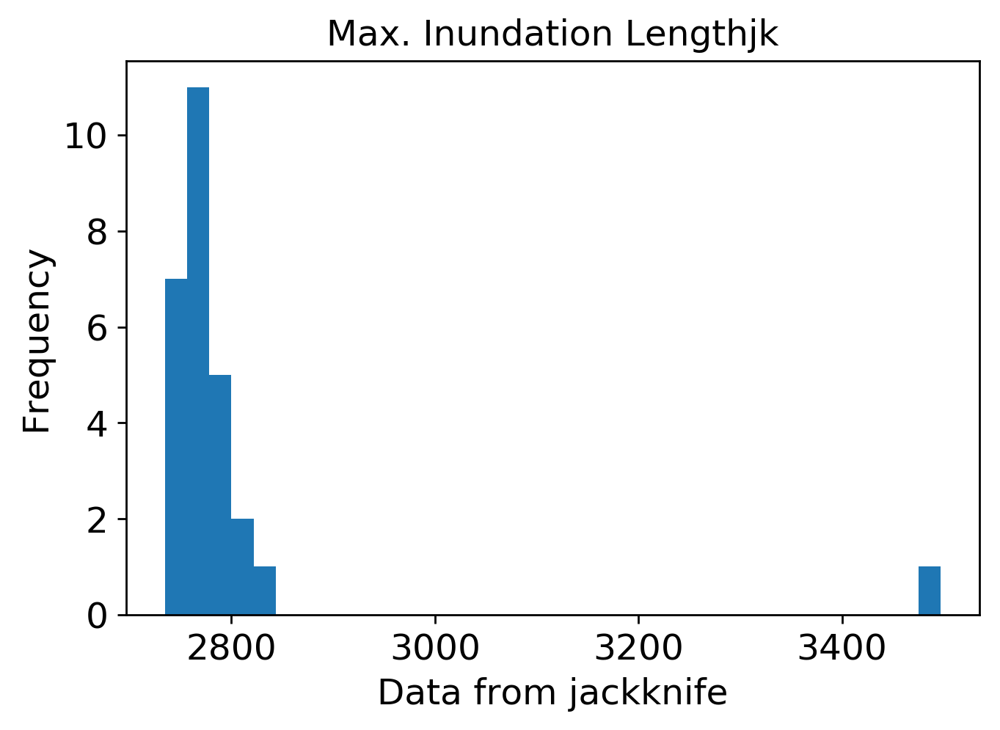

mean: 4.9153325886667325
jk_e: 0.11259284382268953


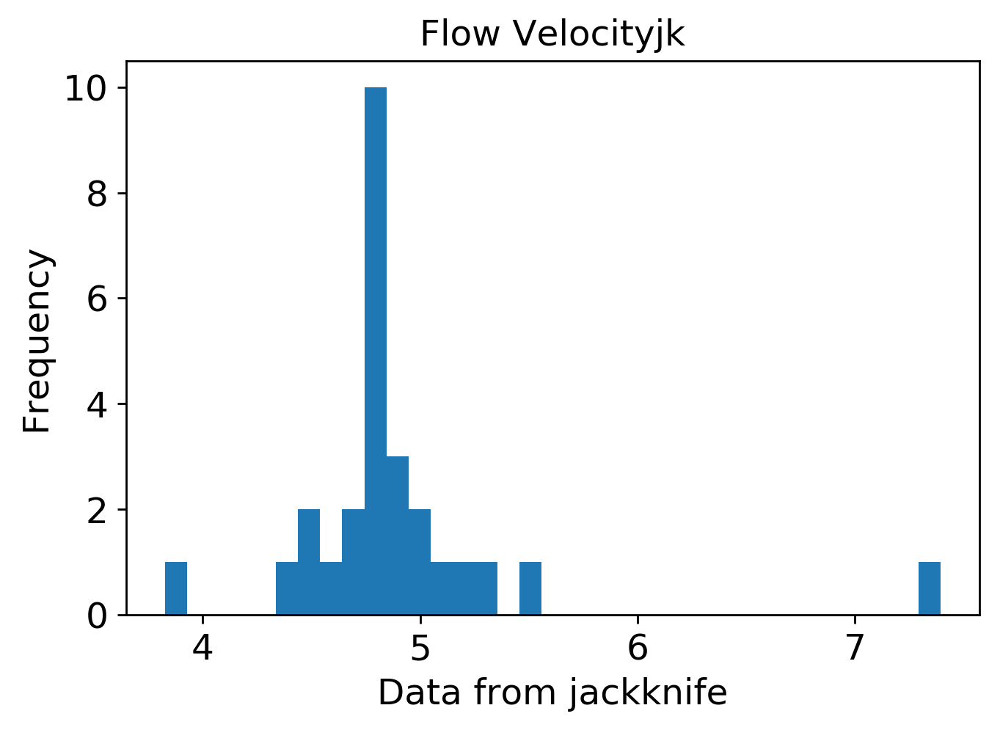

mean: 6.454684597707734
jk_e: 0.16884708749108732


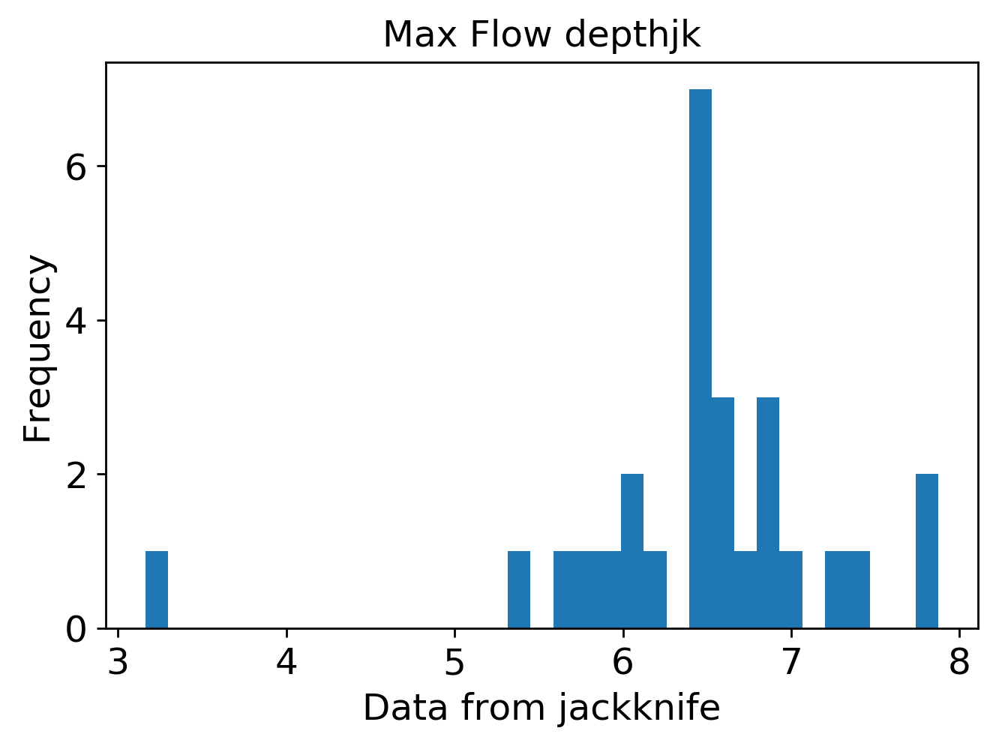

mean: 0.006105549222613225
jk_e: 0.00017302777038776326


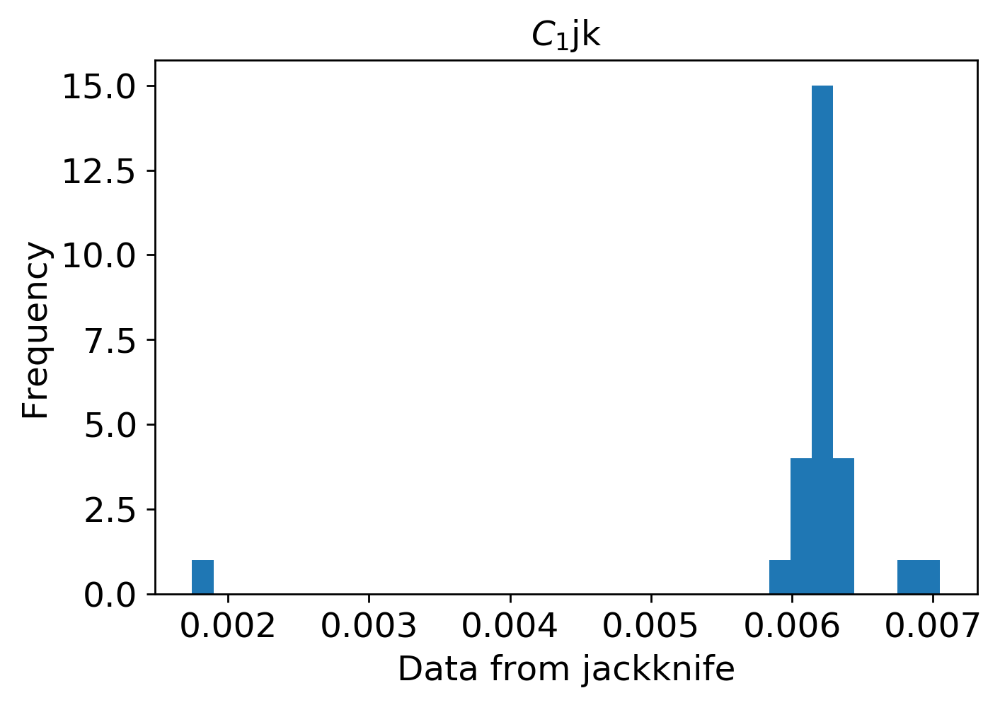

mean: 0.018709564128447643
jk_e: 0.0003671838082734641


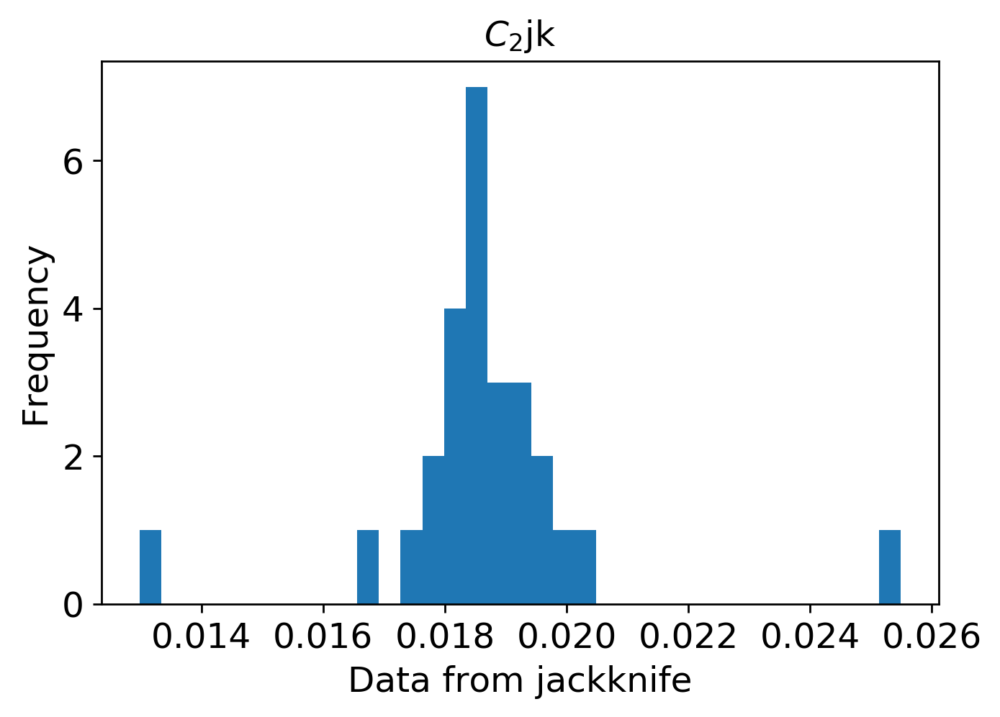

mean: 0.015796458446831335
jk_e: 0.0004083179663692027


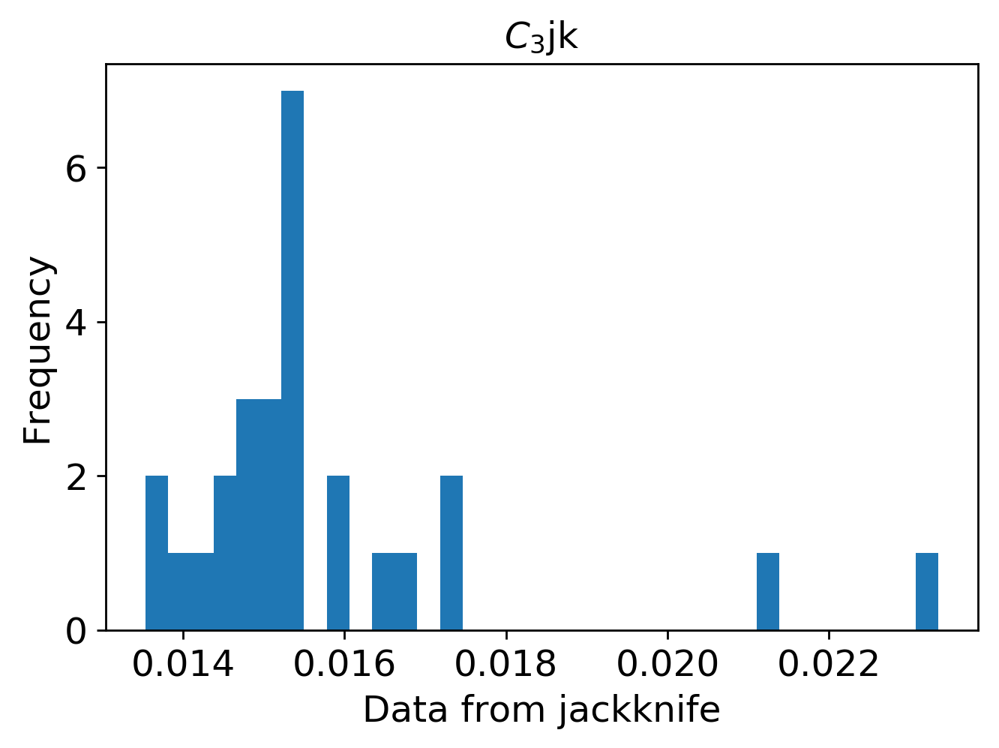

mean: 0.0006133709262636095
jk_e: 8.514821381657589e-05


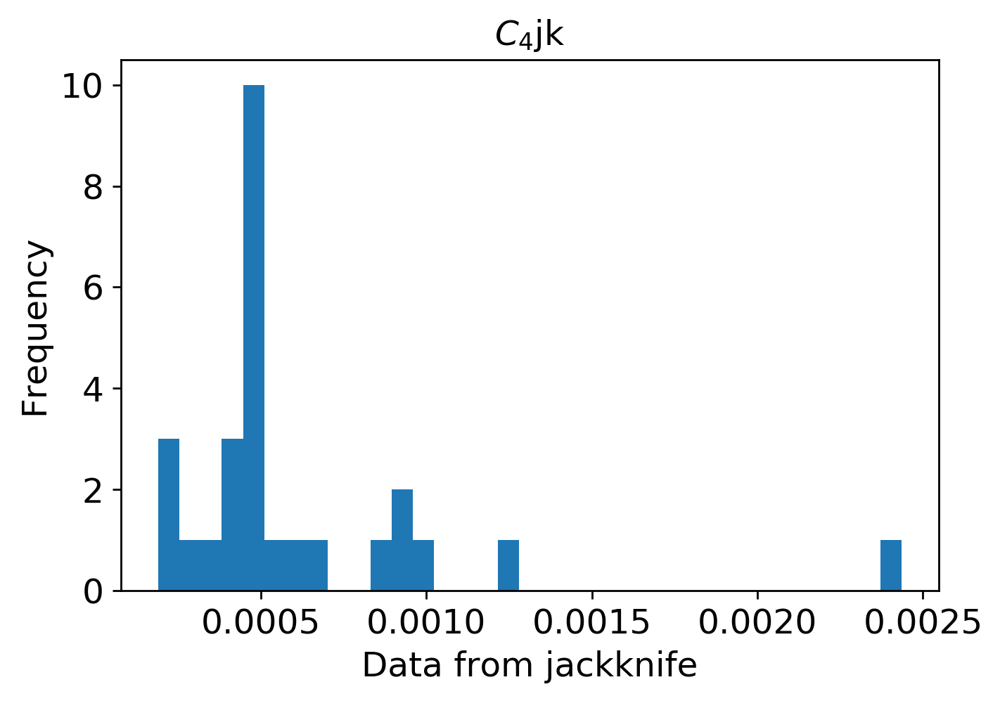

mean: 0.00019613740757270243
jk_e: 8.234629023604882e-05


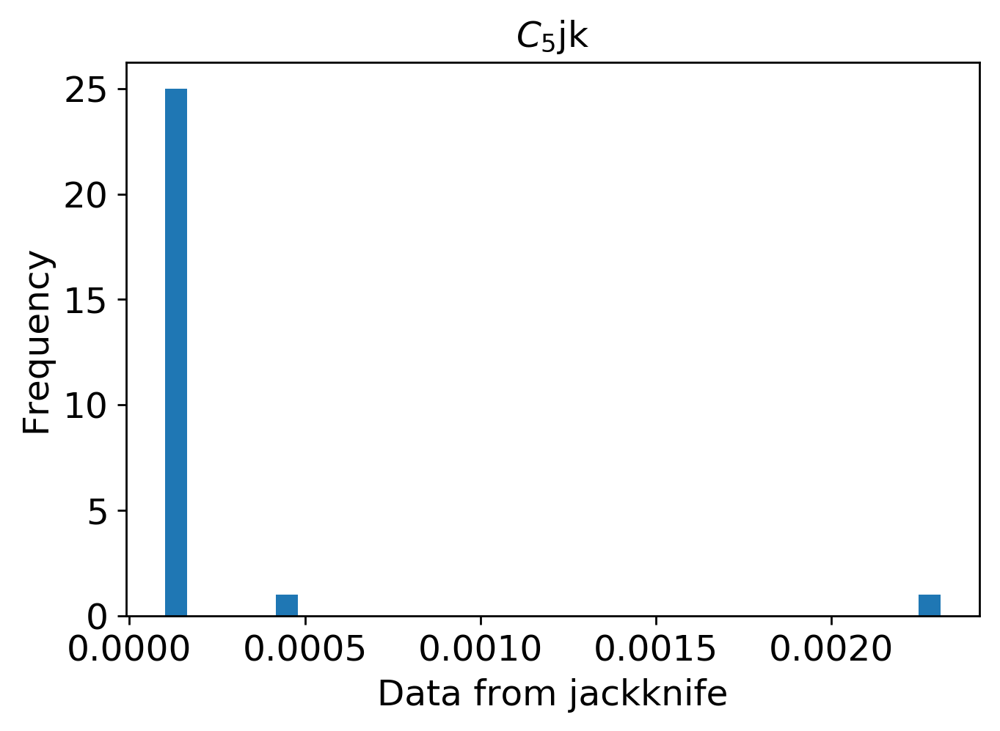

mean: 0.00018375507872479336
jk_e: 4.015340191505627e-05


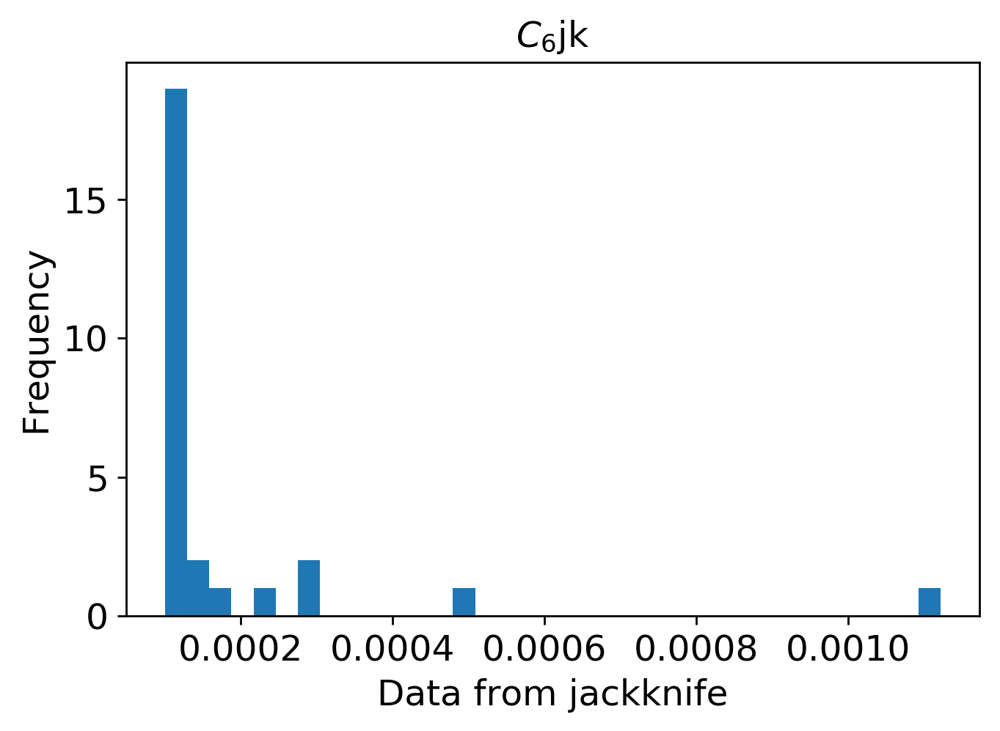

In [1]:
# Jackknife Method
import csv
import numpy as np
import pandas as pd
import math
from keras.models import load_model
from scipy.interpolate import interp1d
import matplotlib.pyplot as plt
%matplotlib inline

datadir = '/home/rimali2009/FITTNUSS-forward_training_DNN/data_g6_300grid_H_5000_20_11_roi3900/'
resdir = '/home/rimali2009/FITTNUSS-forward_training_DNN/result_g6_300grid_H_5000_20_11_roi3900/4500/'
# Initial setting
if not "model" in locals():
    model = load_model(resdir+'model3.hdf5')
gclass = 6
gclass_label = ["615 ${\mu}m$", "406 ${\mu}m$", "268 ${\mu}m$",
                "177 ${\mu}m$", "117 ${\mu}m$", "77 ${\mu}m$"]
topodx = 15.0
coord_num = int(model.layers[0].input_shape[1]/gclass)
min_x, max_x = np.loadtxt(datadir + 'x_minmax.txt', delimiter=',')
y_min = np.loadtxt(datadir + 'icond_min.txt', delimiter=',')
y_max = np.loadtxt(datadir + 'icond_max.txt', delimiter=',')


a = pd.read_csv(
    '../FITTNUSS-forward_training_DNN/sendai_increased_class_edit.csv', delimiter=',')
print(a)
y = pd.DataFrame()
output = []

with open('output_final_20_11_roi3900.csv', 'w') as outfile:

    # x=[]
    for index in range(len(a)):
        df = y.append(pd.read_csv(
            '../FITTNUSS-forward_training_DNN/sendai_increased_class_edit.csv', skiprows=[index+1]))
        print(df)
        df = df.sort_values('distance')
        thick_interp = np.zeros([1, coord_num*gclass])
        x = np.arange(0, coord_num*topodx, topodx)
        for j in range(gclass):
            # Interpolation function of jth granularity level
            f = interp1d(df['distance'], df.iloc[:, j+1],
                         kind="linear", bounds_error=False,fill_value='extrapolate')
            thick_interp[0, coord_num*j:coord_num*(j+1)] = f(x)
        thick_interp[thick_interp < 0] = 0
        thick_interp_norm = (thick_interp - min_x) / (max_x - min_x)
        test_result_outcrop = model.predict(thick_interp_norm)
        test_result_outcrop = test_result_outcrop * (y_max - y_min) + y_min
        print(test_result_outcrop.shape)
        print(test_result_outcrop)
    # output.append(test_result_outcrop)
        np.savetxt(outfile,test_result_outcrop, delimiter=',')
        # outfile.write('# New iteration\n')
hfont = {'fontname': 'Century Gothic'}
textcol = 'k'
resi = np.loadtxt('output_final_20_11_roi3900.csv', delimiter=',')
titlelabel = ['Max. Inundation Lengthjk','Flow Velocityjk', 'Max Flow depthjk',
              '$C_1$jk', '$C_2$jk', '$C_3$jk', '$C_4$jk', '$C_5$jk', '$C_6$jk']
jk_er=[]
with open('jk_e_roi3900.txt','wb') as ftext:
    for i in range(len(titlelabel)):
        plt.figure(num=None, dpi=250, facecolor='w', edgecolor='k')
        plt.hist(resi[:, i], bins=35)
        mean = sum(resi[:,i]) / len(resi[:,i])
        print("mean:",mean)
        var_jk  = sum(pow(x-mean,2) for x in resi[:,i]) / ((len(resi[:,i])-1)*(len(resi[:,i])))
        jk_e= math.sqrt(var_jk)
        print("jk_e:",jk_e)
        e=np.append(jk_e,jk_er)
        np.savetxt(ftext,e,delimiter=',')
        plt.title(titlelabel[i], color=textcol, size=14, **hfont)
        plt.xlabel('Data from jackknife', color=textcol, size=14, **hfont)
        plt.ylabel('Frequency', color=textcol, size=14, **hfont)
        plt.tick_params(labelsize=14, colors=textcol)
        plt.savefig(resdir+titlelabel[i] + 'jkhist' + '.eps')
        plt.show()
